In [11]:
import numpy as np
import time
import torch
import torch.nn as nn
from torch.utils.data import TensorDataset, DataLoader, random_split
import torch.optim as optim
import matplotlib.pyplot as plt
import sys, os

project_root = os.path.abspath(os.path.join(os.getcwd(), '..', '..'))
sys.path.append(project_root)

from Resources.Model import Model_v4, Model_v5
from Resources.Game import *


In [5]:
'''
v4: 0 - 10610 

v4: 10610 - 

    scale value diff before softmax to follow promising lines more often

'''

'\nv4: 0 - 10610 \n\nv4: 10610 - \n\n    scale value diff before softmax to follow promising lines more often\n\n'

In [6]:
gamma = 0.98
value_diff_scale = 50

error_hist = torch.load('./error_hist MC v4')
game_count = 36510
draw_count = 0

criterion = nn.MSELoss()
model = Model_v4() # Conv large
model.train()
model.load_state_dict(torch.load('../Monte Carlo//Model Saves MC v4/model_36510_games'))
white_wins = 0
black_wins = 0
draws = 0

 -- 36510 -- winner: black, i: 80    wins: w = 1, b = 1, d = 8
 -- 36520 -- winner: black, i: 192    wins: w = 5, b = 7, d = 19
 -- 36530 -- winner: black, i: 60    wins: w = 8, b = 14, d = 31
 -- 36540 -- winner: black, i: 28    wins: w = 10, b = 22, d = 49
 -- 36550 -- winner: white, i: 113    wins: w = 16, b = 26, d = 64


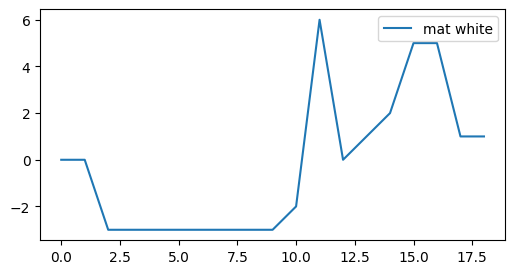

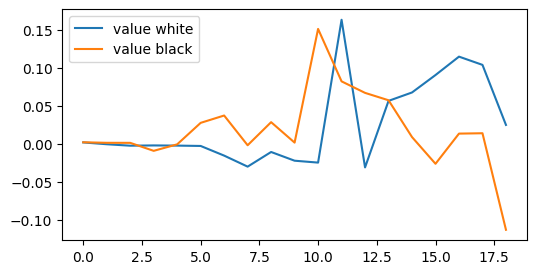

 -- 36560 -- winner: white, i: 23    wins: w = 21, b = 31, d = 76
 -- 36570 -- winner: black, i: 16    wins: w = 27, b = 35, d = 92
 -- 36580 -- winner: white, i: 65    wins: w = 35, b = 37, d = 100
 -- 36590 -- winner: black, i: 126    wins: w = 42, b = 40, d = 125
 -- 36600 -- winner: black, i: 16    wins: w = 47, b = 45, d = 139


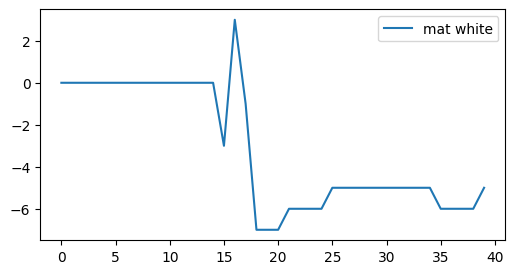

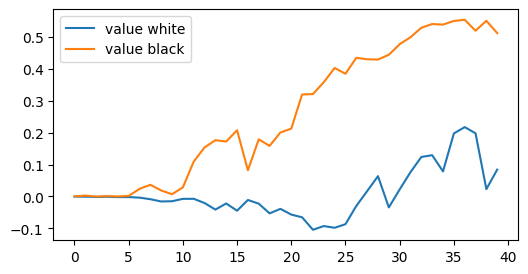

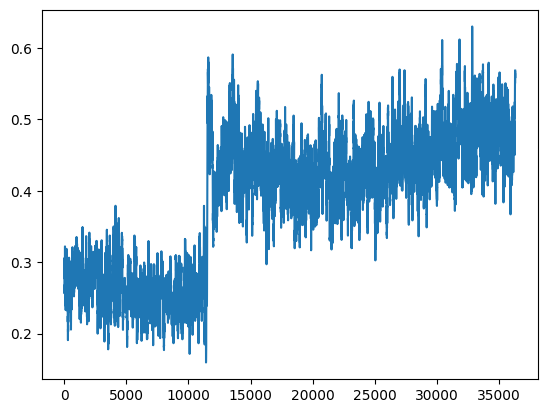

 -- 36610 -- winner: white, i: 25    wins: w = 51, b = 51, d = 154
 -- 36620 -- winner: black, i: 6    wins: w = 54, b = 58, d = 167
 -- 36630 -- winner: white, i: 79    wins: w = 59, b = 63, d = 182
 -- 36640 -- winner: black, i: 82    wins: w = 62, b = 70, d = 199
 -- 36650 -- winner: white, i: 37    wins: w = 65, b = 77, d = 219


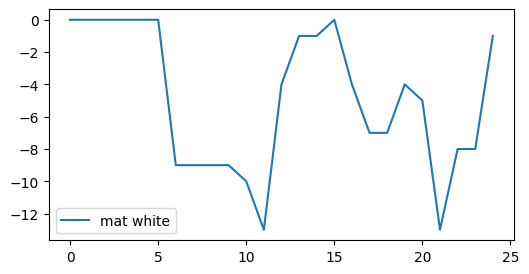

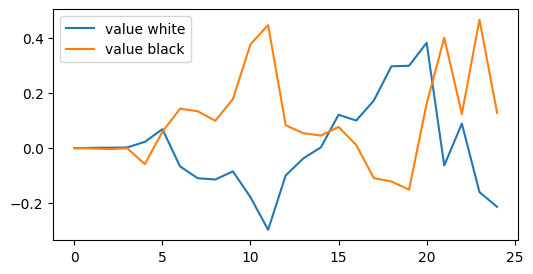

 -- 36660 -- winner: white, i: 93    wins: w = 74, b = 78, d = 236
 -- 36670 -- winner: white, i: 21    wins: w = 78, b = 84, d = 252
 -- 36680 -- winner: white, i: 65    wins: w = 83, b = 89, d = 266
 -- 36690 -- winner: white, i: 15    wins: w = 88, b = 94, d = 284
 -- 36700 -- winner: white, i: 105    wins: w = 93, b = 99, d = 300


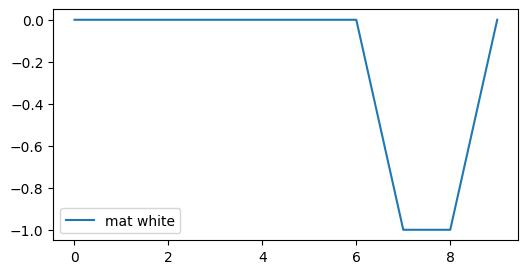

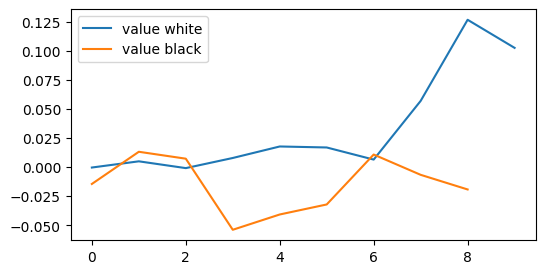

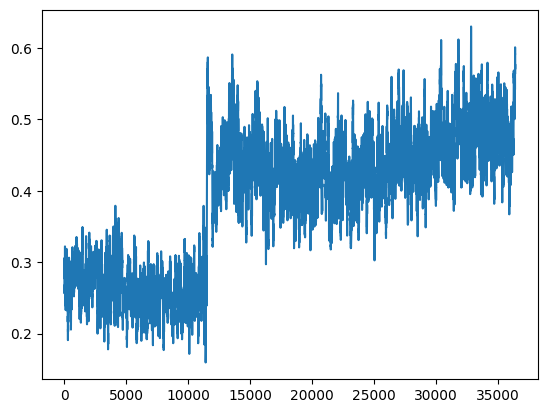

 -- 36710 -- winner: black, i: 8    wins: w = 98, b = 104, d = 310
 -- 36720 -- winner: black, i: 60    wins: w = 106, b = 106, d = 318
 -- 36730 -- winner: black, i: 162    wins: w = 111, b = 111, d = 332
 -- 36740 -- winner: black, i: 80    wins: w = 118, b = 114, d = 341
 -- 36750 -- winner: black, i: 212    wins: w = 123, b = 119, d = 347


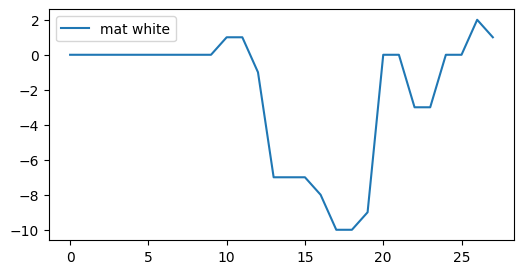

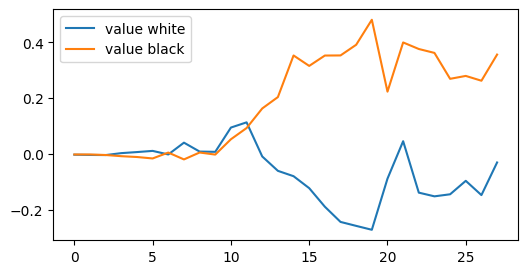

 -- 36760 -- winner: white, i: 77    wins: w = 129, b = 123, d = 367
 -- 36770 -- winner: black, i: 70    wins: w = 135, b = 127, d = 377
 -- 36780 -- winner: black, i: 98    wins: w = 142, b = 130, d = 388
 -- 36790 -- winner: white, i: 73    wins: w = 147, b = 135, d = 409
 -- 36800 -- winner: black, i: 94    wins: w = 151, b = 141, d = 413


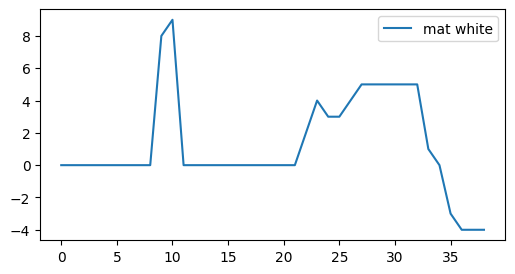

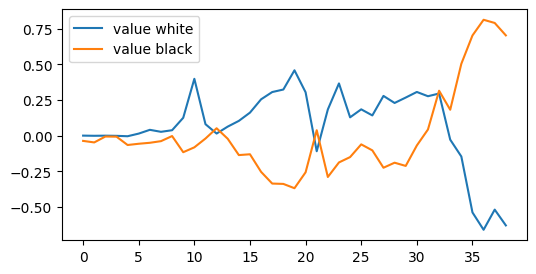

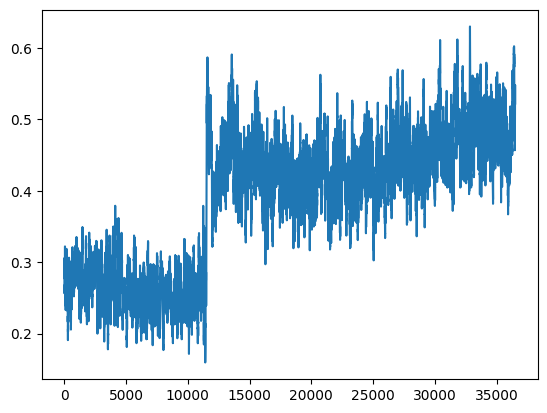

 -- 36810 -- winner: white, i: 25    wins: w = 157, b = 145, d = 430
 -- 36820 -- winner: black, i: 62    wins: w = 163, b = 149, d = 434
 -- 36830 -- winner: black, i: 90    wins: w = 169, b = 153, d = 444
 -- 36840 -- winner: white, i: 69    wins: w = 173, b = 159, d = 461
 -- 36850 -- winner: black, i: 18    wins: w = 179, b = 163, d = 472


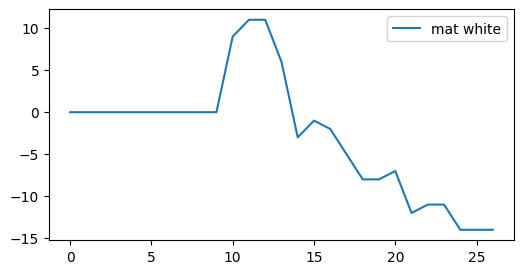

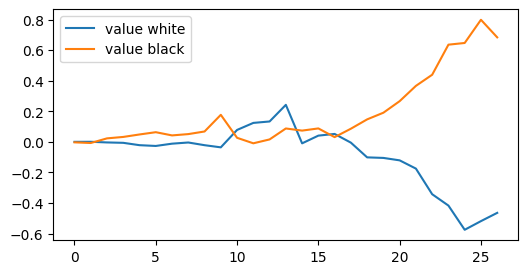

 -- 36860 -- winner: white, i: 101    wins: w = 182, b = 170, d = 487
 -- 36870 -- winner: white, i: 97    wins: w = 187, b = 175, d = 493
 -- 36880 -- winner: black, i: 98    wins: w = 191, b = 181, d = 506
 -- 36890 -- winner: white, i: 65    wins: w = 197, b = 185, d = 521
 -- 36900 -- winner: white, i: 87    wins: w = 203, b = 189, d = 530


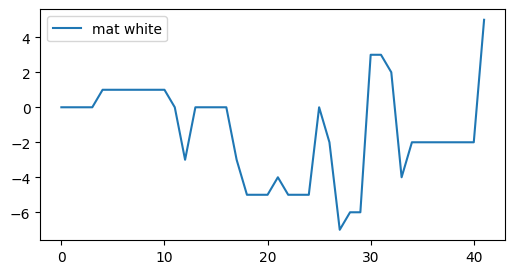

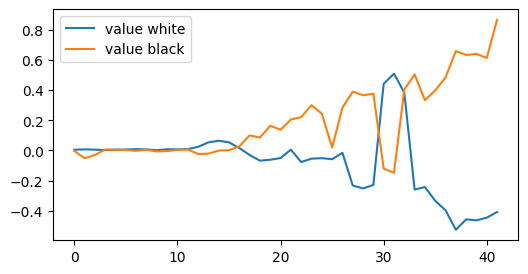

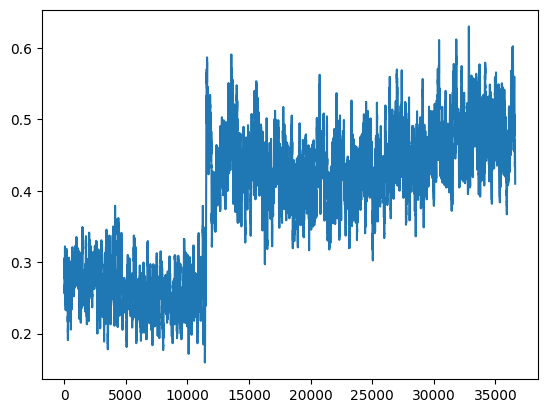

 -- 36910 -- winner: black, i: 60    wins: w = 207, b = 195, d = 543
game termianted, mat diff =  -3
 -- 36920 -- winner: black, i: 20    wins: w = 210, b = 202, d = 555
 -- 36930 -- winner: white, i: 85    wins: w = 217, b = 205, d = 572
 -- 36940 -- winner: black, i: 48    wins: w = 223, b = 209, d = 575
 -- 36950 -- winner: white, i: 11    wins: w = 228, b = 214, d = 590


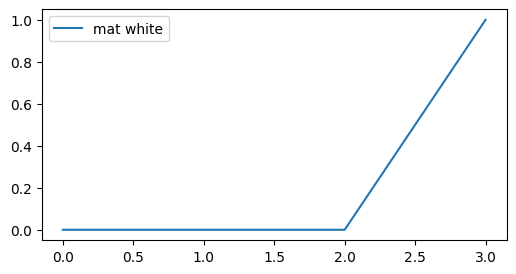

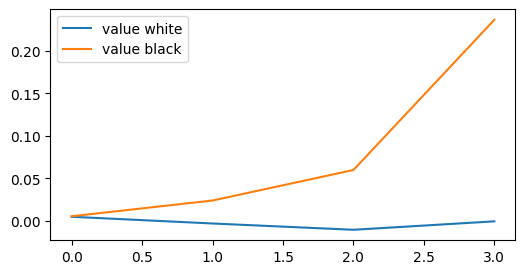

 -- 36960 -- winner: white, i: 53    wins: w = 232, b = 220, d = 608
 -- 36970 -- winner: black, i: 26    wins: w = 237, b = 225, d = 631
 -- 36980 -- winner: black, i: 88    wins: w = 239, b = 233, d = 651
 -- 36990 -- winner: white, i: 71    wins: w = 246, b = 236, d = 664
 -- 37000 -- winner: white, i: 33    wins: w = 250, b = 242, d = 680


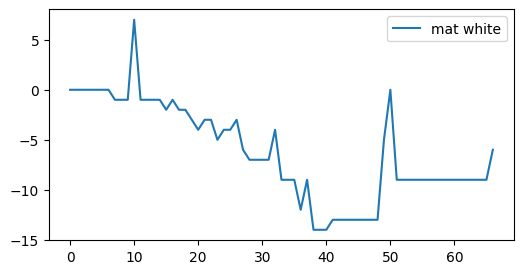

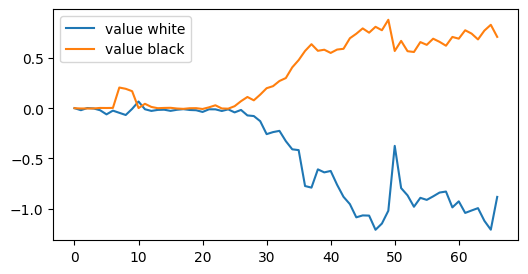

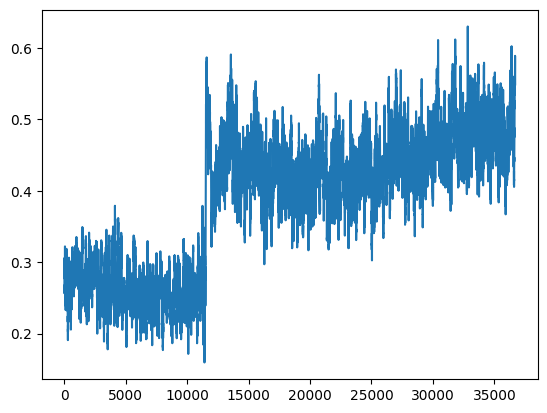

 -- 37010 -- winner: white, i: 39    wins: w = 257, b = 245, d = 699
 -- 37020 -- winner: white, i: 97    wins: w = 261, b = 251, d = 705
 -- 37030 -- winner: white, i: 85    wins: w = 267, b = 255, d = 711
 -- 37040 -- winner: white, i: 65    wins: w = 272, b = 260, d = 722
 -- 37050 -- winner: white, i: 75    wins: w = 278, b = 264, d = 731


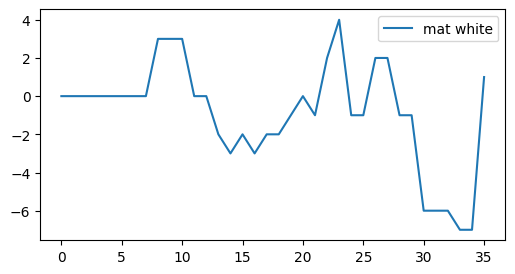

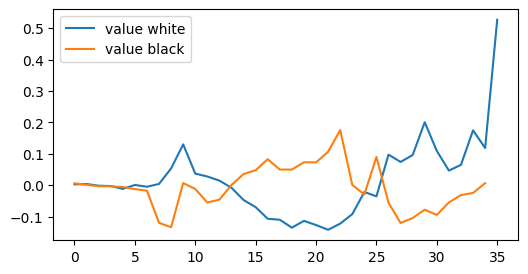

 -- 37060 -- winner: white, i: 67    wins: w = 286, b = 266, d = 748
 -- 37070 -- winner: white, i: 47    wins: w = 292, b = 270, d = 767
 -- 37080 -- winner: black, i: 110    wins: w = 298, b = 274, d = 777
 -- 37090 -- winner: black, i: 108    wins: w = 301, b = 281, d = 796
 -- 37100 -- winner: black, i: 26    wins: w = 306, b = 286, d = 815


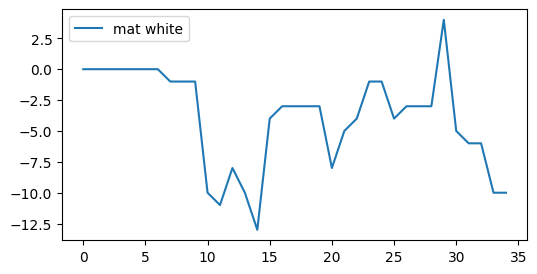

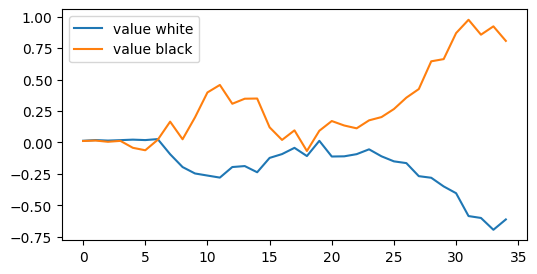

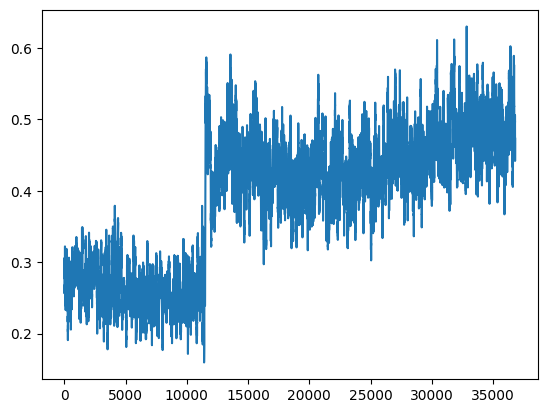

 -- 37110 -- winner: black, i: 92    wins: w = 309, b = 293, d = 827
 -- 37120 -- winner: black, i: 72    wins: w = 314, b = 298, d = 838
 -- 37130 -- winner: white, i: 73    wins: w = 322, b = 300, d = 852
 -- 37140 -- winner: white, i: 71    wins: w = 326, b = 306, d = 862
 -- 37150 -- winner: white, i: 61    wins: w = 329, b = 313, d = 886


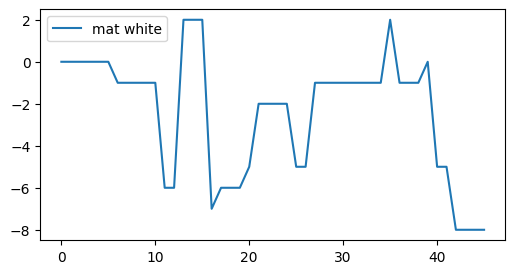

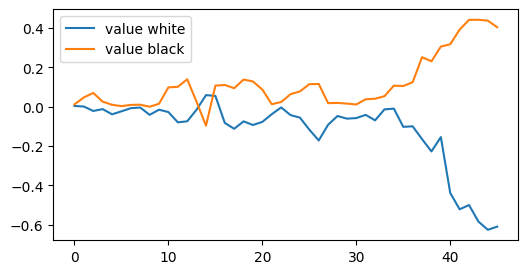

 -- 37160 -- winner: black, i: 88    wins: w = 331, b = 321, d = 905
 -- 37170 -- winner: white, i: 85    wins: w = 338, b = 324, d = 922
 -- 37180 -- winner: white, i: 79    wins: w = 344, b = 328, d = 932
 -- 37190 -- winner: white, i: 111    wins: w = 351, b = 331, d = 944
 -- 37200 -- winner: black, i: 62    wins: w = 357, b = 335, d = 951


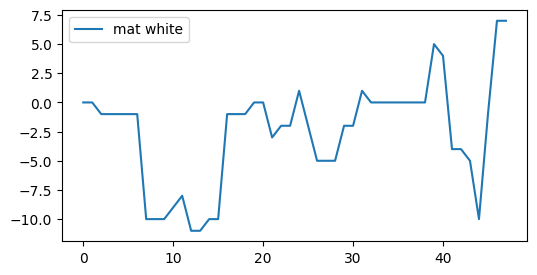

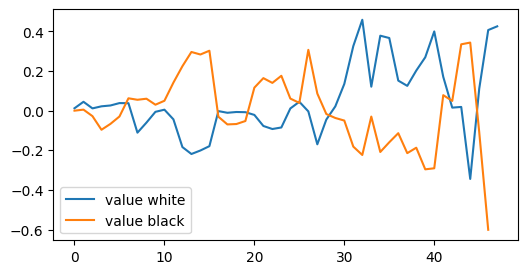

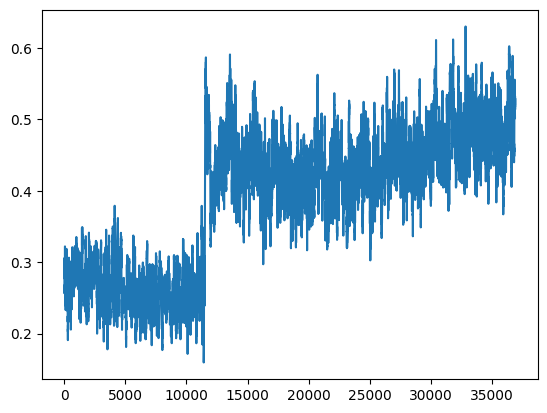

 -- 37210 -- winner: white, i: 15    wins: w = 364, b = 338, d = 966
 -- 37220 -- winner: white, i: 67    wins: w = 371, b = 341, d = 975
 -- 37230 -- winner: white, i: 15    wins: w = 379, b = 343, d = 987
 -- 37240 -- winner: white, i: 81    wins: w = 383, b = 349, d = 997
 -- 37250 -- winner: white, i: 63    wins: w = 388, b = 354, d = 1007


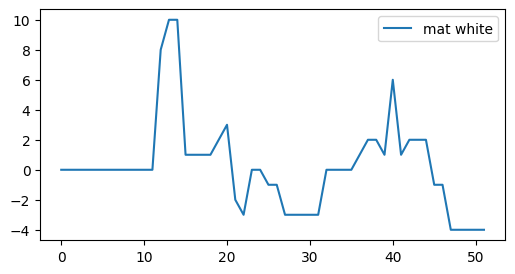

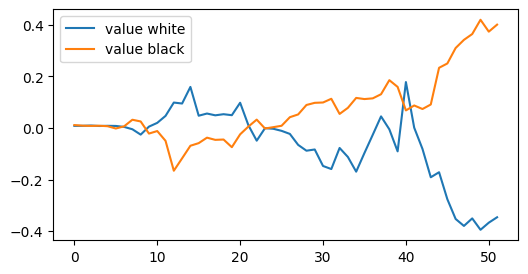

 -- 37260 -- winner: black, i: 58    wins: w = 389, b = 363, d = 1015
 -- 37270 -- winner: white, i: 9    wins: w = 395, b = 367, d = 1034
 -- 37280 -- winner: white, i: 35    wins: w = 400, b = 372, d = 1043
 -- 37290 -- winner: white, i: 127    wins: w = 405, b = 377, d = 1061
 -- 37300 -- winner: black, i: 56    wins: w = 411, b = 381, d = 1067


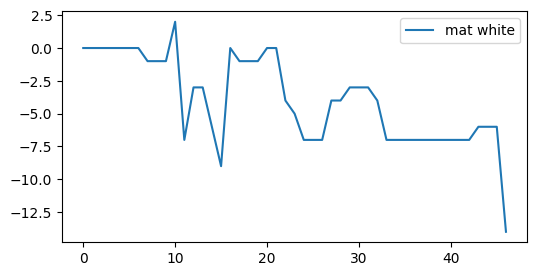

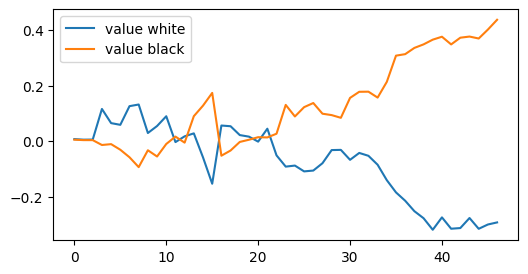

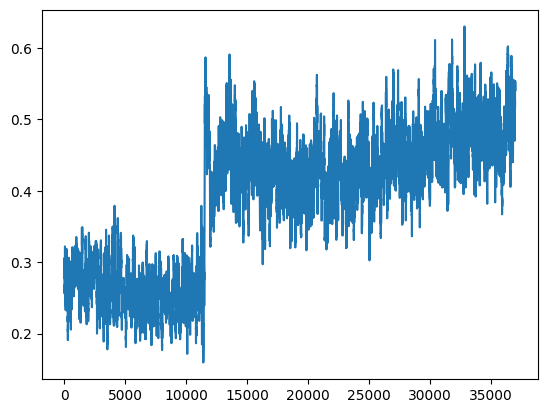

 -- 37310 -- winner: white, i: 65    wins: w = 416, b = 386, d = 1077
 -- 37320 -- winner: black, i: 98    wins: w = 420, b = 392, d = 1088
 -- 37330 -- winner: white, i: 45    wins: w = 425, b = 397, d = 1104
 -- 37340 -- winner: black, i: 90    wins: w = 432, b = 400, d = 1119
 -- 37350 -- winner: black, i: 94    wins: w = 435, b = 407, d = 1134


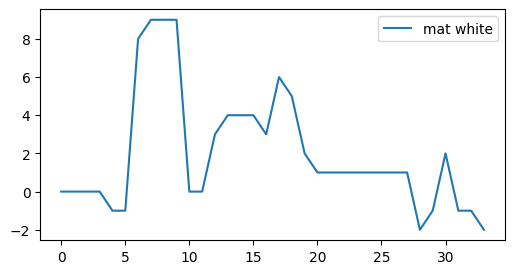

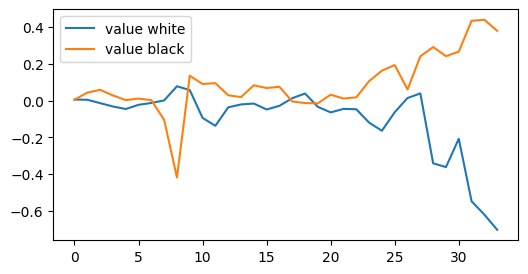

 -- 37360 -- winner: white, i: 31    wins: w = 441, b = 411, d = 1138
 -- 37370 -- winner: black, i: 116    wins: w = 448, b = 414, d = 1157
 -- 37380 -- winner: white, i: 13    wins: w = 453, b = 419, d = 1165
 -- 37390 -- winner: white, i: 71    wins: w = 459, b = 423, d = 1172
 -- 37400 -- winner: black, i: 72    wins: w = 463, b = 429, d = 1184


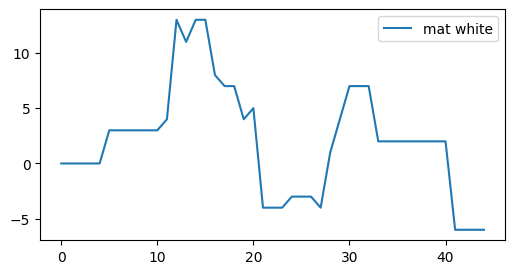

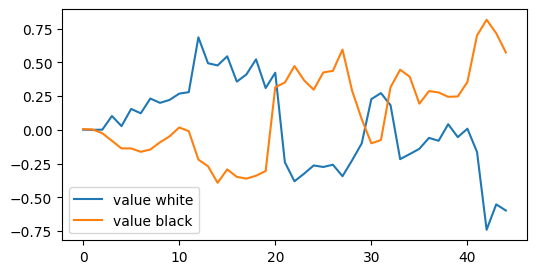

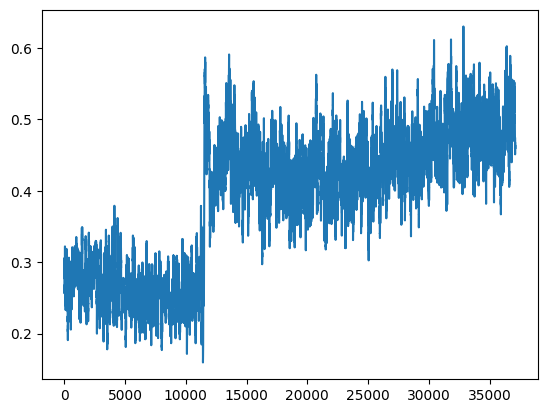

 -- 37410 -- winner: white, i: 277    wins: w = 470, b = 432, d = 1208
 -- 37420 -- winner: black, i: 4    wins: w = 473, b = 439, d = 1217
 -- 37430 -- winner: white, i: 71    wins: w = 476, b = 446, d = 1232
 -- 37440 -- winner: black, i: 62    wins: w = 477, b = 455, d = 1249
 -- 37450 -- winner: black, i: 68    wins: w = 483, b = 459, d = 1259


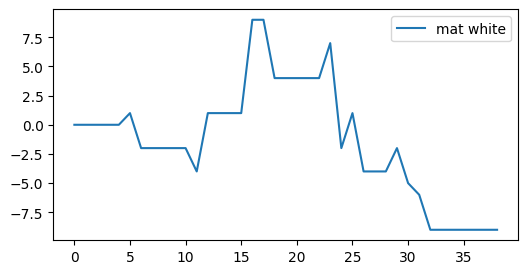

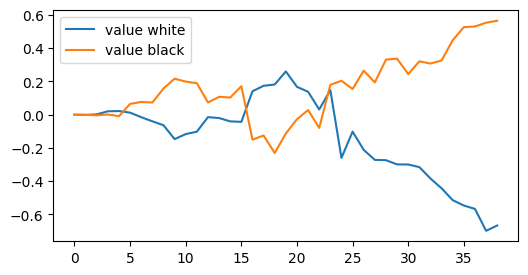

 -- 37460 -- winner: black, i: 44    wins: w = 489, b = 463, d = 1277
 -- 37470 -- winner: white, i: 95    wins: w = 494, b = 468, d = 1281
 -- 37480 -- winner: white, i: 75    wins: w = 500, b = 472, d = 1302
 -- 37490 -- winner: white, i: 49    wins: w = 506, b = 476, d = 1326
 -- 37500 -- winner: black, i: 50    wins: w = 510, b = 482, d = 1334


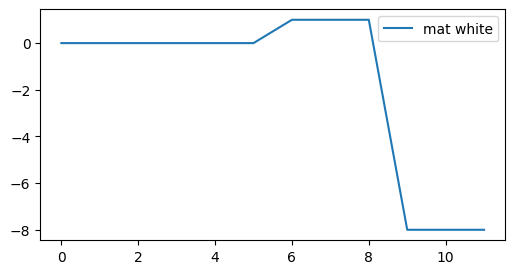

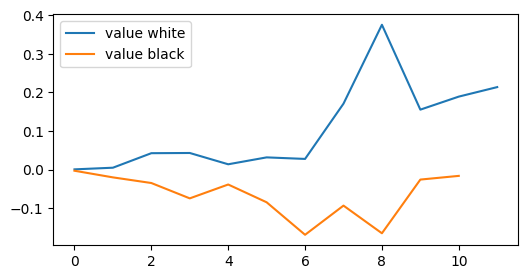

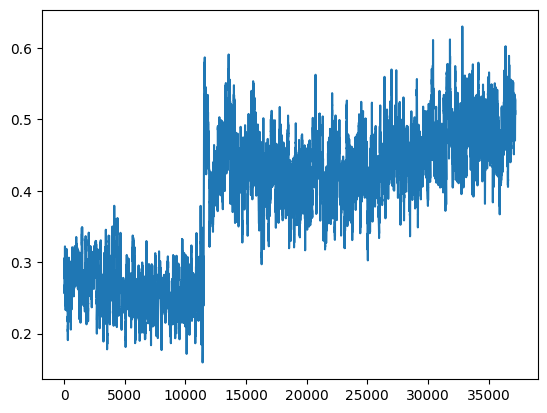

 -- 37510 -- winner: white, i: 15    wins: w = 518, b = 484, d = 1359
 -- 37520 -- winner: black, i: 118    wins: w = 519, b = 493, d = 1372
 -- 37530 -- winner: black, i: 8    wins: w = 524, b = 498, d = 1394
 -- 37540 -- winner: black, i: 74    wins: w = 529, b = 503, d = 1400
 -- 37550 -- winner: white, i: 77    wins: w = 532, b = 510, d = 1418


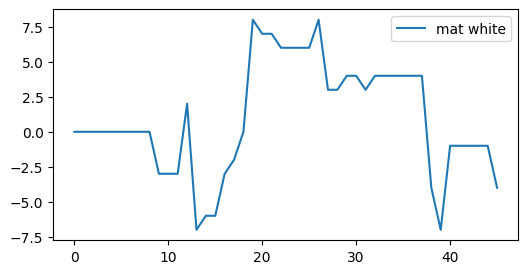

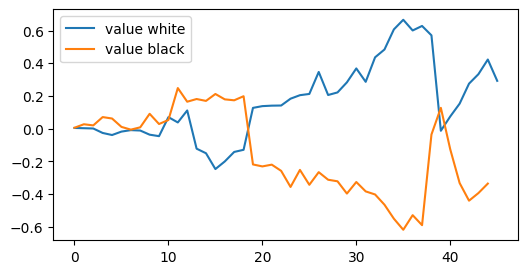

 -- 37560 -- winner: white, i: 97    wins: w = 536, b = 516, d = 1433
 -- 37570 -- winner: white, i: 77    wins: w = 543, b = 519, d = 1452
 -- 37580 -- winner: black, i: 58    wins: w = 549, b = 523, d = 1478
 -- 37590 -- winner: white, i: 71    wins: w = 556, b = 526, d = 1492
 -- 37600 -- winner: black, i: 70    wins: w = 559, b = 533, d = 1511


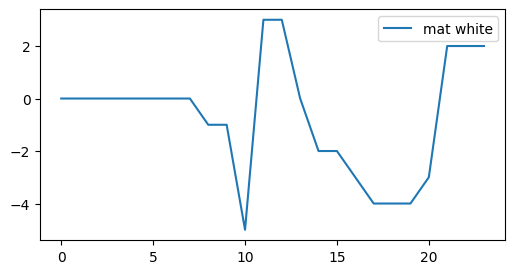

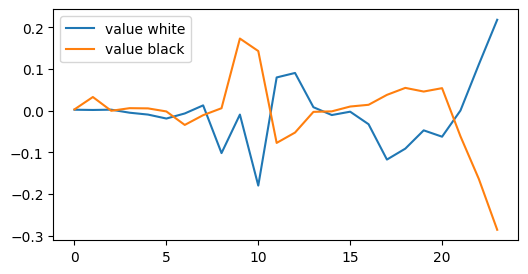

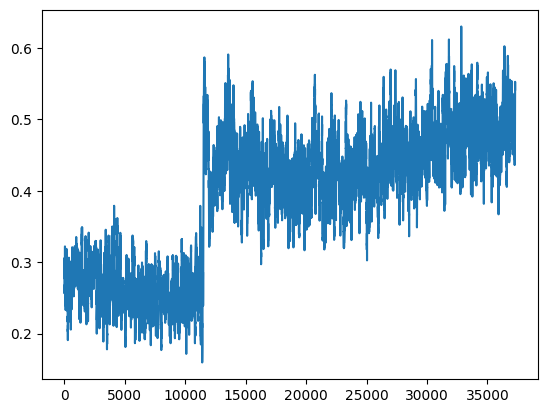

 -- 37610 -- winner: black, i: 22    wins: w = 561, b = 541, d = 1534
 -- 37620 -- winner: black, i: 52    wins: w = 566, b = 546, d = 1552
 -- 37630 -- winner: black, i: 34    wins: w = 571, b = 551, d = 1568
 -- 37640 -- winner: black, i: 152    wins: w = 573, b = 559, d = 1580
 -- 37650 -- winner: black, i: 90    wins: w = 575, b = 567, d = 1599


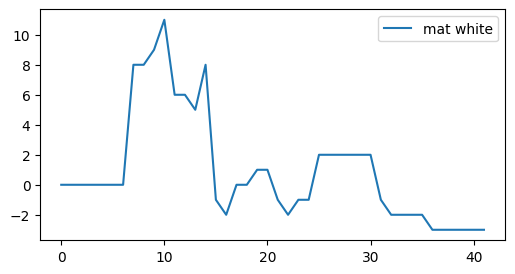

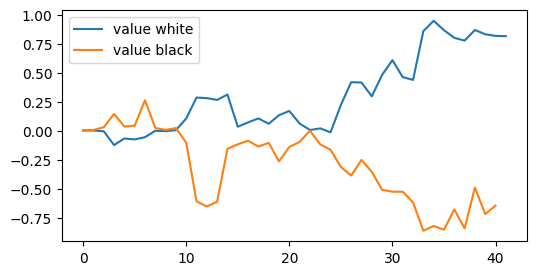

 -- 37660 -- winner: white, i: 83    wins: w = 579, b = 573, d = 1613
 -- 37670 -- winner: black, i: 82    wins: w = 581, b = 581, d = 1633
 -- 37680 -- winner: white, i: 105    wins: w = 589, b = 583, d = 1651
 -- 37690 -- winner: black, i: 110    wins: w = 597, b = 585, d = 1662
 -- 37700 -- winner: black, i: 16    wins: w = 602, b = 590, d = 1675


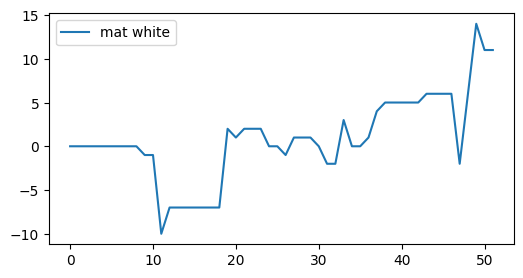

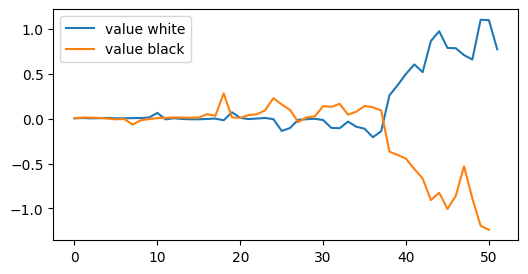

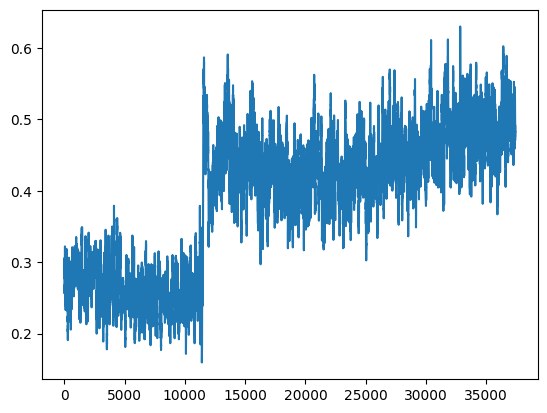

 -- 37710 -- winner: black, i: 54    wins: w = 605, b = 597, d = 1685
 -- 37720 -- winner: black, i: 30    wins: w = 609, b = 603, d = 1706
 -- 37730 -- winner: black, i: 36    wins: w = 617, b = 605, d = 1724
 -- 37740 -- winner: black, i: 74    wins: w = 623, b = 609, d = 1742
 -- 37750 -- winner: black, i: 92    wins: w = 630, b = 612, d = 1761


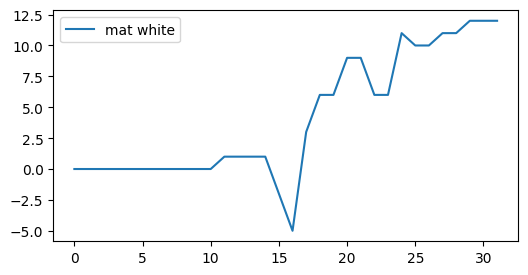

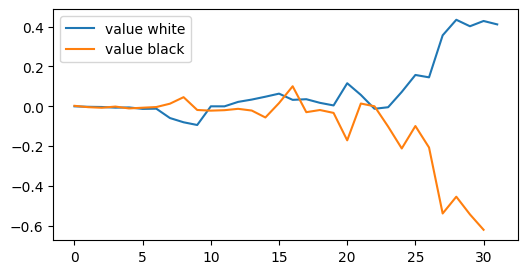

 -- 37760 -- winner: white, i: 79    wins: w = 636, b = 616, d = 1771
 -- 37770 -- winner: black, i: 68    wins: w = 639, b = 623, d = 1786
 -- 37780 -- winner: black, i: 164    wins: w = 644, b = 628, d = 1806
 -- 37790 -- winner: white, i: 15    wins: w = 651, b = 631, d = 1818
 -- 37800 -- winner: white, i: 89    wins: w = 659, b = 633, d = 1830


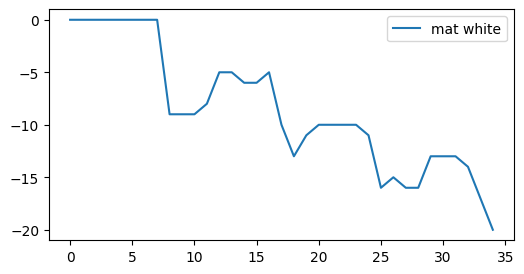

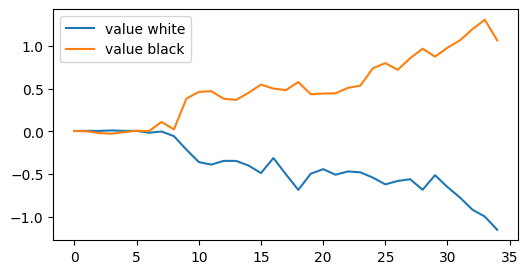

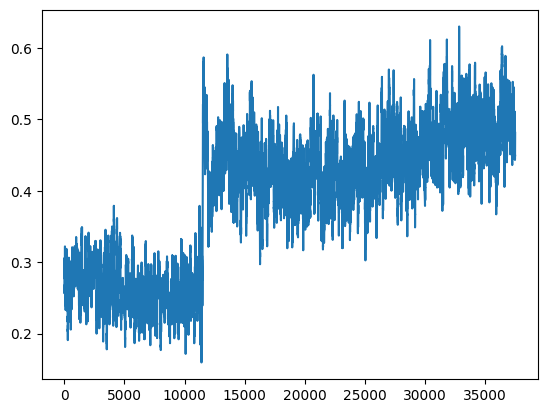

 -- 37810 -- winner: black, i: 90    wins: w = 666, b = 636, d = 1840
 -- 37820 -- winner: black, i: 94    wins: w = 673, b = 639, d = 1862
 -- 37830 -- winner: black, i: 82    wins: w = 676, b = 646, d = 1879
 -- 37840 -- winner: white, i: 39    wins: w = 683, b = 649, d = 1903
 -- 37850 -- winner: black, i: 84    wins: w = 689, b = 653, d = 1920


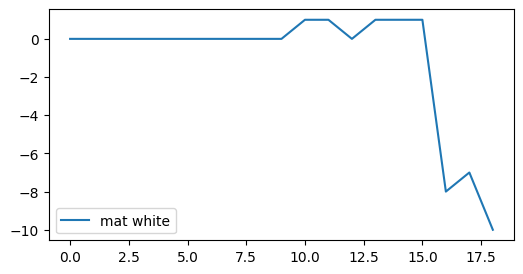

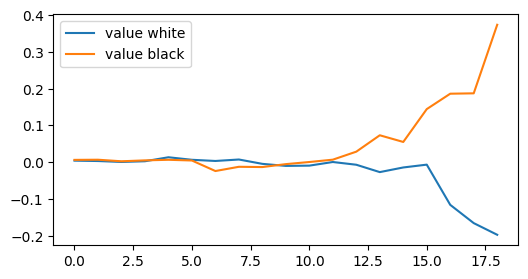

 -- 37860 -- winner: black, i: 62    wins: w = 692, b = 660, d = 1941
 -- 37870 -- winner: white, i: 69    wins: w = 698, b = 664, d = 1951
 -- 37880 -- winner: white, i: 97    wins: w = 705, b = 667, d = 1974
 -- 37890 -- winner: black, i: 96    wins: w = 706, b = 676, d = 1991
 -- 37900 -- winner: white, i: 23    wins: w = 714, b = 678, d = 2002


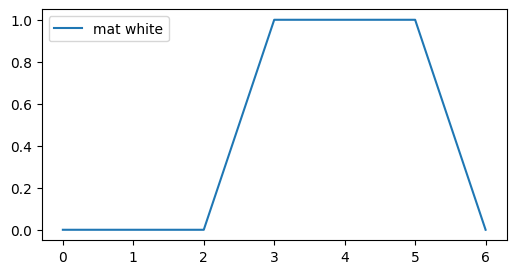

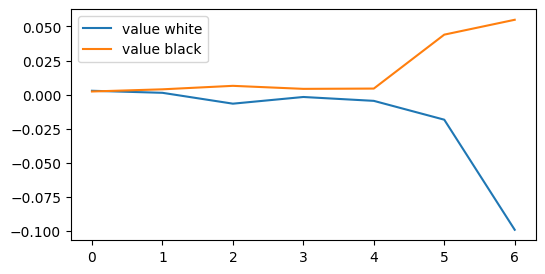

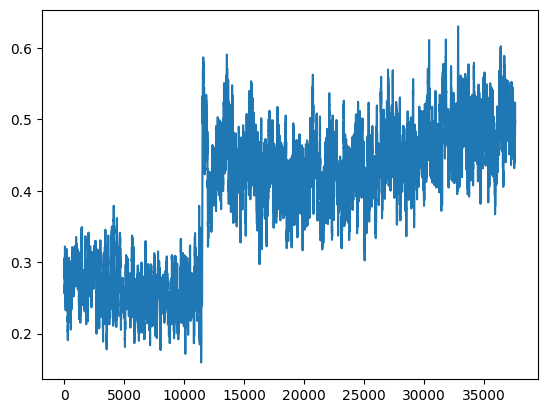

 -- 37910 -- winner: black, i: 14    wins: w = 721, b = 681, d = 2034
 -- 37920 -- winner: black, i: 60    wins: w = 727, b = 685, d = 2045
 -- 37930 -- winner: white, i: 75    wins: w = 736, b = 686, d = 2069
 -- 37940 -- winner: black, i: 60    wins: w = 741, b = 691, d = 2074
 -- 37950 -- winner: black, i: 8    wins: w = 748, b = 694, d = 2085


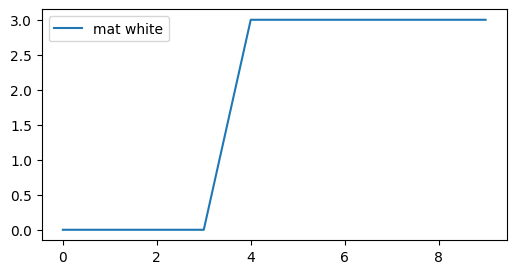

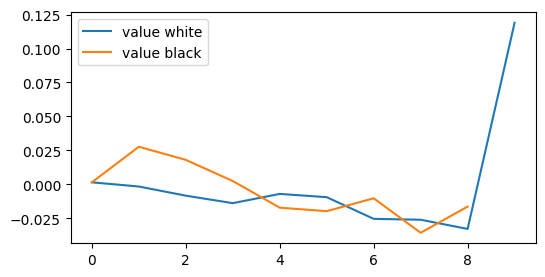

 -- 37960 -- winner: white, i: 73    wins: w = 754, b = 698, d = 2100
 -- 37970 -- winner: black, i: 48    wins: w = 757, b = 705, d = 2120
 -- 37980 -- winner: white, i: 75    wins: w = 764, b = 708, d = 2145
 -- 37990 -- winner: white, i: 63    wins: w = 770, b = 712, d = 2158
 -- 38000 -- winner: black, i: 50    wins: w = 772, b = 720, d = 2178


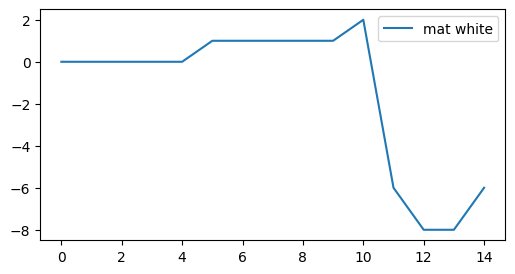

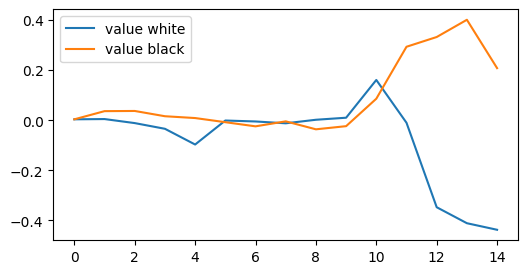

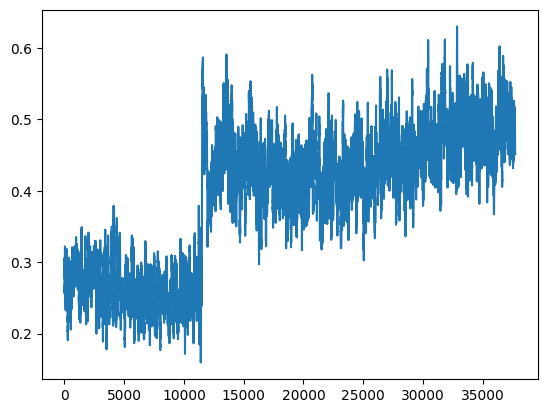

 -- 38010 -- winner: white, i: 71    wins: w = 776, b = 726, d = 2182
 -- 38020 -- winner: black, i: 62    wins: w = 779, b = 733, d = 2194
 -- 38030 -- winner: white, i: 19    wins: w = 785, b = 737, d = 2203
 -- 38040 -- winner: white, i: 13    wins: w = 792, b = 740, d = 2231
 -- 38050 -- winner: white, i: 51    wins: w = 798, b = 744, d = 2250


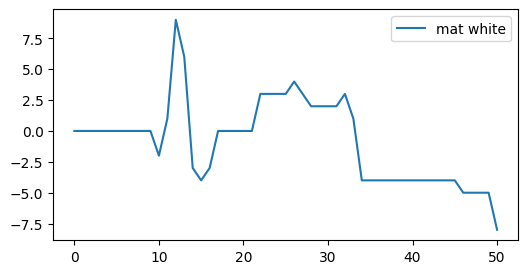

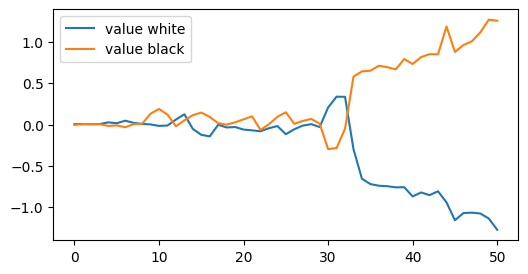

 -- 38060 -- winner: white, i: 89    wins: w = 802, b = 750, d = 2271
 -- 38070 -- winner: black, i: 80    wins: w = 805, b = 757, d = 2288
 -- 38080 -- winner: white, i: 61    wins: w = 813, b = 759, d = 2302
 -- 38090 -- winner: black, i: 88    wins: w = 818, b = 764, d = 2322
 -- 38100 -- winner: black, i: 132    wins: w = 821, b = 771, d = 2331


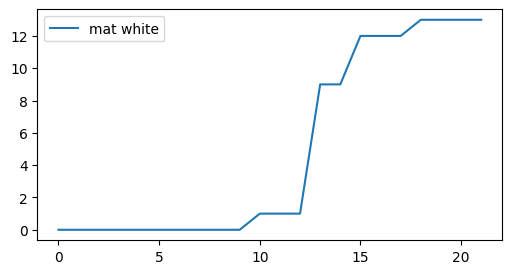

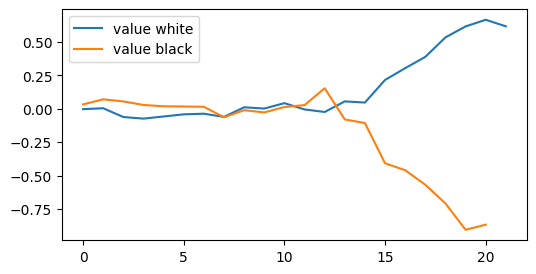

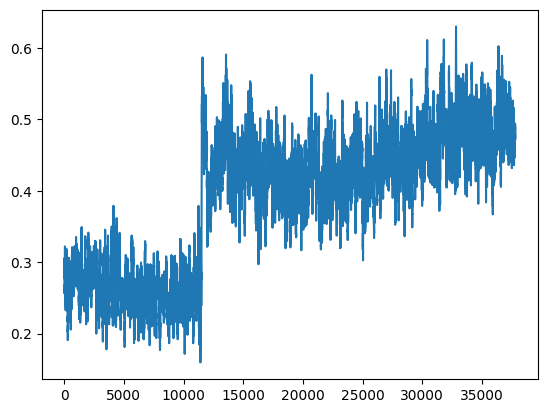

 -- 38110 -- winner: white, i: 37    wins: w = 827, b = 775, d = 2339
 -- 38120 -- winner: black, i: 70    wins: w = 831, b = 781, d = 2356
 -- 38130 -- winner: black, i: 4    wins: w = 836, b = 786, d = 2365
 -- 38140 -- winner: white, i: 65    wins: w = 840, b = 792, d = 2376
 -- 38150 -- winner: black, i: 56    wins: w = 845, b = 797, d = 2384


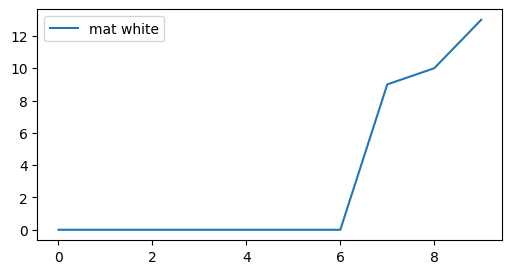

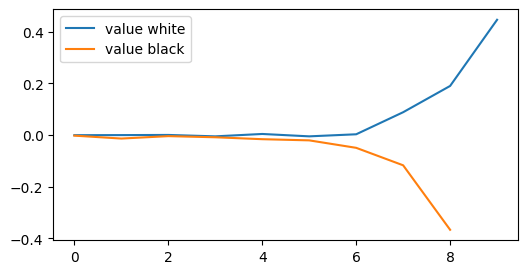

 -- 38160 -- winner: white, i: 55    wins: w = 850, b = 802, d = 2402
 -- 38170 -- winner: black, i: 26    wins: w = 853, b = 809, d = 2419
 -- 38180 -- winner: white, i: 73    wins: w = 857, b = 815, d = 2429
 -- 38190 -- winner: white, i: 11    wins: w = 862, b = 820, d = 2439
 -- 38200 -- winner: white, i: 97    wins: w = 870, b = 822, d = 2465


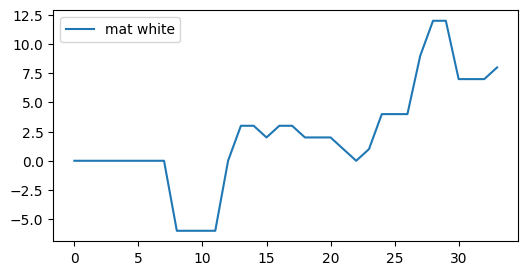

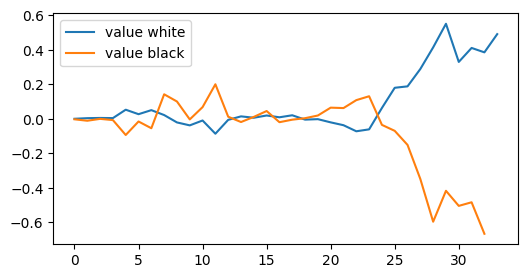

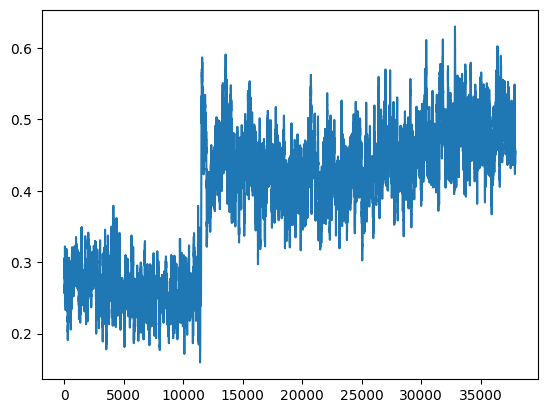

 -- 38210 -- winner: white, i: 69    wins: w = 876, b = 826, d = 2476
 -- 38220 -- winner: white, i: 53    wins: w = 882, b = 830, d = 2487
 -- 38230 -- winner: black, i: 70    wins: w = 888, b = 834, d = 2503
 -- 38240 -- winner: black, i: 80    wins: w = 893, b = 839, d = 2515
 -- 38250 -- winner: black, i: 6    wins: w = 900, b = 842, d = 2529


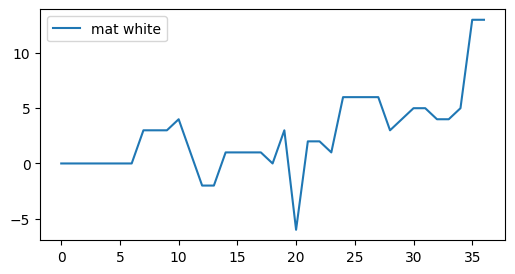

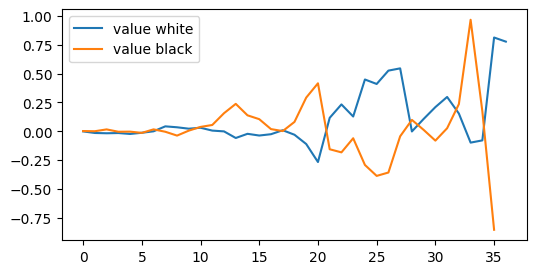

 -- 38260 -- winner: black, i: 44    wins: w = 904, b = 848, d = 2539
 -- 38270 -- winner: white, i: 97    wins: w = 911, b = 851, d = 2562
 -- 38280 -- winner: black, i: 14    wins: w = 916, b = 856, d = 2569
 -- 38290 -- winner: white, i: 9    wins: w = 922, b = 860, d = 2588
 -- 38300 -- winner: black, i: 96    wins: w = 929, b = 863, d = 2600


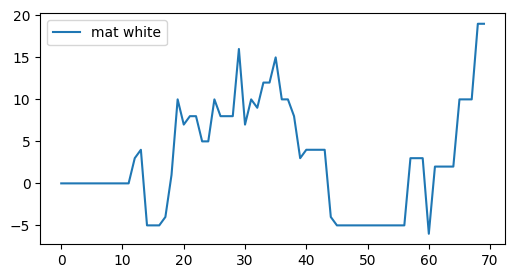

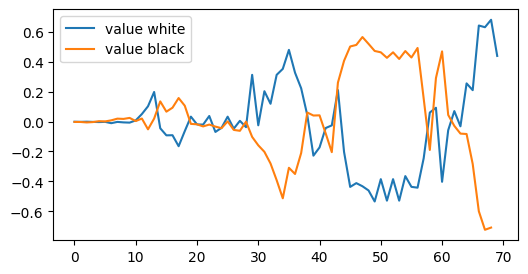

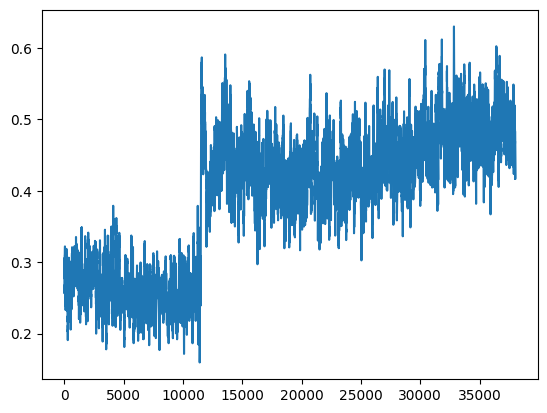

 -- 38310 -- winner: black, i: 94    wins: w = 936, b = 866, d = 2620
 -- 38320 -- winner: black, i: 54    wins: w = 939, b = 873, d = 2640
 -- 38330 -- winner: white, i: 45    wins: w = 946, b = 876, d = 2667
 -- 38340 -- winner: black, i: 66    wins: w = 951, b = 881, d = 2680
 -- 38350 -- winner: white, i: 5    wins: w = 957, b = 885, d = 2692


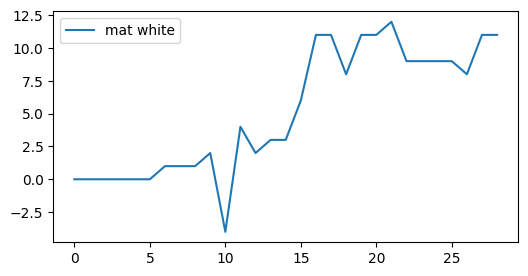

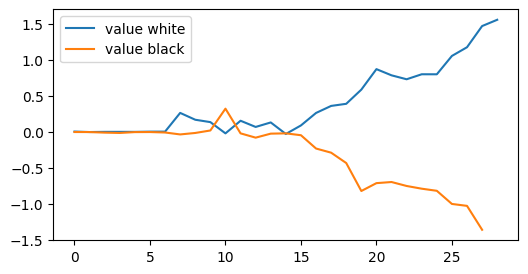

 -- 38360 -- winner: black, i: 102    wins: w = 962, b = 890, d = 2707
 -- 38370 -- winner: white, i: 77    wins: w = 968, b = 894, d = 2729
 -- 38380 -- winner: black, i: 30    wins: w = 969, b = 903, d = 2737
 -- 38390 -- winner: white, i: 67    wins: w = 976, b = 906, d = 2748
 -- 38400 -- winner: white, i: 51    wins: w = 982, b = 910, d = 2767


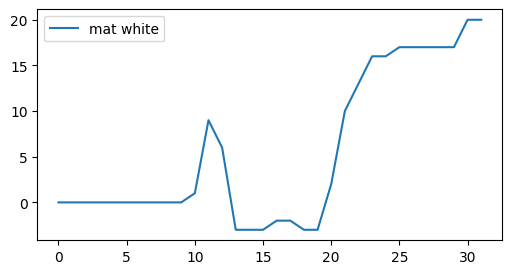

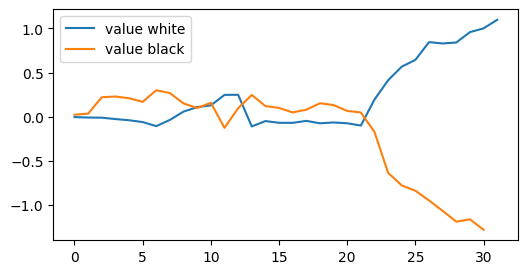

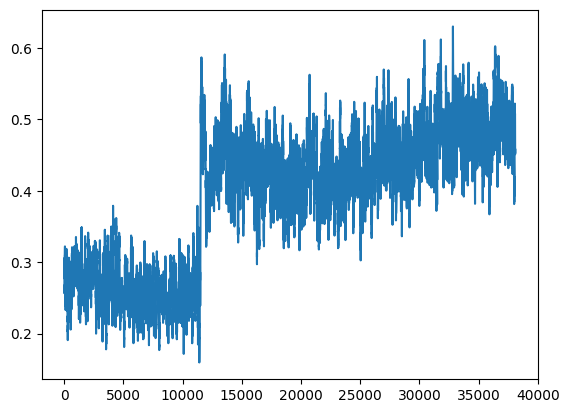

 -- 38410 -- winner: black, i: 16    wins: w = 991, b = 911, d = 2788
 -- 38420 -- winner: white, i: 27    wins: w = 996, b = 916, d = 2799
 -- 38430 -- winner: white, i: 75    wins: w = 1001, b = 921, d = 2812
 -- 38440 -- winner: black, i: 70    wins: w = 1006, b = 926, d = 2827
 -- 38450 -- winner: white, i: 67    wins: w = 1012, b = 930, d = 2845


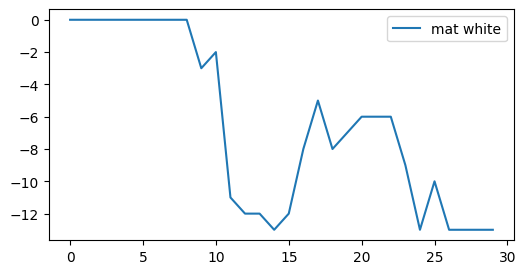

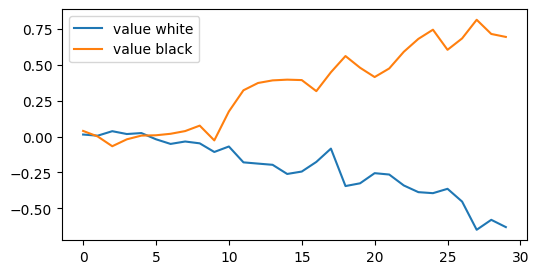

 -- 38460 -- winner: black, i: 116    wins: w = 1016, b = 936, d = 2874
 -- 38470 -- winner: black, i: 126    wins: w = 1020, b = 942, d = 2895
 -- 38480 -- winner: white, i: 85    wins: w = 1027, b = 945, d = 2917
 -- 38490 -- winner: white, i: 85    wins: w = 1032, b = 950, d = 2933
 -- 38500 -- winner: white, i: 53    wins: w = 1037, b = 955, d = 2946


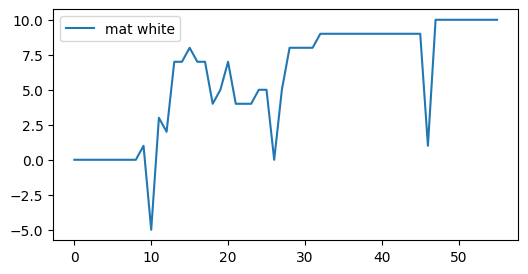

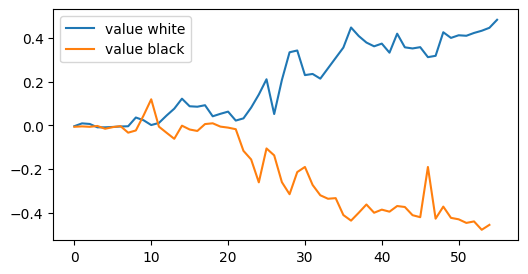

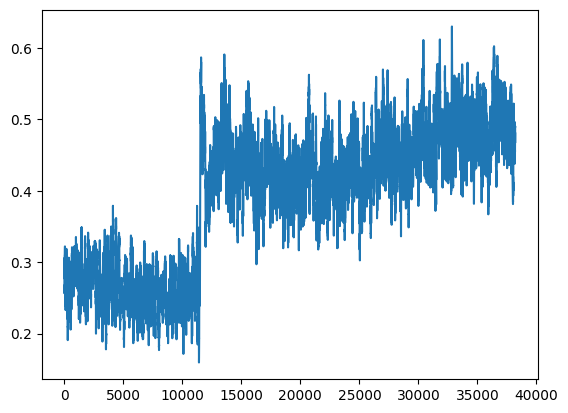

 -- 38510 -- winner: white, i: 49    wins: w = 1042, b = 960, d = 2959
 -- 38520 -- winner: white, i: 13    wins: w = 1050, b = 962, d = 2968
 -- 38530 -- winner: white, i: 61    wins: w = 1052, b = 970, d = 2985
 -- 38540 -- winner: black, i: 90    wins: w = 1056, b = 976, d = 3008
 -- 38550 -- winner: white, i: 95    wins: w = 1061, b = 981, d = 3028


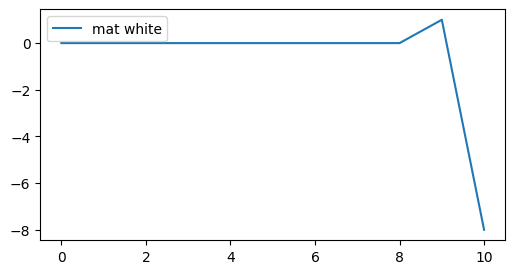

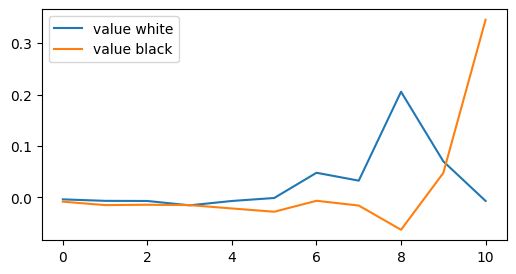

 -- 38560 -- winner: white, i: 111    wins: w = 1065, b = 987, d = 3046
 -- 38570 -- winner: black, i: 94    wins: w = 1069, b = 993, d = 3061
 -- 38580 -- winner: white, i: 21    wins: w = 1073, b = 999, d = 3083
 -- 38590 -- winner: white, i: 81    wins: w = 1079, b = 1003, d = 3103
 -- 38600 -- winner: black, i: 146    wins: w = 1084, b = 1008, d = 3115


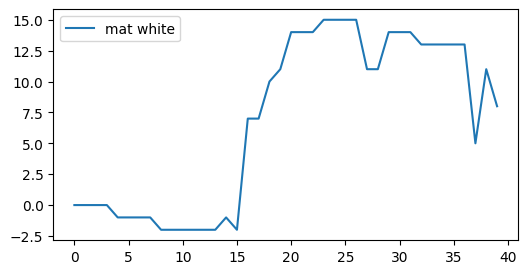

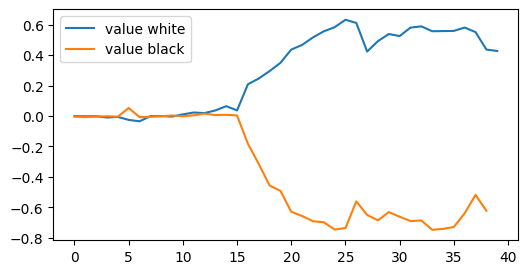

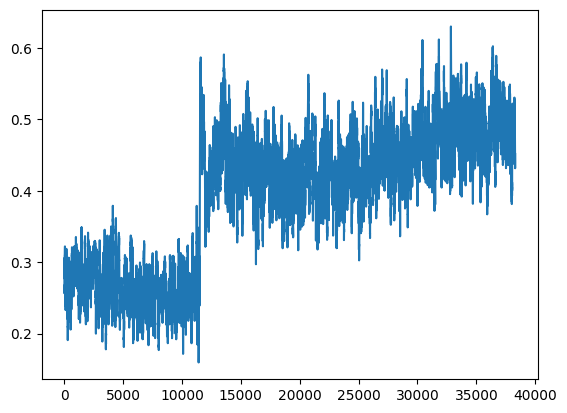

 -- 38610 -- winner: white, i: 31    wins: w = 1092, b = 1010, d = 3124
 -- 38620 -- winner: white, i: 41    wins: w = 1096, b = 1016, d = 3136
 -- 38630 -- winner: black, i: 130    wins: w = 1101, b = 1021, d = 3149
 -- 38640 -- winner: white, i: 67    wins: w = 1109, b = 1023, d = 3164
 -- 38650 -- winner: white, i: 35    wins: w = 1116, b = 1026, d = 3189


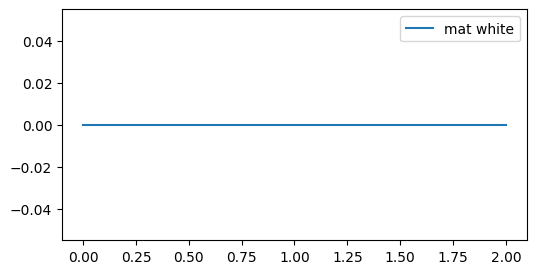

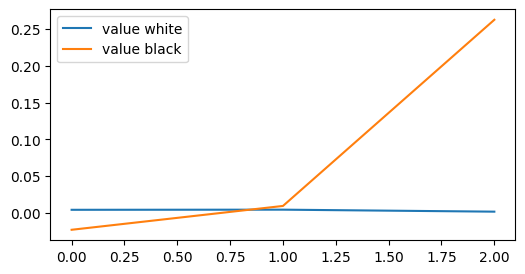

 -- 38660 -- winner: black, i: 104    wins: w = 1120, b = 1032, d = 3212
 -- 38670 -- winner: white, i: 51    wins: w = 1126, b = 1036, d = 3230
 -- 38680 -- winner: white, i: 13    wins: w = 1133, b = 1039, d = 3245
 -- 38690 -- winner: black, i: 120    wins: w = 1137, b = 1045, d = 3260
 -- 38700 -- winner: black, i: 108    wins: w = 1140, b = 1052, d = 3280


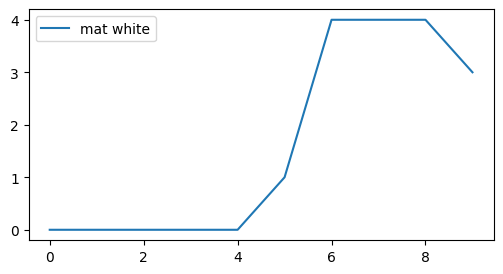

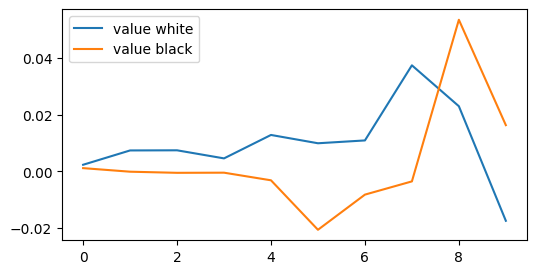

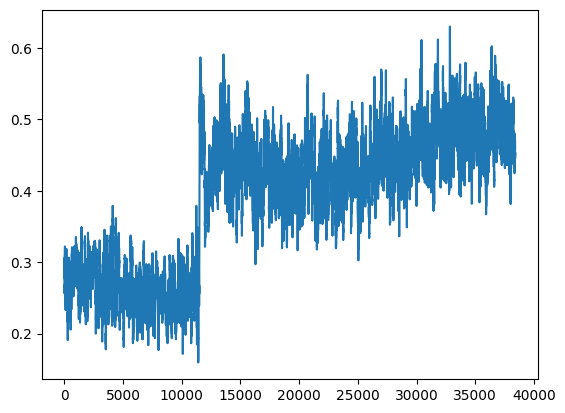

 -- 38710 -- winner: black, i: 84    wins: w = 1144, b = 1058, d = 3302
 -- 38720 -- winner: white, i: 119    wins: w = 1150, b = 1062, d = 3314
 -- 38730 -- winner: black, i: 100    wins: w = 1155, b = 1067, d = 3329
 -- 38740 -- winner: black, i: 30    wins: w = 1158, b = 1074, d = 3341
 -- 38750 -- winner: white, i: 145    wins: w = 1160, b = 1082, d = 3354


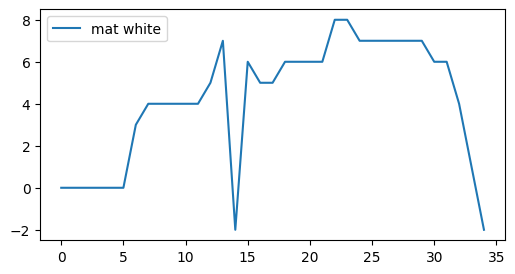

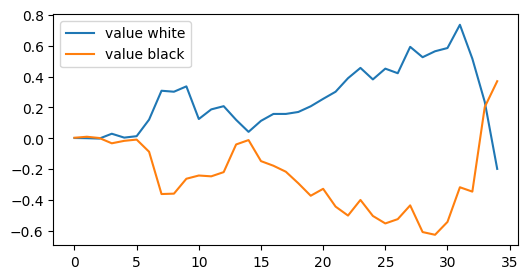

 -- 38760 -- winner: white, i: 75    wins: w = 1163, b = 1089, d = 3360
 -- 38770 -- winner: black, i: 4    wins: w = 1168, b = 1094, d = 3382
 -- 38780 -- winner: black, i: 78    wins: w = 1172, b = 1100, d = 3402
 -- 38790 -- winner: black, i: 56    wins: w = 1177, b = 1105, d = 3409
 -- 38800 -- winner: white, i: 121    wins: w = 1183, b = 1109, d = 3425


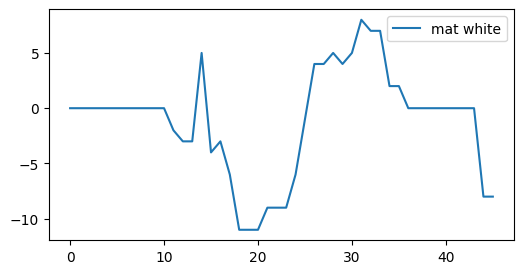

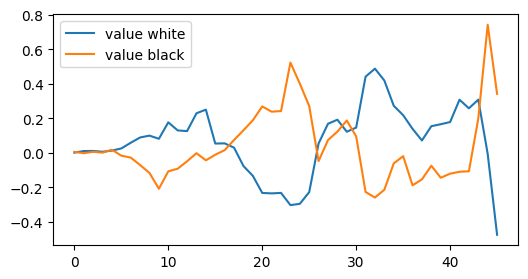

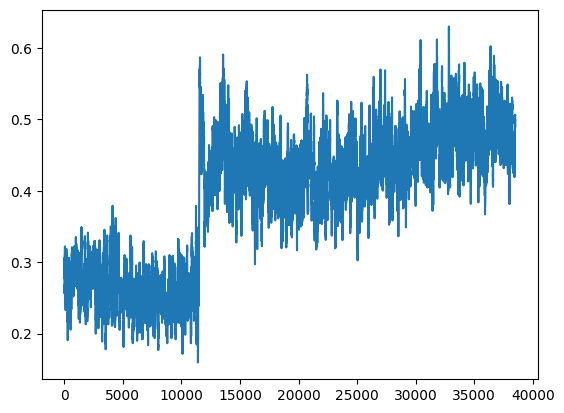

 -- 38810 -- winner: white, i: 107    wins: w = 1187, b = 1115, d = 3454
 -- 38820 -- winner: black, i: 44    wins: w = 1191, b = 1121, d = 3476
 -- 38830 -- winner: black, i: 90    wins: w = 1197, b = 1125, d = 3484
 -- 38840 -- winner: black, i: 120    wins: w = 1203, b = 1129, d = 3508
 -- 38850 -- winner: white, i: 111    wins: w = 1208, b = 1134, d = 3525


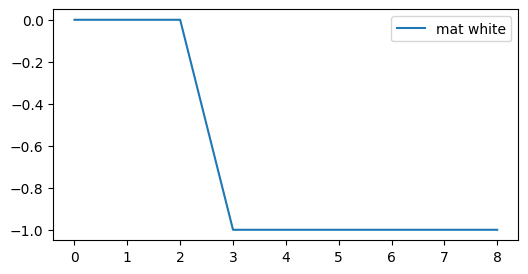

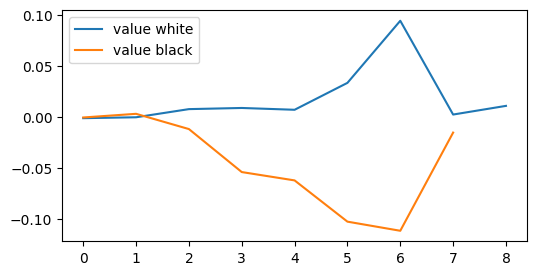

 -- 38860 -- winner: white, i: 87    wins: w = 1214, b = 1138, d = 3542
game termianted, mat diff =  20
 -- 38870 -- winner: white, i: 93    wins: w = 1218.5, b = 1143, d = 3557
 -- 38880 -- winner: black, i: 10    wins: w = 1222.5, b = 1149, d = 3585
 -- 38890 -- winner: black, i: 46    wins: w = 1227.5, b = 1154, d = 3617
 -- 38900 -- winner: black, i: 60    wins: w = 1235.5, b = 1156, d = 3642


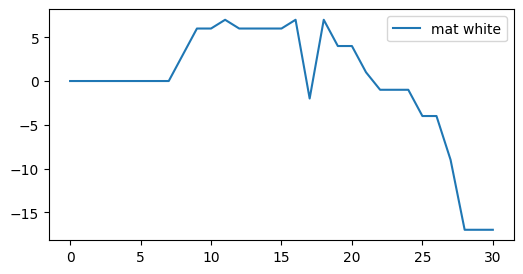

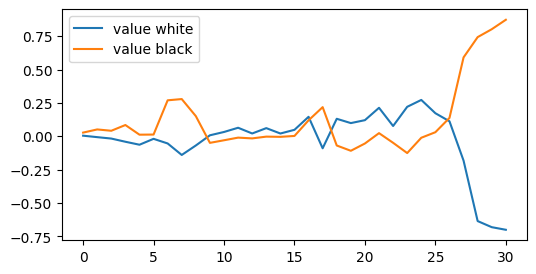

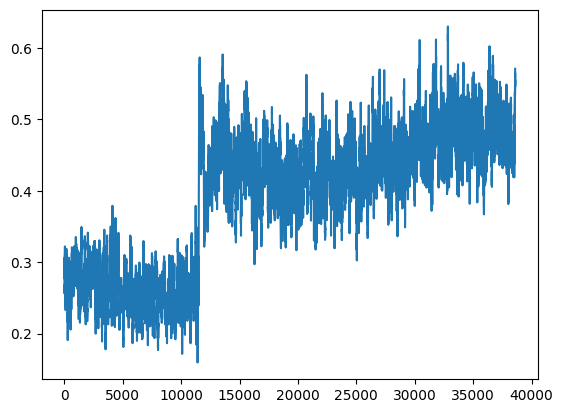

 -- 38910 -- winner: white, i: 7    wins: w = 1239.5, b = 1162, d = 3657
 -- 38920 -- winner: white, i: 127    wins: w = 1244.5, b = 1167, d = 3668
 -- 38930 -- winner: black, i: 40    wins: w = 1253.5, b = 1168, d = 3706
 -- 38940 -- winner: black, i: 60    wins: w = 1258.5, b = 1173, d = 3717
 -- 38950 -- winner: black, i: 12    wins: w = 1263.5, b = 1178, d = 3739


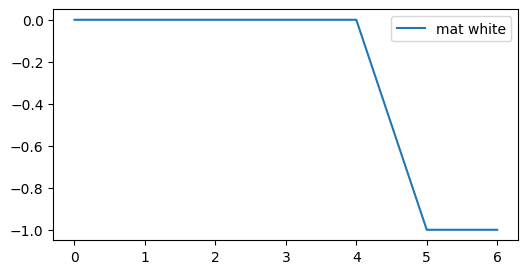

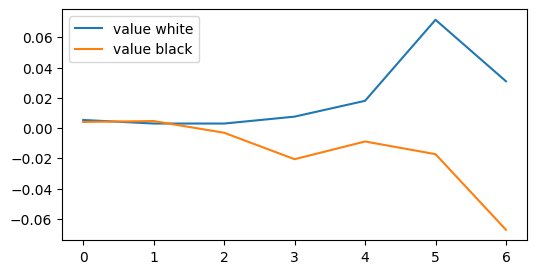

 -- 38960 -- winner: black, i: 98    wins: w = 1269.5, b = 1182, d = 3775
 -- 38970 -- winner: black, i: 70    wins: w = 1273.5, b = 1188, d = 3808
 -- 38980 -- winner: black, i: 84    wins: w = 1277.5, b = 1194, d = 3816
 -- 38990 -- winner: white, i: 115    wins: w = 1284.5, b = 1197, d = 3825
 -- 39000 -- winner: white, i: 85    wins: w = 1290.5, b = 1201, d = 3844


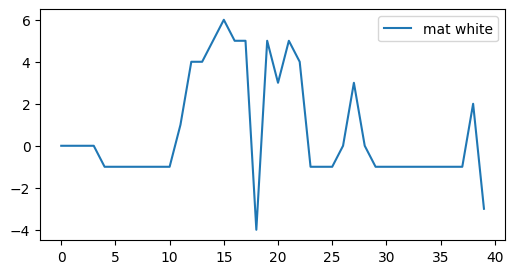

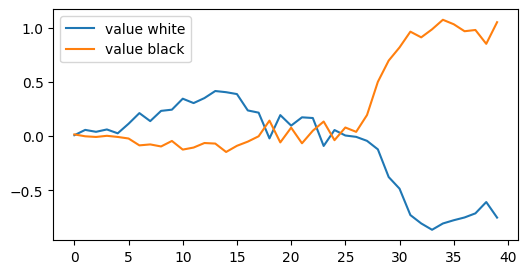

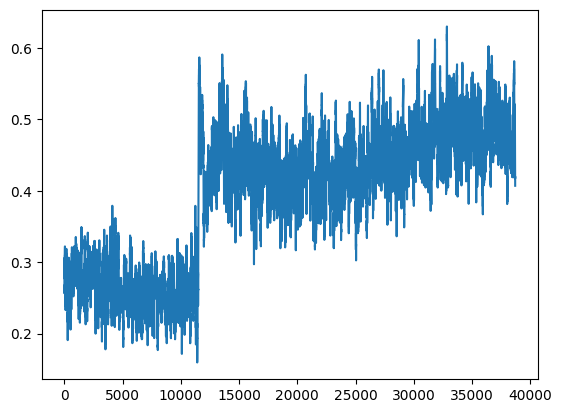

 -- 39010 -- winner: white, i: 91    wins: w = 1296.5, b = 1205, d = 3852
 -- 39020 -- winner: white, i: 139    wins: w = 1299.5, b = 1212, d = 3874
 -- 39030 -- winner: black, i: 34    wins: w = 1305.5, b = 1216, d = 3893
 -- 39040 -- winner: white, i: 29    wins: w = 1308.5, b = 1223, d = 3906
game termianted, mat diff =  9
 -- 39050 -- winner: black, i: 82    wins: w = 1311.0, b = 1230, d = 3927


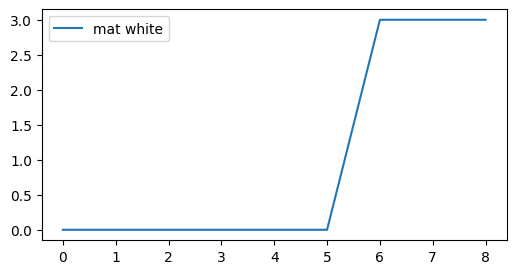

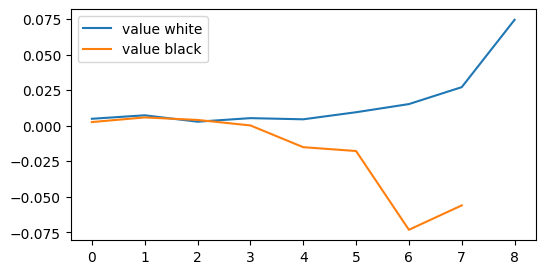

 -- 39060 -- winner: black, i: 94    wins: w = 1317.0, b = 1234, d = 3941
 -- 39070 -- winner: white, i: 81    wins: w = 1320.0, b = 1241, d = 3961
 -- 39080 -- winner: black, i: 50    wins: w = 1325.0, b = 1246, d = 3974
 -- 39090 -- winner: white, i: 43    wins: w = 1328.0, b = 1253, d = 3998
 -- 39100 -- winner: black, i: 16    wins: w = 1334.0, b = 1257, d = 4013


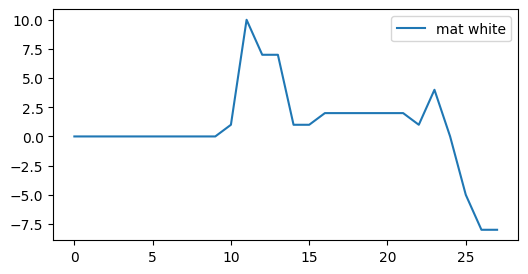

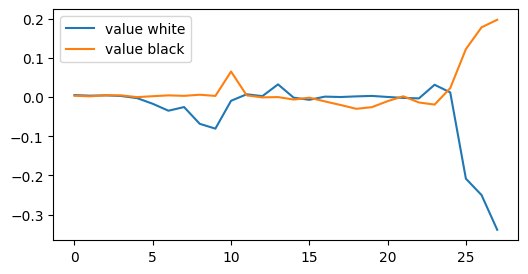

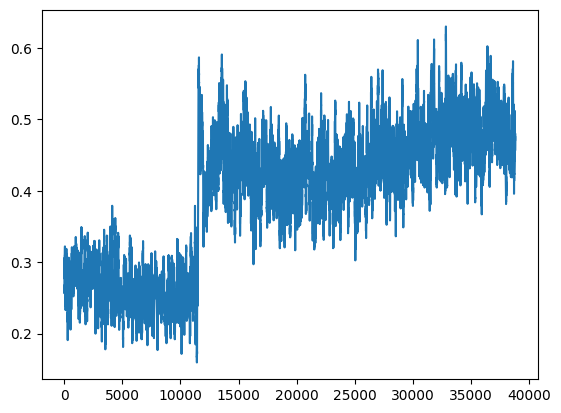

 -- 39110 -- winner: black, i: 88    wins: w = 1336.0, b = 1265, d = 4035
 -- 39120 -- winner: white, i: 25    wins: w = 1342.0, b = 1269, d = 4058
 -- 39130 -- winner: black, i: 102    wins: w = 1343.0, b = 1278, d = 4083
 -- 39140 -- winner: white, i: 41    wins: w = 1349.0, b = 1282, d = 4101
 -- 39150 -- winner: white, i: 85    wins: w = 1355.0, b = 1286, d = 4116


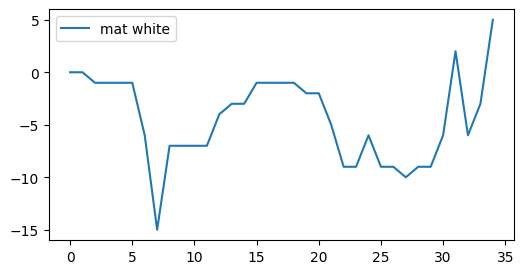

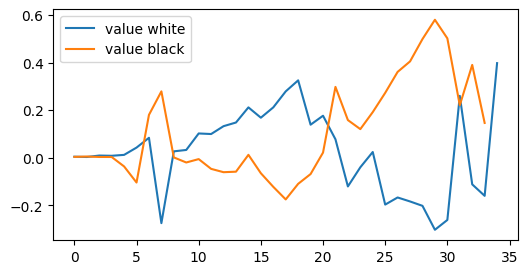

 -- 39160 -- winner: white, i: 33    wins: w = 1362.0, b = 1289, d = 4131
 -- 39170 -- winner: white, i: 95    wins: w = 1366.0, b = 1295, d = 4138
 -- 39180 -- winner: black, i: 110    wins: w = 1369.0, b = 1302, d = 4149
 -- 39190 -- winner: white, i: 77    wins: w = 1375.0, b = 1306, d = 4158
 -- 39200 -- winner: black, i: 74    wins: w = 1380.0, b = 1311, d = 4188


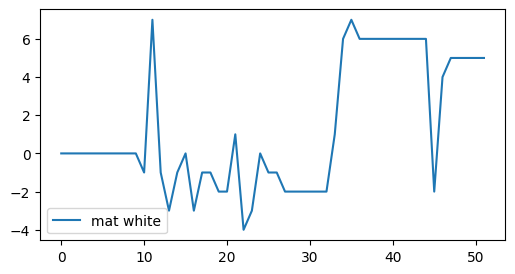

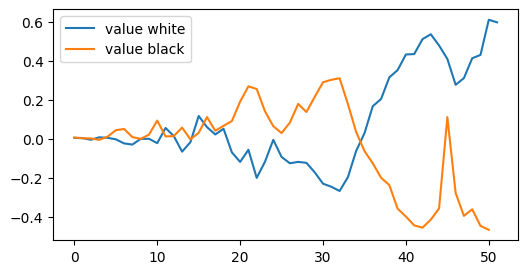

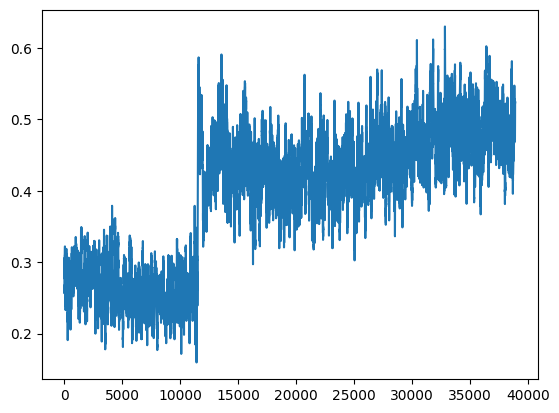

 -- 39210 -- winner: white, i: 73    wins: w = 1388.0, b = 1313, d = 4203
 -- 39220 -- winner: white, i: 83    wins: w = 1394.0, b = 1317, d = 4224
 -- 39230 -- winner: white, i: 65    wins: w = 1400.0, b = 1321, d = 4242
 -- 39240 -- winner: white, i: 73    wins: w = 1402.0, b = 1329, d = 4255
 -- 39250 -- winner: white, i: 37    wins: w = 1407.0, b = 1334, d = 4270


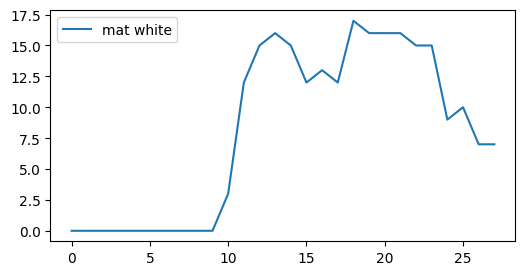

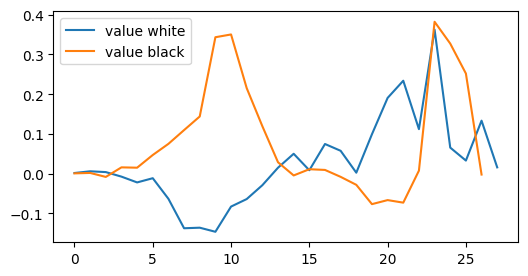

 -- 39260 -- winner: black, i: 126    wins: w = 1411.0, b = 1340, d = 4282
 -- 39270 -- winner: black, i: 106    wins: w = 1416.0, b = 1345, d = 4294
 -- 39280 -- winner: black, i: 116    wins: w = 1421.0, b = 1350, d = 4312
 -- 39290 -- winner: black, i: 150    wins: w = 1427.0, b = 1354, d = 4332
 -- 39300 -- winner: white, i: 79    wins: w = 1434.0, b = 1357, d = 4342


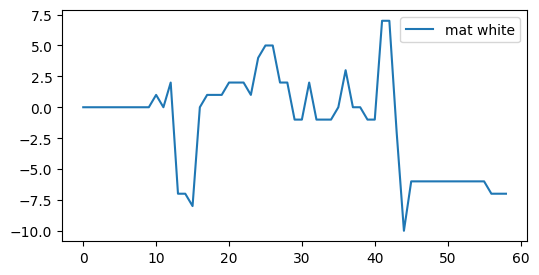

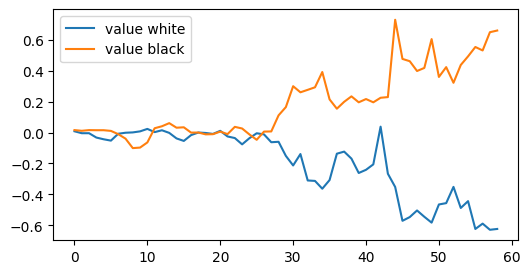

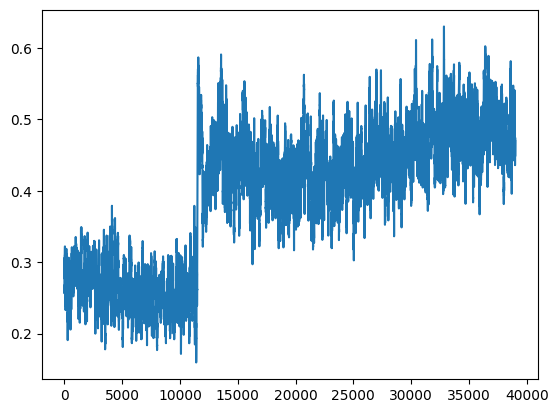

 -- 39310 -- winner: black, i: 176    wins: w = 1440.0, b = 1361, d = 4354
 -- 39320 -- winner: white, i: 11    wins: w = 1443.0, b = 1368, d = 4369
 -- 39330 -- winner: white, i: 13    wins: w = 1447.0, b = 1374, d = 4403
 -- 39340 -- winner: black, i: 12    wins: w = 1451.0, b = 1380, d = 4425
 -- 39350 -- winner: black, i: 10    wins: w = 1454.0, b = 1387, d = 4430


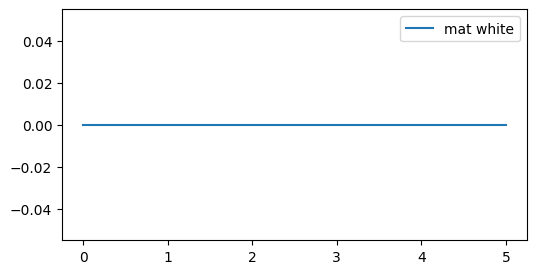

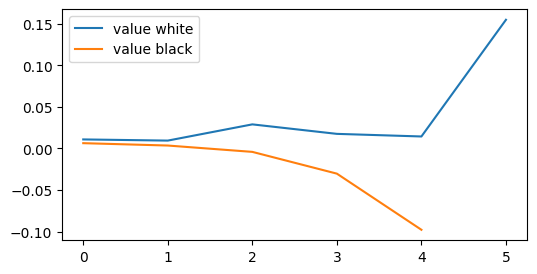

 -- 39360 -- winner: black, i: 68    wins: w = 1461.0, b = 1390, d = 4452
 -- 39370 -- winner: black, i: 86    wins: w = 1466.0, b = 1395, d = 4470
 -- 39380 -- winner: black, i: 20    wins: w = 1472.0, b = 1399, d = 4482
 -- 39390 -- winner: black, i: 28    wins: w = 1479.0, b = 1402, d = 4490
 -- 39400 -- winner: white, i: 77    wins: w = 1485.0, b = 1406, d = 4502


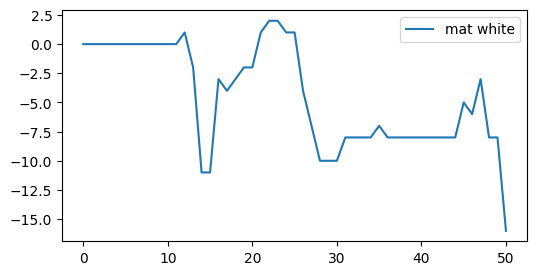

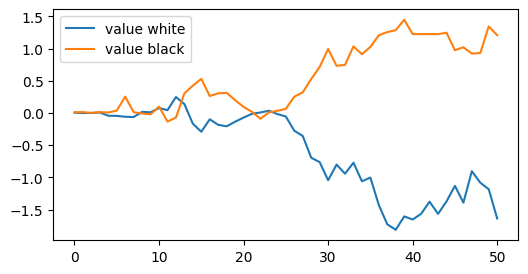

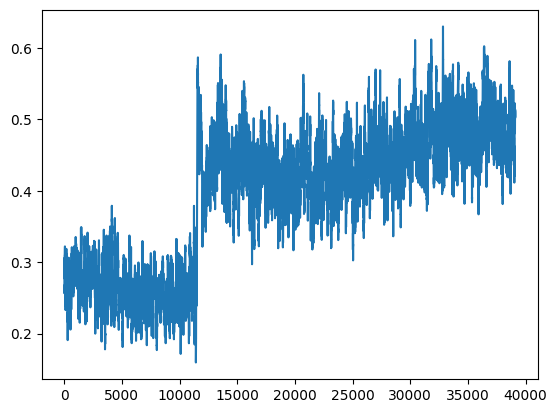

 -- 39410 -- winner: black, i: 38    wins: w = 1491.0, b = 1410, d = 4523
 -- 39420 -- winner: black, i: 126    wins: w = 1495.0, b = 1416, d = 4540
 -- 39430 -- winner: white, i: 71    wins: w = 1498.0, b = 1423, d = 4552
 -- 39440 -- winner: black, i: 16    wins: w = 1504.0, b = 1427, d = 4570
 -- 39450 -- winner: white, i: 97    wins: w = 1509.0, b = 1432, d = 4582


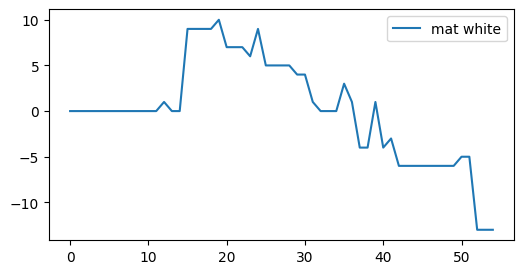

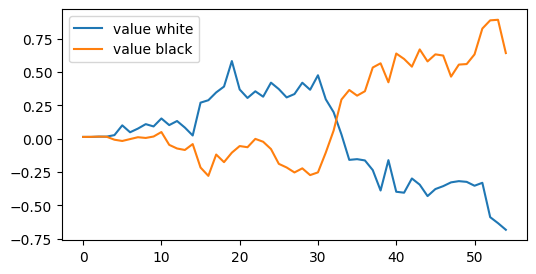

 -- 39460 -- winner: black, i: 112    wins: w = 1513.0, b = 1438, d = 4598
 -- 39470 -- winner: white, i: 57    wins: w = 1520.0, b = 1441, d = 4617
 -- 39480 -- winner: white, i: 145    wins: w = 1528.0, b = 1443, d = 4645
 -- 39490 -- winner: black, i: 58    wins: w = 1533.0, b = 1448, d = 4677
 -- 39500 -- winner: white, i: 5    wins: w = 1536.0, b = 1455, d = 4708


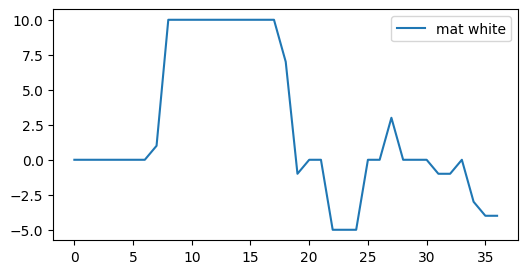

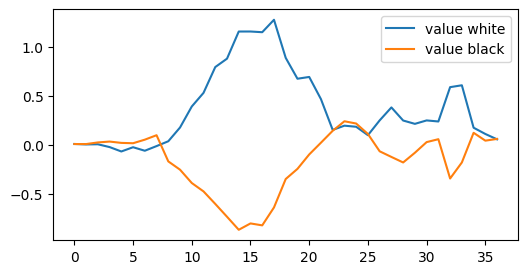

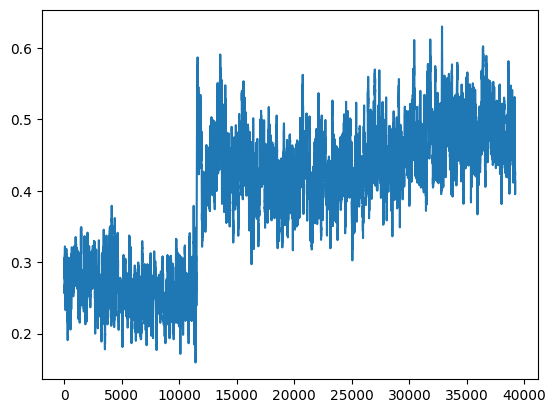

 -- 39510 -- winner: black, i: 66    wins: w = 1538.0, b = 1463, d = 4729
 -- 39520 -- winner: white, i: 89    wins: w = 1544.0, b = 1467, d = 4735
 -- 39530 -- winner: white, i: 17    wins: w = 1549.0, b = 1472, d = 4748
 -- 39540 -- winner: black, i: 34    wins: w = 1554.0, b = 1477, d = 4757
 -- 39550 -- winner: white, i: 143    wins: w = 1560.0, b = 1481, d = 4771


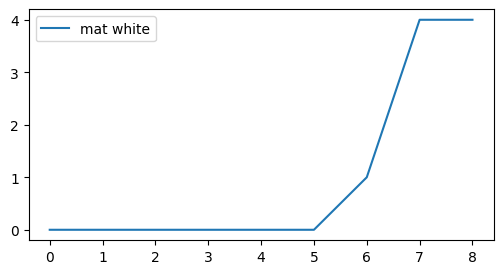

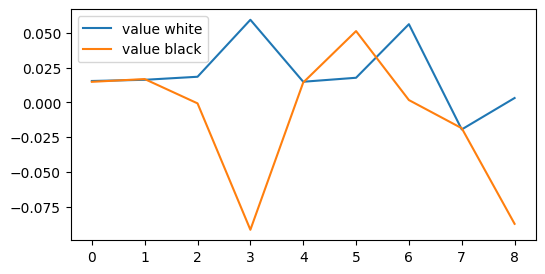

 -- 39560 -- winner: black, i: 20    wins: w = 1564.0, b = 1487, d = 4784
 -- 39570 -- winner: white, i: 95    wins: w = 1568.0, b = 1493, d = 4809
 -- 39580 -- winner: black, i: 74    wins: w = 1575.0, b = 1496, d = 4825
 -- 39590 -- winner: white, i: 73    wins: w = 1580.0, b = 1501, d = 4837
 -- 39600 -- winner: white, i: 87    wins: w = 1583.0, b = 1508, d = 4855


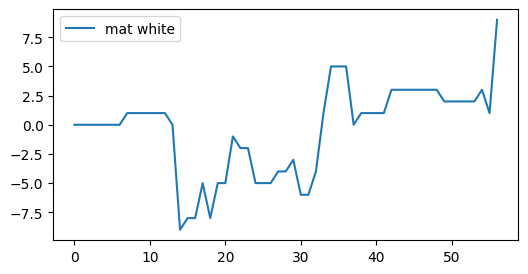

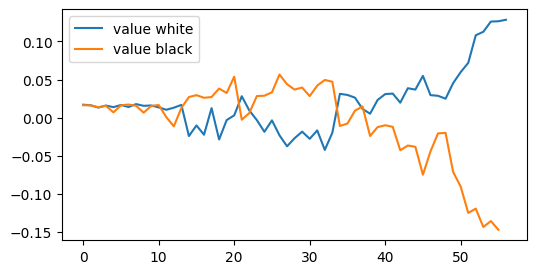

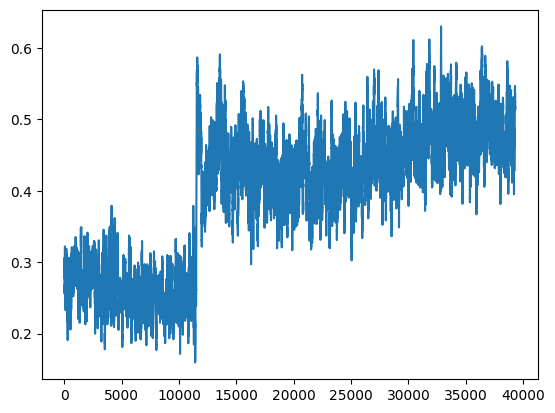

 -- 39610 -- winner: black, i: 16    wins: w = 1589.0, b = 1512, d = 4889
 -- 39620 -- winner: black, i: 82    wins: w = 1593.0, b = 1518, d = 4912
 -- 39630 -- winner: black, i: 114    wins: w = 1597.0, b = 1524, d = 4935
 -- 39640 -- winner: black, i: 90    wins: w = 1605.0, b = 1526, d = 4966
 -- 39650 -- winner: white, i: 193    wins: w = 1609.0, b = 1532, d = 4981


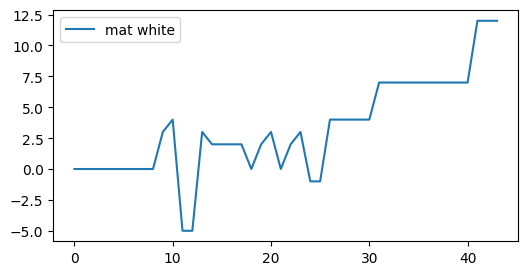

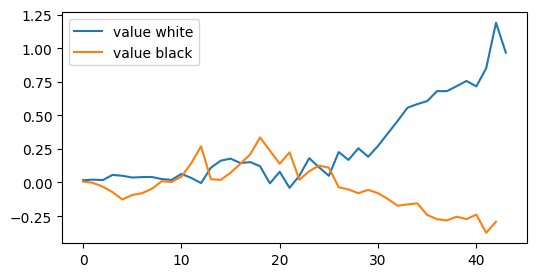

 -- 39660 -- winner: black, i: 36    wins: w = 1614.0, b = 1537, d = 4996
 -- 39670 -- winner: white, i: 55    wins: w = 1621.0, b = 1540, d = 5014
 -- 39680 -- winner: white, i: 83    wins: w = 1627.0, b = 1544, d = 5025
 -- 39690 -- winner: white, i: 75    wins: w = 1633.0, b = 1548, d = 5045
 -- 39700 -- winner: black, i: 84    wins: w = 1640.0, b = 1551, d = 5048


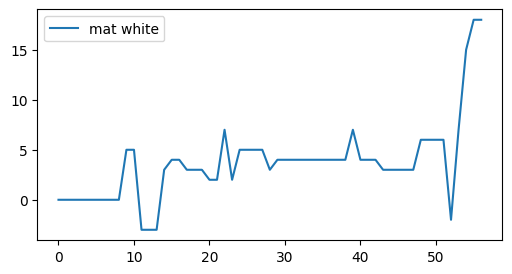

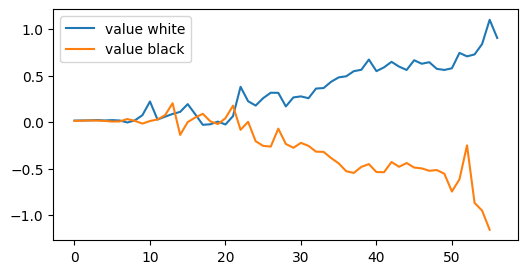

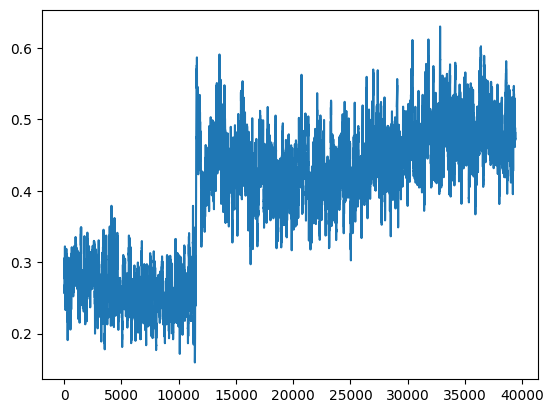

 -- 39710 -- winner: white, i: 89    wins: w = 1646.0, b = 1555, d = 5064
 -- 39720 -- winner: black, i: 84    wins: w = 1649.0, b = 1562, d = 5083
 -- 39730 -- winner: black, i: 50    wins: w = 1655.0, b = 1566, d = 5111
 -- 39740 -- winner: black, i: 10    wins: w = 1661.0, b = 1570, d = 5123
 -- 39750 -- winner: black, i: 94    wins: w = 1665.0, b = 1576, d = 5143


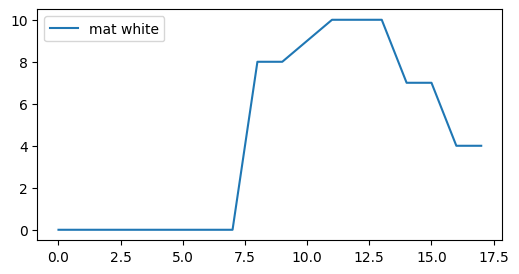

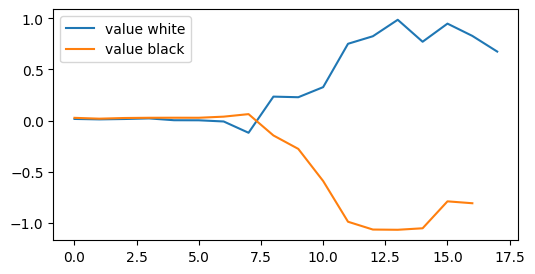

 -- 39760 -- winner: white, i: 51    wins: w = 1671.0, b = 1580, d = 5159
 -- 39770 -- winner: white, i: 19    wins: w = 1676.0, b = 1585, d = 5188
 -- 39780 -- winner: black, i: 68    wins: w = 1680.0, b = 1591, d = 5202
 -- 39790 -- winner: white, i: 91    wins: w = 1687.0, b = 1594, d = 5217
 -- 39800 -- winner: white, i: 85    wins: w = 1694.0, b = 1597, d = 5228


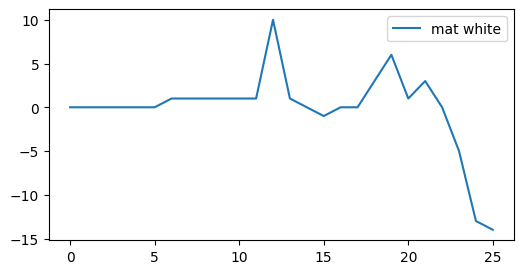

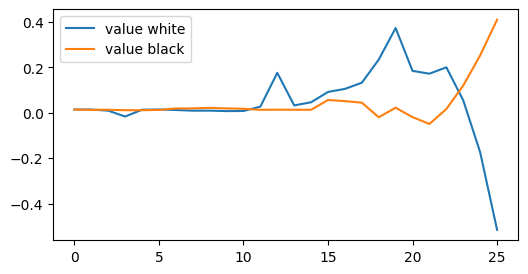

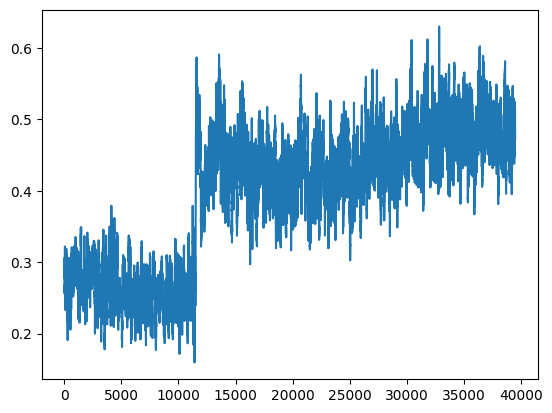

 -- 39810 -- winner: white, i: 5    wins: w = 1700.0, b = 1601, d = 5248
 -- 39820 -- winner: black, i: 30    wins: w = 1706.0, b = 1605, d = 5261
 -- 39830 -- winner: black, i: 70    wins: w = 1713.0, b = 1608, d = 5276
 -- 39840 -- winner: white, i: 29    wins: w = 1719.0, b = 1612, d = 5298
 -- 39850 -- winner: black, i: 22    wins: w = 1724.0, b = 1617, d = 5302


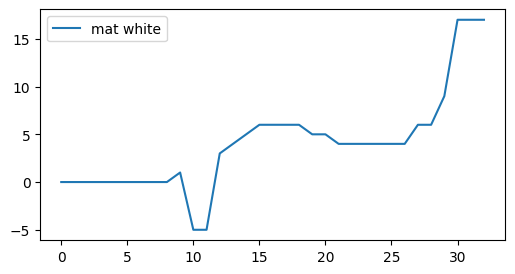

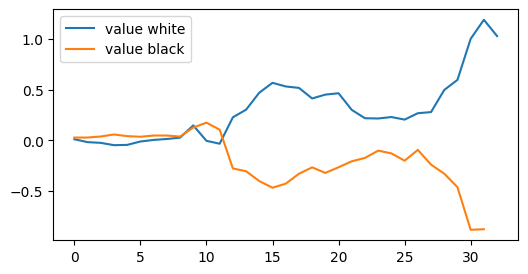

 -- 39860 -- winner: white, i: 91    wins: w = 1732.0, b = 1619, d = 5326
 -- 39870 -- winner: white, i: 167    wins: w = 1738.0, b = 1623, d = 5340
 -- 39880 -- winner: black, i: 38    wins: w = 1742.0, b = 1629, d = 5356
 -- 39890 -- winner: black, i: 104    wins: w = 1747.0, b = 1634, d = 5368
 -- 39900 -- winner: black, i: 86    wins: w = 1754.0, b = 1637, d = 5380


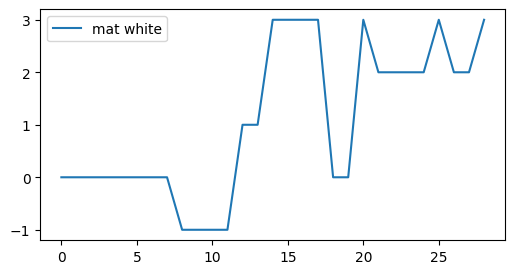

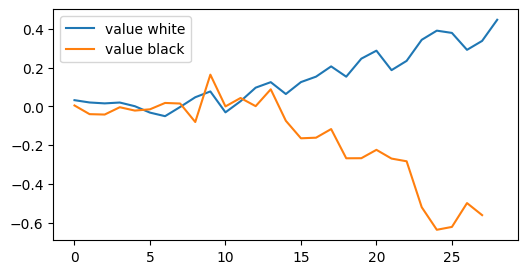

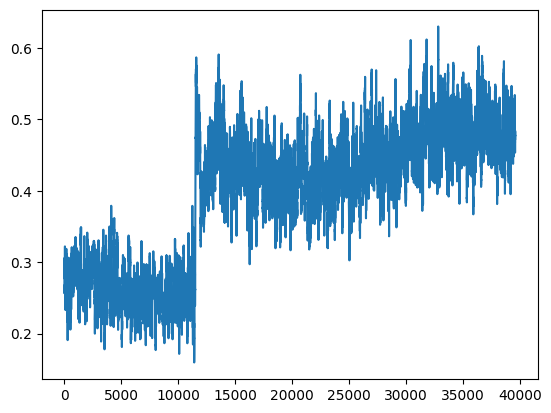

 -- 39910 -- winner: white, i: 65    wins: w = 1761.0, b = 1640, d = 5396
 -- 39920 -- winner: black, i: 38    wins: w = 1767.0, b = 1644, d = 5406
 -- 39930 -- winner: black, i: 174    wins: w = 1772.0, b = 1649, d = 5409
 -- 39940 -- winner: white, i: 53    wins: w = 1777.0, b = 1654, d = 5419
 -- 39950 -- winner: white, i: 55    wins: w = 1779.0, b = 1662, d = 5426


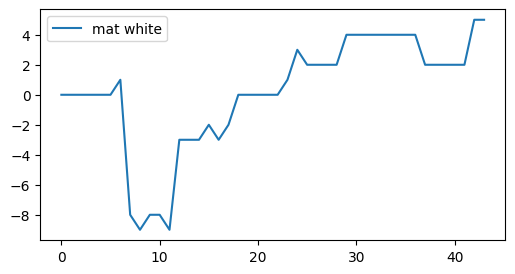

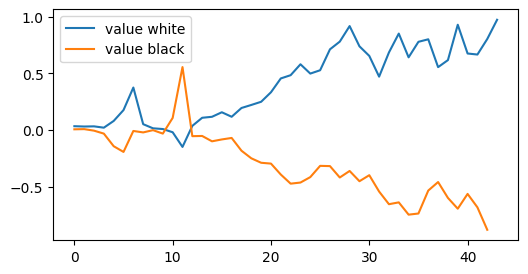

 -- 39960 -- winner: black, i: 68    wins: w = 1787.0, b = 1664, d = 5453
 -- 39970 -- winner: black, i: 126    wins: w = 1794.0, b = 1667, d = 5482
 -- 39980 -- winner: black, i: 82    wins: w = 1797.0, b = 1674, d = 5503
 -- 39990 -- winner: white, i: 77    wins: w = 1802.0, b = 1679, d = 5523
 -- 40000 -- winner: black, i: 60    wins: w = 1805.0, b = 1686, d = 5537


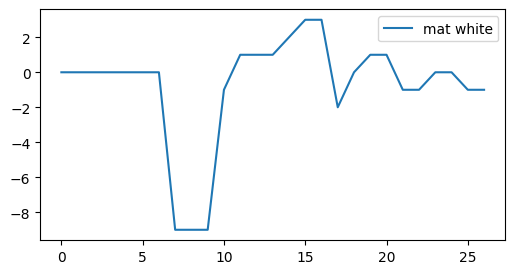

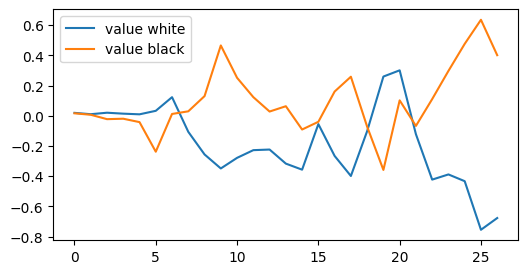

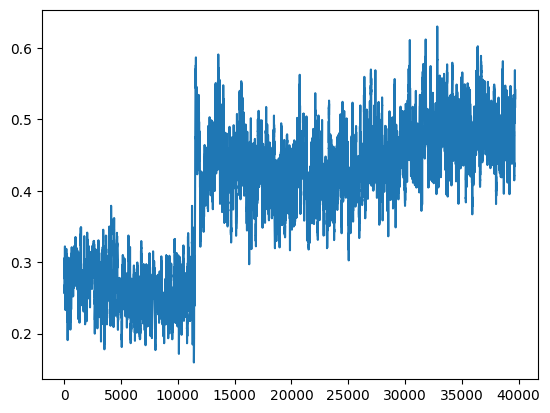

 -- 40010 -- winner: black, i: 14    wins: w = 1808.0, b = 1693, d = 5566
 -- 40020 -- winner: white, i: 19    wins: w = 1814.0, b = 1697, d = 5585
 -- 40030 -- winner: white, i: 67    wins: w = 1821.0, b = 1700, d = 5603
 -- 40040 -- winner: white, i: 85    wins: w = 1824.0, b = 1707, d = 5623
 -- 40050 -- winner: black, i: 56    wins: w = 1828.0, b = 1713, d = 5646


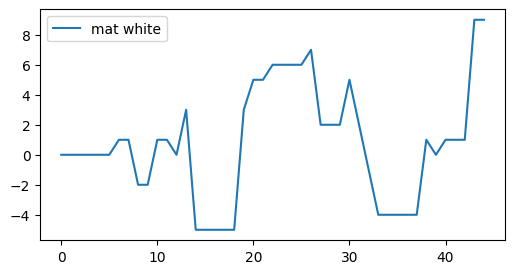

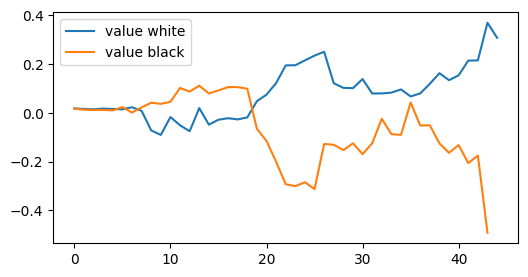

 -- 40060 -- winner: white, i: 27    wins: w = 1834.0, b = 1717, d = 5656
 -- 40070 -- winner: white, i: 69    wins: w = 1841.0, b = 1720, d = 5672
 -- 40080 -- winner: white, i: 15    wins: w = 1848.0, b = 1723, d = 5699
 -- 40090 -- winner: white, i: 61    wins: w = 1853.0, b = 1728, d = 5711
 -- 40100 -- winner: white, i: 71    wins: w = 1859.0, b = 1732, d = 5729


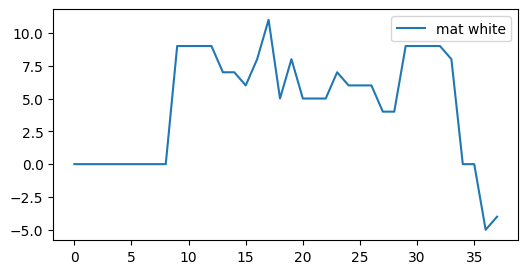

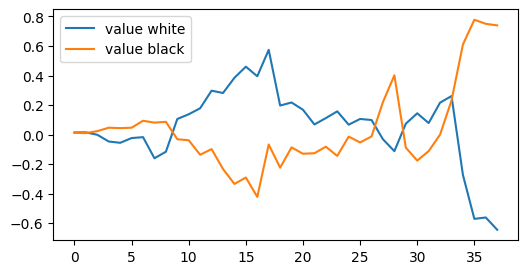

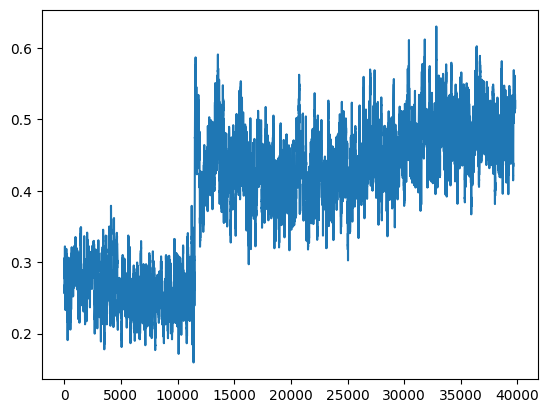

 -- 40110 -- winner: white, i: 111    wins: w = 1862.0, b = 1739, d = 5738
 -- 40120 -- winner: white, i: 131    wins: w = 1866.0, b = 1745, d = 5748
 -- 40130 -- winner: white, i: 111    wins: w = 1873.0, b = 1748, d = 5763
 -- 40140 -- winner: white, i: 67    wins: w = 1877.0, b = 1754, d = 5782
 -- 40150 -- winner: white, i: 57    wins: w = 1883.0, b = 1758, d = 5814


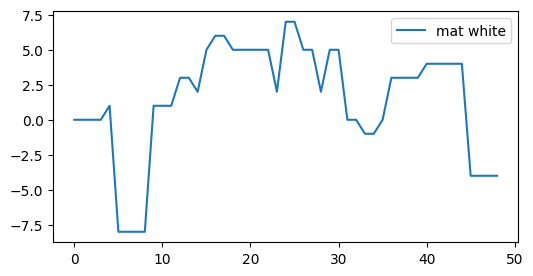

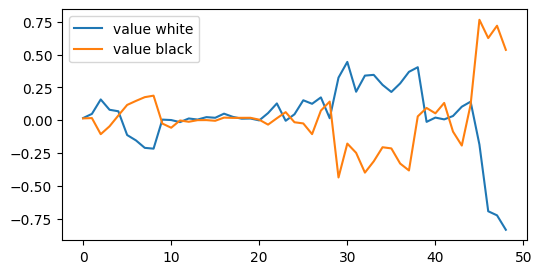

 -- 40160 -- winner: white, i: 23    wins: w = 1886.0, b = 1765, d = 5821
 -- 40170 -- winner: black, i: 90    wins: w = 1893.0, b = 1768, d = 5840
 -- 40180 -- winner: white, i: 87    wins: w = 1897.0, b = 1774, d = 5850
 -- 40190 -- winner: black, i: 98    wins: w = 1904.0, b = 1777, d = 5855
 -- 40200 -- winner: white, i: 51    wins: w = 1908.0, b = 1783, d = 5865


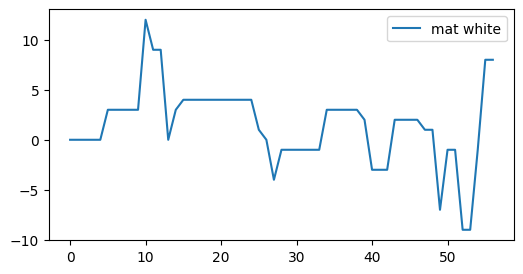

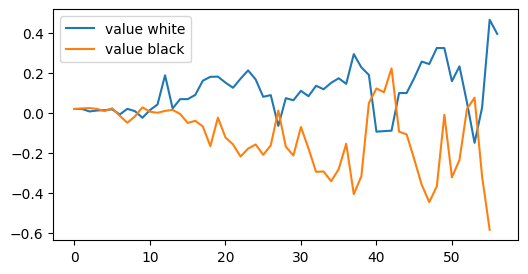

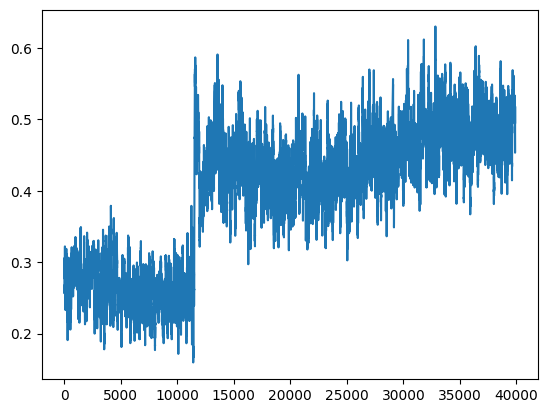

 -- 40210 -- winner: white, i: 29    wins: w = 1913.0, b = 1788, d = 5886
 -- 40220 -- winner: white, i: 29    wins: w = 1919.0, b = 1792, d = 5900
 -- 40230 -- winner: black, i: 88    wins: w = 1924.0, b = 1797, d = 5917
 -- 40240 -- winner: black, i: 130    wins: w = 1928.0, b = 1803, d = 5936
 -- 40250 -- winner: black, i: 20    wins: w = 1933.0, b = 1808, d = 5977


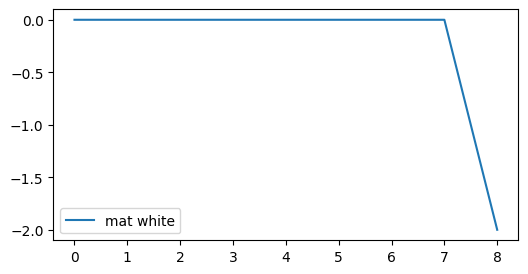

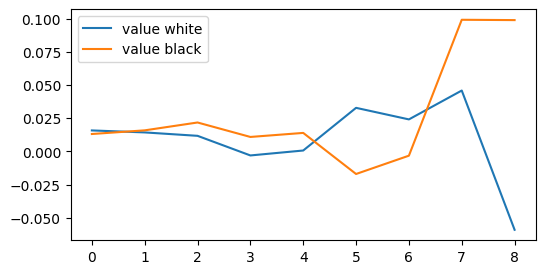

 -- 40260 -- winner: white, i: 87    wins: w = 1939.0, b = 1812, d = 6001
 -- 40270 -- winner: black, i: 60    wins: w = 1943.0, b = 1818, d = 6013
 -- 40280 -- winner: black, i: 28    wins: w = 1947.0, b = 1824, d = 6023
 -- 40290 -- winner: white, i: 117    wins: w = 1954.0, b = 1827, d = 6039
 -- 40300 -- winner: black, i: 42    wins: w = 1959.0, b = 1832, d = 6061


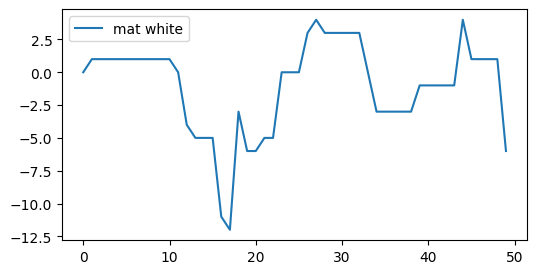

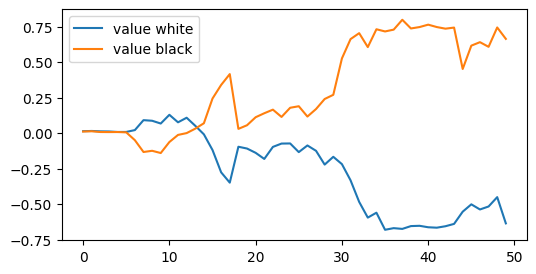

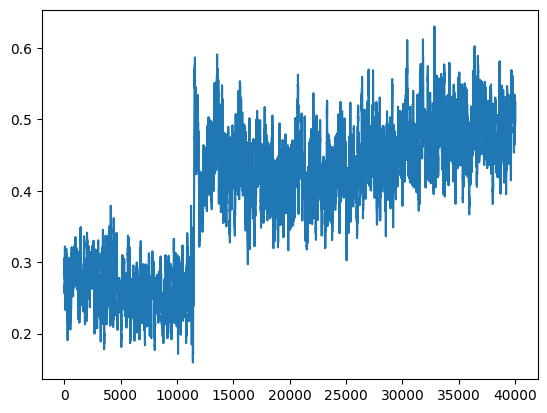

 -- 40310 -- winner: white, i: 85    wins: w = 1965.0, b = 1836, d = 6080
 -- 40320 -- winner: black, i: 68    wins: w = 1969.0, b = 1842, d = 6086
 -- 40330 -- winner: white, i: 33    wins: w = 1974.0, b = 1847, d = 6110
 -- 40340 -- winner: black, i: 142    wins: w = 1975.0, b = 1856, d = 6126
 -- 40350 -- winner: white, i: 71    wins: w = 1982.0, b = 1859, d = 6141


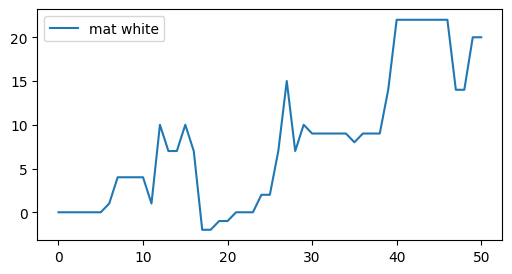

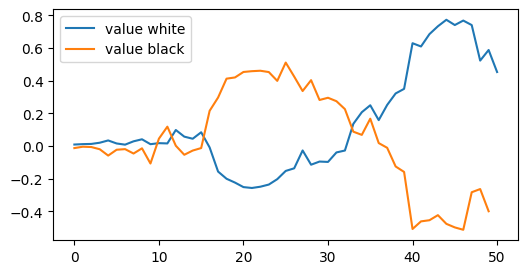

 -- 40360 -- winner: white, i: 87    wins: w = 1987.0, b = 1864, d = 6146
 -- 40370 -- winner: black, i: 52    wins: w = 1993.0, b = 1868, d = 6171
 -- 40380 -- winner: white, i: 137    wins: w = 1995.0, b = 1876, d = 6189
 -- 40390 -- winner: white, i: 103    wins: w = 2000.0, b = 1881, d = 6200
 -- 40400 -- winner: white, i: 79    wins: w = 2005.0, b = 1886, d = 6213


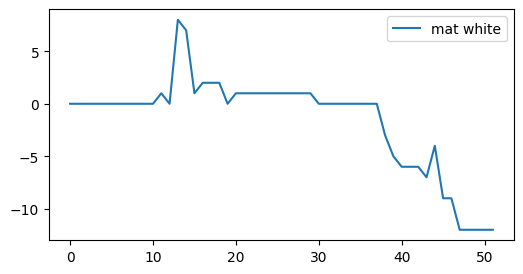

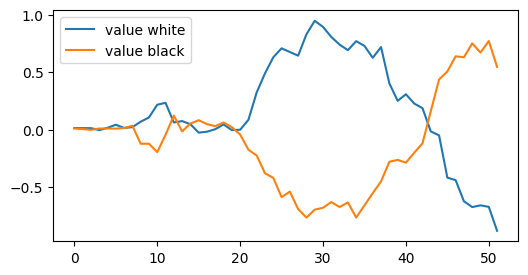

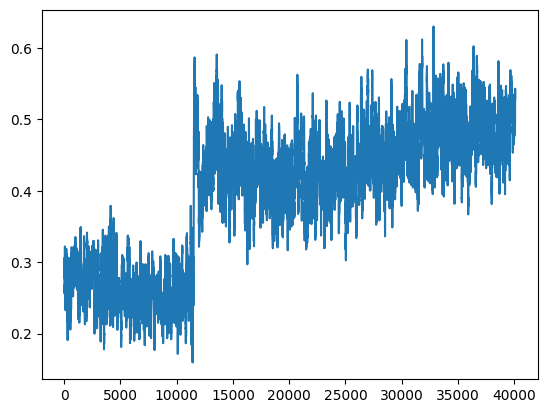

 -- 40410 -- winner: white, i: 81    wins: w = 2010.0, b = 1891, d = 6221
 -- 40420 -- winner: black, i: 76    wins: w = 2014.0, b = 1897, d = 6229
 -- 40430 -- winner: white, i: 35    wins: w = 2018.0, b = 1903, d = 6240
 -- 40440 -- winner: black, i: 74    wins: w = 2024.0, b = 1907, d = 6255
 -- 40450 -- winner: white, i: 81    wins: w = 2029.0, b = 1912, d = 6276


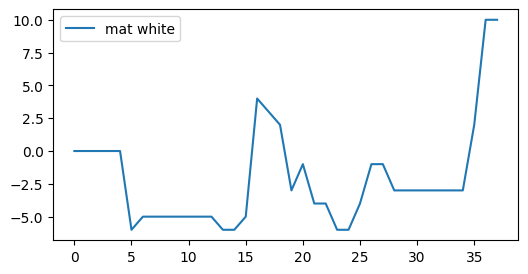

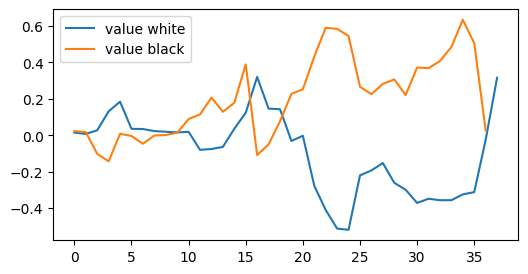

 -- 40460 -- winner: white, i: 63    wins: w = 2036.0, b = 1915, d = 6288
 -- 40470 -- winner: white, i: 23    wins: w = 2043.0, b = 1918, d = 6293
 -- 40480 -- winner: black, i: 128    wins: w = 2046.0, b = 1925, d = 6305
 -- 40490 -- winner: black, i: 172    wins: w = 2049.0, b = 1932, d = 6322
 -- 40500 -- winner: white, i: 5    wins: w = 2054.0, b = 1937, d = 6333


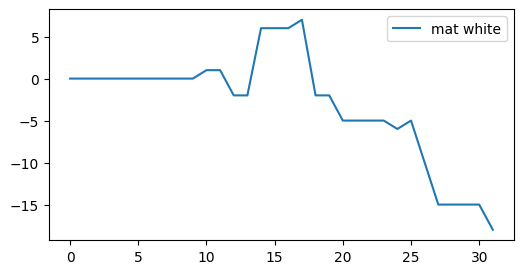

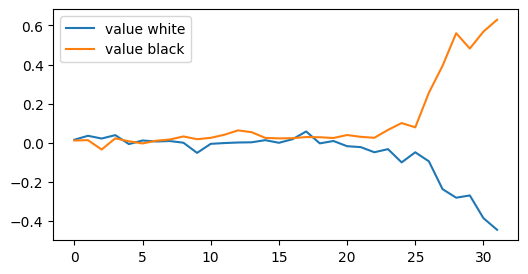

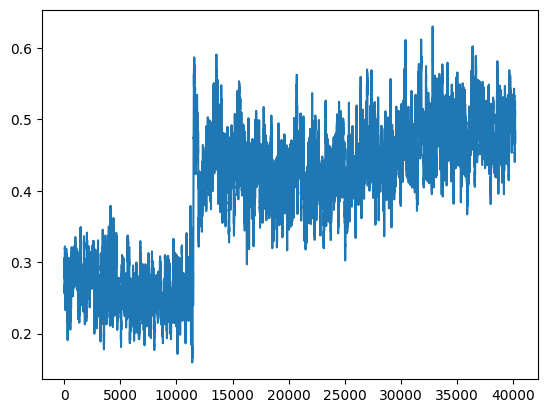

 -- 40510 -- winner: black, i: 10    wins: w = 2059.0, b = 1942, d = 6347
 -- 40520 -- winner: black, i: 70    wins: w = 2061.0, b = 1950, d = 6361
 -- 40530 -- winner: white, i: 57    wins: w = 2068.0, b = 1953, d = 6379
 -- 40540 -- winner: black, i: 68    wins: w = 2073.0, b = 1958, d = 6399
 -- 40550 -- winner: black, i: 46    wins: w = 2078.0, b = 1963, d = 6415


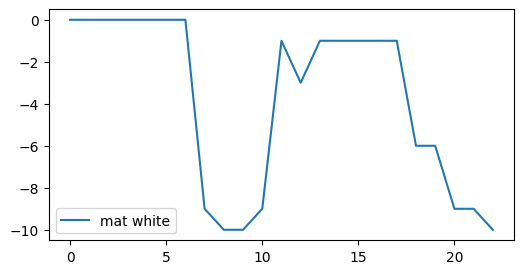

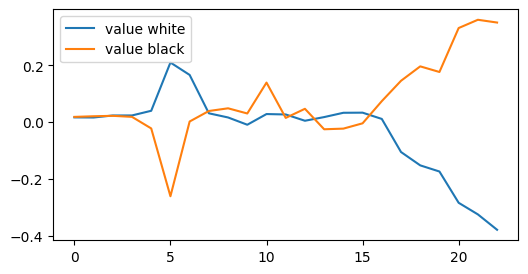

 -- 40560 -- winner: black, i: 92    wins: w = 2081.0, b = 1970, d = 6433
 -- 40570 -- winner: white, i: 89    wins: w = 2085.0, b = 1976, d = 6449
 -- 40580 -- winner: white, i: 65    wins: w = 2089.0, b = 1982, d = 6471
 -- 40590 -- winner: white, i: 151    wins: w = 2094.0, b = 1987, d = 6490
 -- 40600 -- winner: black, i: 20    wins: w = 2099.0, b = 1992, d = 6504


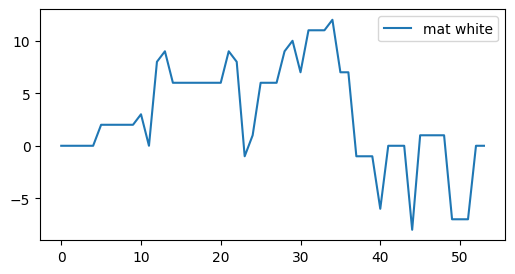

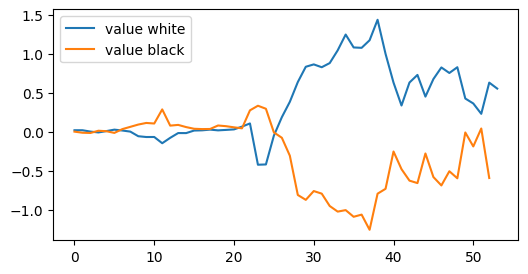

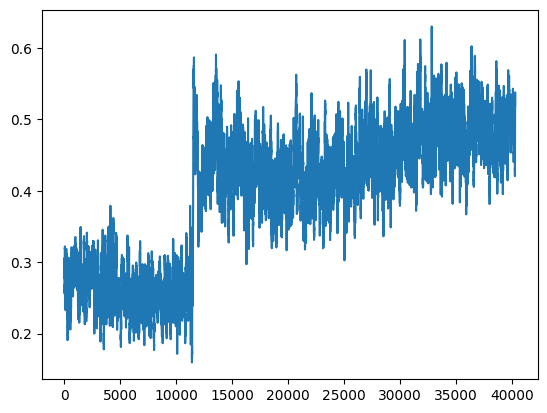

 -- 40610 -- winner: white, i: 123    wins: w = 2104.0, b = 1997, d = 6510
 -- 40620 -- winner: black, i: 116    wins: w = 2109.0, b = 2002, d = 6525
 -- 40630 -- winner: black, i: 102    wins: w = 2113.0, b = 2008, d = 6529
 -- 40640 -- winner: white, i: 79    wins: w = 2118.0, b = 2013, d = 6537
 -- 40650 -- winner: black, i: 70    wins: w = 2123.0, b = 2018, d = 6544


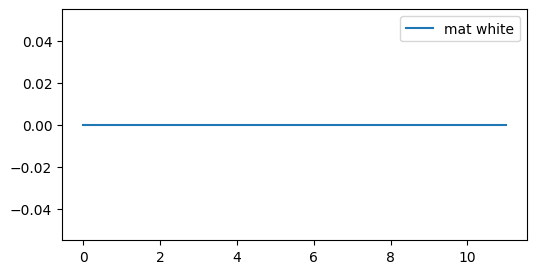

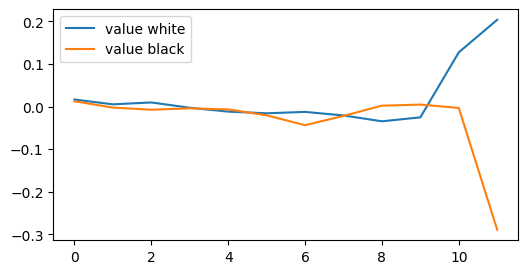

 -- 40660 -- winner: black, i: 256    wins: w = 2129.0, b = 2022, d = 6557
 -- 40670 -- winner: black, i: 12    wins: w = 2135.0, b = 2026, d = 6571
 -- 40680 -- winner: black, i: 42    wins: w = 2136.0, b = 2035, d = 6594
 -- 40690 -- winner: white, i: 25    wins: w = 2144.0, b = 2037, d = 6609
 -- 40700 -- winner: black, i: 32    wins: w = 2150.0, b = 2041, d = 6617


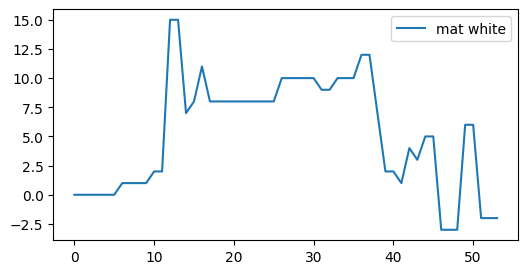

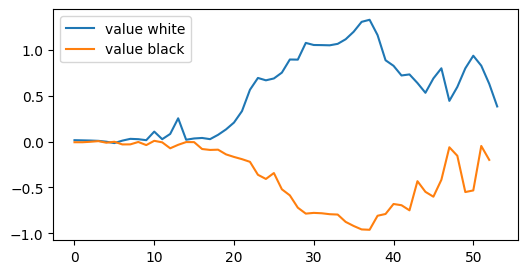

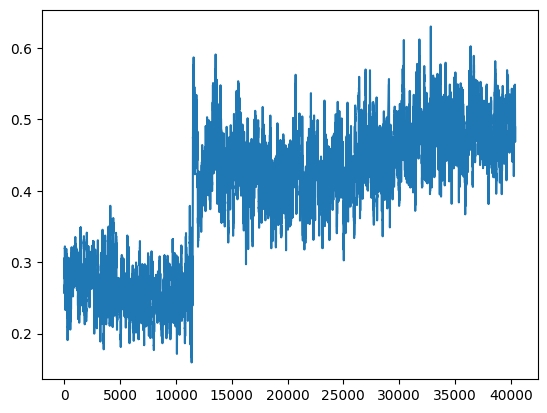

 -- 40710 -- winner: black, i: 24    wins: w = 2153.0, b = 2048, d = 6648
 -- 40720 -- winner: black, i: 54    wins: w = 2156.0, b = 2055, d = 6677
 -- 40730 -- winner: white, i: 85    wins: w = 2162.0, b = 2059, d = 6689
 -- 40740 -- winner: white, i: 87    wins: w = 2168.0, b = 2063, d = 6722
 -- 40750 -- winner: black, i: 90    wins: w = 2171.0, b = 2070, d = 6745


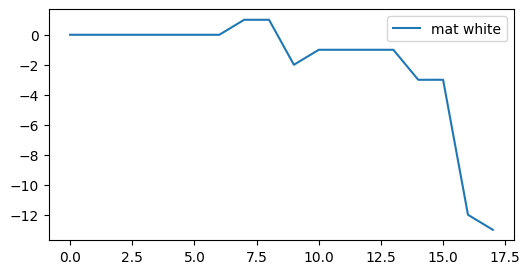

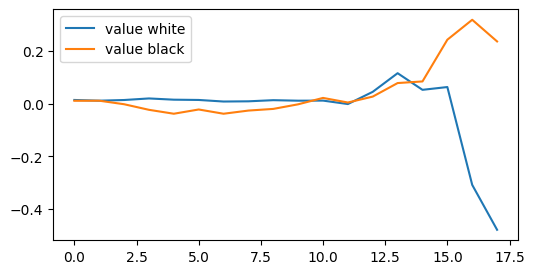

 -- 40760 -- winner: white, i: 65    wins: w = 2175.0, b = 2076, d = 6760
 -- 40770 -- winner: white, i: 125    wins: w = 2180.0, b = 2081, d = 6774
 -- 40780 -- winner: white, i: 57    wins: w = 2189.0, b = 2082, d = 6802
 -- 40790 -- winner: white, i: 59    wins: w = 2194.0, b = 2087, d = 6811
 -- 40800 -- winner: black, i: 90    wins: w = 2201.0, b = 2090, d = 6831


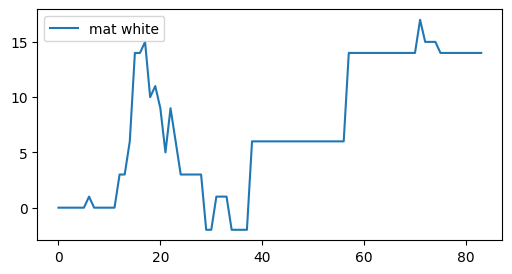

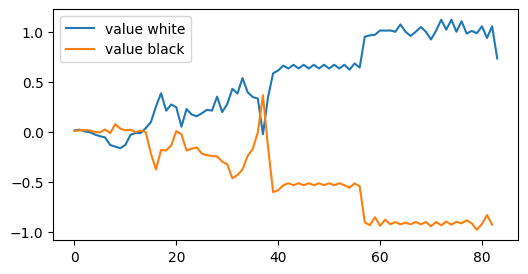

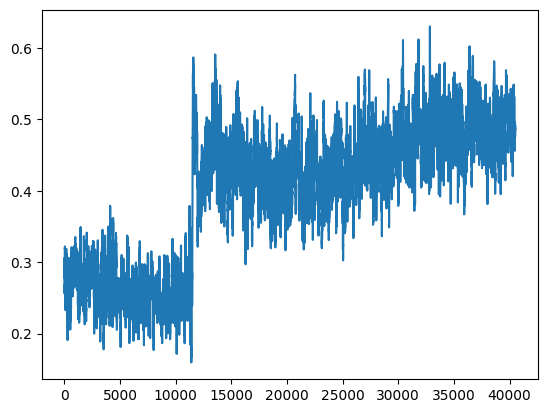

 -- 40810 -- winner: white, i: 59    wins: w = 2205.0, b = 2096, d = 6835
 -- 40820 -- winner: black, i: 82    wins: w = 2210.0, b = 2101, d = 6845
 -- 40830 -- winner: black, i: 124    wins: w = 2216.0, b = 2105, d = 6851
 -- 40840 -- winner: white, i: 79    wins: w = 2223.0, b = 2108, d = 6862
 -- 40850 -- winner: white, i: 67    wins: w = 2231.0, b = 2110, d = 6881


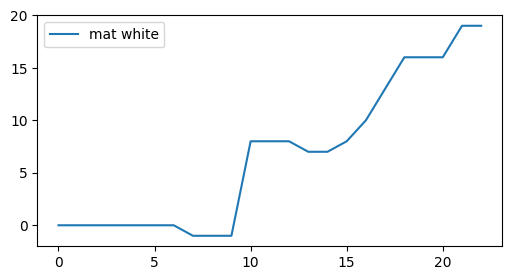

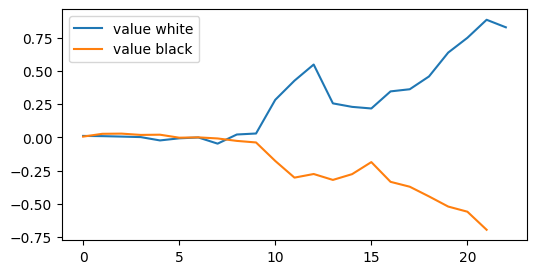

 -- 40860 -- winner: black, i: 30    wins: w = 2235.0, b = 2116, d = 6889
 -- 40870 -- winner: white, i: 53    wins: w = 2241.0, b = 2120, d = 6900
 -- 40880 -- winner: black, i: 100    wins: w = 2246.0, b = 2125, d = 6911
 -- 40890 -- winner: black, i: 26    wins: w = 2253.0, b = 2128, d = 6933
 -- 40900 -- winner: white, i: 17    wins: w = 2258.0, b = 2133, d = 6940


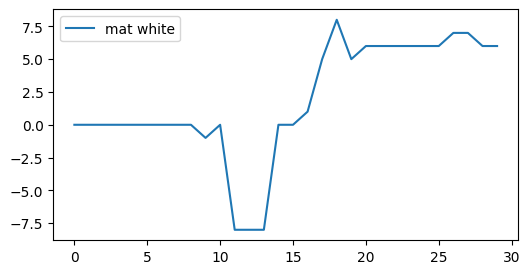

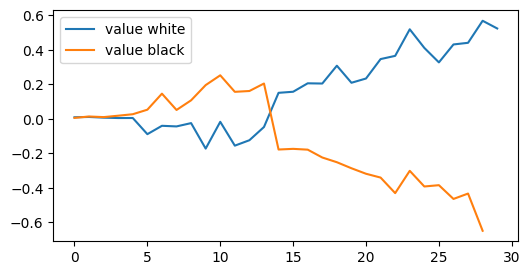

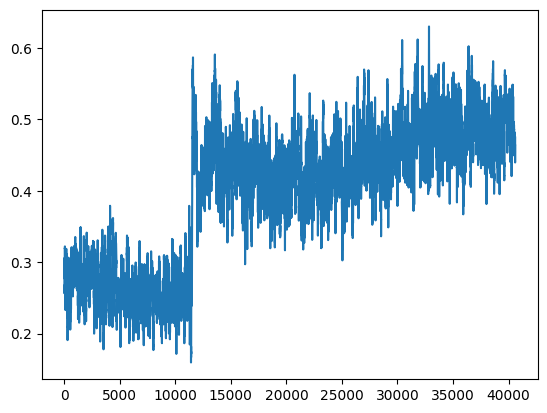

 -- 40910 -- winner: white, i: 37    wins: w = 2265.0, b = 2136, d = 6961
 -- 40920 -- winner: black, i: 88    wins: w = 2268.0, b = 2143, d = 6975
 -- 40930 -- winner: black, i: 84    wins: w = 2273.0, b = 2148, d = 6991
 -- 40940 -- winner: white, i: 105    wins: w = 2278.0, b = 2153, d = 7007
 -- 40950 -- winner: white, i: 89    wins: w = 2282.0, b = 2159, d = 7012


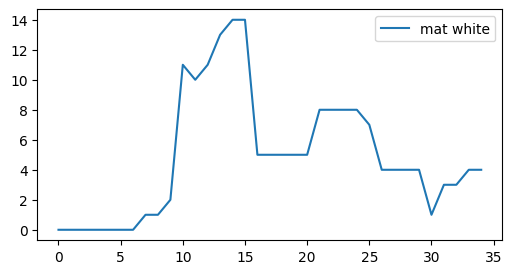

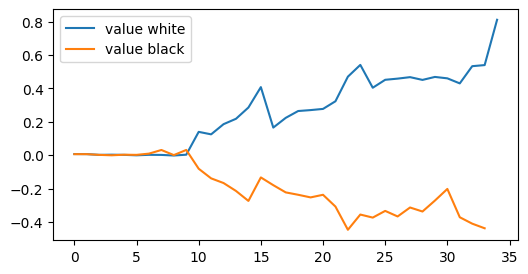

 -- 40960 -- winner: black, i: 44    wins: w = 2291.0, b = 2160, d = 7034
 -- 40970 -- winner: black, i: 58    wins: w = 2297.0, b = 2164, d = 7042
 -- 40980 -- winner: black, i: 92    wins: w = 2303.0, b = 2168, d = 7047
game termianted, mat diff =  1
 -- 40990 -- winner: black, i: 26    wins: w = 2309.0, b = 2172, d = 7054
 -- 41000 -- winner: black, i: 56    wins: w = 2312.0, b = 2179, d = 7070


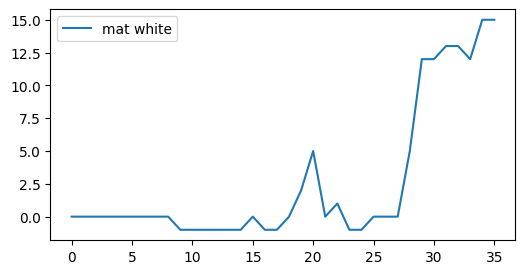

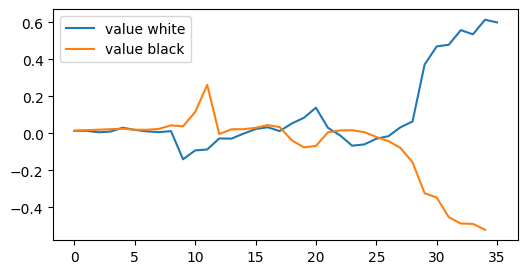

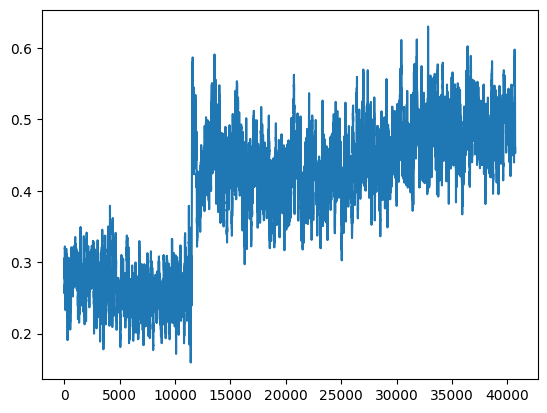

 -- 41010 -- winner: black, i: 90    wins: w = 2317.0, b = 2184, d = 7081
 -- 41020 -- winner: white, i: 15    wins: w = 2325.0, b = 2186, d = 7105
 -- 41030 -- winner: white, i: 99    wins: w = 2327.0, b = 2194, d = 7109
 -- 41040 -- winner: white, i: 49    wins: w = 2333.0, b = 2198, d = 7123
 -- 41050 -- winner: white, i: 37    wins: w = 2338.0, b = 2203, d = 7140


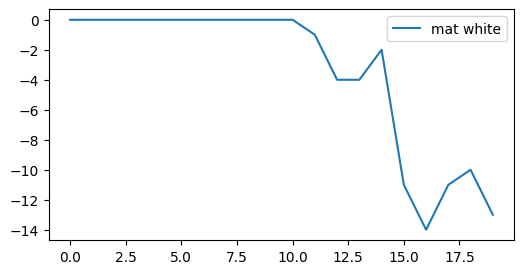

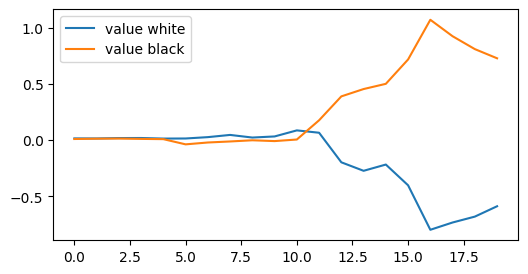

 -- 41060 -- winner: black, i: 126    wins: w = 2342.0, b = 2209, d = 7156
 -- 41070 -- winner: white, i: 19    wins: w = 2349.0, b = 2212, d = 7172
 -- 41080 -- winner: black, i: 56    wins: w = 2352.0, b = 2219, d = 7191
 -- 41090 -- winner: white, i: 107    wins: w = 2354.0, b = 2227, d = 7198
 -- 41100 -- winner: black, i: 80    wins: w = 2360.0, b = 2231, d = 7212


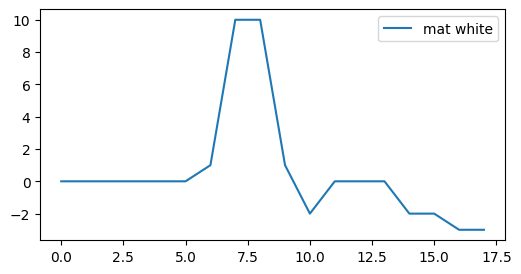

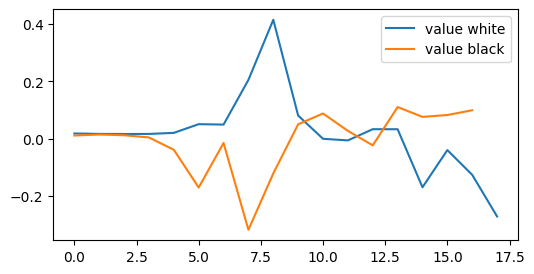

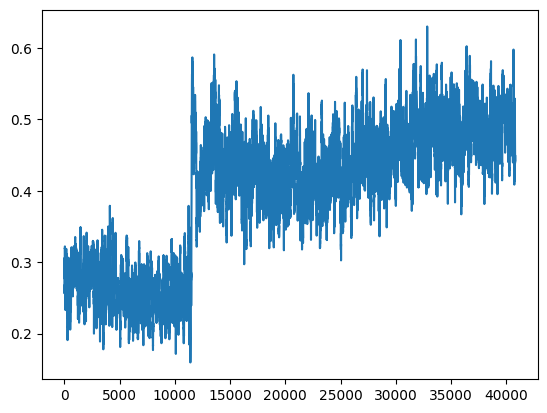

 -- 41110 -- winner: white, i: 83    wins: w = 2366.0, b = 2235, d = 7228
 -- 41120 -- winner: black, i: 46    wins: w = 2371.0, b = 2240, d = 7243
 -- 41130 -- winner: black, i: 34    wins: w = 2373.0, b = 2248, d = 7265
 -- 41140 -- winner: black, i: 10    wins: w = 2378.0, b = 2253, d = 7292
 -- 41150 -- winner: white, i: 97    wins: w = 2386.0, b = 2255, d = 7304


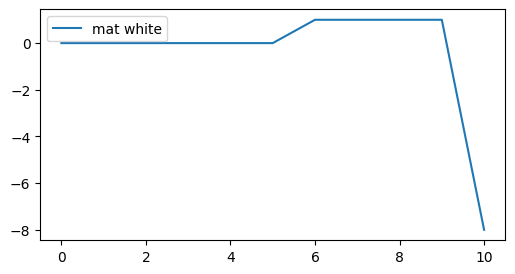

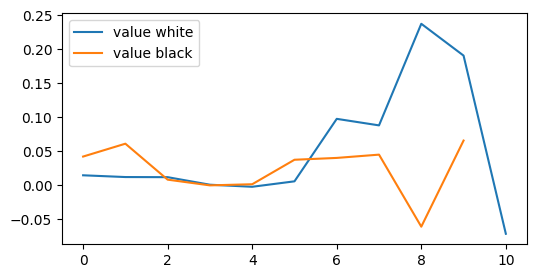

 -- 41160 -- winner: white, i: 115    wins: w = 2391.0, b = 2260, d = 7323
 -- 41170 -- winner: black, i: 52    wins: w = 2397.0, b = 2264, d = 7333
 -- 41180 -- winner: black, i: 74    wins: w = 2401.0, b = 2270, d = 7347
 -- 41190 -- winner: white, i: 77    wins: w = 2408.0, b = 2273, d = 7362
 -- 41200 -- winner: black, i: 64    wins: w = 2410.0, b = 2281, d = 7376


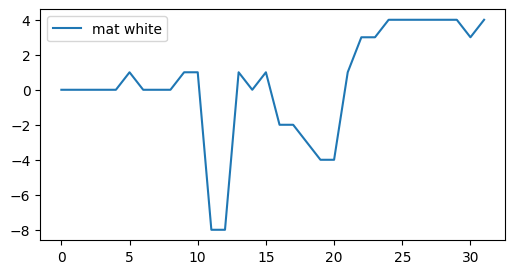

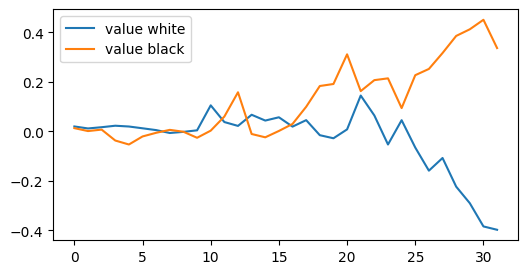

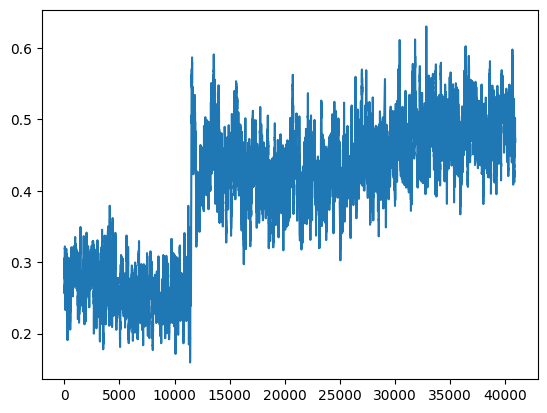

 -- 41210 -- winner: white, i: 13    wins: w = 2416.0, b = 2285, d = 7389
 -- 41220 -- winner: black, i: 92    wins: w = 2420.0, b = 2291, d = 7394
 -- 41230 -- winner: black, i: 92    wins: w = 2424.0, b = 2297, d = 7410
 -- 41240 -- winner: black, i: 6    wins: w = 2428.0, b = 2303, d = 7424
 -- 41250 -- winner: black, i: 82    wins: w = 2434.0, b = 2307, d = 7454


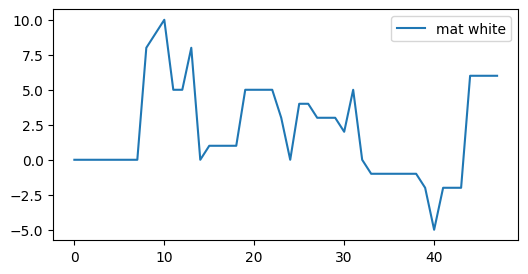

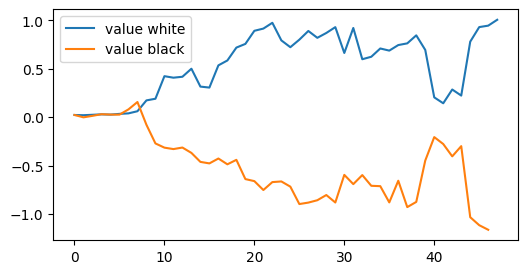

game termianted, mat diff =  7
 -- 41260 -- winner: black, i: 78    wins: w = 2438.5, b = 2312, d = 7475
 -- 41270 -- winner: black, i: 98    wins: w = 2442.5, b = 2318, d = 7483
 -- 41280 -- winner: white, i: 95    wins: w = 2450.5, b = 2320, d = 7494
 -- 41290 -- winner: white, i: 89    wins: w = 2457.5, b = 2323, d = 7503
 -- 41300 -- winner: black, i: 56    wins: w = 2465.5, b = 2325, d = 7516


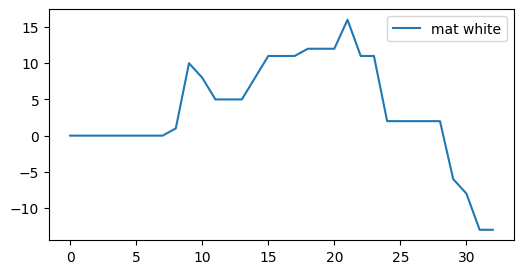

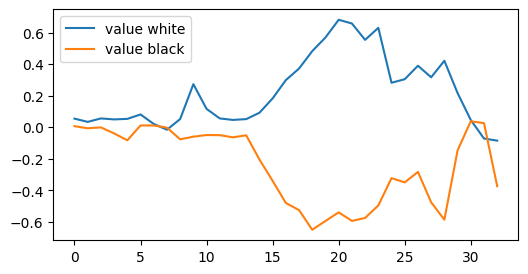

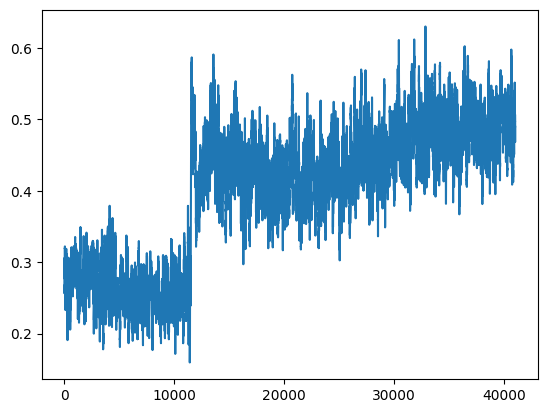

 -- 41310 -- winner: white, i: 83    wins: w = 2472.5, b = 2328, d = 7536
 -- 41320 -- winner: black, i: 50    wins: w = 2477.5, b = 2333, d = 7554
 -- 41330 -- winner: white, i: 63    wins: w = 2483.5, b = 2337, d = 7580
 -- 41340 -- winner: white, i: 51    wins: w = 2489.5, b = 2341, d = 7592
 -- 41350 -- winner: white, i: 17    wins: w = 2493.5, b = 2347, d = 7616


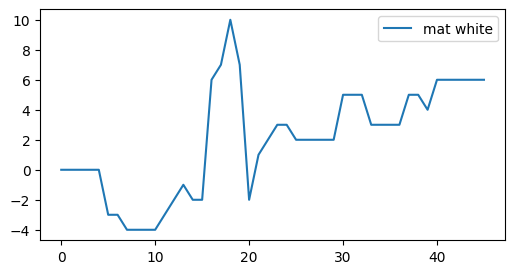

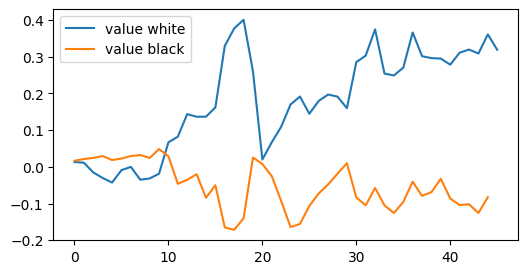

 -- 41360 -- winner: black, i: 20    wins: w = 2497.5, b = 2353, d = 7628
 -- 41370 -- winner: black, i: 44    wins: w = 2503.5, b = 2357, d = 7635
 -- 41380 -- winner: black, i: 40    wins: w = 2504.5, b = 2366, d = 7656
 -- 41390 -- winner: black, i: 52    wins: w = 2506.5, b = 2374, d = 7673
 -- 41400 -- winner: white, i: 39    wins: w = 2510.5, b = 2380, d = 7681


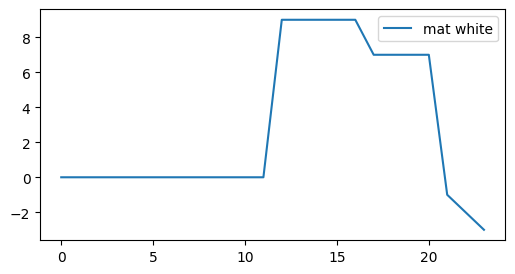

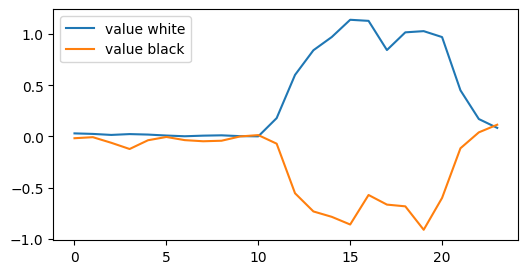

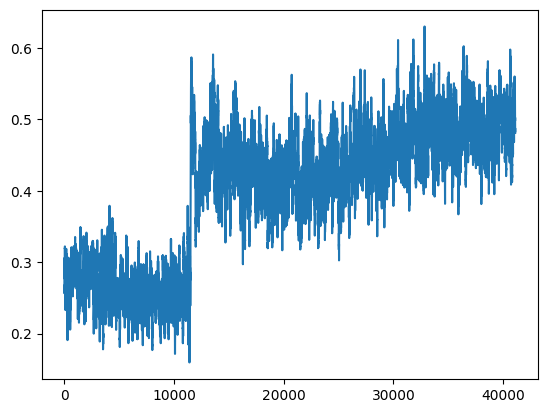

 -- 41410 -- winner: white, i: 101    wins: w = 2515.5, b = 2385, d = 7699
 -- 41420 -- winner: black, i: 36    wins: w = 2521.5, b = 2389, d = 7714
 -- 41430 -- winner: white, i: 59    wins: w = 2527.5, b = 2393, d = 7743
 -- 41440 -- winner: black, i: 130    wins: w = 2532.5, b = 2398, d = 7753
 -- 41450 -- winner: white, i: 75    wins: w = 2537.5, b = 2403, d = 7769


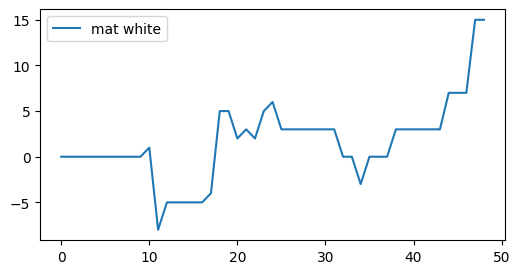

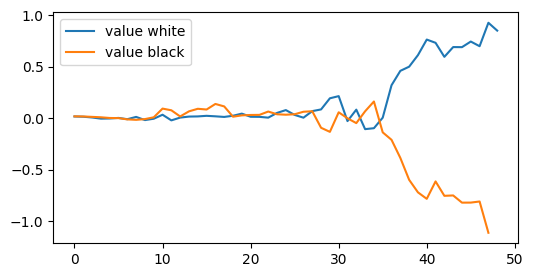

 -- 41460 -- winner: black, i: 12    wins: w = 2542.5, b = 2408, d = 7785
 -- 41470 -- winner: black, i: 52    wins: w = 2546.5, b = 2414, d = 7805
 -- 41480 -- winner: black, i: 26    wins: w = 2553.5, b = 2417, d = 7819
 -- 41490 -- winner: white, i: 69    wins: w = 2559.5, b = 2421, d = 7827
 -- 41500 -- winner: white, i: 109    wins: w = 2565.5, b = 2425, d = 7835


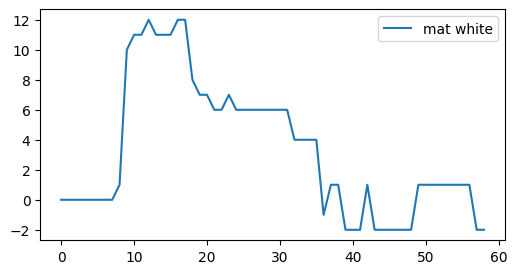

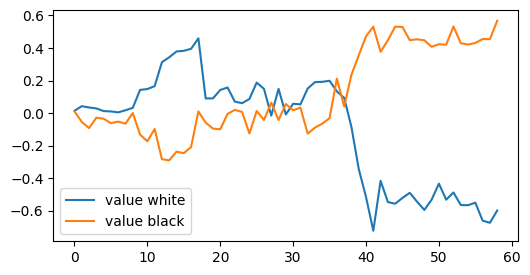

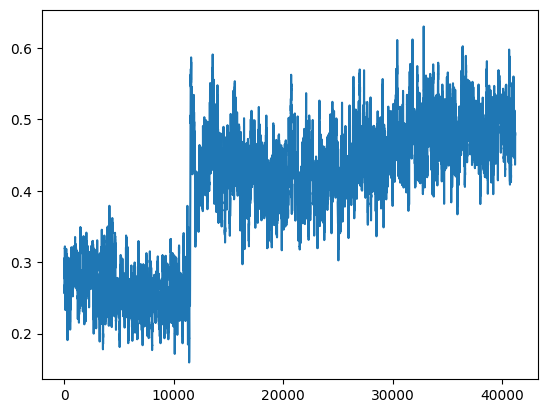

 -- 41510 -- winner: white, i: 87    wins: w = 2570.5, b = 2430, d = 7844
 -- 41520 -- winner: white, i: 37    wins: w = 2578.5, b = 2432, d = 7864
 -- 41530 -- winner: black, i: 108    wins: w = 2583.5, b = 2437, d = 7885
 -- 41540 -- winner: white, i: 89    wins: w = 2588.5, b = 2442, d = 7907
 -- 41550 -- winner: black, i: 14    wins: w = 2594.5, b = 2446, d = 7925


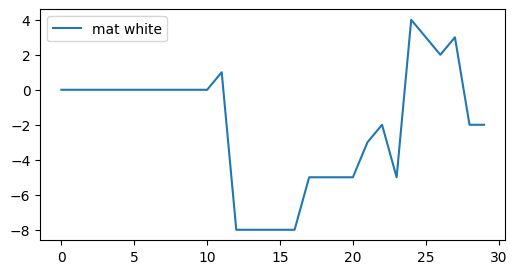

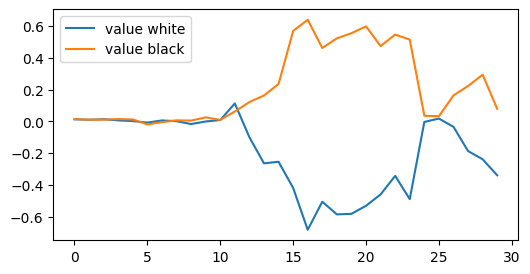

 -- 41560 -- winner: black, i: 86    wins: w = 2599.5, b = 2451, d = 7941
 -- 41570 -- winner: black, i: 82    wins: w = 2607.5, b = 2453, d = 7959
 -- 41580 -- winner: white, i: 103    wins: w = 2611.5, b = 2459, d = 7967
 -- 41590 -- winner: black, i: 80    wins: w = 2617.5, b = 2463, d = 7979
 -- 41600 -- winner: black, i: 44    wins: w = 2622.5, b = 2468, d = 7984


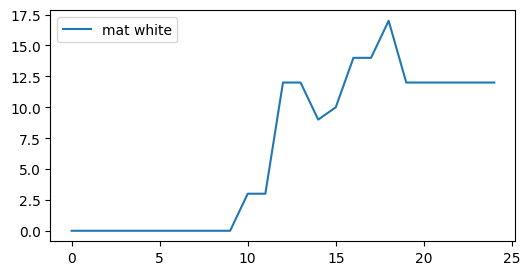

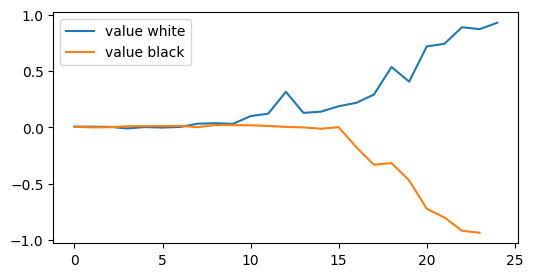

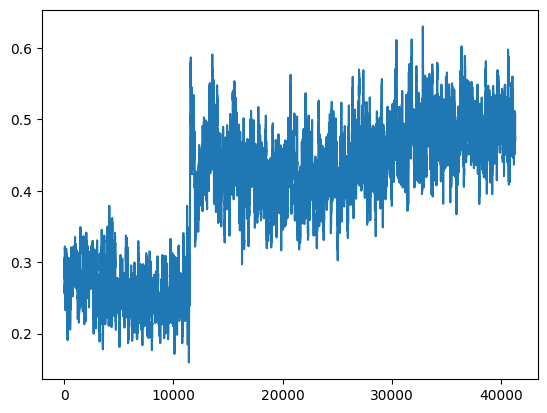

 -- 41610 -- winner: white, i: 17    wins: w = 2628.5, b = 2472, d = 8001
 -- 41620 -- winner: black, i: 30    wins: w = 2635.5, b = 2475, d = 8007
 -- 41630 -- winner: white, i: 37    wins: w = 2643.5, b = 2477, d = 8022
 -- 41640 -- winner: black, i: 48    wins: w = 2645.5, b = 2485, d = 8030
 -- 41650 -- winner: black, i: 62    wins: w = 2652.5, b = 2488, d = 8045


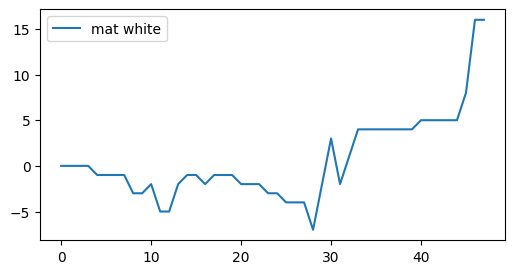

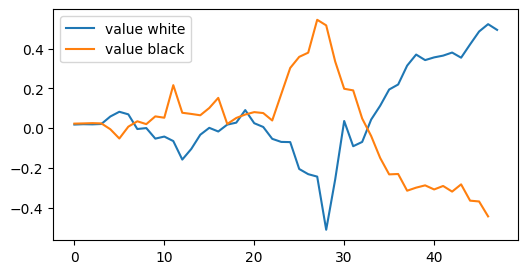

 -- 41660 -- winner: white, i: 45    wins: w = 2658.5, b = 2492, d = 8064
 -- 41670 -- winner: white, i: 37    wins: w = 2663.5, b = 2497, d = 8074
 -- 41680 -- winner: white, i: 105    wins: w = 2668.5, b = 2502, d = 8086
 -- 41690 -- winner: black, i: 64    wins: w = 2673.5, b = 2507, d = 8112
 -- 41700 -- winner: white, i: 43    wins: w = 2681.5, b = 2509, d = 8127


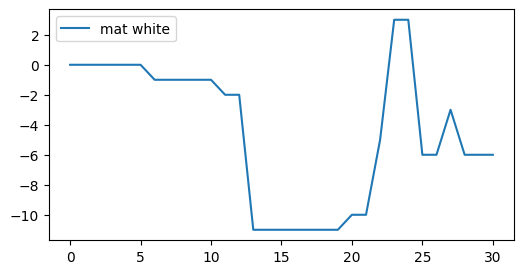

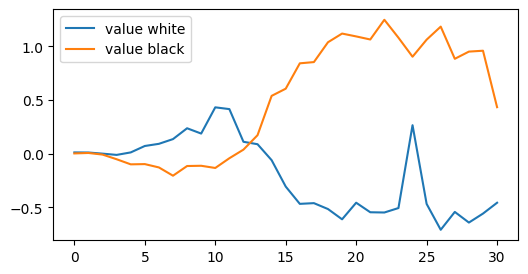

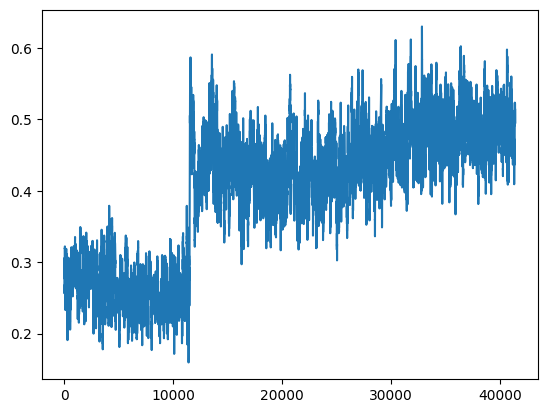

 -- 41710 -- winner: black, i: 68    wins: w = 2686.5, b = 2514, d = 8138
 -- 41720 -- winner: black, i: 126    wins: w = 2693.5, b = 2517, d = 8155
 -- 41730 -- winner: black, i: 88    wins: w = 2700.5, b = 2520, d = 8163
 -- 41740 -- winner: white, i: 43    wins: w = 2706.5, b = 2524, d = 8175
 -- 41750 -- winner: black, i: 28    wins: w = 2713.5, b = 2527, d = 8191


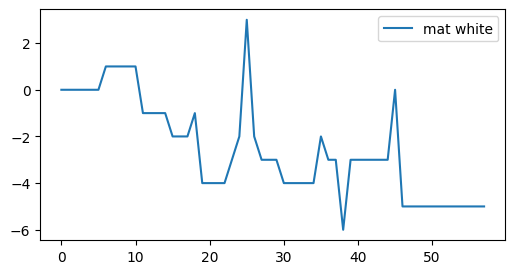

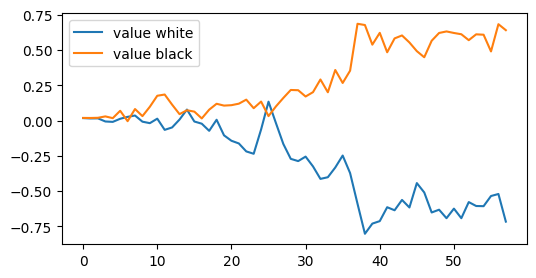

 -- 41760 -- winner: white, i: 81    wins: w = 2720.5, b = 2530, d = 8205
 -- 41770 -- winner: black, i: 74    wins: w = 2726.5, b = 2534, d = 8227
 -- 41780 -- winner: white, i: 85    wins: w = 2731.5, b = 2539, d = 8237
 -- 41790 -- winner: black, i: 50    wins: w = 2738.5, b = 2542, d = 8244
 -- 41800 -- winner: white, i: 35    wins: w = 2744.5, b = 2546, d = 8252


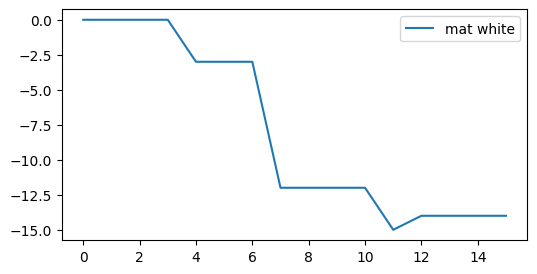

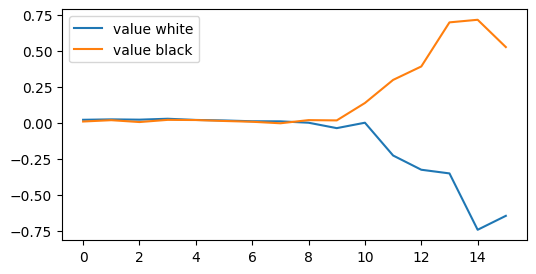

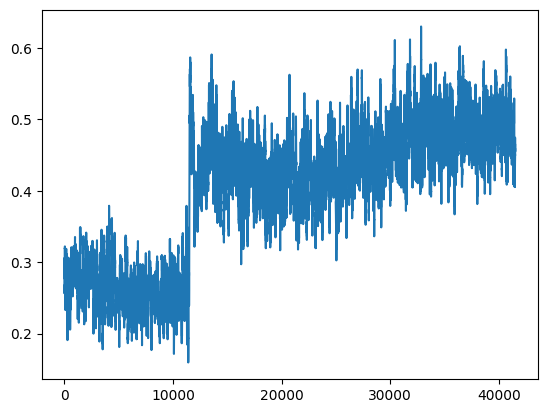

 -- 41810 -- winner: white, i: 109    wins: w = 2746.5, b = 2554, d = 8267
 -- 41820 -- winner: white, i: 73    wins: w = 2753.5, b = 2557, d = 8283
 -- 41830 -- winner: black, i: 50    wins: w = 2759.5, b = 2561, d = 8296
 -- 41840 -- winner: black, i: 52    wins: w = 2763.5, b = 2567, d = 8319
 -- 41850 -- winner: white, i: 91    wins: w = 2768.5, b = 2572, d = 8325


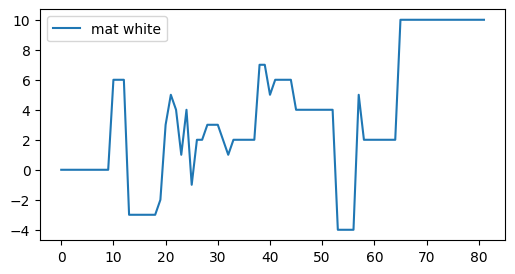

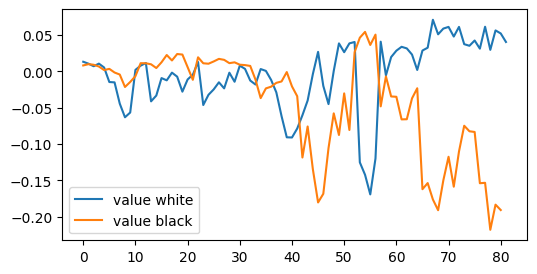

 -- 41860 -- winner: white, i: 149    wins: w = 2772.5, b = 2578, d = 8346
 -- 41870 -- winner: white, i: 57    wins: w = 2777.5, b = 2583, d = 8362
 -- 41880 -- winner: white, i: 41    wins: w = 2783.5, b = 2587, d = 8379
 -- 41890 -- winner: black, i: 116    wins: w = 2785.5, b = 2595, d = 8405
 -- 41900 -- winner: white, i: 121    wins: w = 2790.5, b = 2600, d = 8412


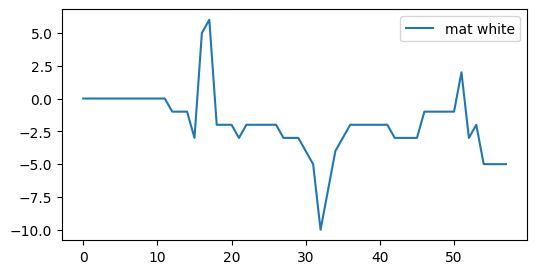

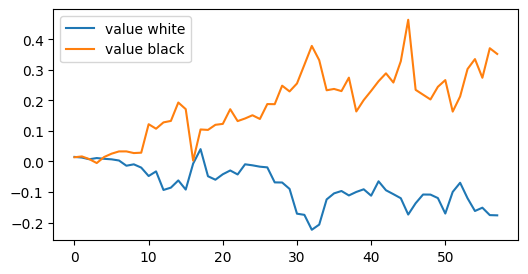

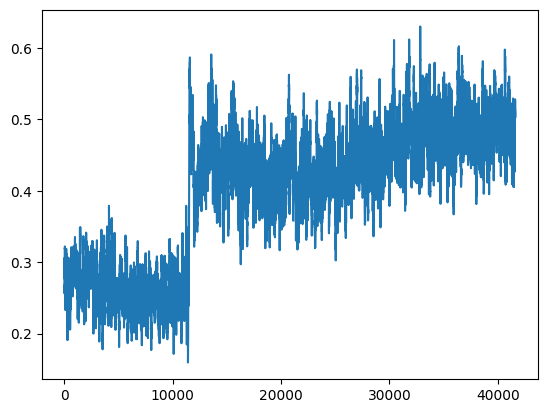

 -- 41910 -- winner: black, i: 76    wins: w = 2796.5, b = 2604, d = 8429
 -- 41920 -- winner: white, i: 67    wins: w = 2801.5, b = 2609, d = 8436
 -- 41930 -- winner: black, i: 58    wins: w = 2805.5, b = 2615, d = 8457
 -- 41940 -- winner: black, i: 100    wins: w = 2810.5, b = 2620, d = 8477
 -- 41950 -- winner: black, i: 80    wins: w = 2813.5, b = 2627, d = 8493


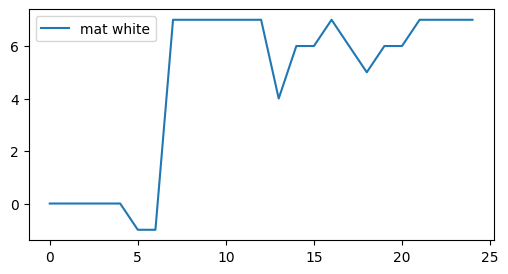

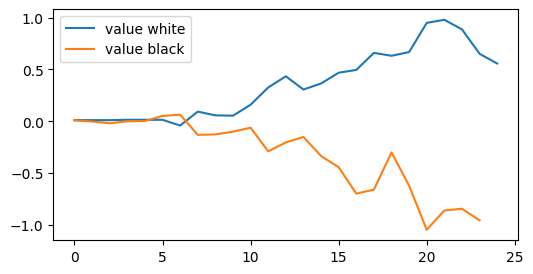

 -- 41960 -- winner: black, i: 118    wins: w = 2818.5, b = 2632, d = 8506
 -- 41970 -- winner: white, i: 9    wins: w = 2823.5, b = 2637, d = 8516
 -- 41980 -- winner: white, i: 25    wins: w = 2830.5, b = 2640, d = 8521
 -- 41990 -- winner: black, i: 128    wins: w = 2834.5, b = 2646, d = 8533
 -- 42000 -- winner: white, i: 17    wins: w = 2841.5, b = 2649, d = 8555


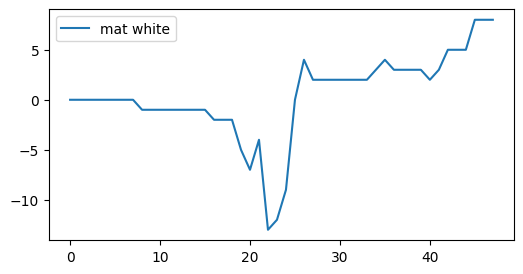

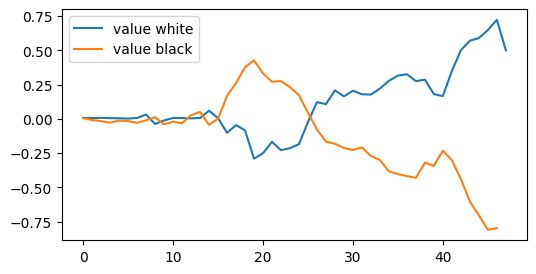

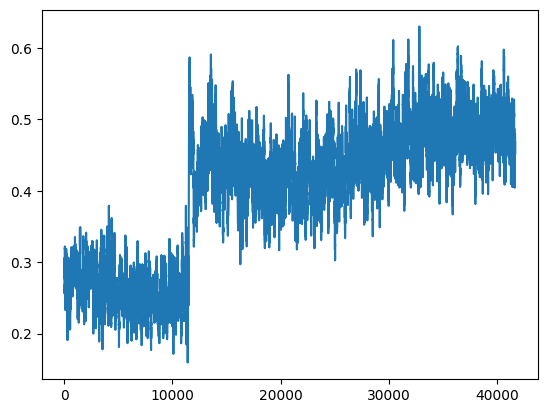

 -- 42010 -- winner: black, i: 96    wins: w = 2845.5, b = 2655, d = 8575
 -- 42020 -- winner: white, i: 33    wins: w = 2851.5, b = 2659, d = 8595
 -- 42030 -- winner: white, i: 117    wins: w = 2855.5, b = 2665, d = 8606
 -- 42040 -- winner: white, i: 81    wins: w = 2861.5, b = 2669, d = 8614
 -- 42050 -- winner: white, i: 121    wins: w = 2867.5, b = 2673, d = 8635


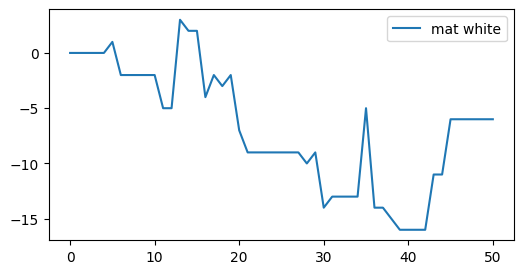

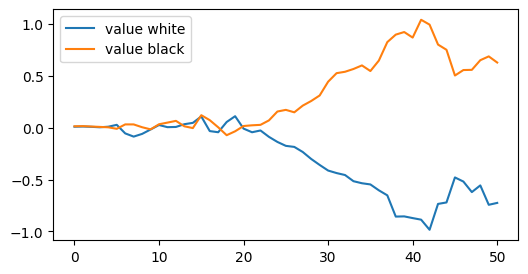

 -- 42060 -- winner: black, i: 12    wins: w = 2874.5, b = 2676, d = 8648
 -- 42070 -- winner: black, i: 108    wins: w = 2876.5, b = 2684, d = 8662
 -- 42080 -- winner: white, i: 27    wins: w = 2882.5, b = 2688, d = 8679
 -- 42090 -- winner: white, i: 83    wins: w = 2889.5, b = 2691, d = 8686
 -- 42100 -- winner: black, i: 30    wins: w = 2893.5, b = 2697, d = 8702


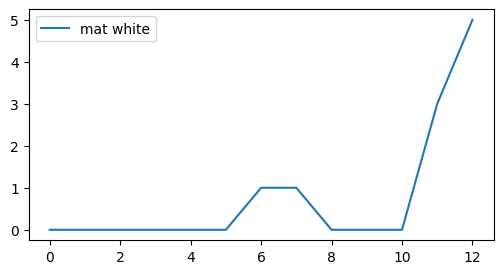

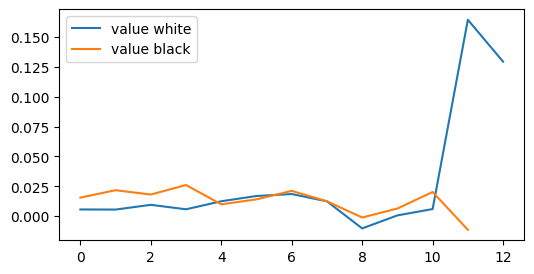

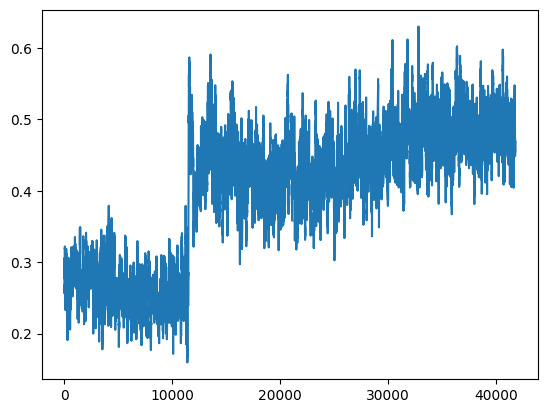

 -- 42110 -- winner: black, i: 62    wins: w = 2897.5, b = 2703, d = 8719
 -- 42120 -- winner: white, i: 103    wins: w = 2902.5, b = 2708, d = 8730
 -- 42130 -- winner: black, i: 138    wins: w = 2908.5, b = 2712, d = 8736
 -- 42140 -- winner: black, i: 110    wins: w = 2911.5, b = 2719, d = 8747
 -- 42150 -- winner: black, i: 144    wins: w = 2914.5, b = 2726, d = 8763


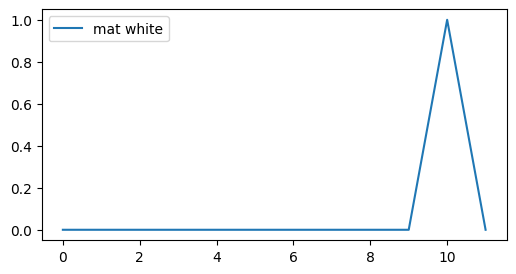

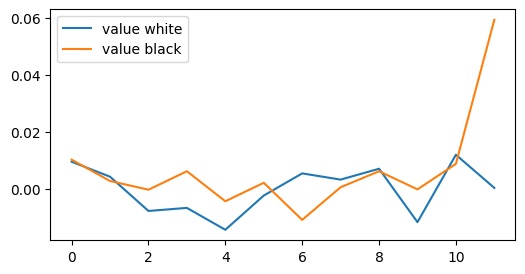

 -- 42160 -- winner: black, i: 130    wins: w = 2917.5, b = 2733, d = 8778
 -- 42170 -- winner: white, i: 121    wins: w = 2922.5, b = 2738, d = 8798
 -- 42180 -- winner: white, i: 57    wins: w = 2929.5, b = 2741, d = 8808
 -- 42190 -- winner: white, i: 5    wins: w = 2935.5, b = 2745, d = 8827
 -- 42200 -- winner: black, i: 76    wins: w = 2940.5, b = 2750, d = 8850


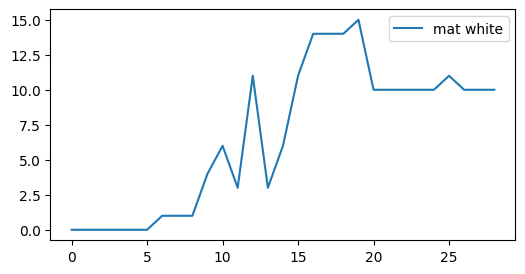

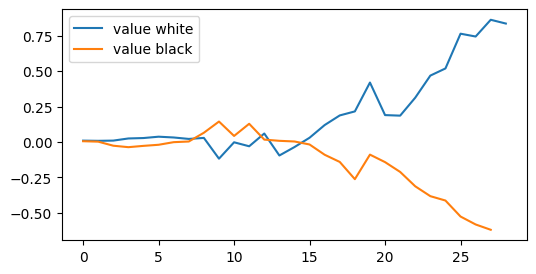

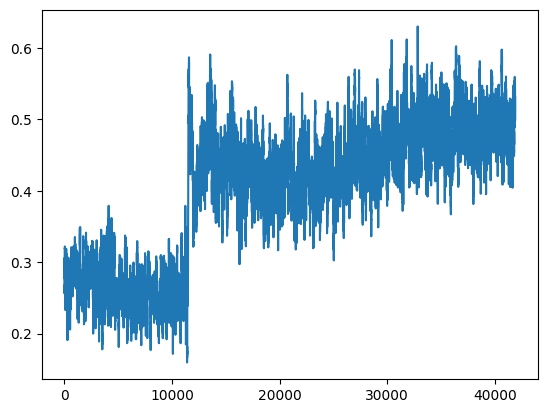

 -- 42210 -- winner: white, i: 33    wins: w = 2946.5, b = 2754, d = 8862
 -- 42220 -- winner: black, i: 94    wins: w = 2951.5, b = 2759, d = 8875
 -- 42230 -- winner: white, i: 53    wins: w = 2956.5, b = 2764, d = 8889
 -- 42240 -- winner: black, i: 14    wins: w = 2959.5, b = 2771, d = 8902
 -- 42250 -- winner: black, i: 22    wins: w = 2962.5, b = 2778, d = 8912


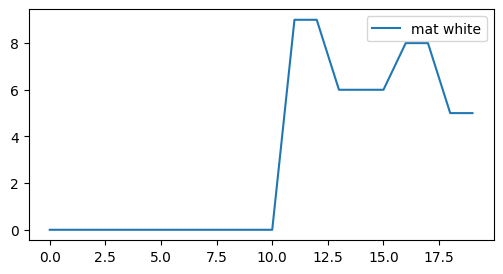

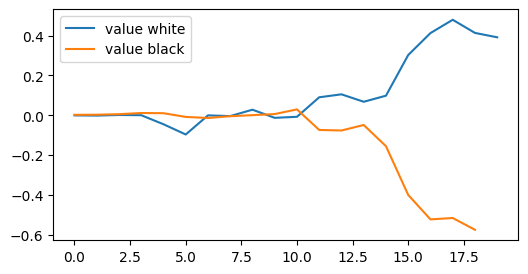

 -- 42260 -- winner: black, i: 110    wins: w = 2966.5, b = 2784, d = 8931
 -- 42270 -- winner: black, i: 88    wins: w = 2975.5, b = 2785, d = 8941
 -- 42280 -- winner: white, i: 61    wins: w = 2982.5, b = 2788, d = 8956
 -- 42290 -- winner: white, i: 107    wins: w = 2989.5, b = 2791, d = 8974
 -- 42300 -- winner: white, i: 109    wins: w = 2993.5, b = 2797, d = 8982


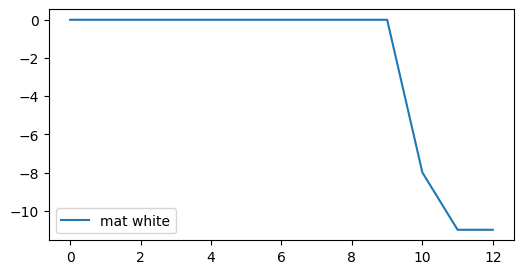

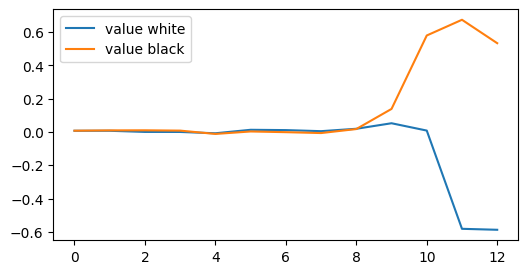

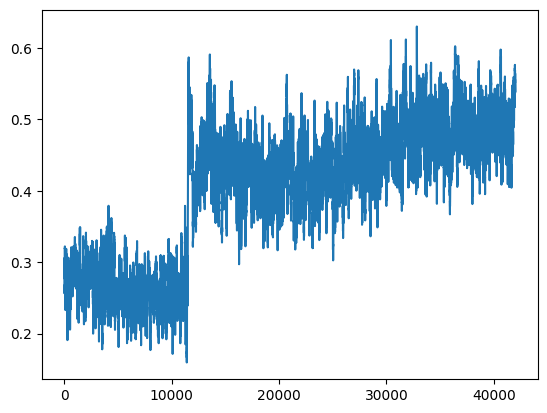

 -- 42310 -- winner: black, i: 164    wins: w = 2997.5, b = 2803, d = 8998
 -- 42320 -- winner: white, i: 79    wins: w = 3002.5, b = 2808, d = 9019
 -- 42330 -- winner: black, i: 26    wins: w = 3007.5, b = 2813, d = 9027
 -- 42340 -- winner: black, i: 110    wins: w = 3012.5, b = 2818, d = 9040
 -- 42350 -- winner: white, i: 65    wins: w = 3018.5, b = 2822, d = 9057


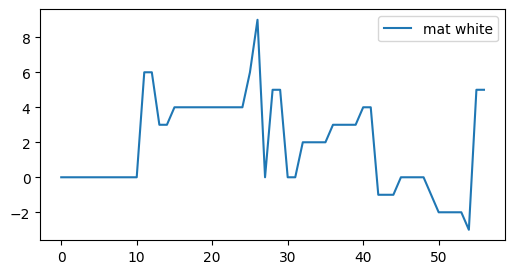

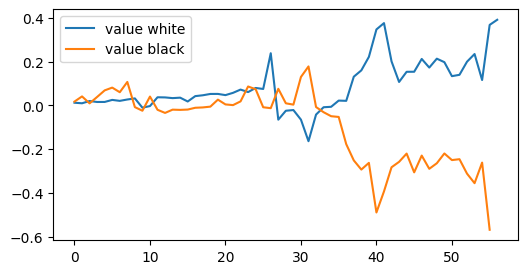

 -- 42360 -- winner: black, i: 36    wins: w = 3027.5, b = 2823, d = 9085
 -- 42370 -- winner: black, i: 92    wins: w = 3027.5, b = 2833, d = 9100
 -- 42380 -- winner: white, i: 61    wins: w = 3034.5, b = 2836, d = 9116
 -- 42390 -- winner: black, i: 128    wins: w = 3039.5, b = 2841, d = 9132
 -- 42400 -- winner: white, i: 45    wins: w = 3045.5, b = 2845, d = 9148


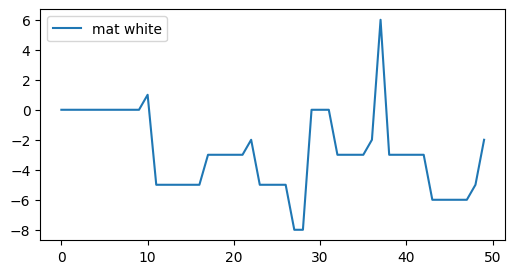

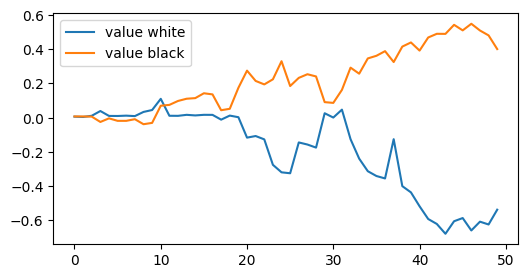

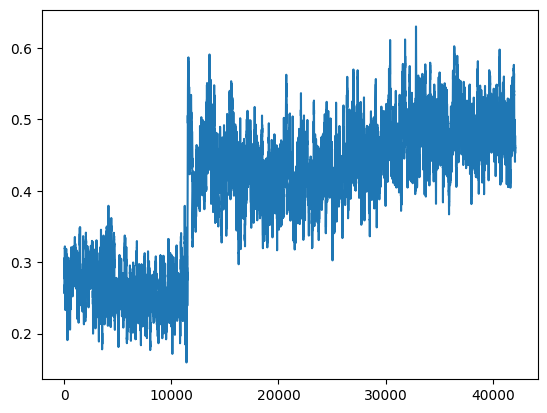

 -- 42410 -- winner: white, i: 67    wins: w = 3050.5, b = 2850, d = 9155
 -- 42420 -- winner: black, i: 24    wins: w = 3056.5, b = 2854, d = 9180
 -- 42430 -- winner: black, i: 58    wins: w = 3059.5, b = 2861, d = 9197
 -- 42440 -- winner: white, i: 65    wins: w = 3064.5, b = 2866, d = 9202
 -- 42450 -- winner: white, i: 97    wins: w = 3071.5, b = 2869, d = 9213


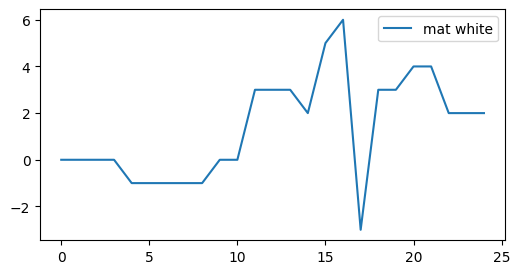

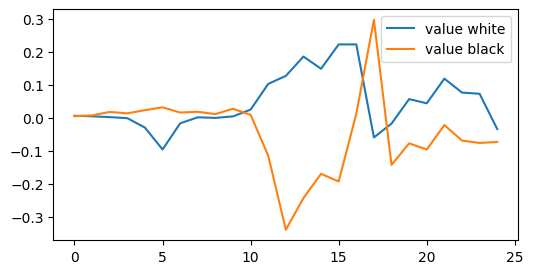

 -- 42460 -- winner: black, i: 68    wins: w = 3075.5, b = 2875, d = 9222
 -- 42470 -- winner: white, i: 11    wins: w = 3081.5, b = 2879, d = 9231
 -- 42480 -- winner: white, i: 107    wins: w = 3086.5, b = 2884, d = 9239
 -- 42490 -- winner: white, i: 15    wins: w = 3093.5, b = 2887, d = 9259
 -- 42500 -- winner: white, i: 113    wins: w = 3098.5, b = 2892, d = 9267


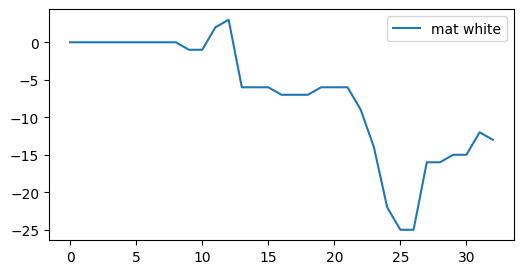

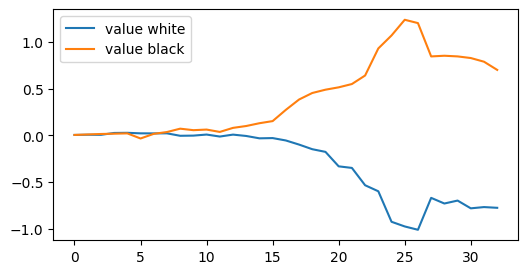

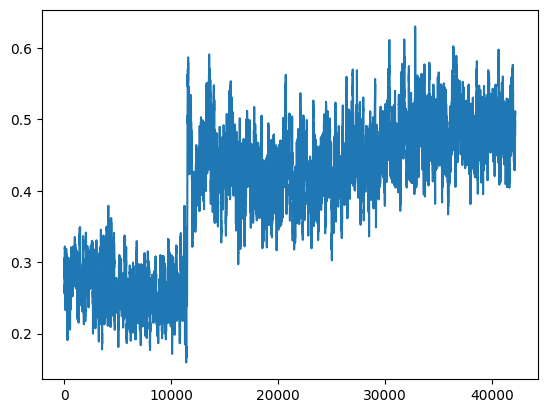

 -- 42510 -- winner: white, i: 25    wins: w = 3103.5, b = 2897, d = 9294
 -- 42520 -- winner: black, i: 102    wins: w = 3108.5, b = 2902, d = 9318
 -- 42530 -- winner: black, i: 48    wins: w = 3111.5, b = 2909, d = 9331
 -- 42540 -- winner: black, i: 18    wins: w = 3115.5, b = 2915, d = 9337
 -- 42550 -- winner: white, i: 91    wins: w = 3120.5, b = 2920, d = 9355


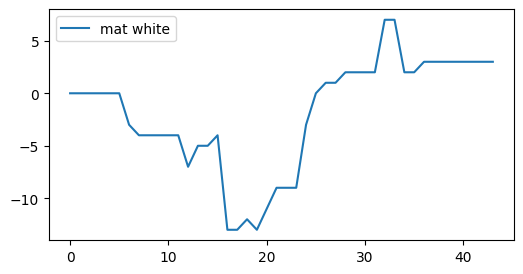

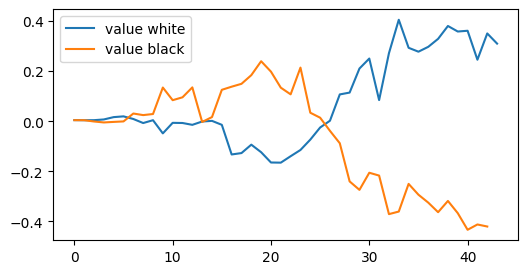

 -- 42560 -- winner: white, i: 25    wins: w = 3125.5, b = 2925, d = 9377
 -- 42570 -- winner: white, i: 59    wins: w = 3133.5, b = 2927, d = 9387
 -- 42580 -- winner: black, i: 14    wins: w = 3137.5, b = 2933, d = 9392
 -- 42590 -- winner: white, i: 49    wins: w = 3141.5, b = 2939, d = 9418
 -- 42600 -- winner: black, i: 44    wins: w = 3145.5, b = 2945, d = 9445


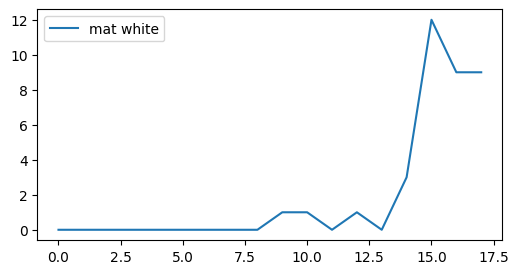

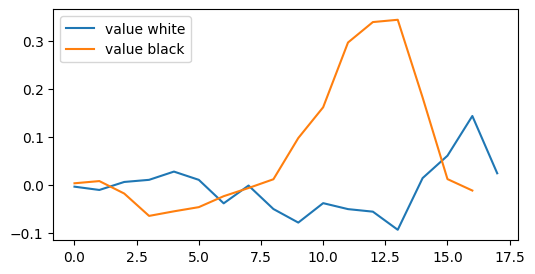

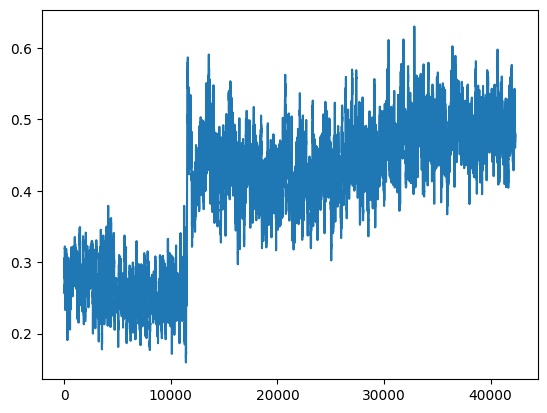

 -- 42610 -- winner: white, i: 103    wins: w = 3150.5, b = 2950, d = 9460
 -- 42620 -- winner: white, i: 103    wins: w = 3156.5, b = 2954, d = 9474
 -- 42630 -- winner: white, i: 97    wins: w = 3162.5, b = 2958, d = 9486
 -- 42640 -- winner: black, i: 10    wins: w = 3167.5, b = 2963, d = 9492
 -- 42650 -- winner: black, i: 32    wins: w = 3172.5, b = 2968, d = 9504


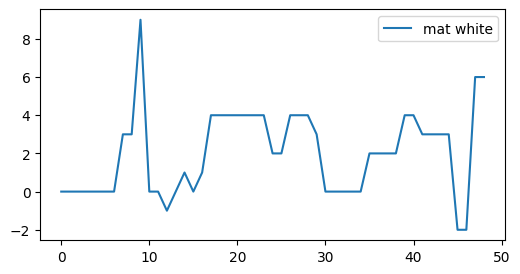

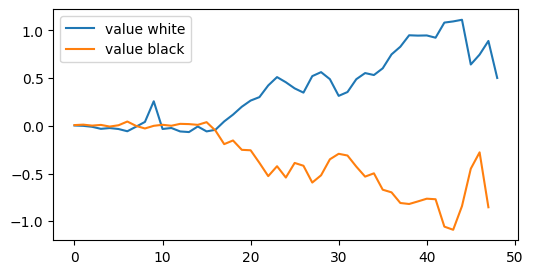

 -- 42660 -- winner: white, i: 81    wins: w = 3176.5, b = 2974, d = 9514
 -- 42670 -- winner: black, i: 8    wins: w = 3181.5, b = 2979, d = 9522
 -- 42680 -- winner: white, i: 17    wins: w = 3187.5, b = 2983, d = 9543
 -- 42690 -- winner: white, i: 11    wins: w = 3194.5, b = 2986, d = 9554
 -- 42700 -- winner: black, i: 48    wins: w = 3196.5, b = 2994, d = 9576


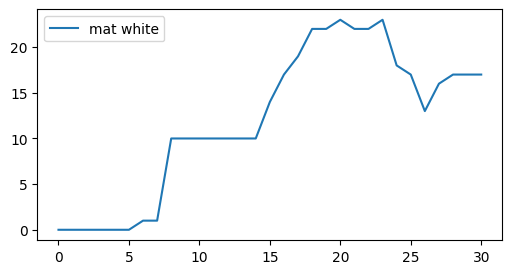

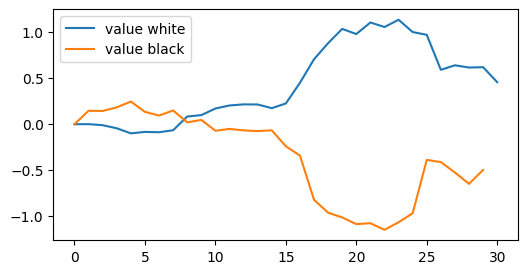

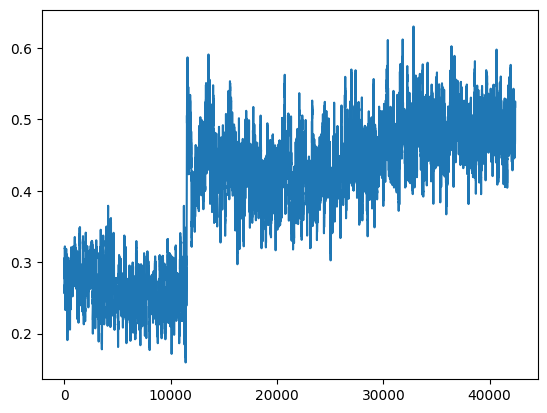

 -- 42710 -- winner: white, i: 67    wins: w = 3204.5, b = 2996, d = 9586
 -- 42720 -- winner: white, i: 79    wins: w = 3210.5, b = 3000, d = 9598
 -- 42730 -- winner: black, i: 30    wins: w = 3212.5, b = 3008, d = 9605
 -- 42740 -- winner: white, i: 79    wins: w = 3215.5, b = 3015, d = 9618
 -- 42750 -- winner: black, i: 80    wins: w = 3220.5, b = 3020, d = 9633


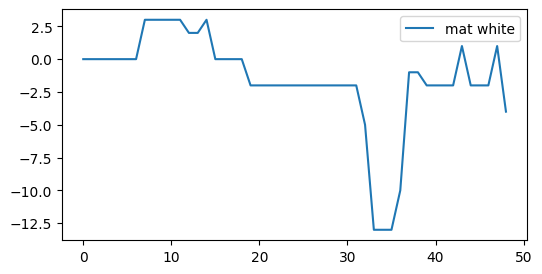

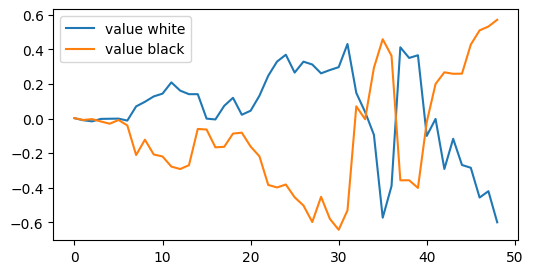

 -- 42760 -- winner: white, i: 95    wins: w = 3227.5, b = 3023, d = 9641
 -- 42770 -- winner: black, i: 72    wins: w = 3229.5, b = 3031, d = 9648
 -- 42780 -- winner: black, i: 6    wins: w = 3232.5, b = 3038, d = 9660
 -- 42790 -- winner: white, i: 77    wins: w = 3238.5, b = 3042, d = 9682
 -- 42800 -- winner: black, i: 48    wins: w = 3242.5, b = 3048, d = 9693


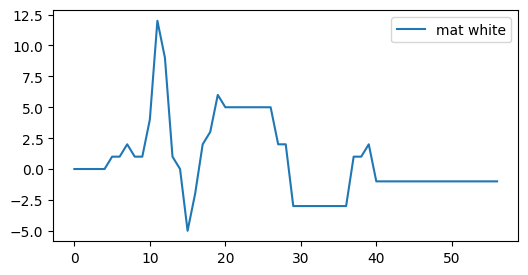

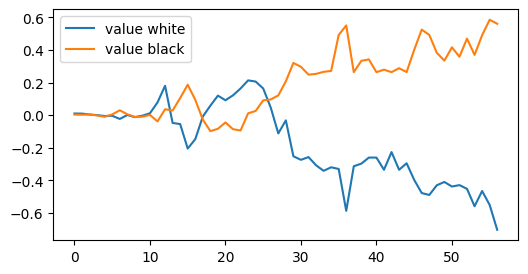

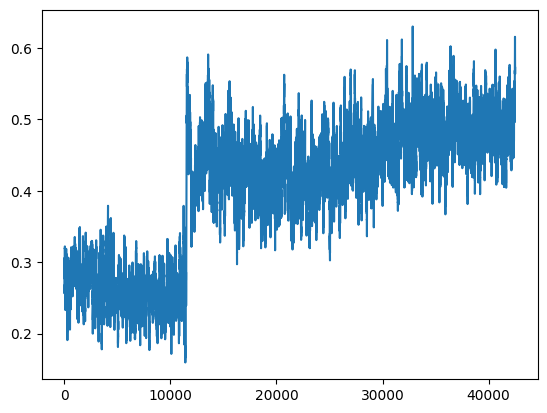

 -- 42810 -- winner: white, i: 57    wins: w = 3249.5, b = 3051, d = 9703
 -- 42820 -- winner: white, i: 99    wins: w = 3255.5, b = 3055, d = 9720
 -- 42830 -- winner: white, i: 97    wins: w = 3260.5, b = 3060, d = 9733
 -- 42840 -- winner: white, i: 111    wins: w = 3267.5, b = 3063, d = 9746
 -- 42850 -- winner: black, i: 72    wins: w = 3270.5, b = 3070, d = 9762


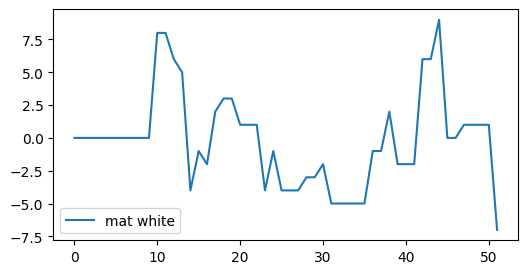

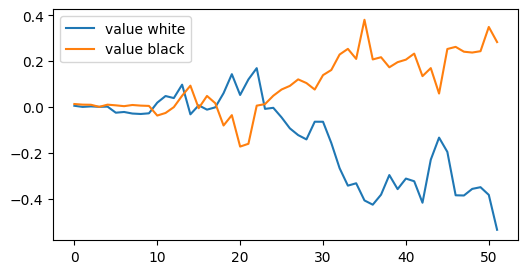

 -- 42860 -- winner: black, i: 92    wins: w = 3276.5, b = 3074, d = 9776
 -- 42870 -- winner: black, i: 112    wins: w = 3280.5, b = 3080, d = 9784
 -- 42880 -- winner: white, i: 67    wins: w = 3286.5, b = 3084, d = 9793
 -- 42890 -- winner: white, i: 53    wins: w = 3292.5, b = 3088, d = 9815
 -- 42900 -- winner: white, i: 103    wins: w = 3297.5, b = 3093, d = 9835


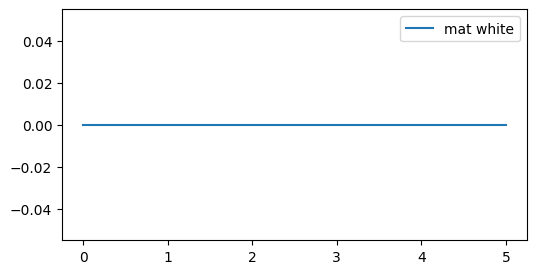

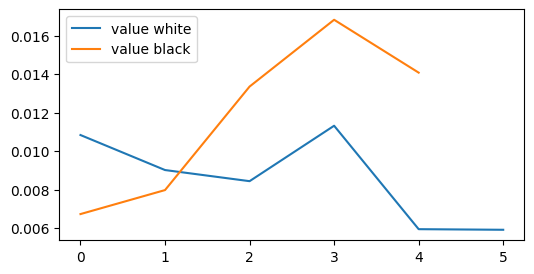

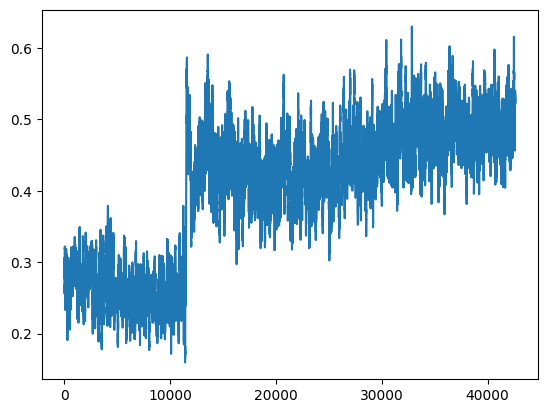

 -- 42910 -- winner: black, i: 60    wins: w = 3301.5, b = 3099, d = 9856
 -- 42920 -- winner: black, i: 214    wins: w = 3305.5, b = 3105, d = 9872
 -- 42930 -- winner: white, i: 119    wins: w = 3311.5, b = 3109, d = 9878
 -- 42940 -- winner: white, i: 91    wins: w = 3318.5, b = 3112, d = 9896
 -- 42950 -- winner: white, i: 65    wins: w = 3324.5, b = 3116, d = 9904


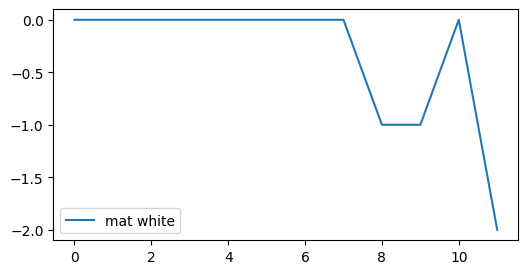

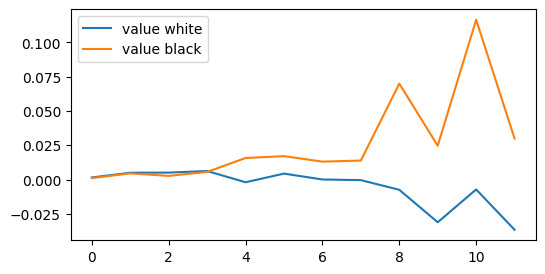

 -- 42960 -- winner: white, i: 57    wins: w = 3332.5, b = 3118, d = 9915
 -- 42970 -- winner: white, i: 9    wins: w = 3338.5, b = 3122, d = 9925
 -- 42980 -- winner: black, i: 30    wins: w = 3347.5, b = 3123, d = 9944
 -- 42990 -- winner: white, i: 81    wins: w = 3352.5, b = 3128, d = 9958
 -- 43000 -- winner: black, i: 86    wins: w = 3359.5, b = 3131, d = 9967


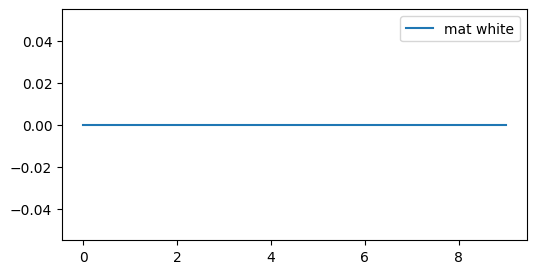

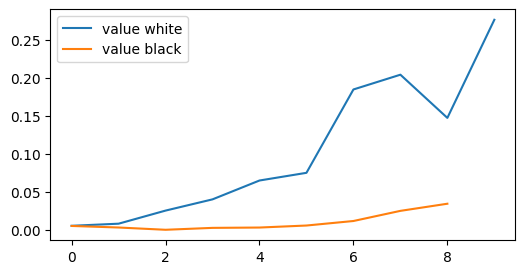

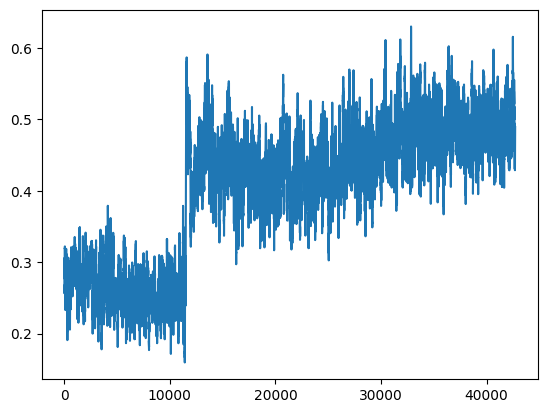

 -- 43010 -- winner: black, i: 104    wins: w = 3364.5, b = 3136, d = 9982
 -- 43020 -- winner: white, i: 95    wins: w = 3372.5, b = 3138, d = 9985
 -- 43030 -- winner: white, i: 91    wins: w = 3377.5, b = 3143, d = 10003
 -- 43040 -- winner: black, i: 146    wins: w = 3383.5, b = 3147, d = 10011
 -- 43050 -- winner: white, i: 43    wins: w = 3390.5, b = 3150, d = 10023


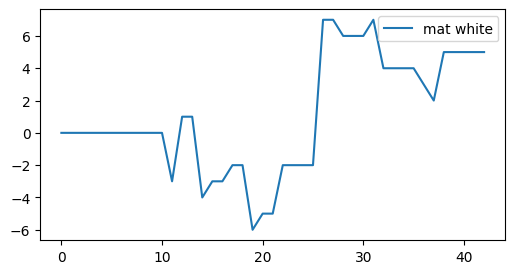

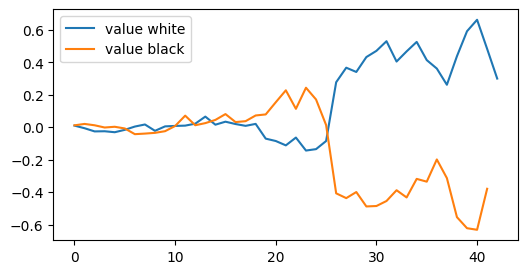

 -- 43060 -- winner: black, i: 124    wins: w = 3393.5, b = 3157, d = 10034
 -- 43070 -- winner: black, i: 60    wins: w = 3398.5, b = 3162, d = 10059
 -- 43080 -- winner: black, i: 96    wins: w = 3402.5, b = 3168, d = 10079
 -- 43090 -- winner: white, i: 147    wins: w = 3408.5, b = 3172, d = 10094
 -- 43100 -- winner: black, i: 46    wins: w = 3414.5, b = 3176, d = 10105


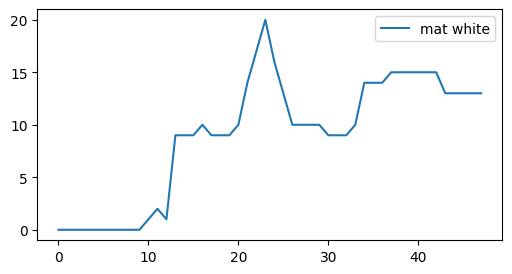

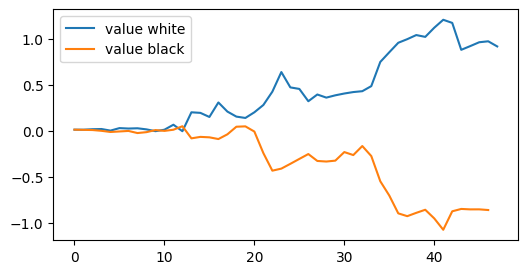

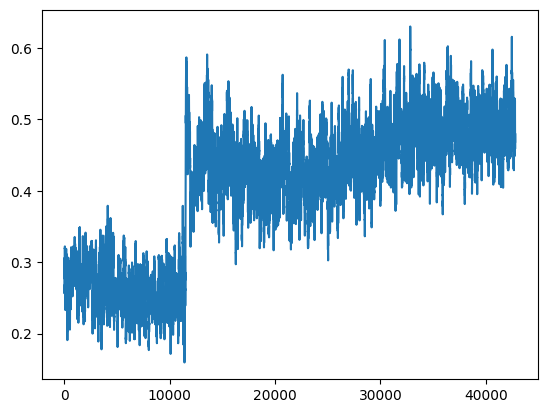

 -- 43110 -- winner: black, i: 60    wins: w = 3421.5, b = 3179, d = 10119
 -- 43120 -- winner: white, i: 87    wins: w = 3428.5, b = 3182, d = 10131
 -- 43130 -- winner: black, i: 64    wins: w = 3434.5, b = 3186, d = 10149
 -- 43140 -- winner: white, i: 55    wins: w = 3442.5, b = 3188, d = 10159
 -- 43150 -- winner: white, i: 17    wins: w = 3447.5, b = 3193, d = 10171


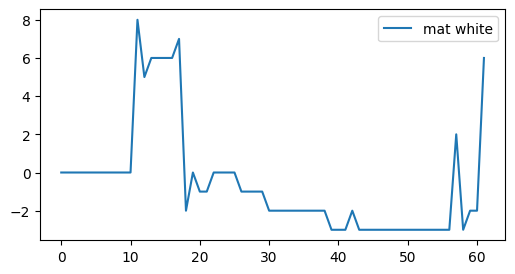

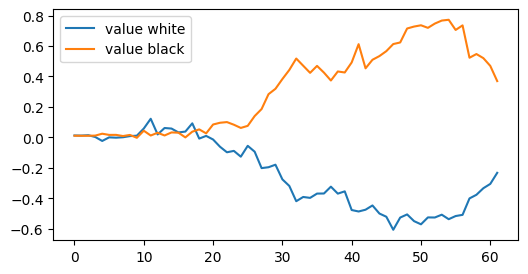

 -- 43160 -- winner: black, i: 114    wins: w = 3452.5, b = 3198, d = 10180
 -- 43170 -- winner: black, i: 60    wins: w = 3455.5, b = 3205, d = 10189
 -- 43180 -- winner: white, i: 43    wins: w = 3460.5, b = 3210, d = 10203
 -- 43190 -- winner: black, i: 48    wins: w = 3464.5, b = 3216, d = 10220
 -- 43200 -- winner: black, i: 46    wins: w = 3470.5, b = 3220, d = 10229


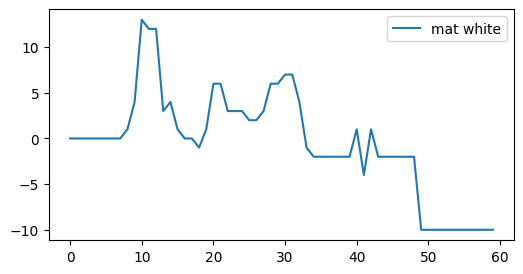

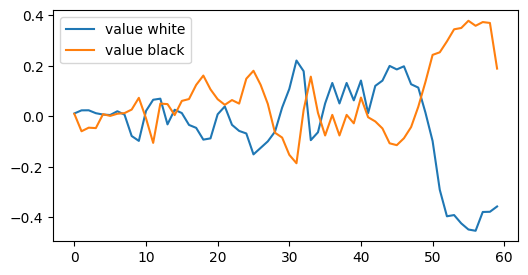

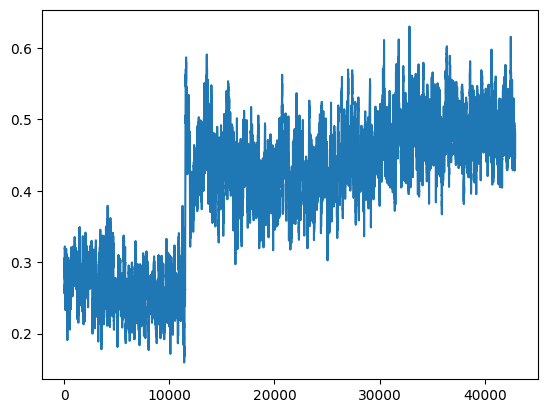

 -- 43210 -- winner: white, i: 29    wins: w = 3474.5, b = 3226, d = 10238
 -- 43220 -- winner: white, i: 31    wins: w = 3482.5, b = 3228, d = 10252
 -- 43230 -- winner: black, i: 72    wins: w = 3486.5, b = 3234, d = 10271
 -- 43240 -- winner: white, i: 81    wins: w = 3491.5, b = 3239, d = 10280
 -- 43250 -- winner: white, i: 39    wins: w = 3496.5, b = 3244, d = 10296


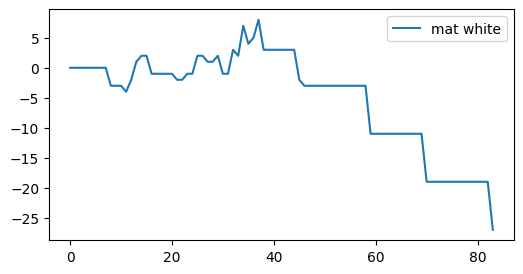

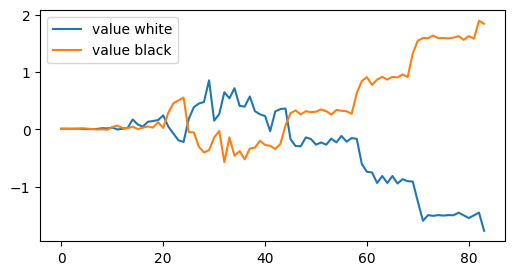

 -- 43260 -- winner: black, i: 106    wins: w = 3500.5, b = 3250, d = 10317
 -- 43270 -- winner: white, i: 97    wins: w = 3506.5, b = 3254, d = 10339
 -- 43280 -- winner: black, i: 74    wins: w = 3512.5, b = 3258, d = 10344
 -- 43290 -- winner: white, i: 111    wins: w = 3518.5, b = 3262, d = 10348
 -- 43300 -- winner: black, i: 74    wins: w = 3521.5, b = 3269, d = 10357


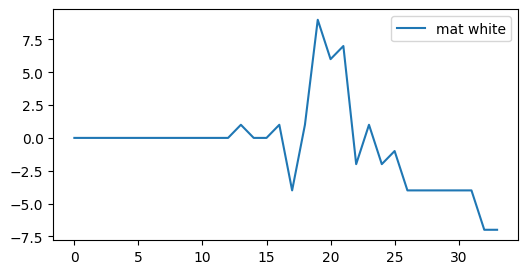

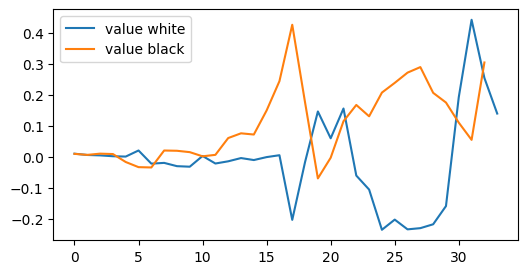

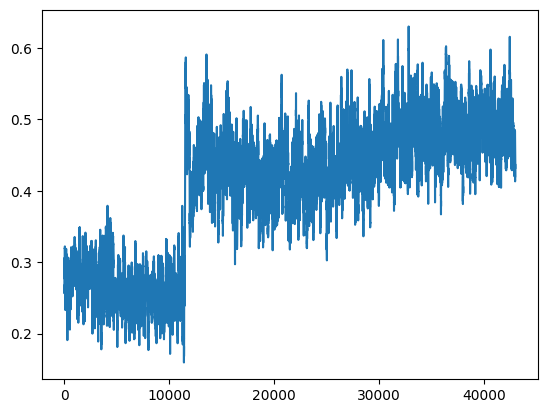

 -- 43310 -- winner: black, i: 60    wins: w = 3525.5, b = 3275, d = 10367
 -- 43320 -- winner: black, i: 44    wins: w = 3530.5, b = 3280, d = 10390
 -- 43330 -- winner: black, i: 70    wins: w = 3535.5, b = 3285, d = 10423
 -- 43340 -- winner: black, i: 76    wins: w = 3539.5, b = 3291, d = 10437
 -- 43350 -- winner: white, i: 47    wins: w = 3545.5, b = 3295, d = 10452


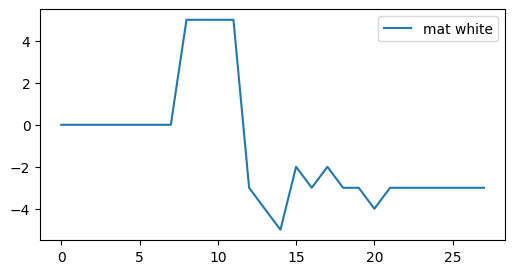

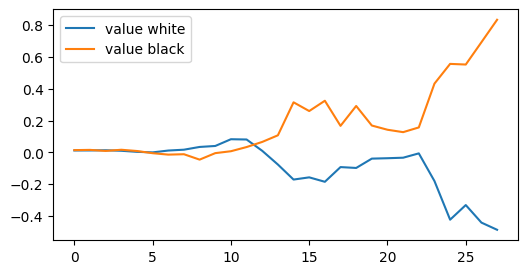

 -- 43360 -- winner: white, i: 81    wins: w = 3551.5, b = 3299, d = 10463
 -- 43370 -- winner: white, i: 37    wins: w = 3555.5, b = 3305, d = 10474
 -- 43380 -- winner: black, i: 54    wins: w = 3561.5, b = 3309, d = 10508
 -- 43390 -- winner: white, i: 39    wins: w = 3565.5, b = 3315, d = 10519
 -- 43400 -- winner: white, i: 85    wins: w = 3569.5, b = 3321, d = 10540


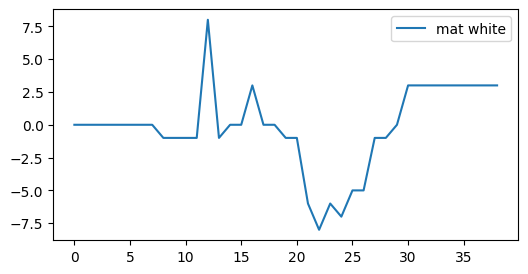

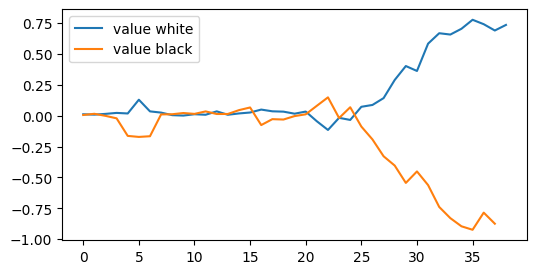

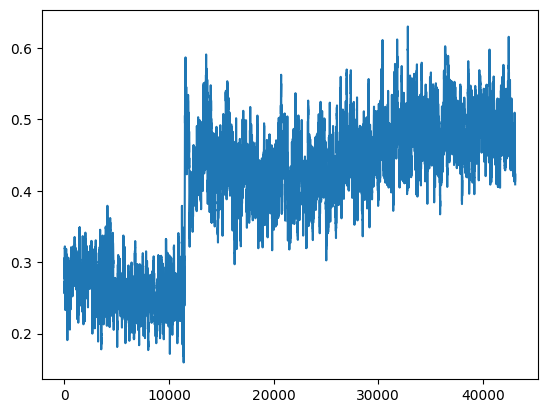

 -- 43410 -- winner: white, i: 53    wins: w = 3575.5, b = 3325, d = 10557
 -- 43420 -- winner: black, i: 64    wins: w = 3583.5, b = 3327, d = 10560
 -- 43430 -- winner: black, i: 72    wins: w = 3587.5, b = 3333, d = 10572
 -- 43440 -- winner: black, i: 6    wins: w = 3590.5, b = 3340, d = 10579
 -- 43450 -- winner: black, i: 50    wins: w = 3593.5, b = 3347, d = 10596


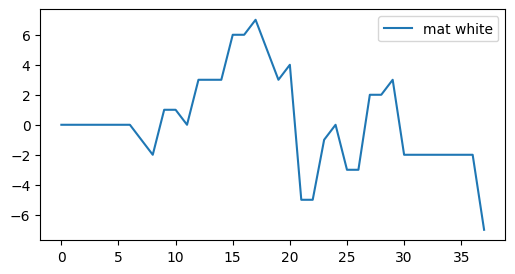

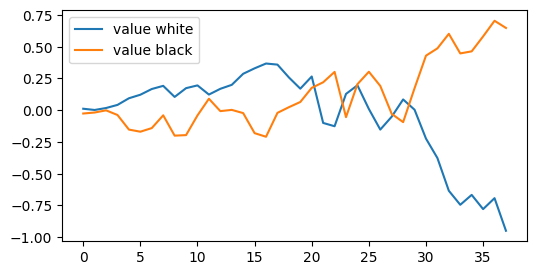

 -- 43460 -- winner: black, i: 88    wins: w = 3600.5, b = 3350, d = 10614
game termianted, mat diff =  2
 -- 43470 -- winner: black, i: 92    wins: w = 3605.5, b = 3355, d = 10652
 -- 43480 -- winner: white, i: 111    wins: w = 3611.5, b = 3359, d = 10669
game termianted, mat diff =  -22
 -- 43490 -- winner: black, i: 84    wins: w = 3614.5, b = 3365.5, d = 10682
 -- 43500 -- winner: white, i: 69    wins: w = 3623.5, b = 3366.5, d = 10691


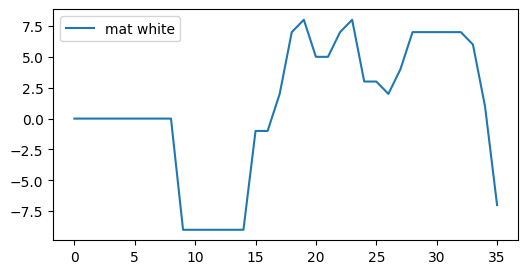

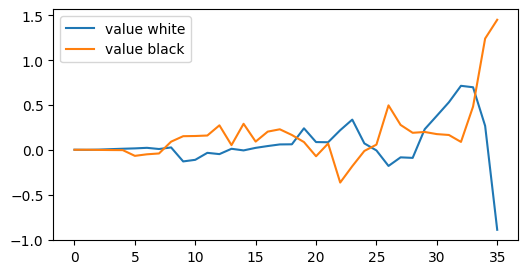

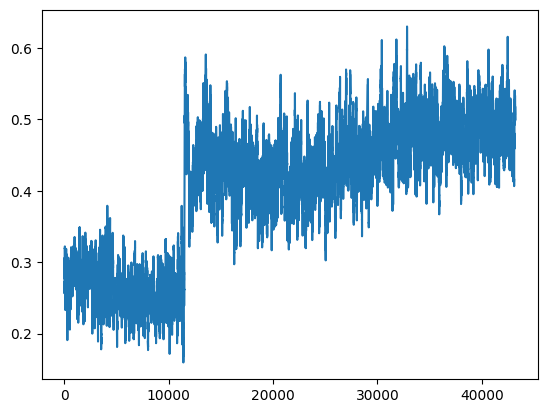

 -- 43510 -- winner: black, i: 84    wins: w = 3627.5, b = 3372.5, d = 10697
 -- 43520 -- winner: black, i: 48    wins: w = 3631.5, b = 3378.5, d = 10722
 -- 43530 -- winner: white, i: 9    wins: w = 3636.5, b = 3383.5, d = 10741
 -- 43540 -- winner: white, i: 111    wins: w = 3639.5, b = 3390.5, d = 10747
 -- 43550 -- winner: white, i: 103    wins: w = 3644.5, b = 3395.5, d = 10759


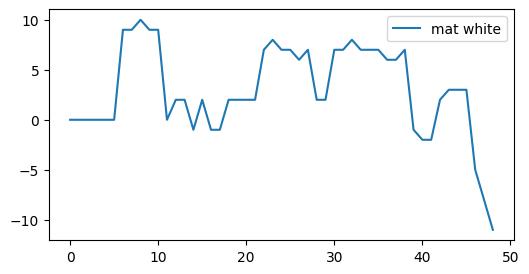

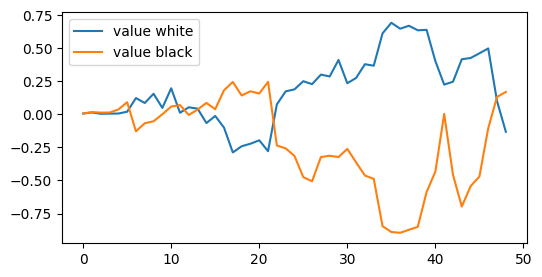

 -- 43560 -- winner: white, i: 17    wins: w = 3647.5, b = 3402.5, d = 10776
 -- 43570 -- winner: black, i: 100    wins: w = 3652.5, b = 3407.5, d = 10793
 -- 43580 -- winner: white, i: 29    wins: w = 3657.5, b = 3412.5, d = 10822
 -- 43590 -- winner: black, i: 82    wins: w = 3661.5, b = 3418.5, d = 10852
 -- 43600 -- winner: black, i: 60    wins: w = 3667.5, b = 3422.5, d = 10869


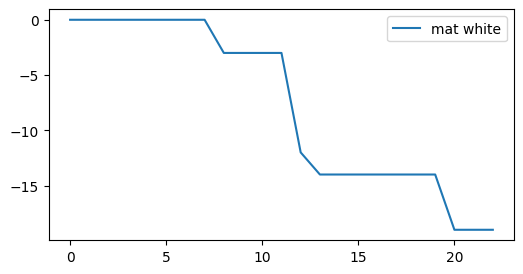

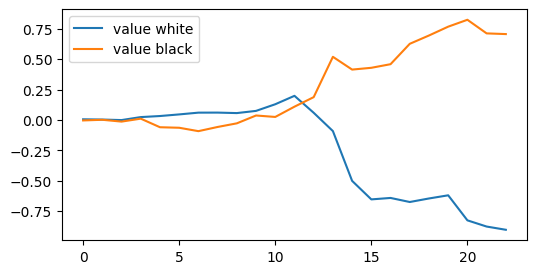

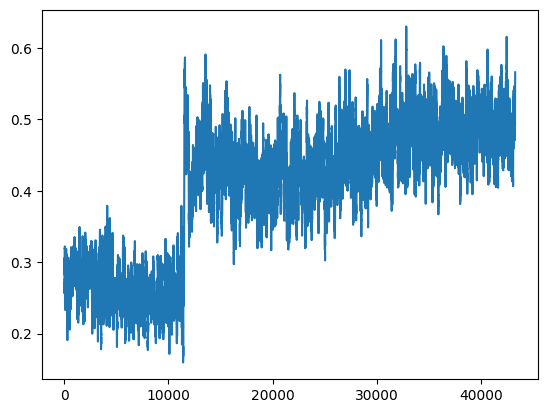

 -- 43610 -- winner: black, i: 34    wins: w = 3671.5, b = 3428.5, d = 10879
 -- 43620 -- winner: white, i: 119    wins: w = 3679.5, b = 3430.5, d = 10898
 -- 43630 -- winner: white, i: 77    wins: w = 3687.5, b = 3432.5, d = 10906
 -- 43640 -- winner: black, i: 8    wins: w = 3691.5, b = 3438.5, d = 10922
 -- 43650 -- winner: white, i: 59    wins: w = 3697.5, b = 3442.5, d = 10932


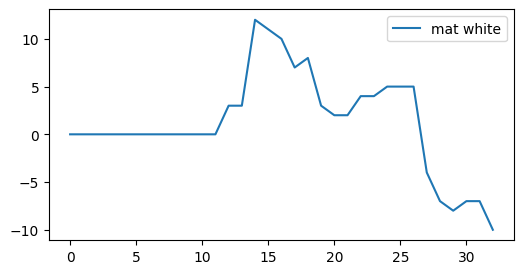

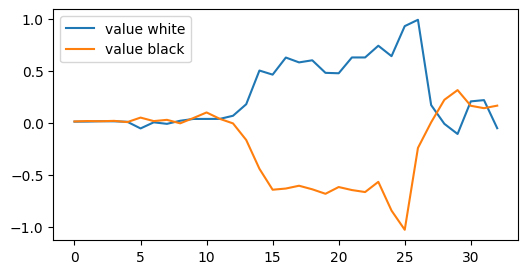

 -- 43660 -- winner: white, i: 5    wins: w = 3705.5, b = 3444.5, d = 10955
 -- 43670 -- winner: black, i: 96    wins: w = 3710.5, b = 3449.5, d = 10975
 -- 43680 -- winner: white, i: 85    wins: w = 3719.5, b = 3450.5, d = 10993
 -- 43690 -- winner: white, i: 53    wins: w = 3725.5, b = 3454.5, d = 11002
 -- 43700 -- winner: black, i: 62    wins: w = 3730.5, b = 3459.5, d = 11039


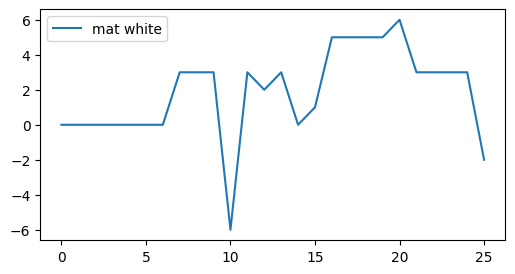

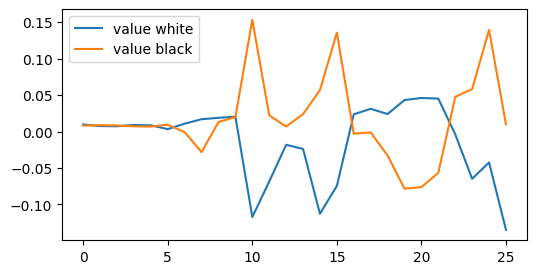

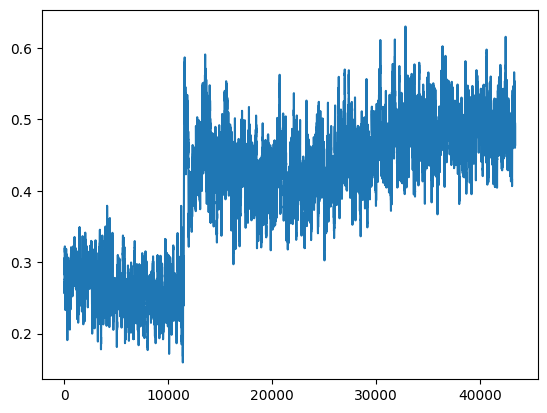

 -- 43710 -- winner: white, i: 93    wins: w = 3734.5, b = 3465.5, d = 11057
 -- 43720 -- winner: black, i: 24    wins: w = 3739.5, b = 3470.5, d = 11068
 -- 43730 -- winner: black, i: 56    wins: w = 3743.5, b = 3476.5, d = 11078
 -- 43740 -- winner: white, i: 99    wins: w = 3749.5, b = 3480.5, d = 11092
 -- 43750 -- winner: black, i: 106    wins: w = 3752.5, b = 3487.5, d = 11104


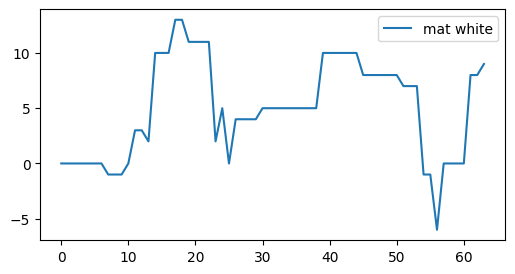

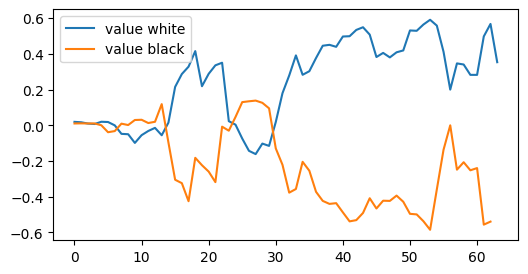

 -- 43760 -- winner: black, i: 102    wins: w = 3758.5, b = 3491.5, d = 11123
 -- 43770 -- winner: white, i: 101    wins: w = 3763.5, b = 3496.5, d = 11134
 -- 43780 -- winner: black, i: 76    wins: w = 3767.5, b = 3502.5, d = 11151
 -- 43790 -- winner: white, i: 113    wins: w = 3771.5, b = 3508.5, d = 11164
 -- 43800 -- winner: white, i: 71    wins: w = 3776.5, b = 3513.5, d = 11180


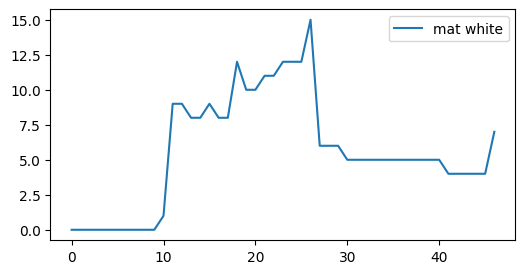

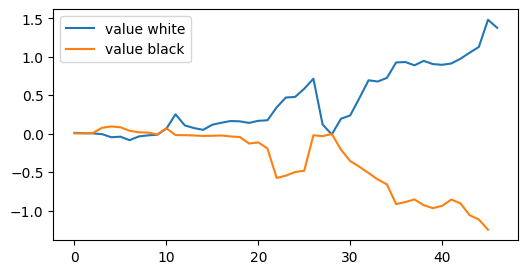

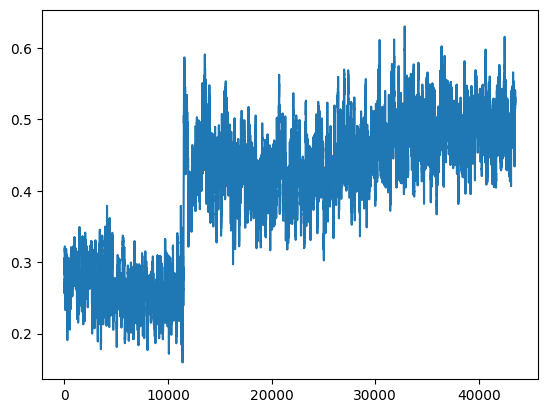

 -- 43810 -- winner: black, i: 94    wins: w = 3784.5, b = 3515.5, d = 11203
 -- 43820 -- winner: white, i: 35    wins: w = 3788.5, b = 3521.5, d = 11215
 -- 43830 -- winner: white, i: 61    wins: w = 3793.5, b = 3526.5, d = 11230
 -- 43840 -- winner: black, i: 110    wins: w = 3798.5, b = 3531.5, d = 11236
 -- 43850 -- winner: white, i: 95    wins: w = 3805.5, b = 3534.5, d = 11251


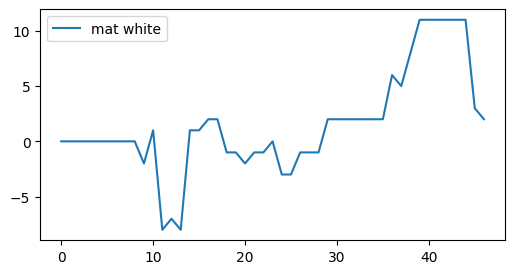

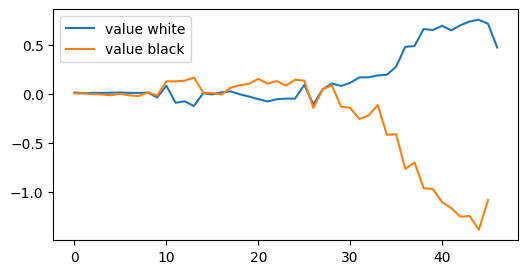

 -- 43860 -- winner: black, i: 102    wins: w = 3812.5, b = 3537.5, d = 11263
 -- 43870 -- winner: black, i: 28    wins: w = 3817.5, b = 3542.5, d = 11292
 -- 43880 -- winner: white, i: 113    wins: w = 3825.5, b = 3544.5, d = 11316
 -- 43890 -- winner: white, i: 59    wins: w = 3830.5, b = 3549.5, d = 11334
 -- 43900 -- winner: white, i: 51    wins: w = 3836.5, b = 3553.5, d = 11355


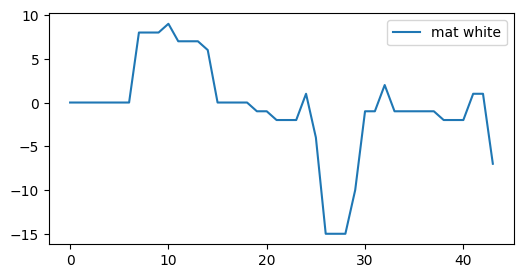

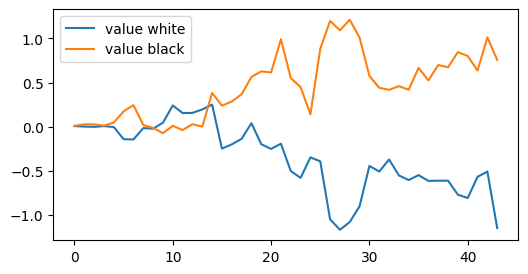

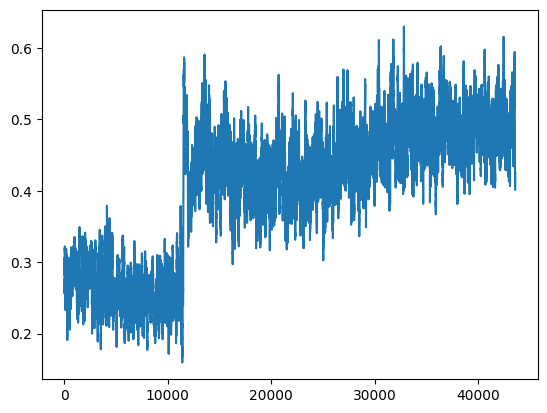

 -- 43910 -- winner: black, i: 84    wins: w = 3841.5, b = 3558.5, d = 11385
 -- 43920 -- winner: white, i: 65    wins: w = 3845.5, b = 3564.5, d = 11398
 -- 43930 -- winner: black, i: 90    wins: w = 3849.5, b = 3570.5, d = 11406
 -- 43940 -- winner: black, i: 78    wins: w = 3855.5, b = 3574.5, d = 11425
 -- 43950 -- winner: black, i: 56    wins: w = 3858.5, b = 3581.5, d = 11439


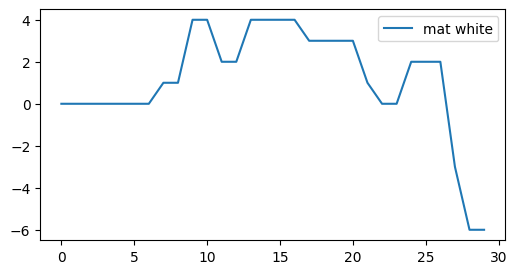

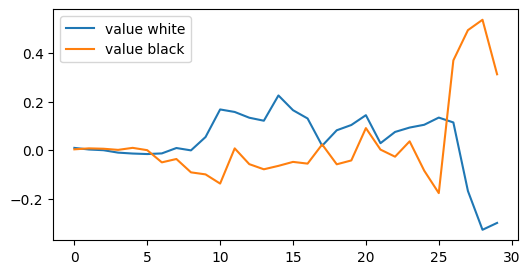

 -- 43960 -- winner: white, i: 61    wins: w = 3864.5, b = 3585.5, d = 11449
 -- 43970 -- winner: white, i: 45    wins: w = 3871.5, b = 3588.5, d = 11478
 -- 43980 -- winner: white, i: 133    wins: w = 3878.5, b = 3591.5, d = 11480
 -- 43990 -- winner: black, i: 56    wins: w = 3882.5, b = 3597.5, d = 11498
 -- 44000 -- winner: black, i: 8    wins: w = 3888.5, b = 3601.5, d = 11510


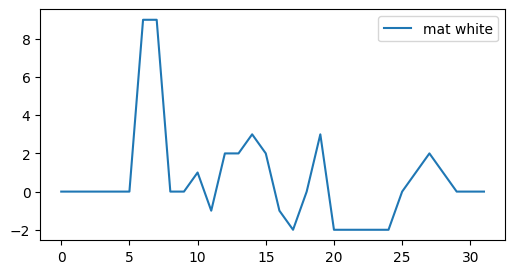

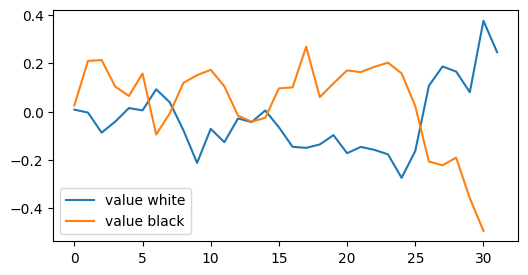

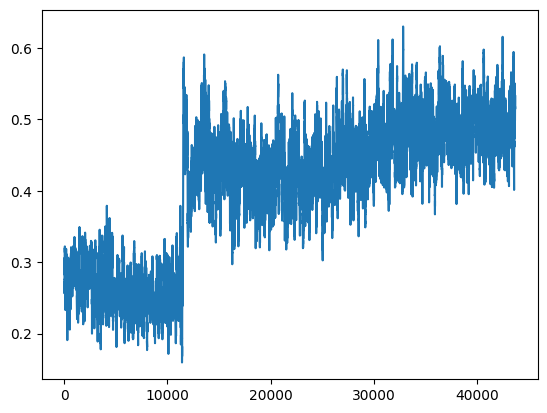

 -- 44010 -- winner: black, i: 70    wins: w = 3891.5, b = 3608.5, d = 11536
 -- 44020 -- winner: white, i: 85    wins: w = 3894.5, b = 3615.5, d = 11559
 -- 44030 -- winner: white, i: 75    wins: w = 3900.5, b = 3619.5, d = 11584
 -- 44040 -- winner: black, i: 82    wins: w = 3905.5, b = 3624.5, d = 11602
game termianted, mat diff =  -16
 -- 44050 -- winner: white, i: 93    wins: w = 3911.5, b = 3628.0, d = 11614


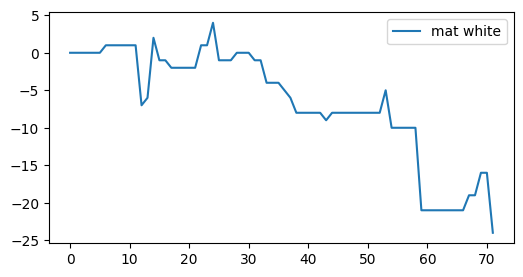

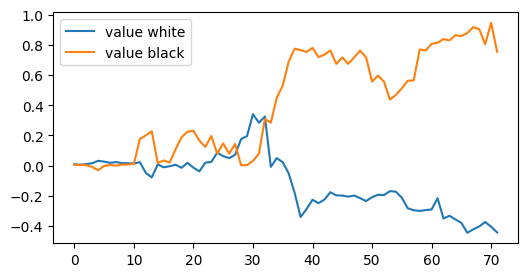

 -- 44060 -- winner: white, i: 27    wins: w = 3916.5, b = 3633.0, d = 11626
 -- 44070 -- winner: black, i: 114    wins: w = 3919.5, b = 3640.0, d = 11648
 -- 44080 -- winner: white, i: 63    wins: w = 3922.5, b = 3647.0, d = 11673
 -- 44090 -- winner: white, i: 35    wins: w = 3927.5, b = 3652.0, d = 11699
 -- 44100 -- winner: white, i: 117    wins: w = 3934.5, b = 3655.0, d = 11708


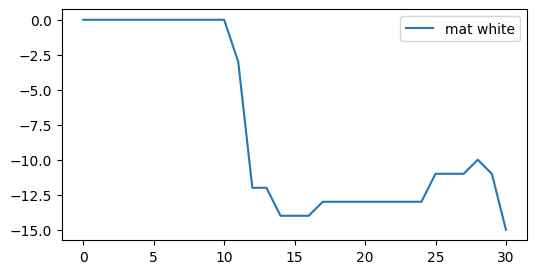

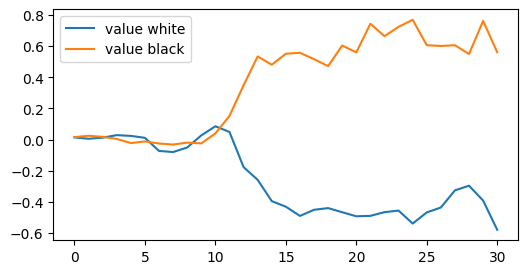

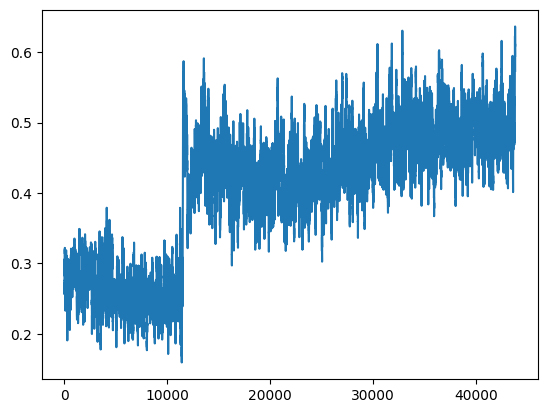

 -- 44110 -- winner: black, i: 36    wins: w = 3937.5, b = 3662.0, d = 11720
 -- 44120 -- winner: black, i: 62    wins: w = 3943.5, b = 3666.0, d = 11747
 -- 44130 -- winner: white, i: 51    wins: w = 3950.5, b = 3669.0, d = 11762
 -- 44140 -- winner: black, i: 116    wins: w = 3957.5, b = 3672.0, d = 11777
 -- 44150 -- winner: black, i: 78    wins: w = 3963.5, b = 3676.0, d = 11794


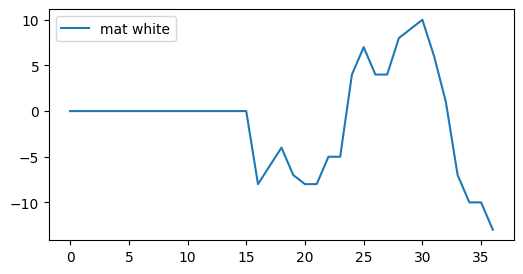

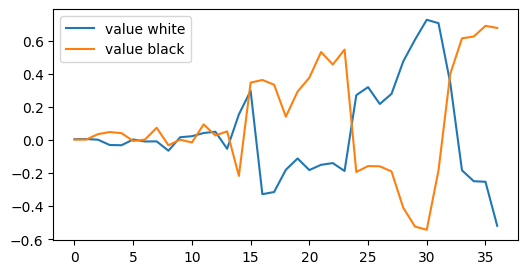

 -- 44160 -- winner: white, i: 125    wins: w = 3967.5, b = 3682.0, d = 11809
 -- 44170 -- winner: white, i: 53    wins: w = 3973.5, b = 3686.0, d = 11831
 -- 44180 -- winner: white, i: 117    wins: w = 3979.5, b = 3690.0, d = 11850
 -- 44190 -- winner: black, i: 14    wins: w = 3983.5, b = 3696.0, d = 11864
 -- 44200 -- winner: black, i: 36    wins: w = 3987.5, b = 3702.0, d = 11871


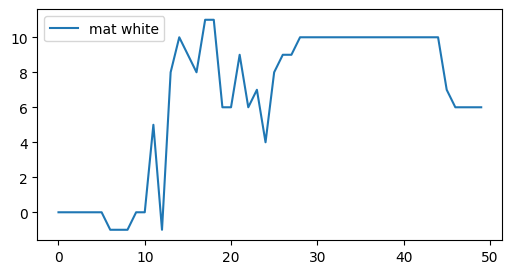

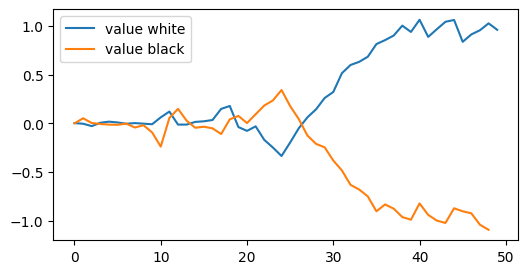

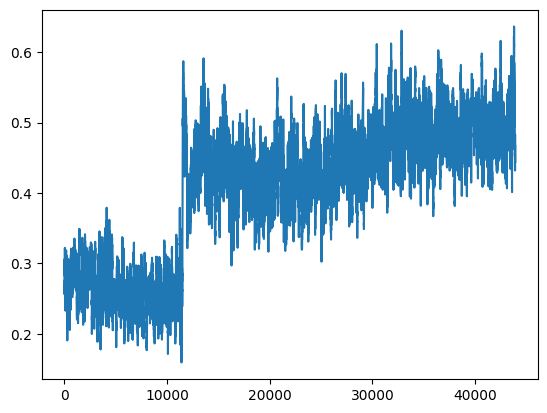

 -- 44210 -- winner: white, i: 45    wins: w = 3991.5, b = 3708.0, d = 11891
 -- 44220 -- winner: white, i: 111    wins: w = 3994.5, b = 3715.0, d = 11928
 -- 44230 -- winner: black, i: 168    wins: w = 3999.5, b = 3720.0, d = 11940
 -- 44240 -- winner: white, i: 27    wins: w = 4005.5, b = 3724.0, d = 11957
 -- 44250 -- winner: black, i: 82    wins: w = 4009.5, b = 3730.0, d = 11979


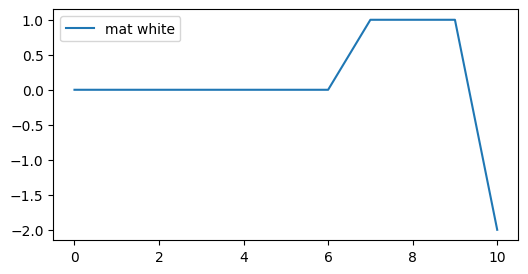

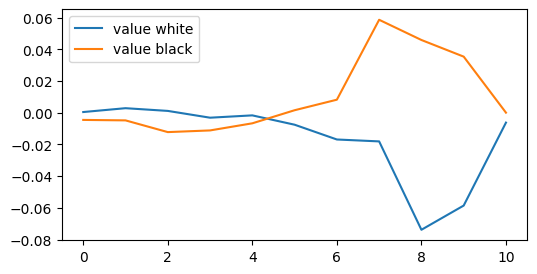

 -- 44260 -- winner: black, i: 68    wins: w = 4014.5, b = 3735.0, d = 11994
 -- 44270 -- winner: white, i: 107    wins: w = 4017.5, b = 3742.0, d = 12006
 -- 44280 -- winner: white, i: 27    wins: w = 4022.5, b = 3747.0, d = 12041
 -- 44290 -- winner: black, i: 6    wins: w = 4028.5, b = 3751.0, d = 12047
 -- 44300 -- winner: white, i: 87    wins: w = 4033.5, b = 3756.0, d = 12069


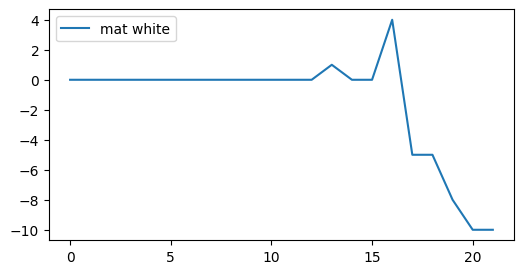

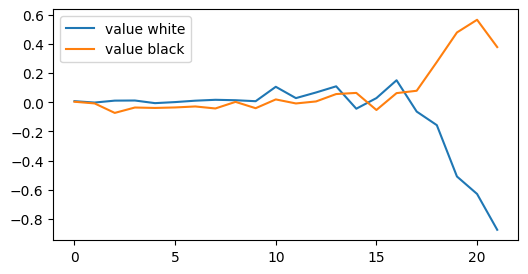

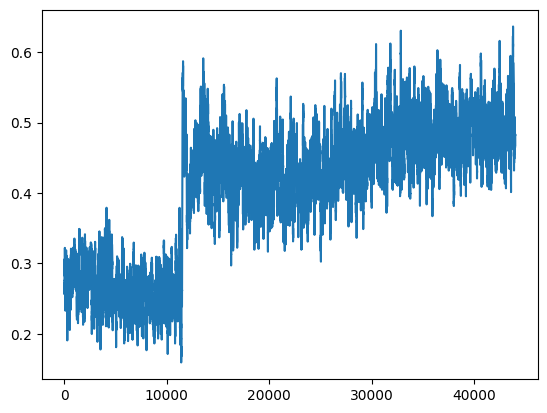

 -- 44310 -- winner: white, i: 55    wins: w = 4039.5, b = 3760.0, d = 12080
 -- 44320 -- winner: white, i: 121    wins: w = 4044.5, b = 3765.0, d = 12096
 -- 44330 -- winner: black, i: 84    wins: w = 4049.5, b = 3770.0, d = 12126
 -- 44340 -- winner: black, i: 24    wins: w = 4054.5, b = 3775.0, d = 12138
 -- 44350 -- winner: black, i: 56    wins: w = 4058.5, b = 3781.0, d = 12158


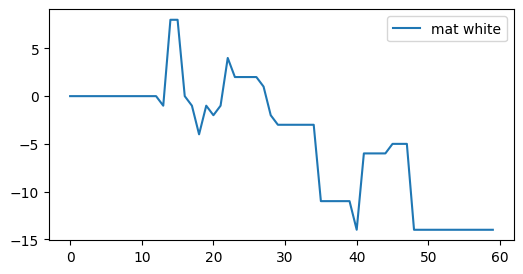

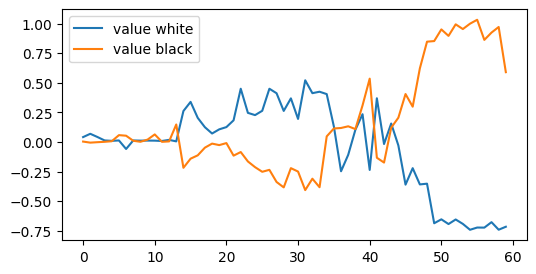

 -- 44360 -- winner: black, i: 102    wins: w = 4061.5, b = 3788.0, d = 12185
 -- 44370 -- winner: black, i: 58    wins: w = 4064.5, b = 3795.0, d = 12215
 -- 44380 -- winner: black, i: 82    wins: w = 4065.5, b = 3804.0, d = 12233
 -- 44390 -- winner: black, i: 100    wins: w = 4070.5, b = 3809.0, d = 12257
 -- 44400 -- winner: white, i: 27    wins: w = 4075.5, b = 3814.0, d = 12271


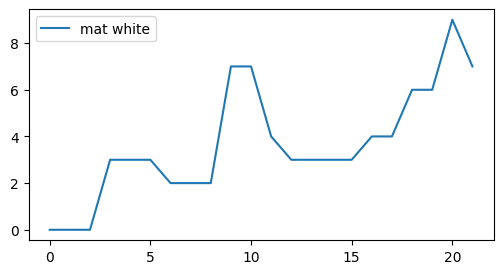

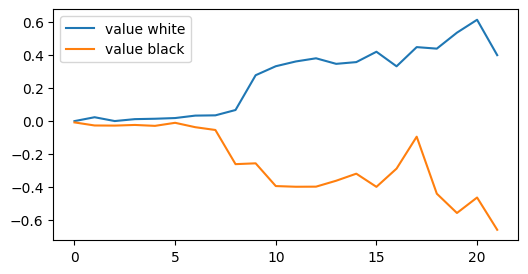

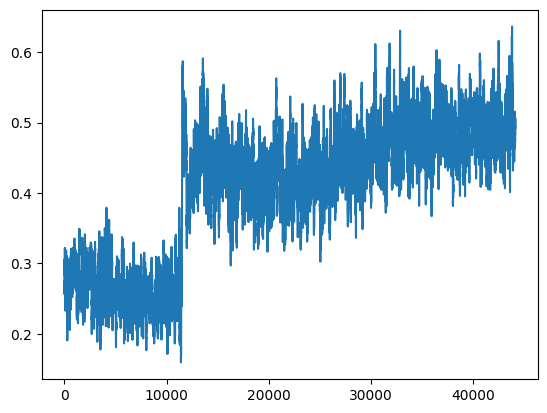

 -- 44410 -- winner: white, i: 113    wins: w = 4082.5, b = 3817.0, d = 12290
 -- 44420 -- winner: black, i: 122    wins: w = 4087.5, b = 3822.0, d = 12307
 -- 44430 -- winner: black, i: 10    wins: w = 4092.5, b = 3827.0, d = 12323
 -- 44440 -- winner: white, i: 27    wins: w = 4098.5, b = 3831.0, d = 12331
 -- 44450 -- winner: black, i: 80    wins: w = 4102.5, b = 3837.0, d = 12338


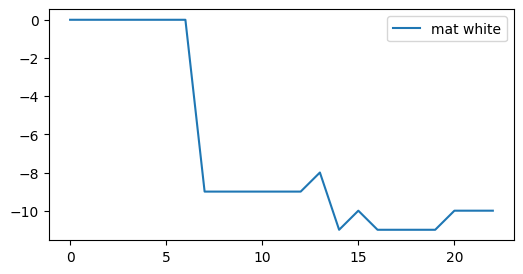

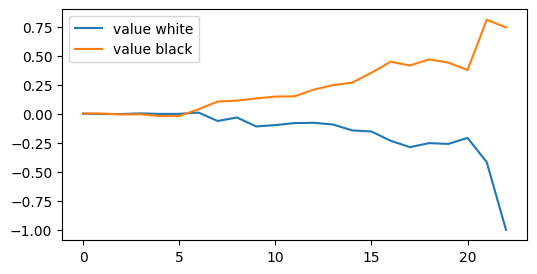

 -- 44460 -- winner: white, i: 53    wins: w = 4108.5, b = 3841.0, d = 12362
 -- 44470 -- winner: white, i: 83    wins: w = 4113.5, b = 3846.0, d = 12382
 -- 44480 -- winner: black, i: 66    wins: w = 4118.5, b = 3851.0, d = 12388
 -- 44490 -- winner: black, i: 62    wins: w = 4124.5, b = 3855.0, d = 12399
 -- 44500 -- winner: white, i: 55    wins: w = 4129.5, b = 3860.0, d = 12408


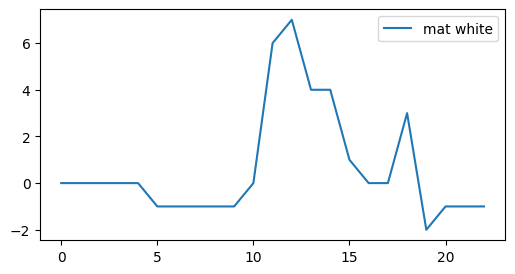

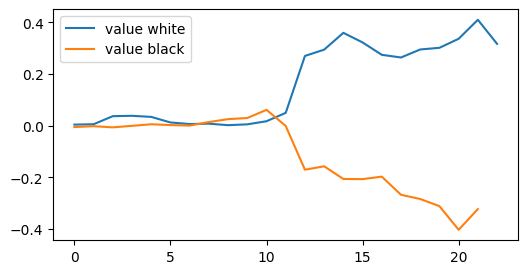

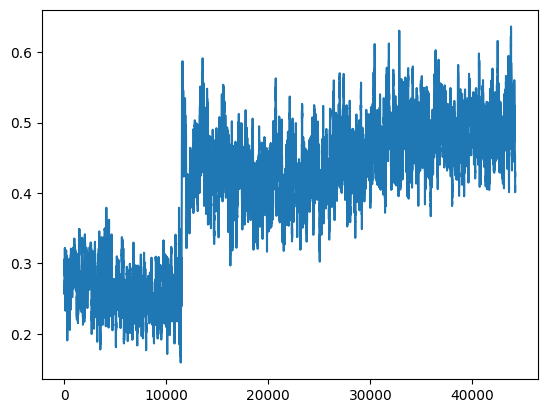

 -- 44510 -- winner: white, i: 99    wins: w = 4134.5, b = 3865.0, d = 12444
 -- 44520 -- winner: black, i: 196    wins: w = 4138.5, b = 3871.0, d = 12460
 -- 44530 -- winner: black, i: 100    wins: w = 4142.5, b = 3877.0, d = 12476
 -- 44540 -- winner: black, i: 88    wins: w = 4143.5, b = 3886.0, d = 12486
 -- 44550 -- winner: white, i: 53    wins: w = 4149.5, b = 3890.0, d = 12505


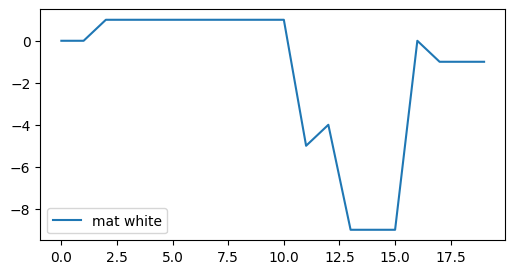

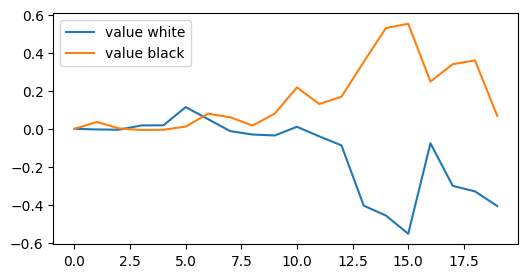

 -- 44560 -- winner: black, i: 44    wins: w = 4152.5, b = 3897.0, d = 12522
 -- 44570 -- winner: white, i: 69    wins: w = 4158.5, b = 3901.0, d = 12548
 -- 44580 -- winner: white, i: 69    wins: w = 4164.5, b = 3905.0, d = 12562
 -- 44590 -- winner: white, i: 83    wins: w = 4170.5, b = 3909.0, d = 12580
 -- 44600 -- winner: black, i: 86    wins: w = 4174.5, b = 3915.0, d = 12597


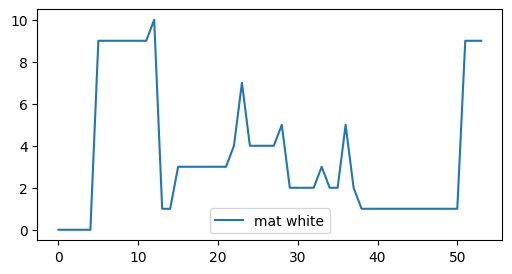

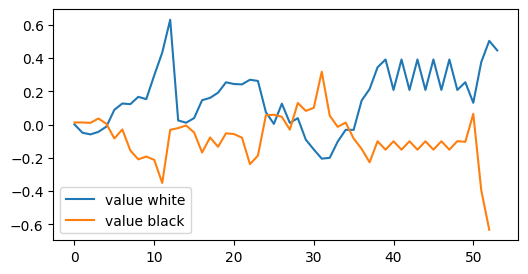

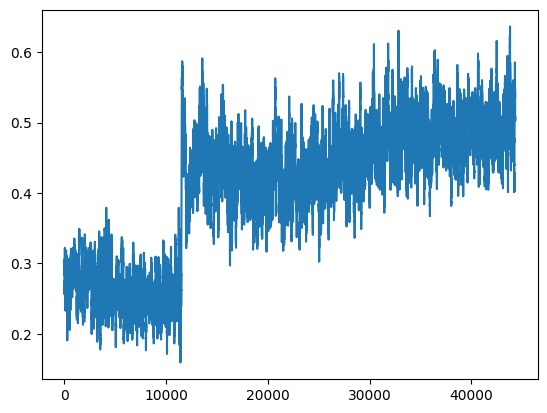

 -- 44610 -- winner: white, i: 51    wins: w = 4181.5, b = 3918.0, d = 12621
 -- 44620 -- winner: white, i: 73    wins: w = 4186.5, b = 3923.0, d = 12646
 -- 44630 -- winner: black, i: 12    wins: w = 4188.5, b = 3931.0, d = 12656
 -- 44640 -- winner: white, i: 53    wins: w = 4194.5, b = 3935.0, d = 12669
 -- 44650 -- winner: black, i: 88    wins: w = 4197.5, b = 3942.0, d = 12679


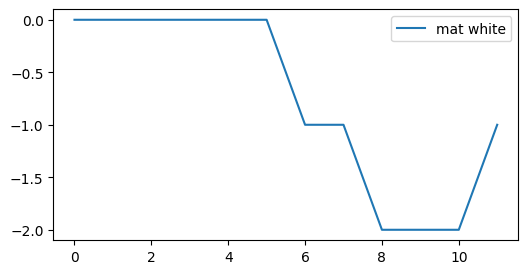

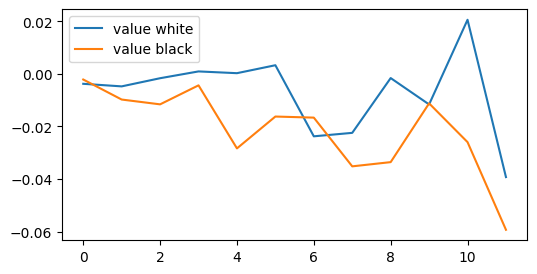

 -- 44660 -- winner: black, i: 42    wins: w = 4198.5, b = 3951.0, d = 12700
 -- 44670 -- winner: black, i: 100    wins: w = 4205.5, b = 3954.0, d = 12726
 -- 44680 -- winner: white, i: 5    wins: w = 4212.5, b = 3957.0, d = 12740
 -- 44690 -- winner: white, i: 237    wins: w = 4215.5, b = 3964.0, d = 12770
 -- 44700 -- winner: white, i: 27    wins: w = 4222.5, b = 3967.0, d = 12789


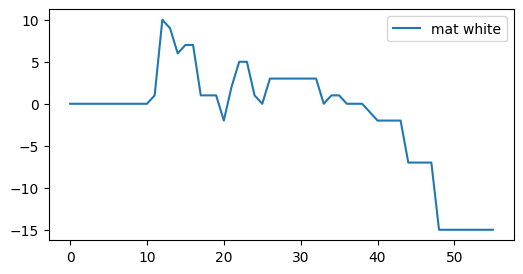

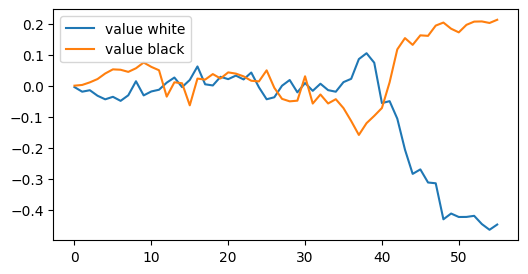

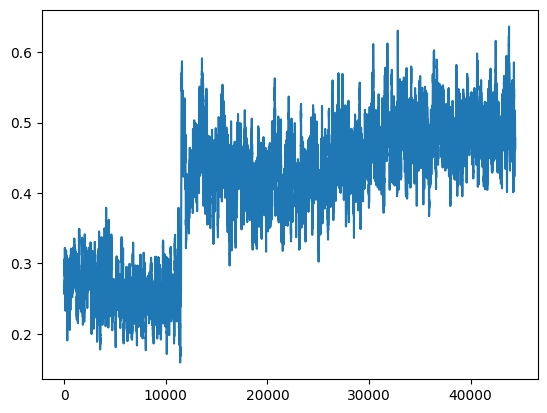

 -- 44710 -- winner: white, i: 39    wins: w = 4230.5, b = 3969.0, d = 12797
 -- 44720 -- winner: black, i: 72    wins: w = 4233.5, b = 3976.0, d = 12812
 -- 44730 -- winner: white, i: 17    wins: w = 4238.5, b = 3981.0, d = 12828
 -- 44740 -- winner: black, i: 44    wins: w = 4242.5, b = 3987.0, d = 12840
 -- 44750 -- winner: white, i: 43    wins: w = 4249.5, b = 3990.0, d = 12852


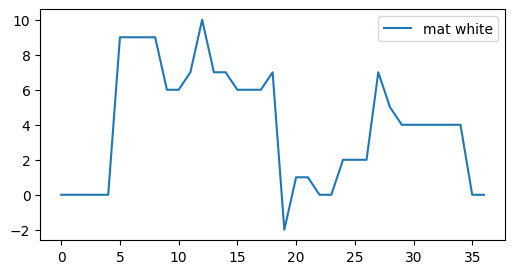

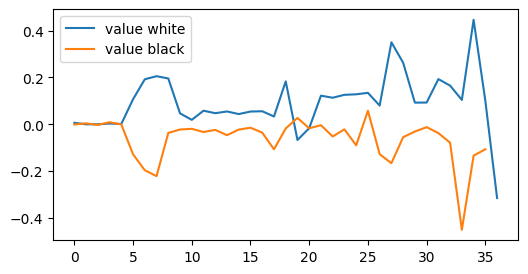

 -- 44760 -- winner: white, i: 43    wins: w = 4256.5, b = 3993.0, d = 12866
 -- 44770 -- winner: white, i: 31    wins: w = 4261.5, b = 3998.0, d = 12896
 -- 44780 -- winner: black, i: 42    wins: w = 4265.5, b = 4004.0, d = 12908
 -- 44790 -- winner: black, i: 106    wins: w = 4270.5, b = 4009.0, d = 12923
 -- 44800 -- winner: white, i: 87    wins: w = 4274.5, b = 4015.0, d = 12944


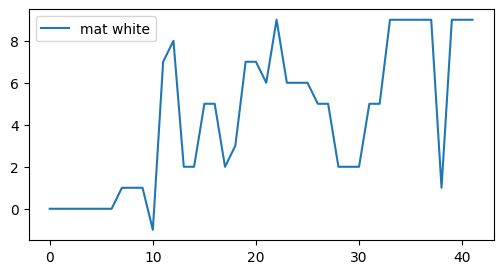

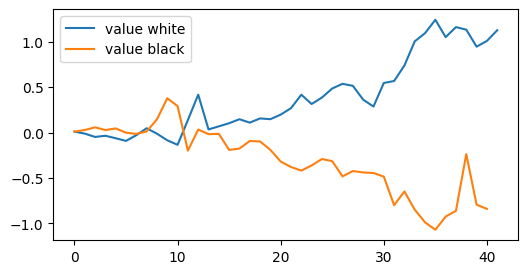

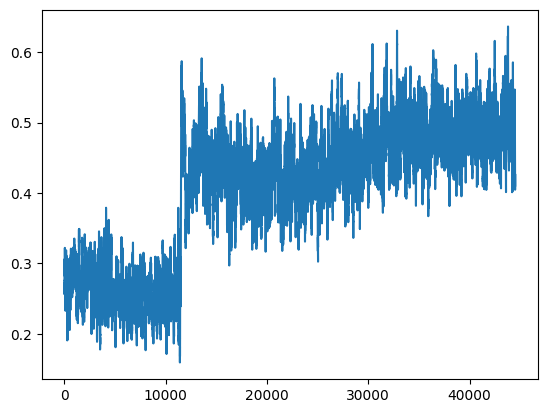

 -- 44810 -- winner: white, i: 105    wins: w = 4280.5, b = 4019.0, d = 12949
 -- 44820 -- winner: black, i: 110    wins: w = 4286.5, b = 4023.0, d = 12965
 -- 44830 -- winner: black, i: 50    wins: w = 4293.5, b = 4026.0, d = 12979
 -- 44840 -- winner: white, i: 93    wins: w = 4299.5, b = 4030.0, d = 12986
 -- 44850 -- winner: white, i: 95    wins: w = 4302.5, b = 4037.0, d = 13003


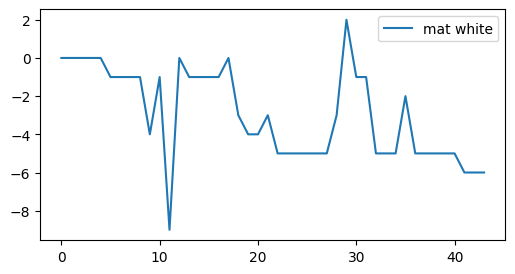

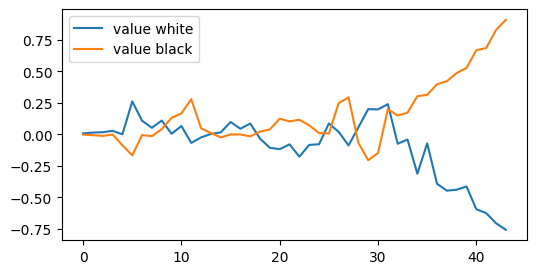

 -- 44860 -- winner: white, i: 39    wins: w = 4307.5, b = 4042.0, d = 13027
 -- 44870 -- winner: white, i: 103    wins: w = 4313.5, b = 4046.0, d = 13043
 -- 44880 -- winner: black, i: 114    wins: w = 4319.5, b = 4050.0, d = 13052
 -- 44890 -- winner: white, i: 77    wins: w = 4327.5, b = 4052.0, d = 13076
 -- 44900 -- winner: white, i: 55    wins: w = 4332.5, b = 4057.0, d = 13095


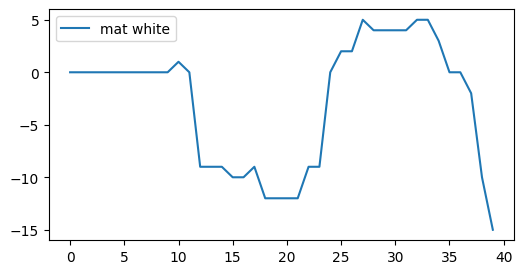

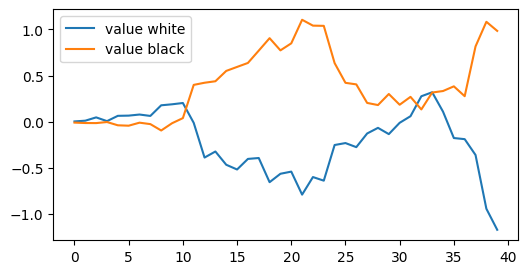

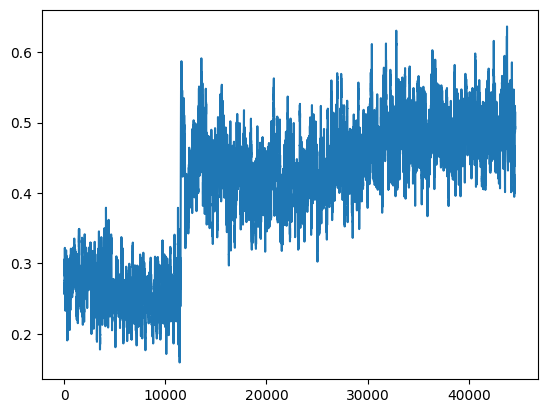

 -- 44910 -- winner: white, i: 19    wins: w = 4337.5, b = 4062.0, d = 13108
 -- 44920 -- winner: white, i: 35    wins: w = 4342.5, b = 4067.0, d = 13136
 -- 44930 -- winner: black, i: 62    wins: w = 4345.5, b = 4074.0, d = 13156
 -- 44940 -- winner: black, i: 88    wins: w = 4349.5, b = 4080.0, d = 13188
 -- 44950 -- winner: white, i: 63    wins: w = 4357.5, b = 4082.0, d = 13219


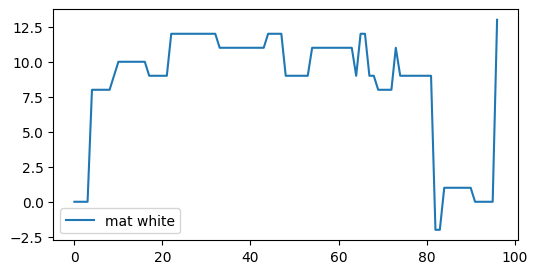

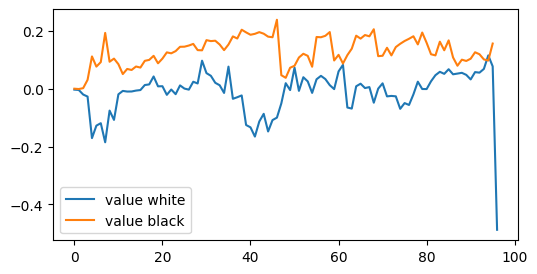

 -- 44960 -- winner: white, i: 31    wins: w = 4363.5, b = 4086.0, d = 13229
 -- 44970 -- winner: black, i: 32    wins: w = 4366.5, b = 4093.0, d = 13241
 -- 44980 -- winner: white, i: 9    wins: w = 4372.5, b = 4097.0, d = 13253
 -- 44990 -- winner: white, i: 11    wins: w = 4376.5, b = 4103.0, d = 13271
 -- 45000 -- winner: black, i: 164    wins: w = 4380.5, b = 4109.0, d = 13282


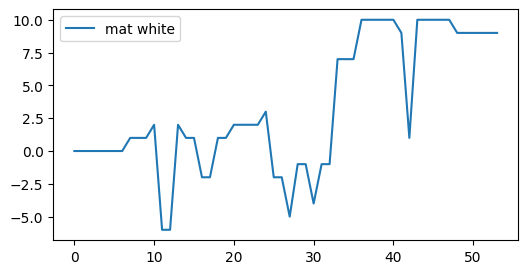

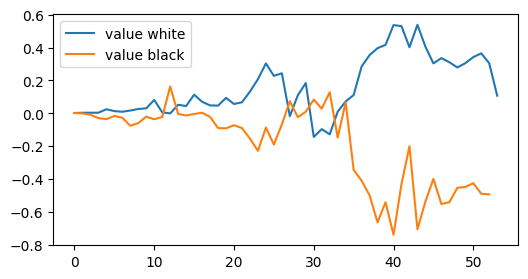

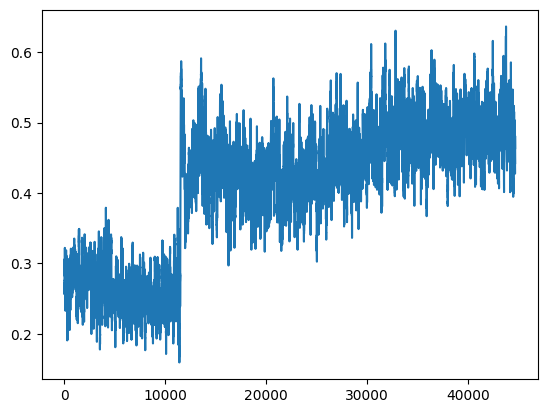

 -- 45010 -- winner: white, i: 95    wins: w = 4387.5, b = 4112.0, d = 13301
 -- 45020 -- winner: black, i: 58    wins: w = 4389.5, b = 4120.0, d = 13318
 -- 45030 -- winner: black, i: 30    wins: w = 4395.5, b = 4124.0, d = 13329
 -- 45040 -- winner: white, i: 89    wins: w = 4401.5, b = 4128.0, d = 13341
 -- 45050 -- winner: black, i: 60    wins: w = 4405.5, b = 4134.0, d = 13355


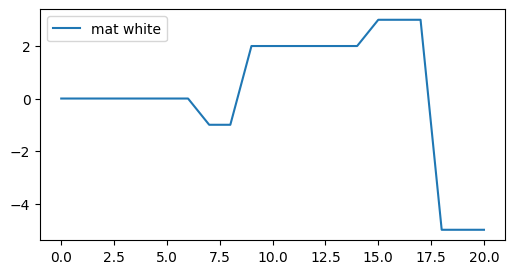

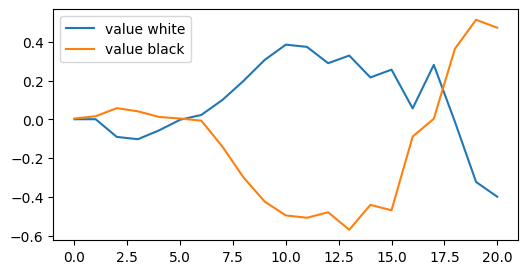

 -- 45060 -- winner: white, i: 25    wins: w = 4409.5, b = 4140.0, d = 13372
 -- 45070 -- winner: black, i: 96    wins: w = 4415.5, b = 4144.0, d = 13383
 -- 45080 -- winner: black, i: 40    wins: w = 4419.5, b = 4150.0, d = 13396
 -- 45090 -- winner: white, i: 31    wins: w = 4424.5, b = 4155.0, d = 13410
 -- 45100 -- winner: white, i: 115    wins: w = 4431.5, b = 4158.0, d = 13430


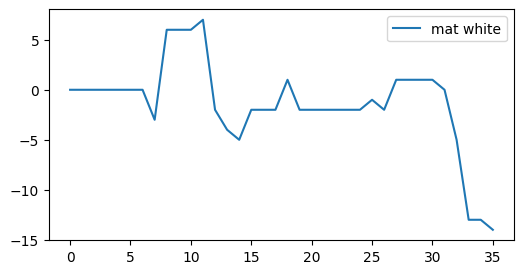

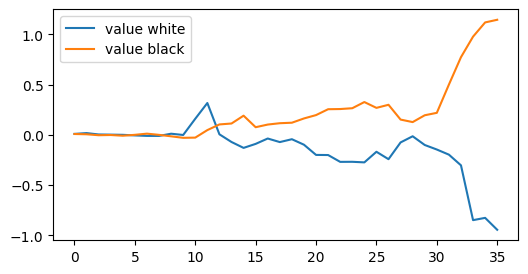

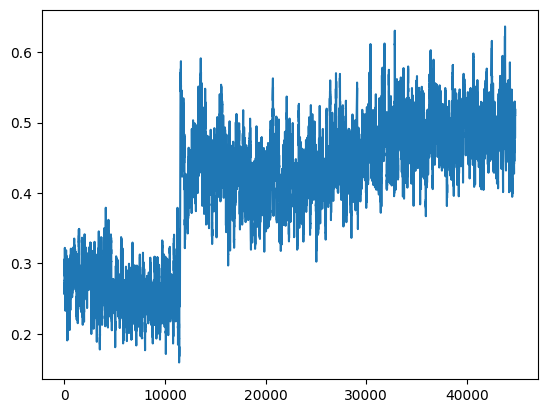

 -- 45110 -- winner: white, i: 9    wins: w = 4437.5, b = 4162.0, d = 13449
 -- 45120 -- winner: black, i: 76    wins: w = 4442.5, b = 4167.0, d = 13458
 -- 45130 -- winner: black, i: 10    wins: w = 4449.5, b = 4170.0, d = 13480
 -- 45140 -- winner: white, i: 43    wins: w = 4456.5, b = 4173.0, d = 13490
 -- 45150 -- winner: white, i: 91    wins: w = 4462.5, b = 4177.0, d = 13505


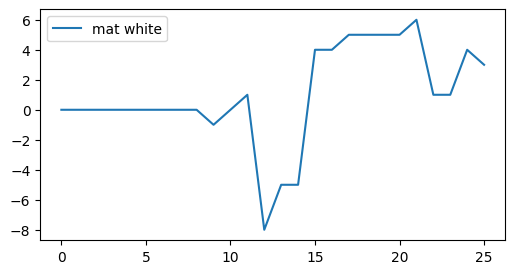

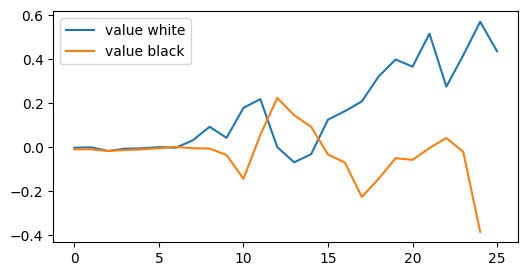

 -- 45160 -- winner: black, i: 94    wins: w = 4467.5, b = 4182.0, d = 13518
 -- 45170 -- winner: black, i: 56    wins: w = 4471.5, b = 4188.0, d = 13534
 -- 45180 -- winner: white, i: 111    wins: w = 4476.5, b = 4193.0, d = 13547
 -- 45190 -- winner: black, i: 84    wins: w = 4482.5, b = 4197.0, d = 13555
 -- 45200 -- winner: black, i: 120    wins: w = 4488.5, b = 4201.0, d = 13574


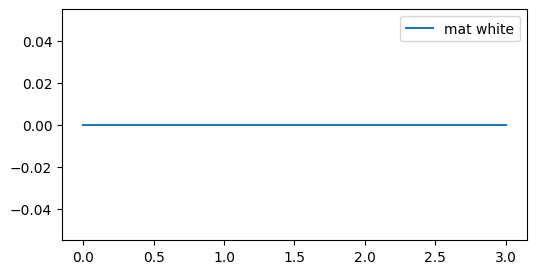

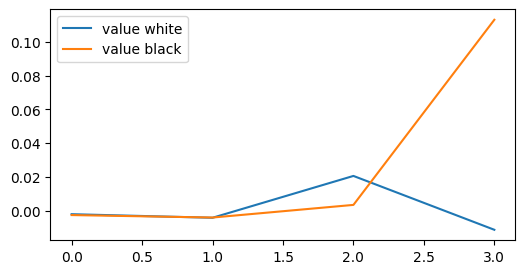

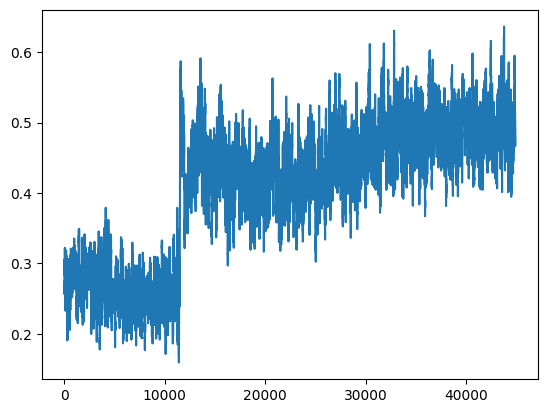

 -- 45210 -- winner: black, i: 110    wins: w = 4492.5, b = 4207.0, d = 13590
 -- 45220 -- winner: white, i: 55    wins: w = 4496.5, b = 4213.0, d = 13603
 -- 45230 -- winner: white, i: 41    wins: w = 4505.5, b = 4214.0, d = 13636
 -- 45240 -- winner: black, i: 94    wins: w = 4511.5, b = 4218.0, d = 13652
 -- 45250 -- winner: black, i: 76    wins: w = 4516.5, b = 4223.0, d = 13669


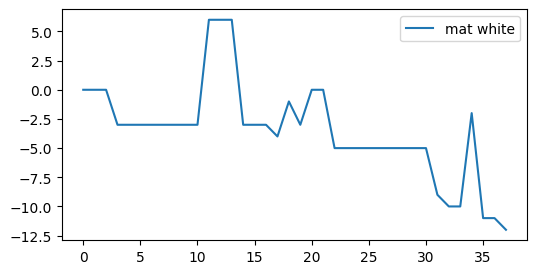

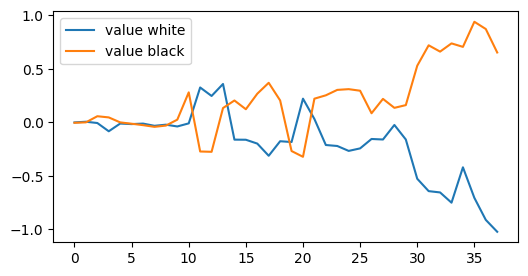

 -- 45260 -- winner: black, i: 82    wins: w = 4521.5, b = 4228.0, d = 13691
 -- 45270 -- winner: white, i: 93    wins: w = 4526.5, b = 4233.0, d = 13694
 -- 45280 -- winner: white, i: 141    wins: w = 4531.5, b = 4238.0, d = 13713
 -- 45290 -- winner: white, i: 73    wins: w = 4537.5, b = 4242.0, d = 13723
 -- 45300 -- winner: white, i: 87    wins: w = 4542.5, b = 4247.0, d = 13745


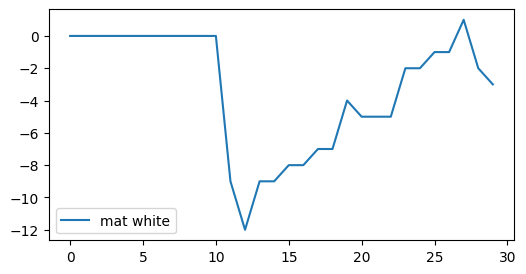

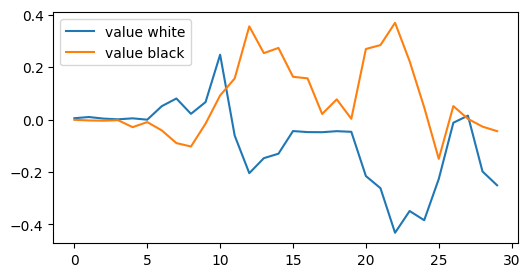

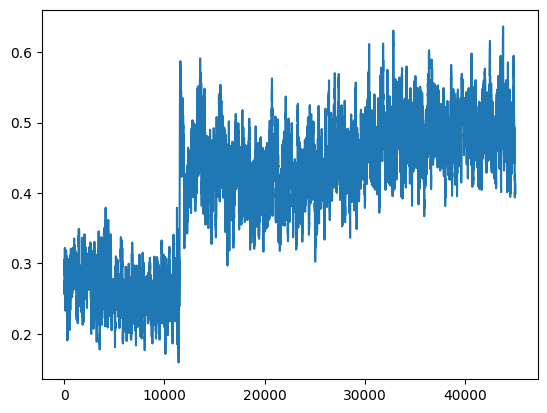

 -- 45310 -- winner: white, i: 123    wins: w = 4545.5, b = 4254.0, d = 13759
 -- 45320 -- winner: white, i: 71    wins: w = 4550.5, b = 4259.0, d = 13778
 -- 45330 -- winner: black, i: 18    wins: w = 4553.5, b = 4266.0, d = 13795
 -- 45340 -- winner: white, i: 31    wins: w = 4558.5, b = 4271.0, d = 13800
 -- 45350 -- winner: white, i: 13    wins: w = 4563.5, b = 4276.0, d = 13816


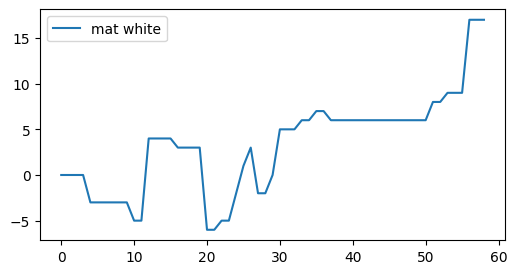

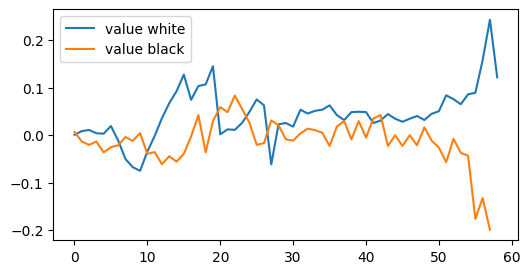

 -- 45360 -- winner: black, i: 64    wins: w = 4568.5, b = 4281.0, d = 13834
 -- 45370 -- winner: white, i: 79    wins: w = 4575.5, b = 4284.0, d = 13851
 -- 45380 -- winner: white, i: 11    wins: w = 4580.5, b = 4289.0, d = 13876
 -- 45390 -- winner: white, i: 31    wins: w = 4587.5, b = 4292.0, d = 13891
 -- 45400 -- winner: white, i: 63    wins: w = 4593.5, b = 4296.0, d = 13912


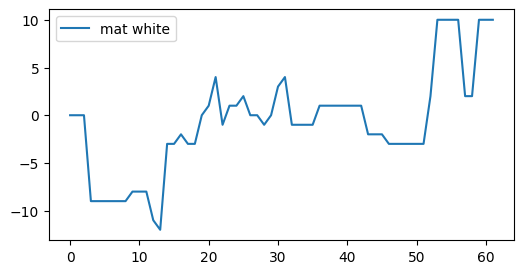

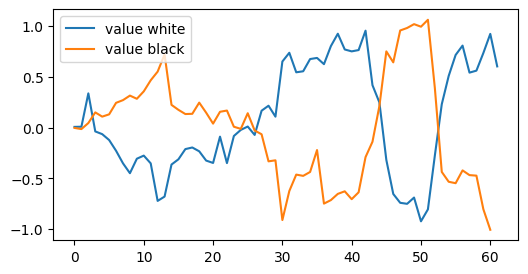

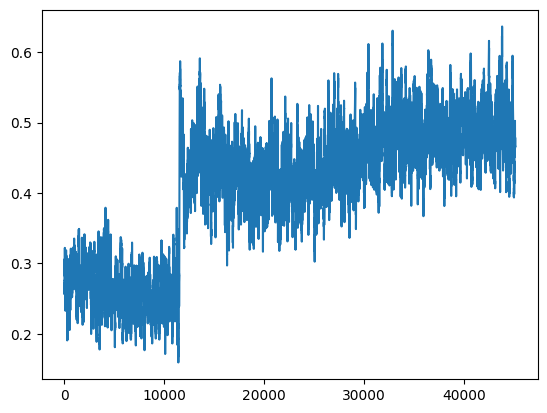

 -- 45410 -- winner: black, i: 98    wins: w = 4596.5, b = 4303.0, d = 13928
 -- 45420 -- winner: black, i: 36    wins: w = 4600.5, b = 4309.0, d = 13941
 -- 45430 -- winner: black, i: 44    wins: w = 4603.5, b = 4316.0, d = 13961
 -- 45440 -- winner: white, i: 7    wins: w = 4609.5, b = 4320.0, d = 13980
 -- 45450 -- winner: white, i: 61    wins: w = 4615.5, b = 4324.0, d = 13992


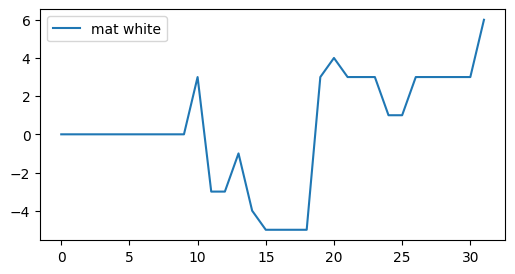

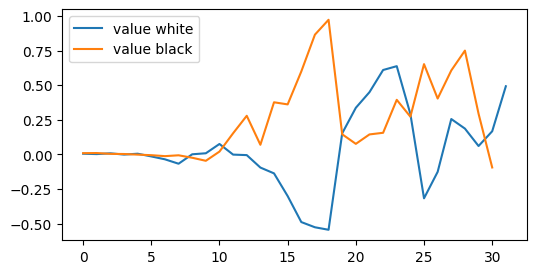

 -- 45460 -- winner: black, i: 102    wins: w = 4621.5, b = 4328.0, d = 13997
 -- 45470 -- winner: white, i: 81    wins: w = 4626.5, b = 4333.0, d = 14011
 -- 45480 -- winner: white, i: 59    wins: w = 4632.5, b = 4337.0, d = 14030
 -- 45490 -- winner: black, i: 74    wins: w = 4637.5, b = 4342.0, d = 14045
 -- 45500 -- winner: black, i: 24    wins: w = 4640.5, b = 4349.0, d = 14055


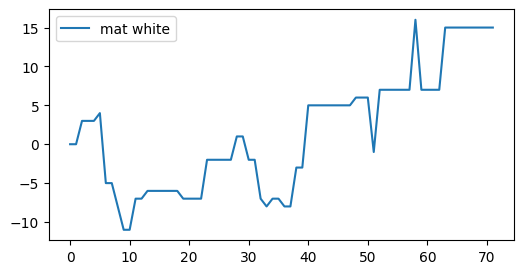

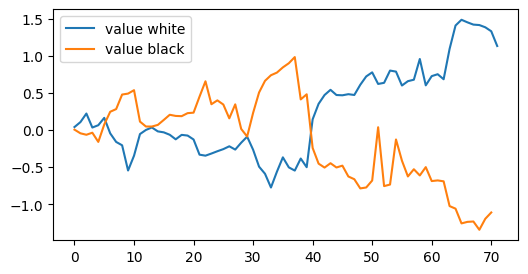

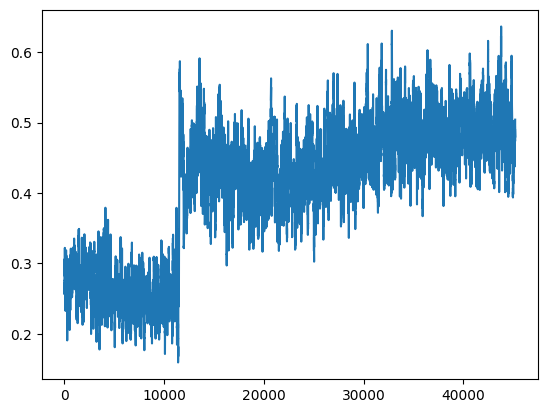

 -- 45510 -- winner: black, i: 36    wins: w = 4645.5, b = 4354.0, d = 14078
 -- 45520 -- winner: white, i: 19    wins: w = 4650.5, b = 4359.0, d = 14091
 -- 45530 -- winner: black, i: 70    wins: w = 4655.5, b = 4364.0, d = 14102
 -- 45540 -- winner: black, i: 122    wins: w = 4662.5, b = 4367.0, d = 14113
 -- 45550 -- winner: black, i: 10    wins: w = 4666.5, b = 4373.0, d = 14129


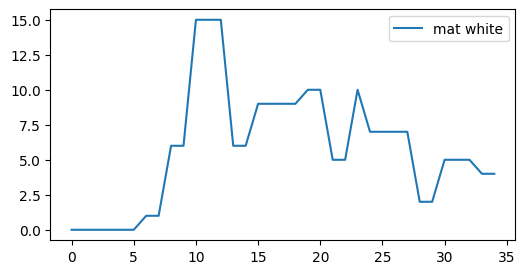

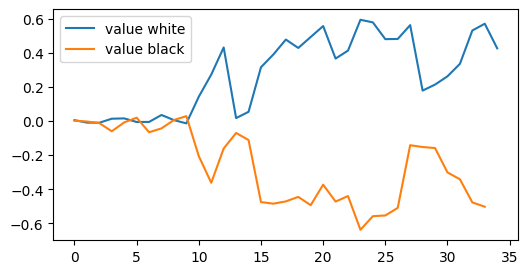

 -- 45560 -- winner: white, i: 73    wins: w = 4673.5, b = 4376.0, d = 14140
 -- 45570 -- winner: white, i: 47    wins: w = 4679.5, b = 4380.0, d = 14152
 -- 45580 -- winner: white, i: 79    wins: w = 4686.5, b = 4383.0, d = 14173
 -- 45590 -- winner: black, i: 34    wins: w = 4687.5, b = 4392.0, d = 14188
 -- 45600 -- winner: white, i: 43    wins: w = 4692.5, b = 4397.0, d = 14197


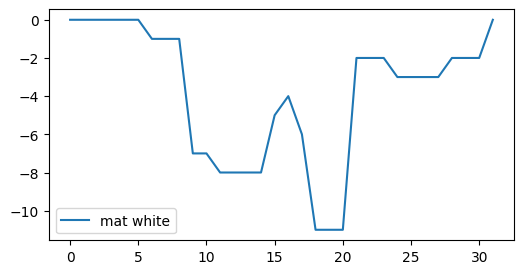

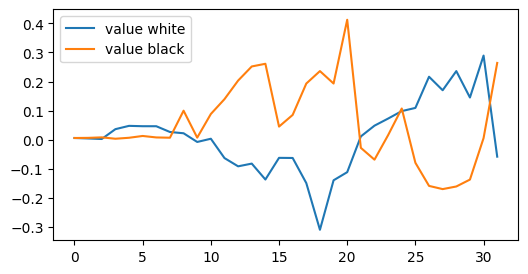

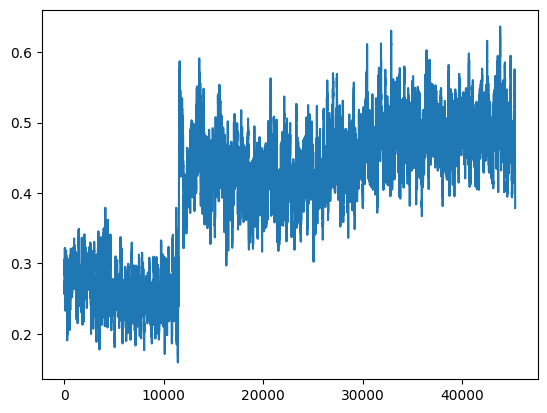

 -- 45610 -- winner: white, i: 103    wins: w = 4697.5, b = 4402.0, d = 14216
 -- 45620 -- winner: black, i: 94    wins: w = 4700.5, b = 4409.0, d = 14237
 -- 45630 -- winner: white, i: 99    wins: w = 4707.5, b = 4412.0, d = 14253
 -- 45640 -- winner: black, i: 82    wins: w = 4710.5, b = 4419.0, d = 14264
 -- 45650 -- winner: black, i: 20    wins: w = 4715.5, b = 4424.0, d = 14277


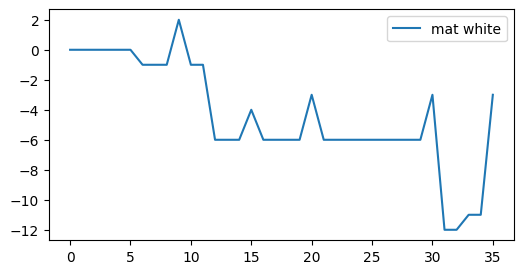

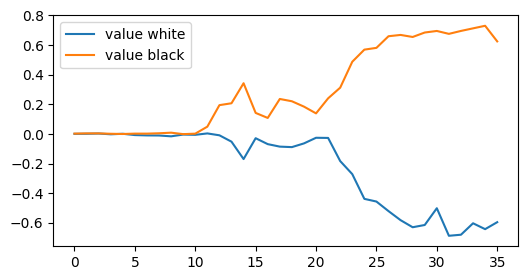

 -- 45660 -- winner: black, i: 42    wins: w = 4720.5, b = 4429.0, d = 14288
 -- 45670 -- winner: black, i: 88    wins: w = 4725.5, b = 4434.0, d = 14316
 -- 45680 -- winner: black, i: 56    wins: w = 4731.5, b = 4438.0, d = 14337
 -- 45690 -- winner: white, i: 97    wins: w = 4734.5, b = 4445.0, d = 14358
 -- 45700 -- winner: black, i: 30    wins: w = 4738.5, b = 4451.0, d = 14383


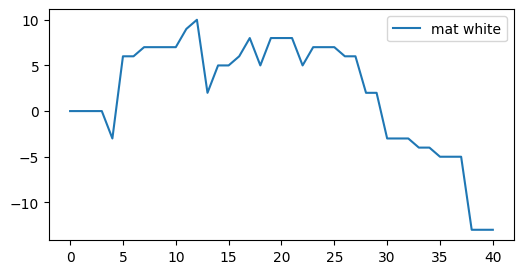

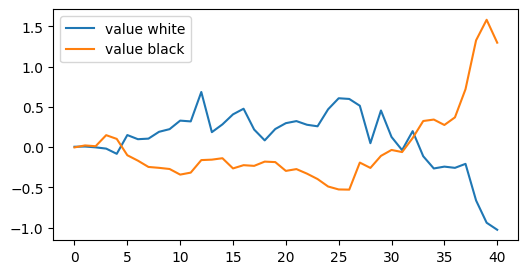

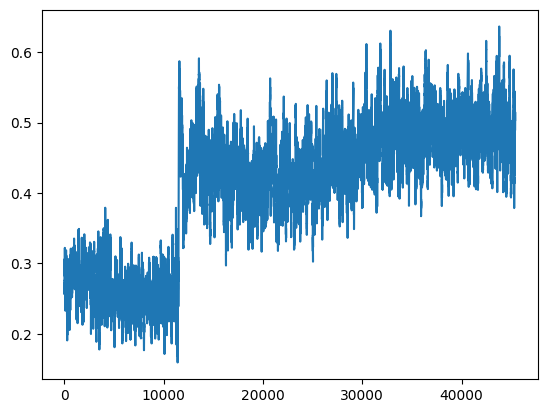

 -- 45710 -- winner: black, i: 46    wins: w = 4743.5, b = 4456.0, d = 14391
 -- 45720 -- winner: white, i: 79    wins: w = 4750.5, b = 4459.0, d = 14409
 -- 45730 -- winner: white, i: 47    wins: w = 4756.5, b = 4463.0, d = 14421
 -- 45740 -- winner: white, i: 13    wins: w = 4759.5, b = 4470.0, d = 14436
 -- 45750 -- winner: black, i: 92    wins: w = 4760.5, b = 4479.0, d = 14452


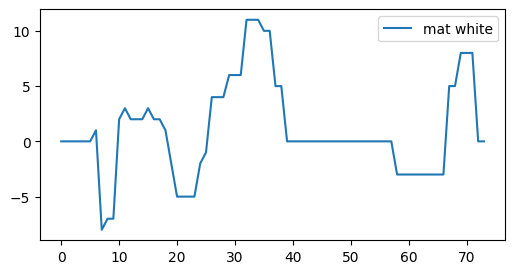

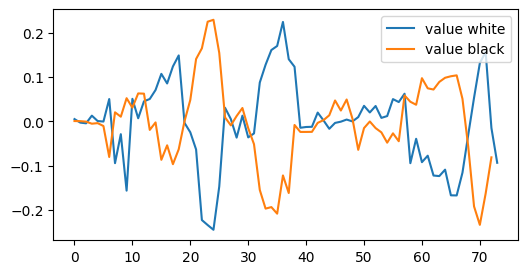

 -- 45760 -- winner: white, i: 45    wins: w = 4769.5, b = 4480.0, d = 14467
 -- 45770 -- winner: black, i: 158    wins: w = 4771.5, b = 4488.0, d = 14483
 -- 45780 -- winner: black, i: 66    wins: w = 4775.5, b = 4494.0, d = 14503
 -- 45790 -- winner: black, i: 68    wins: w = 4780.5, b = 4499.0, d = 14518
 -- 45800 -- winner: black, i: 98    wins: w = 4785.5, b = 4504.0, d = 14542


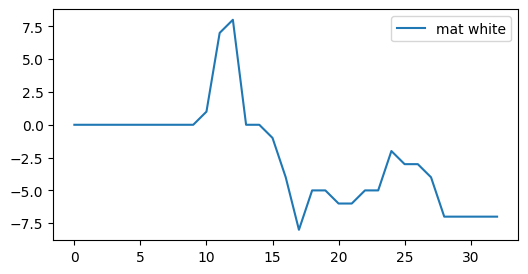

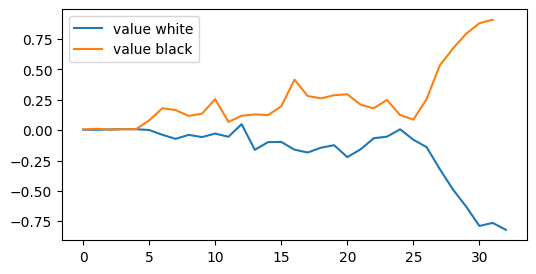

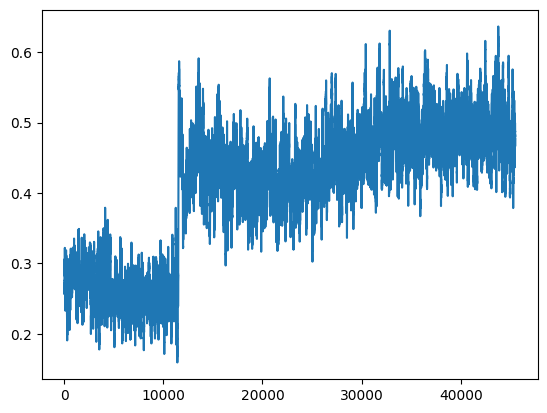

 -- 45810 -- winner: black, i: 22    wins: w = 4789.5, b = 4510.0, d = 14553
 -- 45820 -- winner: black, i: 92    wins: w = 4792.5, b = 4517.0, d = 14568
 -- 45830 -- winner: black, i: 88    wins: w = 4797.5, b = 4522.0, d = 14594
 -- 45840 -- winner: white, i: 39    wins: w = 4804.5, b = 4525.0, d = 14621
 -- 45850 -- winner: white, i: 49    wins: w = 4811.5, b = 4528.0, d = 14645


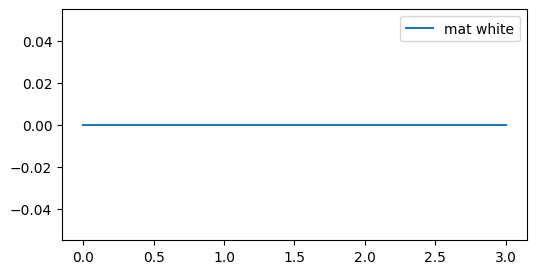

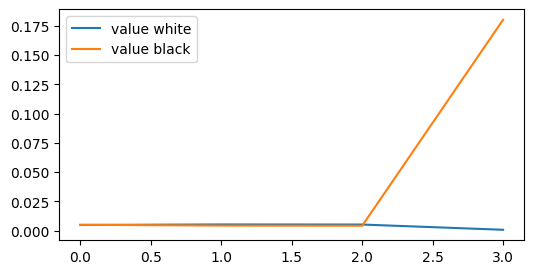

 -- 45860 -- winner: black, i: 14    wins: w = 4813.5, b = 4536.0, d = 14659
 -- 45870 -- winner: black, i: 30    wins: w = 4816.5, b = 4543.0, d = 14670
 -- 45880 -- winner: white, i: 21    wins: w = 4823.5, b = 4546.0, d = 14680
 -- 45890 -- winner: white, i: 63    wins: w = 4829.5, b = 4550.0, d = 14693
 -- 45900 -- winner: white, i: 87    wins: w = 4834.5, b = 4555.0, d = 14705


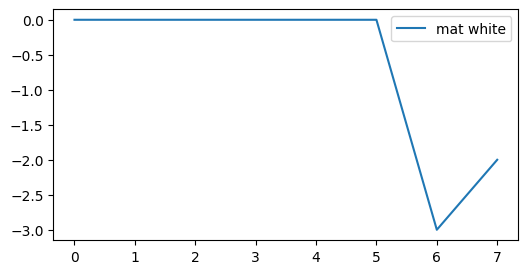

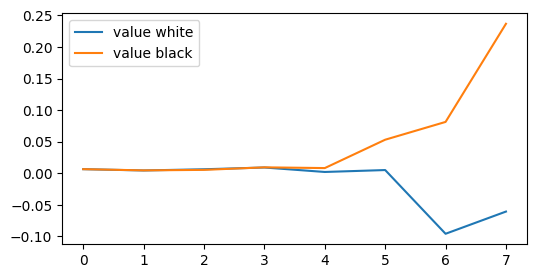

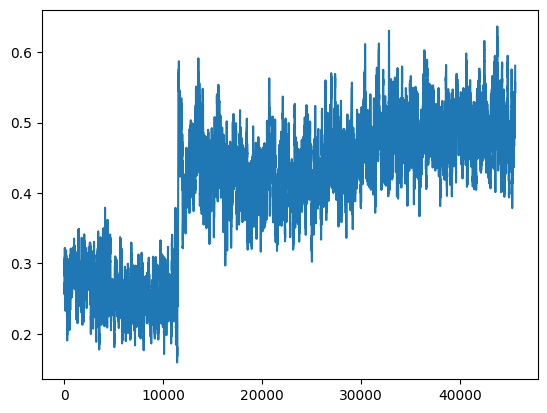

 -- 45910 -- winner: black, i: 8    wins: w = 4841.5, b = 4558.0, d = 14721
 -- 45920 -- winner: white, i: 89    wins: w = 4847.5, b = 4562.0, d = 14736
 -- 45930 -- winner: black, i: 100    wins: w = 4852.5, b = 4567.0, d = 14750
 -- 45940 -- winner: black, i: 58    wins: w = 4858.5, b = 4571.0, d = 14764
 -- 45950 -- winner: white, i: 77    wins: w = 4864.5, b = 4575.0, d = 14774


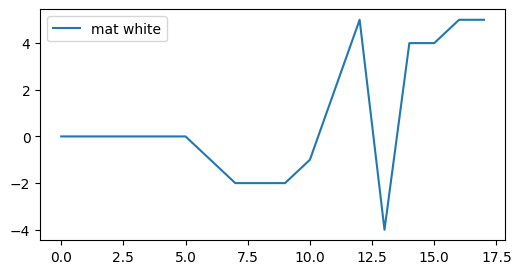

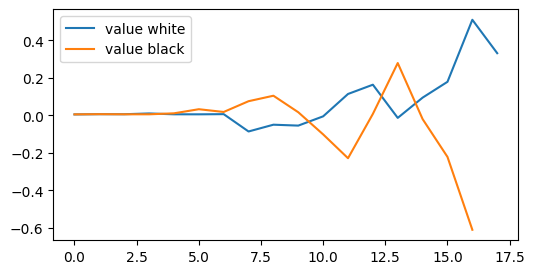

 -- 45960 -- winner: black, i: 88    wins: w = 4871.5, b = 4578.0, d = 14800
 -- 45970 -- winner: black, i: 16    wins: w = 4878.5, b = 4581.0, d = 14821
 -- 45980 -- winner: black, i: 14    wins: w = 4882.5, b = 4587.0, d = 14835
 -- 45990 -- winner: black, i: 98    wins: w = 4886.5, b = 4593.0, d = 14848
 -- 46000 -- winner: black, i: 60    wins: w = 4892.5, b = 4597.0, d = 14860


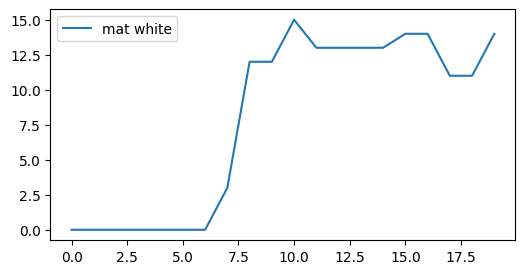

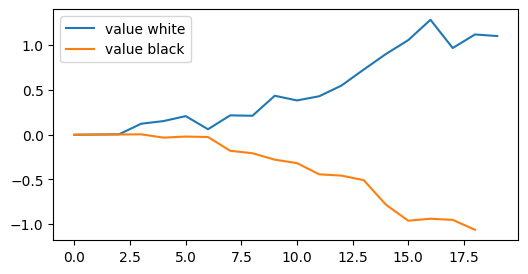

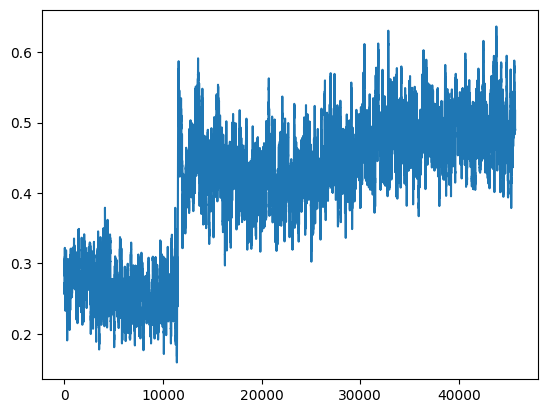

 -- 46010 -- winner: white, i: 47    wins: w = 4898.5, b = 4601.0, d = 14870
 -- 46020 -- winner: white, i: 73    wins: w = 4907.5, b = 4602.0, d = 14876
 -- 46030 -- winner: black, i: 96    wins: w = 4910.5, b = 4609.0, d = 14898
 -- 46040 -- winner: black, i: 98    wins: w = 4914.5, b = 4615.0, d = 14913
 -- 46050 -- winner: black, i: 88    wins: w = 4916.5, b = 4623.0, d = 14927


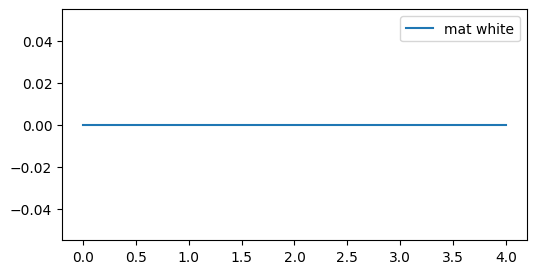

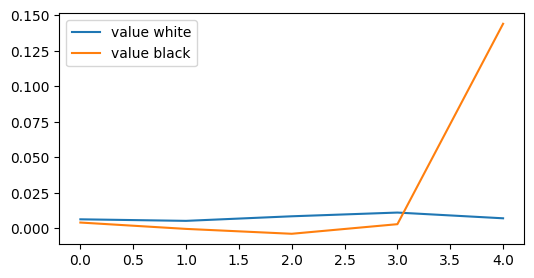

 -- 46060 -- winner: black, i: 38    wins: w = 4922.5, b = 4627.0, d = 14938
 -- 46070 -- winner: white, i: 83    wins: w = 4928.5, b = 4631.0, d = 14957
 -- 46080 -- winner: black, i: 4    wins: w = 4932.5, b = 4637.0, d = 14974
 -- 46090 -- winner: black, i: 134    wins: w = 4937.5, b = 4642.0, d = 14997
 -- 46100 -- winner: black, i: 76    wins: w = 4941.5, b = 4648.0, d = 15027


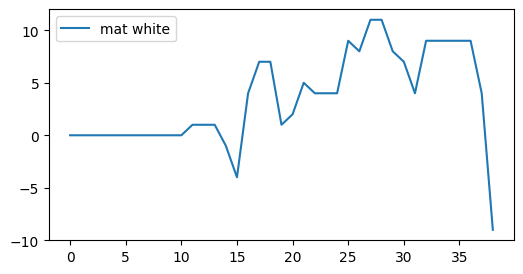

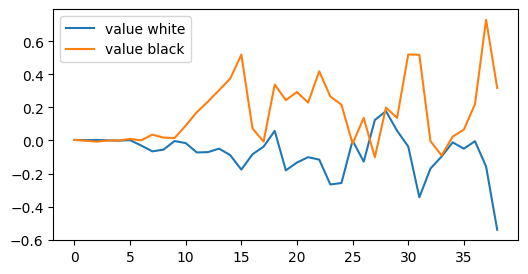

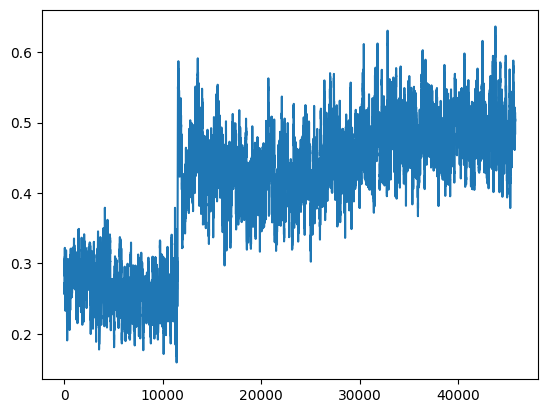

 -- 46110 -- winner: white, i: 21    wins: w = 4945.5, b = 4654.0, d = 15041
 -- 46120 -- winner: white, i: 71    wins: w = 4951.5, b = 4658.0, d = 15052
 -- 46130 -- winner: white, i: 21    wins: w = 4955.5, b = 4664.0, d = 15062
 -- 46140 -- winner: white, i: 15    wins: w = 4960.5, b = 4669.0, d = 15074
 -- 46150 -- winner: white, i: 17    wins: w = 4966.5, b = 4673.0, d = 15080


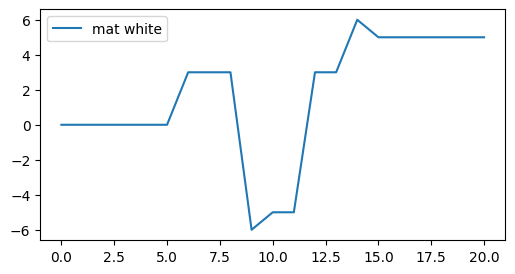

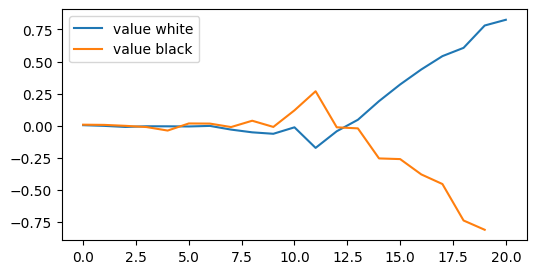

 -- 46160 -- winner: black, i: 96    wins: w = 4970.5, b = 4679.0, d = 15097
 -- 46170 -- winner: white, i: 15    wins: w = 4979.5, b = 4680.0, d = 15115
 -- 46180 -- winner: black, i: 48    wins: w = 4981.5, b = 4688.0, d = 15138
 -- 46190 -- winner: white, i: 57    wins: w = 4988.5, b = 4691.0, d = 15161
 -- 46200 -- winner: black, i: 94    wins: w = 4995.5, b = 4694.0, d = 15170


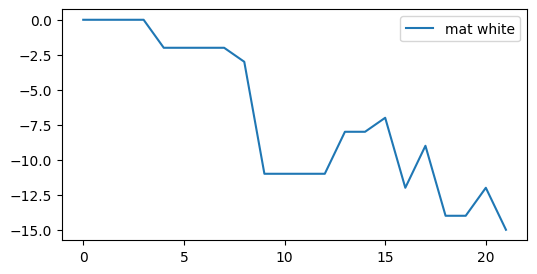

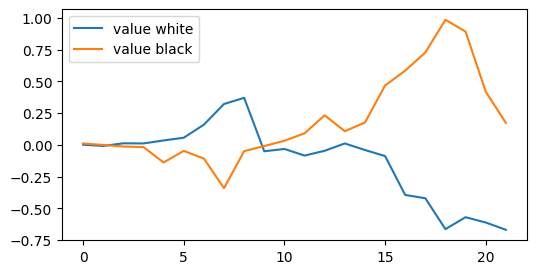

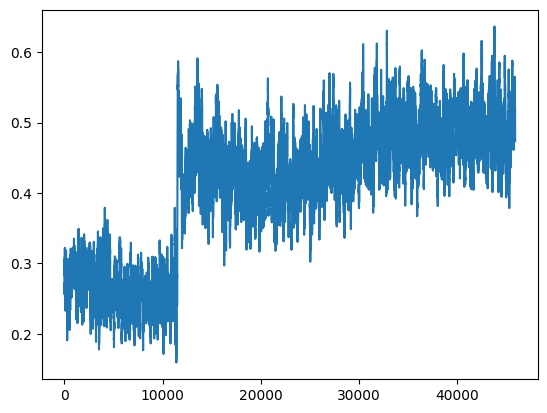

 -- 46210 -- winner: black, i: 102    wins: w = 4998.5, b = 4701.0, d = 15184
 -- 46220 -- winner: black, i: 80    wins: w = 5001.5, b = 4708.0, d = 15201
 -- 46230 -- winner: black, i: 30    wins: w = 5004.5, b = 4715.0, d = 15219
 -- 46240 -- winner: white, i: 7    wins: w = 5009.5, b = 4720.0, d = 15237
 -- 46250 -- winner: white, i: 93    wins: w = 5015.5, b = 4724.0, d = 15253


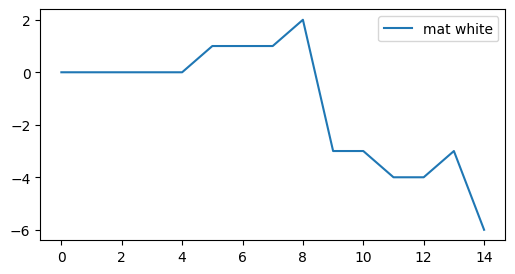

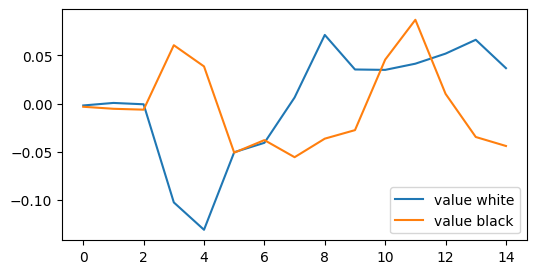

 -- 46260 -- winner: black, i: 96    wins: w = 5017.5, b = 4732.0, d = 15274
 -- 46270 -- winner: black, i: 162    wins: w = 5022.5, b = 4737.0, d = 15310
 -- 46280 -- winner: white, i: 111    wins: w = 5028.5, b = 4741.0, d = 15316
 -- 46290 -- winner: white, i: 95    wins: w = 5033.5, b = 4746.0, d = 15342
 -- 46300 -- winner: white, i: 33    wins: w = 5039.5, b = 4750.0, d = 15368


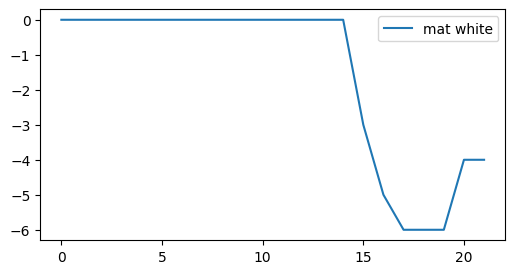

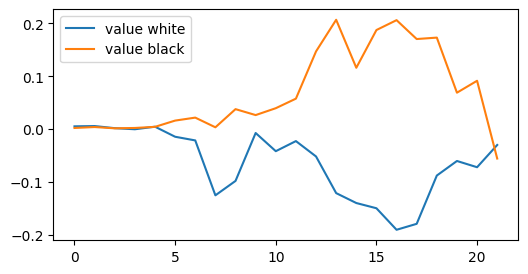

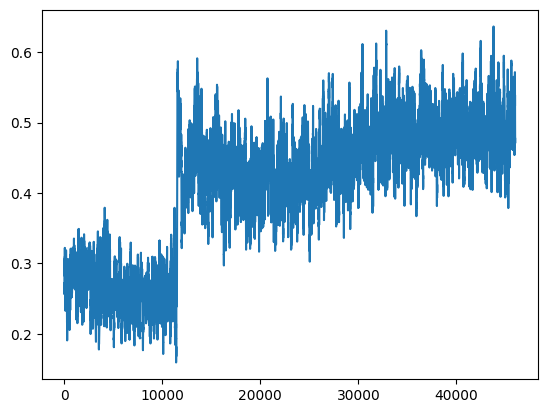

 -- 46310 -- winner: white, i: 37    wins: w = 5045.5, b = 4754.0, d = 15384
 -- 46320 -- winner: black, i: 52    wins: w = 5051.5, b = 4758.0, d = 15399
 -- 46330 -- winner: white, i: 181    wins: w = 5058.5, b = 4761.0, d = 15417
 -- 46340 -- winner: white, i: 55    wins: w = 5062.5, b = 4767.0, d = 15429
 -- 46350 -- winner: white, i: 83    wins: w = 5068.5, b = 4771.0, d = 15448


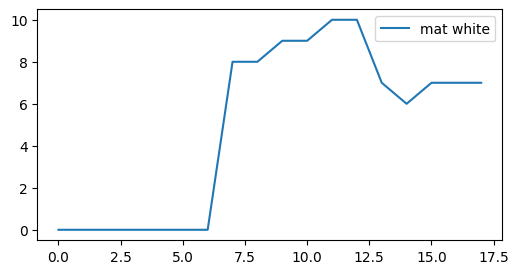

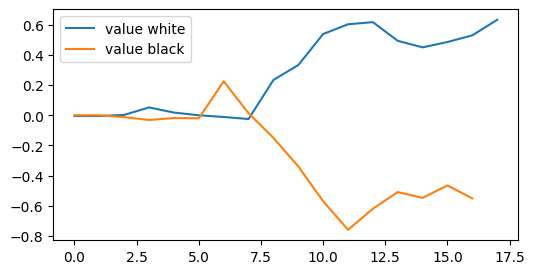

 -- 46360 -- winner: white, i: 69    wins: w = 5074.5, b = 4775.0, d = 15459
 -- 46370 -- winner: black, i: 138    wins: w = 5079.5, b = 4780.0, d = 15472
 -- 46380 -- winner: white, i: 39    wins: w = 5086.5, b = 4783.0, d = 15489
 -- 46390 -- winner: white, i: 47    wins: w = 5090.5, b = 4789.0, d = 15499
 -- 46400 -- winner: white, i: 47    wins: w = 5096.5, b = 4793.0, d = 15525


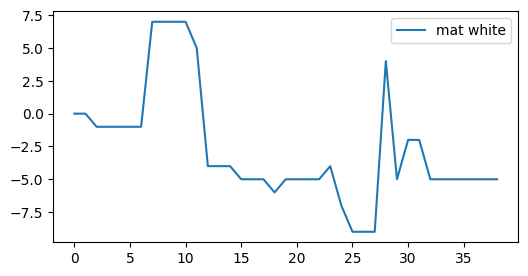

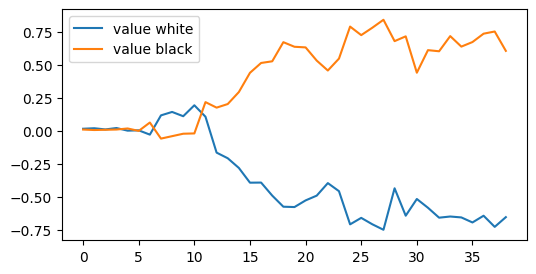

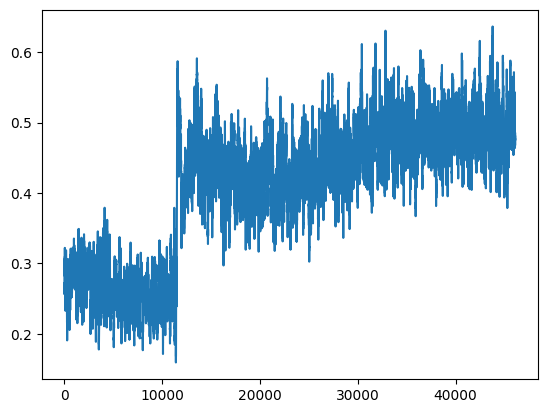

 -- 46410 -- winner: white, i: 29    wins: w = 5104.5, b = 4795.0, d = 15534
 -- 46420 -- winner: white, i: 101    wins: w = 5111.5, b = 4798.0, d = 15559
 -- 46430 -- winner: black, i: 12    wins: w = 5116.5, b = 4803.0, d = 15577
 -- 46440 -- winner: white, i: 41    wins: w = 5123.5, b = 4806.0, d = 15605
 -- 46450 -- winner: white, i: 77    wins: w = 5129.5, b = 4810.0, d = 15620


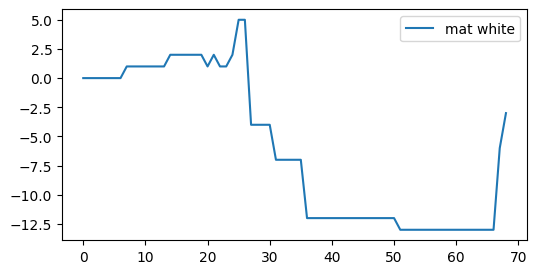

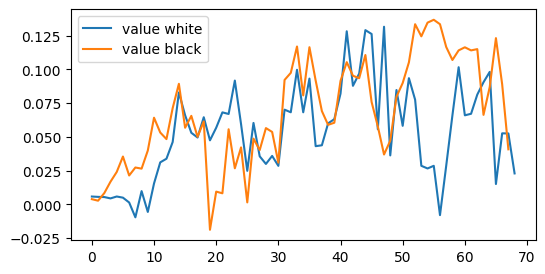

 -- 46460 -- winner: black, i: 84    wins: w = 5136.5, b = 4813.0, d = 15635
 -- 46470 -- winner: white, i: 51    wins: w = 5142.5, b = 4817.0, d = 15651
 -- 46480 -- winner: white, i: 77    wins: w = 5145.5, b = 4824.0, d = 15667
 -- 46490 -- winner: white, i: 49    wins: w = 5151.5, b = 4828.0, d = 15676
 -- 46500 -- winner: black, i: 24    wins: w = 5155.5, b = 4834.0, d = 15692


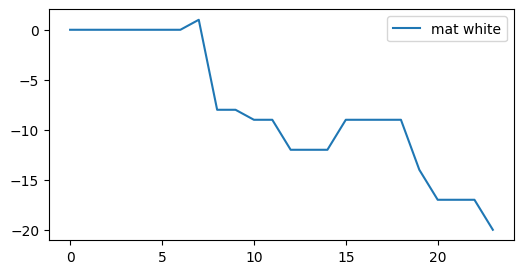

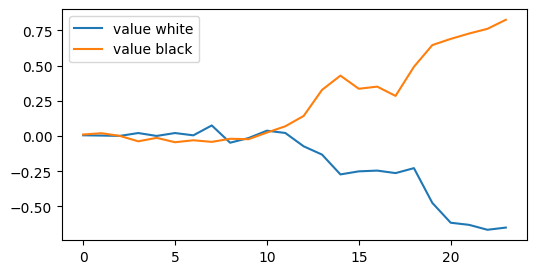

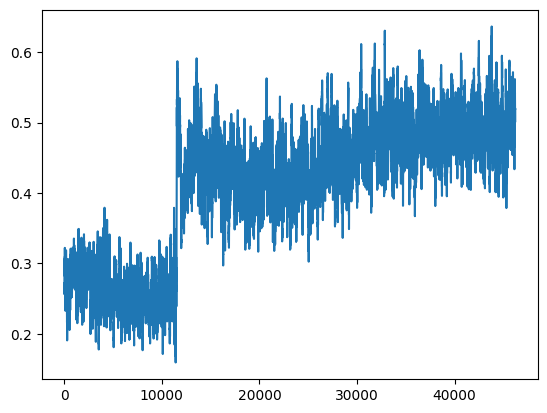

 -- 46510 -- winner: black, i: 52    wins: w = 5157.5, b = 4842.0, d = 15700
 -- 46520 -- winner: black, i: 28    wins: w = 5162.5, b = 4847.0, d = 15709
 -- 46530 -- winner: black, i: 54    wins: w = 5168.5, b = 4851.0, d = 15718
 -- 46540 -- winner: black, i: 90    wins: w = 5172.5, b = 4857.0, d = 15738
 -- 46550 -- winner: black, i: 108    wins: w = 5178.5, b = 4861.0, d = 15752


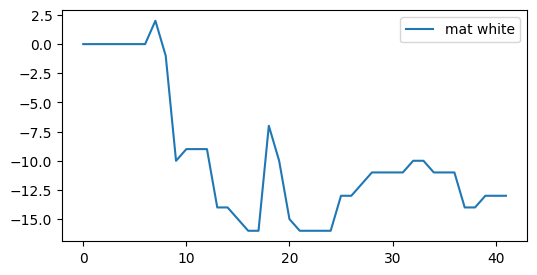

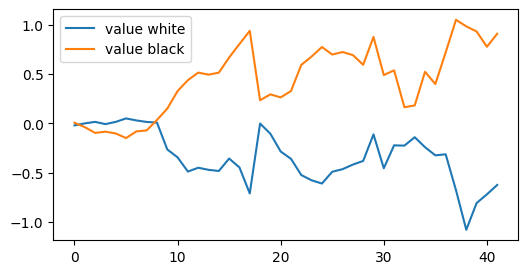

 -- 46560 -- winner: black, i: 46    wins: w = 5183.5, b = 4866.0, d = 15774
 -- 46570 -- winner: black, i: 48    wins: w = 5189.5, b = 4870.0, d = 15784
 -- 46580 -- winner: white, i: 89    wins: w = 5196.5, b = 4873.0, d = 15796
 -- 46590 -- winner: white, i: 83    wins: w = 5202.5, b = 4877.0, d = 15805
 -- 46600 -- winner: black, i: 54    wins: w = 5208.5, b = 4881.0, d = 15813


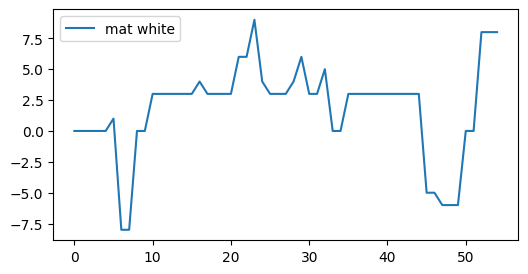

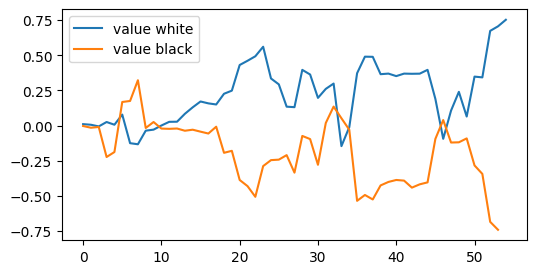

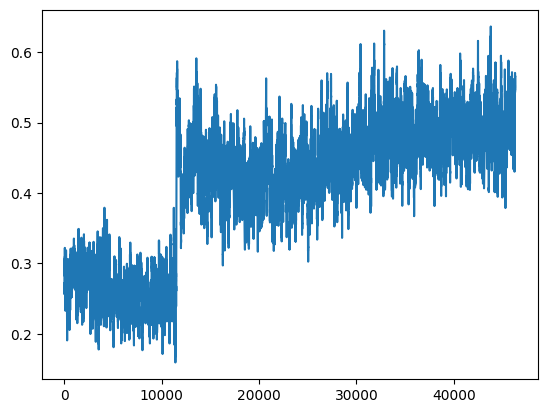

 -- 46610 -- winner: black, i: 92    wins: w = 5211.5, b = 4888.0, d = 15824
 -- 46620 -- winner: black, i: 84    wins: w = 5217.5, b = 4892.0, d = 15857
 -- 46630 -- winner: white, i: 21    wins: w = 5220.5, b = 4899.0, d = 15879
 -- 46640 -- winner: white, i: 59    wins: w = 5225.5, b = 4904.0, d = 15899
 -- 46650 -- winner: white, i: 43    wins: w = 5231.5, b = 4908.0, d = 15905


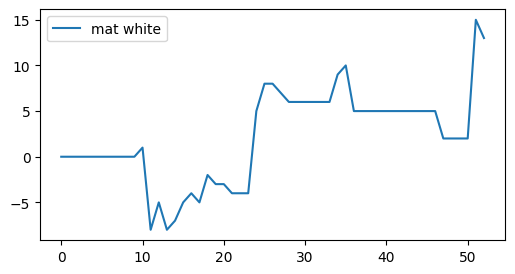

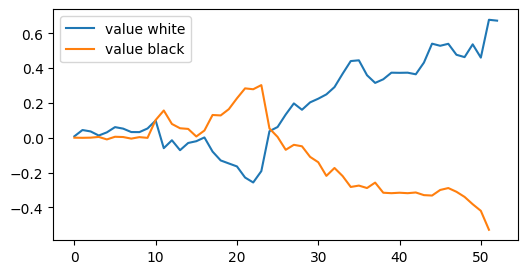

 -- 46660 -- winner: white, i: 47    wins: w = 5236.5, b = 4913.0, d = 15921
 -- 46670 -- winner: white, i: 41    wins: w = 5240.5, b = 4919.0, d = 15944
 -- 46680 -- winner: white, i: 85    wins: w = 5244.5, b = 4925.0, d = 15964
 -- 46690 -- winner: black, i: 82    wins: w = 5250.5, b = 4929.0, d = 15993
 -- 46700 -- winner: black, i: 14    wins: w = 5255.5, b = 4934.0, d = 16004


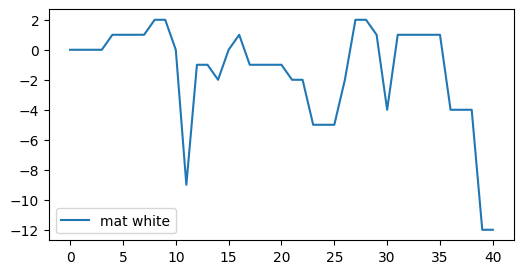

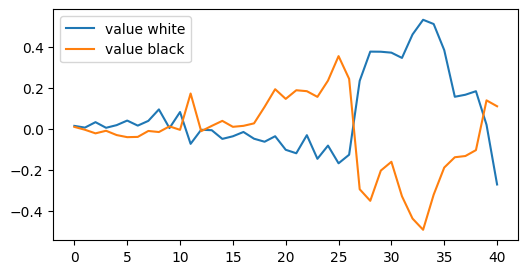

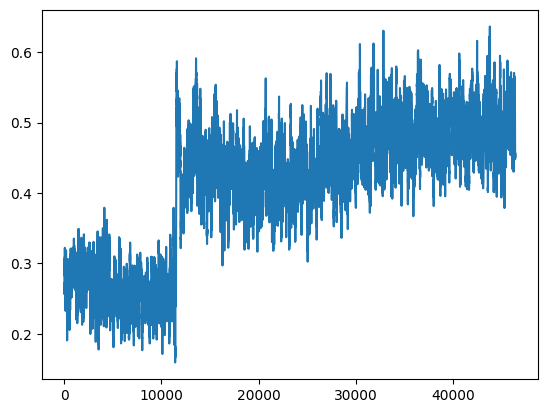

 -- 46710 -- winner: white, i: 9    wins: w = 5264.5, b = 4935.0, d = 16028
 -- 46720 -- winner: white, i: 75    wins: w = 5268.5, b = 4941.0, d = 16034
 -- 46730 -- winner: black, i: 22    wins: w = 5273.5, b = 4946.0, d = 16057
 -- 46740 -- winner: black, i: 8    wins: w = 5276.5, b = 4953.0, d = 16079
 -- 46750 -- winner: white, i: 45    wins: w = 5280.5, b = 4959.0, d = 16115


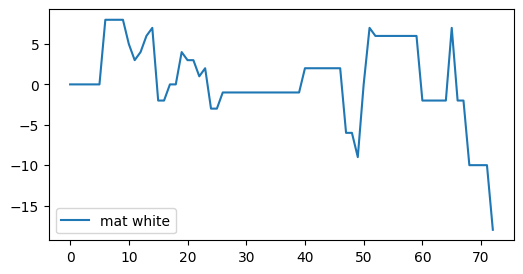

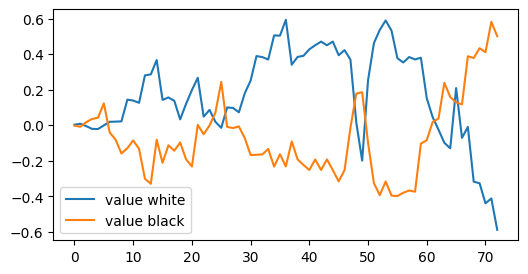

 -- 46760 -- winner: black, i: 50    wins: w = 5283.5, b = 4966.0, d = 16125
 -- 46770 -- winner: white, i: 69    wins: w = 5287.5, b = 4972.0, d = 16151
 -- 46780 -- winner: white, i: 17    wins: w = 5292.5, b = 4977.0, d = 16174
 -- 46790 -- winner: black, i: 90    wins: w = 5296.5, b = 4983.0, d = 16184
 -- 46800 -- winner: white, i: 25    wins: w = 5301.5, b = 4988.0, d = 16194


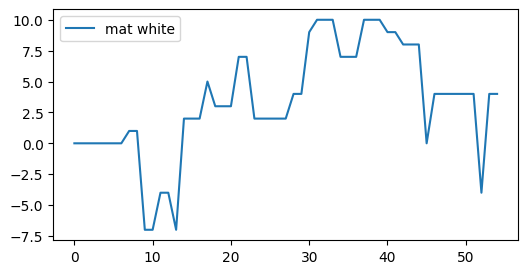

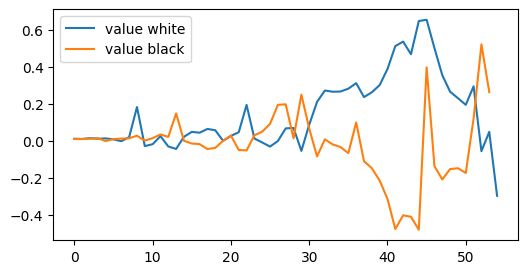

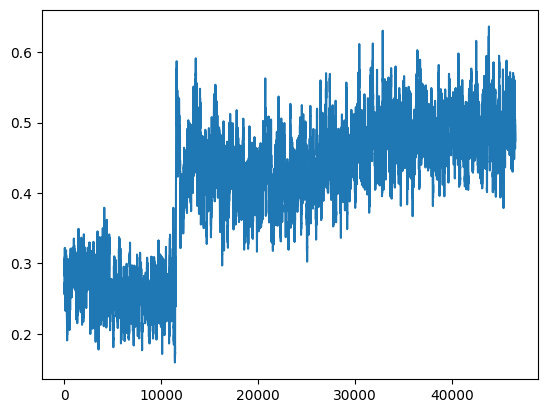

 -- 46810 -- winner: black, i: 90    wins: w = 5307.5, b = 4992.0, d = 16198
 -- 46820 -- winner: black, i: 76    wins: w = 5311.5, b = 4998.0, d = 16207
 -- 46830 -- winner: black, i: 94    wins: w = 5313.5, b = 5006.0, d = 16224
 -- 46840 -- winner: white, i: 15    wins: w = 5318.5, b = 5011.0, d = 16231
 -- 46850 -- winner: black, i: 52    wins: w = 5320.5, b = 5019.0, d = 16242


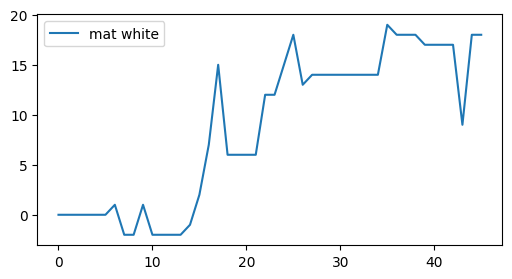

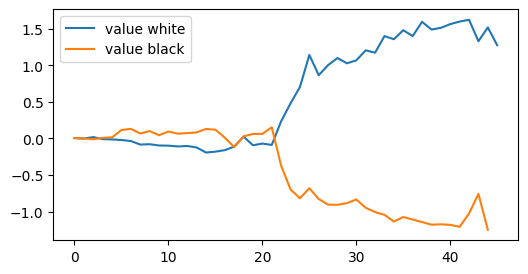

 -- 46860 -- winner: black, i: 124    wins: w = 5326.5, b = 5023.0, d = 16257
 -- 46870 -- winner: white, i: 73    wins: w = 5332.5, b = 5027.0, d = 16279
 -- 46880 -- winner: white, i: 77    wins: w = 5337.5, b = 5032.0, d = 16286
 -- 46890 -- winner: white, i: 89    wins: w = 5347.5, b = 5032.0, d = 16296
 -- 46900 -- winner: black, i: 170    wins: w = 5354.5, b = 5035.0, d = 16311


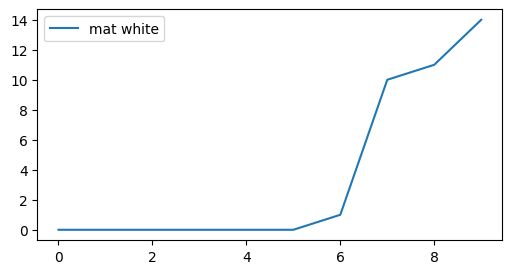

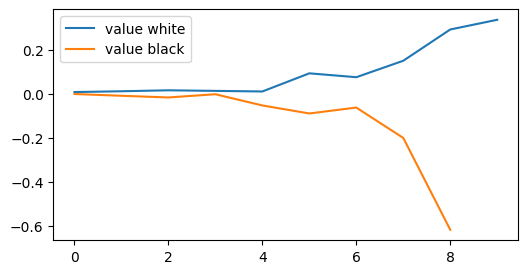

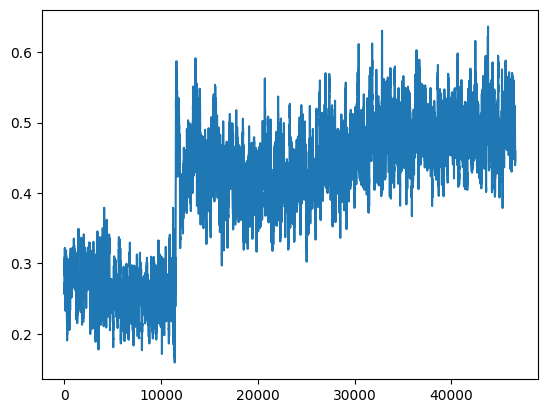

 -- 46910 -- winner: white, i: 43    wins: w = 5362.5, b = 5037.0, d = 16322
 -- 46920 -- winner: white, i: 35    wins: w = 5368.5, b = 5041.0, d = 16329
 -- 46930 -- winner: black, i: 14    wins: w = 5372.5, b = 5047.0, d = 16337
 -- 46940 -- winner: black, i: 26    wins: w = 5377.5, b = 5052.0, d = 16361
 -- 46950 -- winner: black, i: 88    wins: w = 5381.5, b = 5058.0, d = 16366


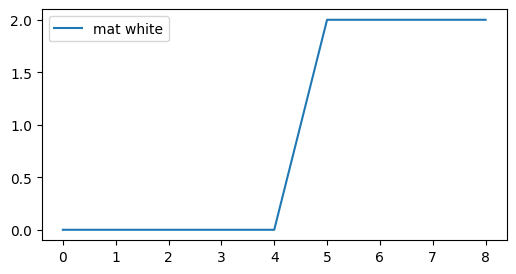

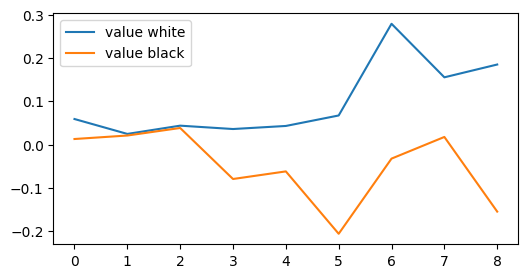

 -- 46960 -- winner: white, i: 7    wins: w = 5386.5, b = 5063.0, d = 16385
 -- 46970 -- winner: white, i: 79    wins: w = 5390.5, b = 5069.0, d = 16397
 -- 46980 -- winner: white, i: 97    wins: w = 5397.5, b = 5072.0, d = 16405
 -- 46990 -- winner: black, i: 38    wins: w = 5400.5, b = 5079.0, d = 16426
 -- 47000 -- winner: black, i: 84    wins: w = 5407.5, b = 5082.0, d = 16442


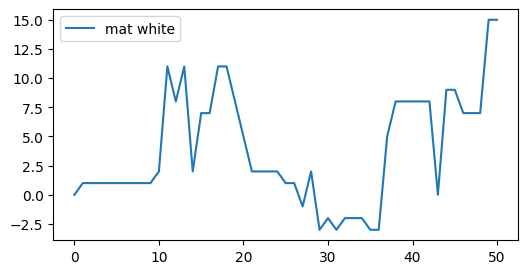

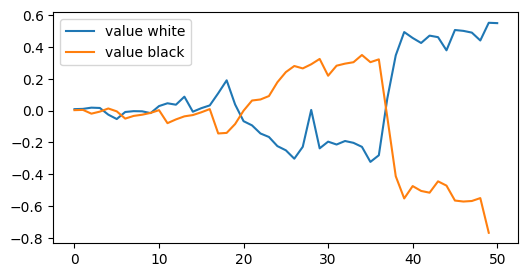

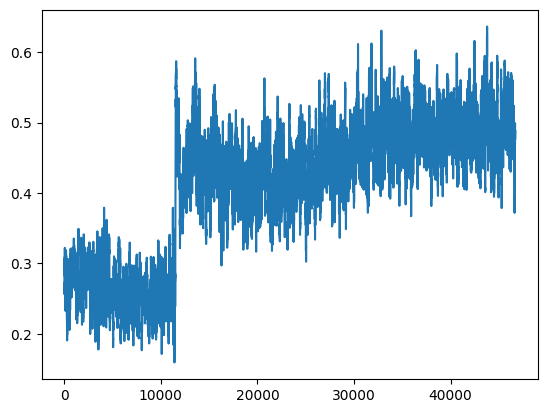

 -- 47010 -- winner: white, i: 35    wins: w = 5413.5, b = 5086.0, d = 16458
 -- 47020 -- winner: black, i: 4    wins: w = 5417.5, b = 5092.0, d = 16476
 -- 47030 -- winner: black, i: 48    wins: w = 5421.5, b = 5098.0, d = 16487
 -- 47040 -- winner: white, i: 9    wins: w = 5426.5, b = 5103.0, d = 16504
 -- 47050 -- winner: black, i: 48    wins: w = 5429.5, b = 5110.0, d = 16521


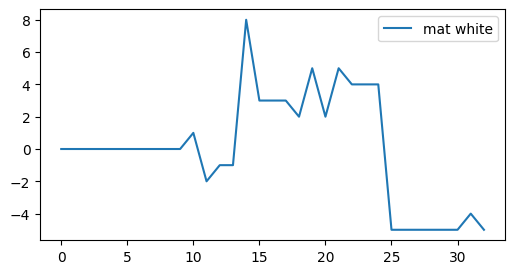

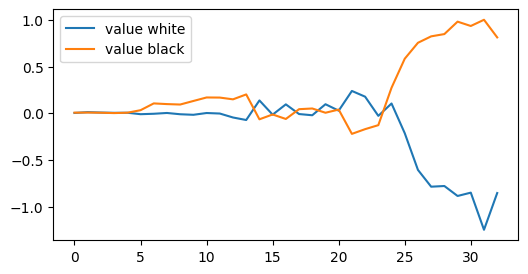

 -- 47060 -- winner: white, i: 53    wins: w = 5433.5, b = 5116.0, d = 16540
 -- 47070 -- winner: black, i: 74    wins: w = 5440.5, b = 5119.0, d = 16553
 -- 47080 -- winner: white, i: 51    wins: w = 5442.5, b = 5127.0, d = 16565
 -- 47090 -- winner: white, i: 65    wins: w = 5448.5, b = 5131.0, d = 16586
game termianted, mat diff =  -17
 -- 47100 -- winner: white, i: 105    wins: w = 5450.5, b = 5138.5, d = 16611


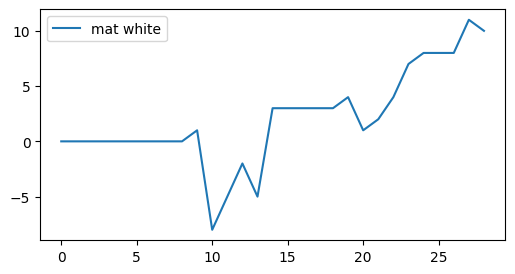

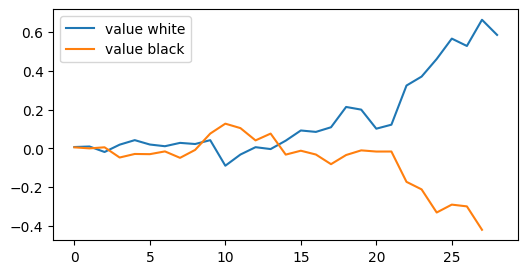

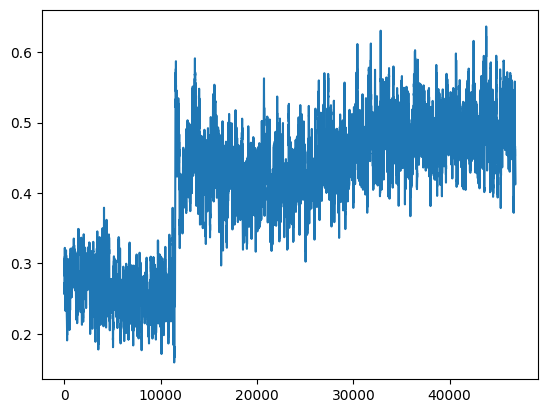

game termianted, mat diff =  -2
 -- 47110 -- winner: black, i: 10    wins: w = 5454.5, b = 5144.5, d = 16625
 -- 47120 -- winner: white, i: 59    wins: w = 5459.5, b = 5149.5, d = 16647
 -- 47130 -- winner: white, i: 47    wins: w = 5465.5, b = 5153.5, d = 16662
 -- 47140 -- winner: black, i: 64    wins: w = 5469.5, b = 5159.5, d = 16680
 -- 47150 -- winner: white, i: 73    wins: w = 5474.5, b = 5164.5, d = 16703


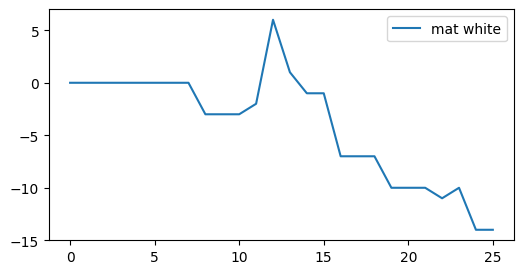

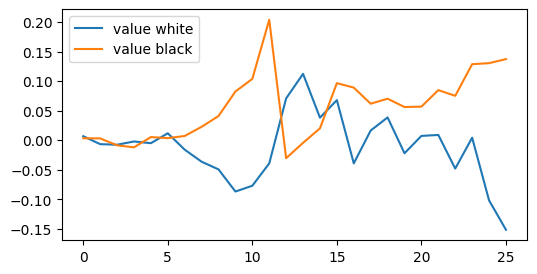

 -- 47160 -- winner: white, i: 113    wins: w = 5480.5, b = 5168.5, d = 16707
 -- 47170 -- winner: white, i: 85    wins: w = 5485.5, b = 5173.5, d = 16729
 -- 47180 -- winner: black, i: 60    wins: w = 5490.5, b = 5178.5, d = 16743
 -- 47190 -- winner: black, i: 70    wins: w = 5497.5, b = 5181.5, d = 16766
 -- 47200 -- winner: black, i: 88    wins: w = 5503.5, b = 5185.5, d = 16778


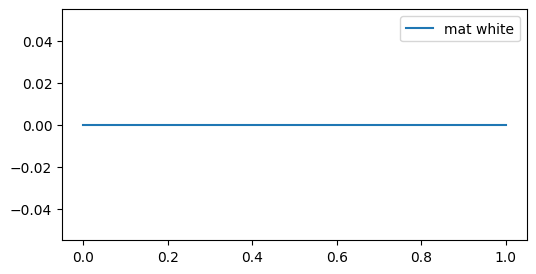

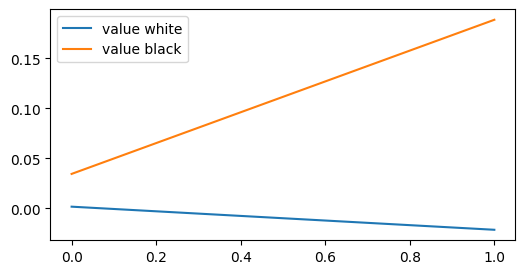

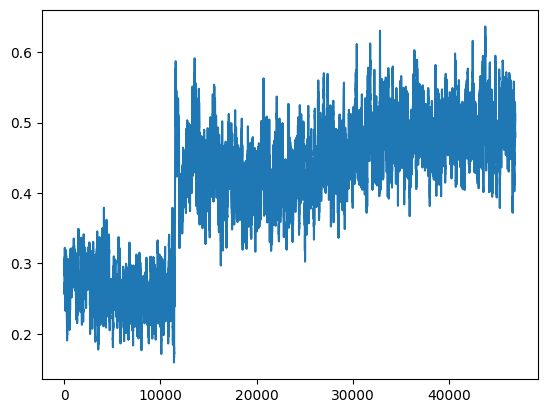

 -- 47210 -- winner: white, i: 95    wins: w = 5510.5, b = 5188.5, d = 16787
 -- 47220 -- winner: white, i: 35    wins: w = 5514.5, b = 5194.5, d = 16797
 -- 47230 -- winner: black, i: 104    wins: w = 5517.5, b = 5201.5, d = 16806
 -- 47240 -- winner: black, i: 34    wins: w = 5522.5, b = 5206.5, d = 16814
 -- 47250 -- winner: black, i: 12    wins: w = 5527.5, b = 5211.5, d = 16837


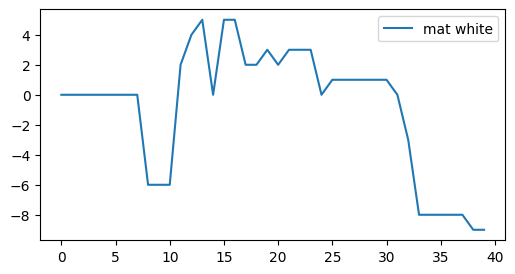

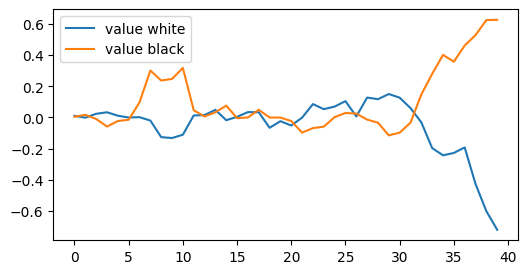

 -- 47260 -- winner: black, i: 50    wins: w = 5533.5, b = 5215.5, d = 16853
 -- 47270 -- winner: black, i: 70    wins: w = 5537.5, b = 5221.5, d = 16868
 -- 47280 -- winner: white, i: 31    wins: w = 5545.5, b = 5223.5, d = 16879
 -- 47290 -- winner: white, i: 45    wins: w = 5550.5, b = 5228.5, d = 16903
 -- 47300 -- winner: black, i: 38    wins: w = 5554.5, b = 5234.5, d = 16917


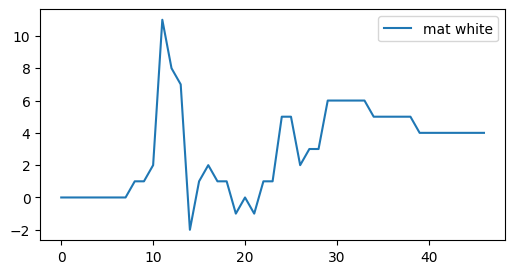

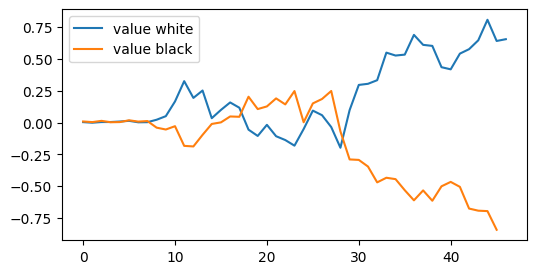

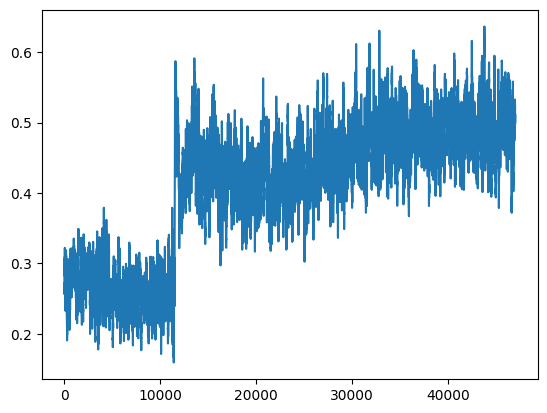

 -- 47310 -- winner: white, i: 85    wins: w = 5559.5, b = 5239.5, d = 16951
 -- 47320 -- winner: white, i: 75    wins: w = 5566.5, b = 5242.5, d = 16962
 -- 47330 -- winner: black, i: 80    wins: w = 5570.5, b = 5248.5, d = 16982
 -- 47340 -- winner: black, i: 6    wins: w = 5577.5, b = 5251.5, d = 16995
 -- 47350 -- winner: white, i: 119    wins: w = 5585.5, b = 5253.5, d = 17006


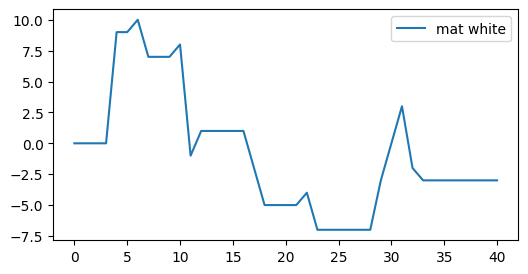

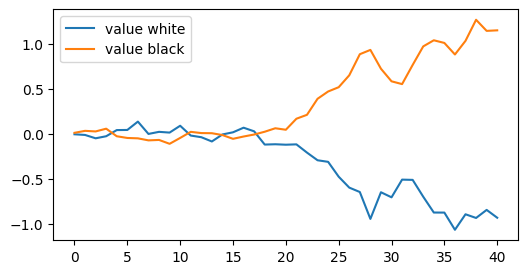

 -- 47360 -- winner: white, i: 95    wins: w = 5590.5, b = 5258.5, d = 17015
 -- 47370 -- winner: white, i: 19    wins: w = 5593.5, b = 5265.5, d = 17030
 -- 47380 -- winner: black, i: 60    wins: w = 5598.5, b = 5270.5, d = 17047
 -- 47390 -- winner: white, i: 89    wins: w = 5605.5, b = 5273.5, d = 17067
 -- 47400 -- winner: black, i: 66    wins: w = 5608.5, b = 5280.5, d = 17077


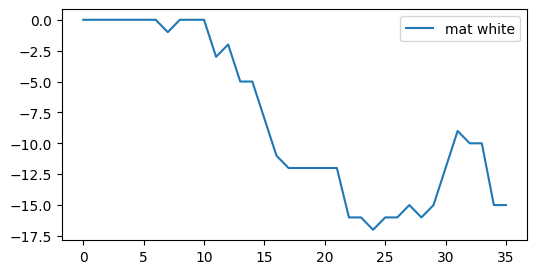

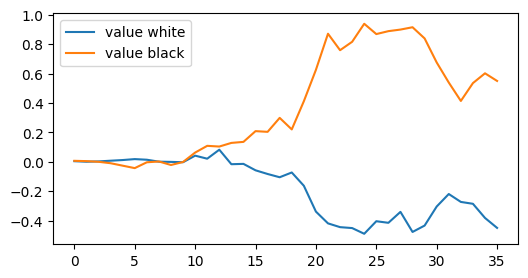

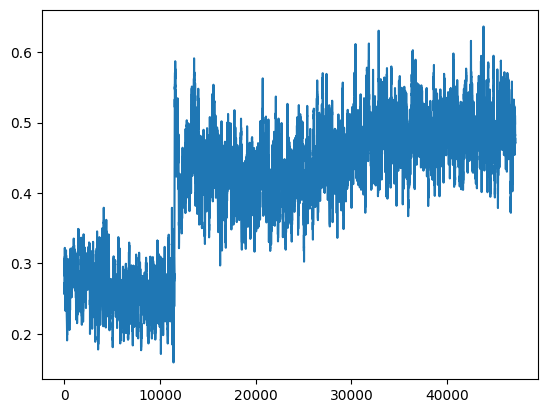

 -- 47410 -- winner: white, i: 59    wins: w = 5614.5, b = 5284.5, d = 17090
 -- 47420 -- winner: black, i: 96    wins: w = 5619.5, b = 5289.5, d = 17103
 -- 47430 -- winner: black, i: 12    wins: w = 5625.5, b = 5293.5, d = 17143
 -- 47440 -- winner: white, i: 33    wins: w = 5631.5, b = 5297.5, d = 17154
 -- 47450 -- winner: white, i: 91    wins: w = 5637.5, b = 5301.5, d = 17163


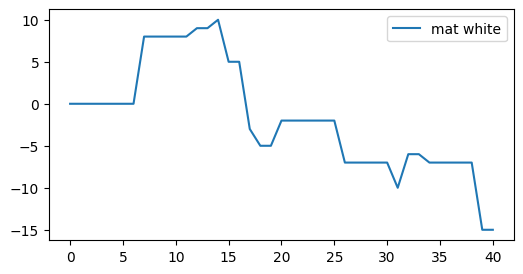

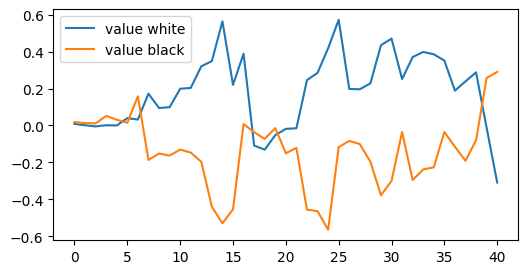

 -- 47460 -- winner: black, i: 66    wins: w = 5643.5, b = 5305.5, d = 17177
 -- 47470 -- winner: black, i: 46    wins: w = 5651.5, b = 5307.5, d = 17188
 -- 47480 -- winner: white, i: 65    wins: w = 5656.5, b = 5312.5, d = 17200
 -- 47490 -- winner: black, i: 40    wins: w = 5659.5, b = 5319.5, d = 17216
 -- 47500 -- winner: white, i: 51    wins: w = 5663.5, b = 5325.5, d = 17230


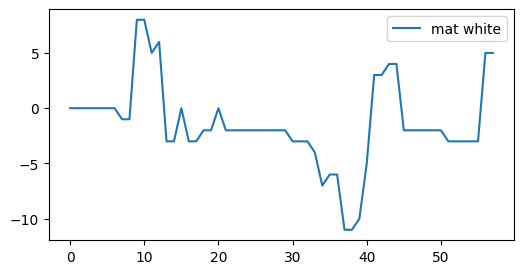

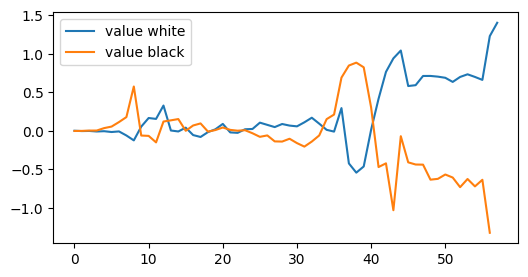

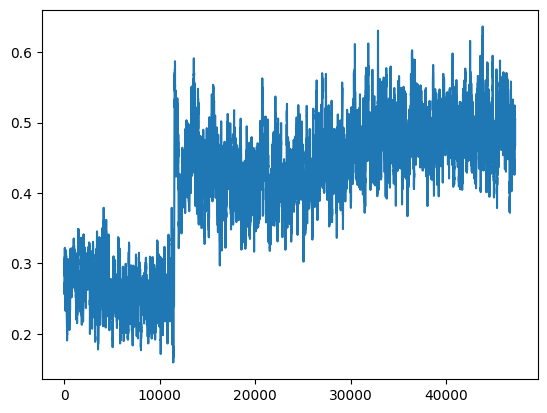

 -- 47510 -- winner: white, i: 79    wins: w = 5669.5, b = 5329.5, d = 17250
 -- 47520 -- winner: black, i: 84    wins: w = 5671.5, b = 5337.5, d = 17265
 -- 47530 -- winner: white, i: 7    wins: w = 5677.5, b = 5341.5, d = 17276
 -- 47540 -- winner: black, i: 14    wins: w = 5680.5, b = 5348.5, d = 17293
 -- 47550 -- winner: black, i: 10    wins: w = 5684.5, b = 5354.5, d = 17303


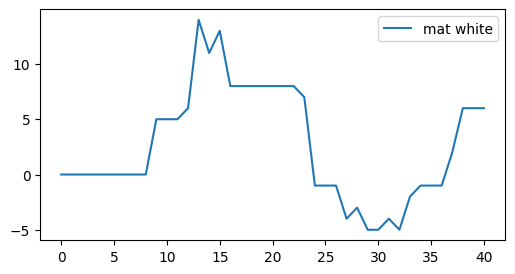

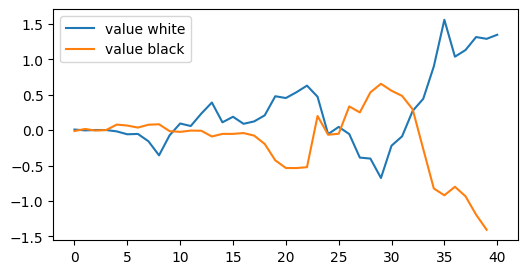

 -- 47560 -- winner: black, i: 38    wins: w = 5689.5, b = 5359.5, d = 17311
 -- 47570 -- winner: white, i: 113    wins: w = 5695.5, b = 5363.5, d = 17324
 -- 47580 -- winner: white, i: 87    wins: w = 5700.5, b = 5368.5, d = 17336
 -- 47590 -- winner: black, i: 30    wins: w = 5703.5, b = 5375.5, d = 17341
 -- 47600 -- winner: white, i: 77    wins: w = 5710.5, b = 5378.5, d = 17352


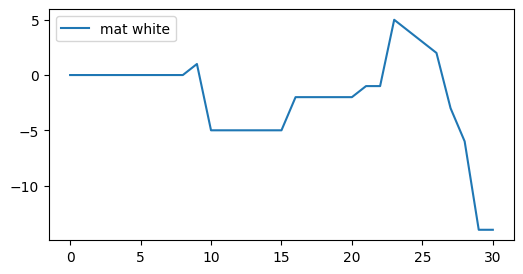

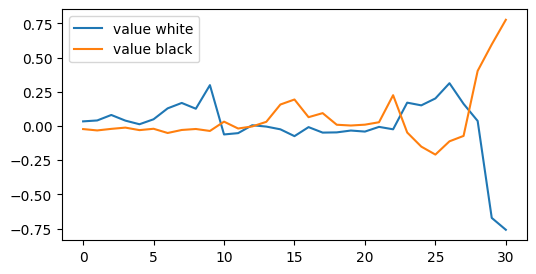

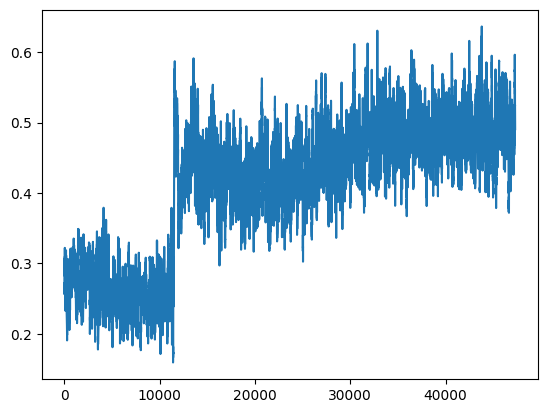

 -- 47610 -- winner: black, i: 28    wins: w = 5714.5, b = 5384.5, d = 17367
 -- 47620 -- winner: black, i: 22    wins: w = 5722.5, b = 5386.5, d = 17378
 -- 47630 -- winner: white, i: 43    wins: w = 5728.5, b = 5390.5, d = 17389
 -- 47640 -- winner: white, i: 71    wins: w = 5733.5, b = 5395.5, d = 17396
 -- 47650 -- winner: black, i: 62    wins: w = 5738.5, b = 5400.5, d = 17408


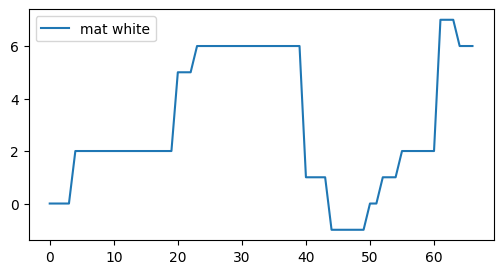

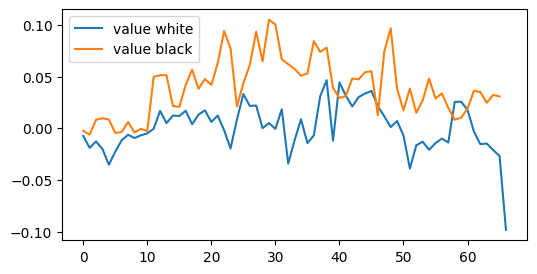

 -- 47660 -- winner: black, i: 80    wins: w = 5743.5, b = 5405.5, d = 17420
 -- 47670 -- winner: white, i: 5    wins: w = 5747.5, b = 5411.5, d = 17433
 -- 47680 -- winner: black, i: 44    wins: w = 5750.5, b = 5418.5, d = 17450
 -- 47690 -- winner: white, i: 105    wins: w = 5756.5, b = 5422.5, d = 17455
 -- 47700 -- winner: black, i: 36    wins: w = 5761.5, b = 5427.5, d = 17461


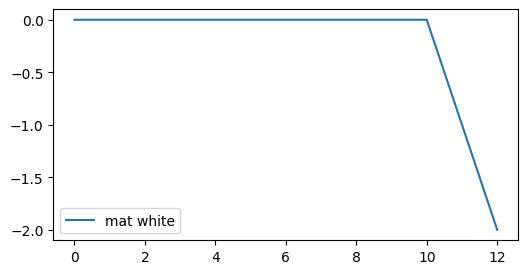

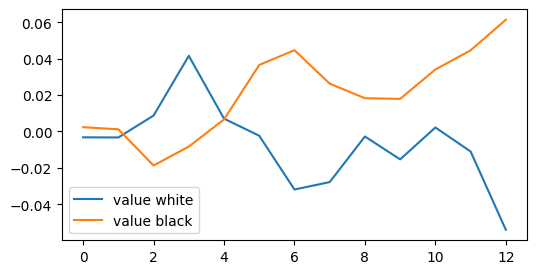

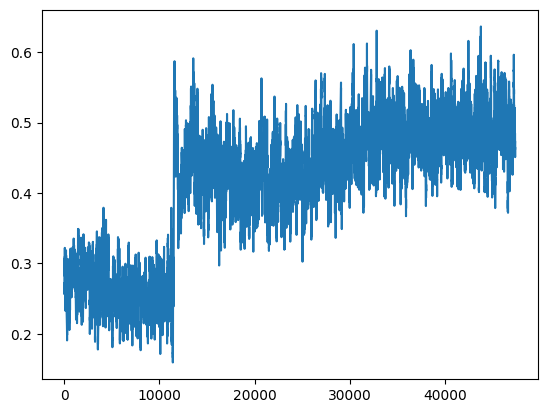

 -- 47710 -- winner: white, i: 23    wins: w = 5762.5, b = 5436.5, d = 17480
 -- 47720 -- winner: black, i: 56    wins: w = 5767.5, b = 5441.5, d = 17500
 -- 47730 -- winner: white, i: 15    wins: w = 5773.5, b = 5445.5, d = 17516
 -- 47740 -- winner: black, i: 110    wins: w = 5777.5, b = 5451.5, d = 17537
 -- 47750 -- winner: black, i: 70    wins: w = 5782.5, b = 5456.5, d = 17545


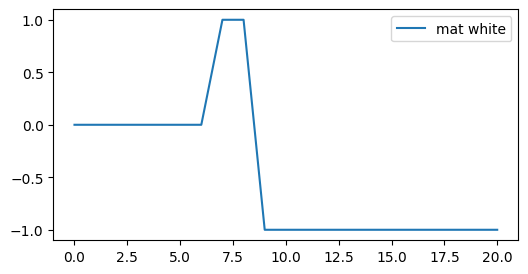

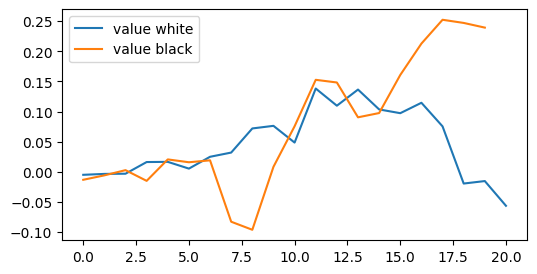

 -- 47760 -- winner: white, i: 85    wins: w = 5787.5, b = 5461.5, d = 17556
 -- 47770 -- winner: black, i: 82    wins: w = 5791.5, b = 5467.5, d = 17573
 -- 47780 -- winner: white, i: 97    wins: w = 5797.5, b = 5471.5, d = 17587
 -- 47790 -- winner: black, i: 96    wins: w = 5801.5, b = 5477.5, d = 17596
 -- 47800 -- winner: black, i: 32    wins: w = 5803.5, b = 5485.5, d = 17607


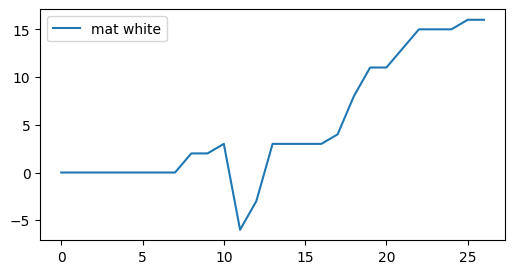

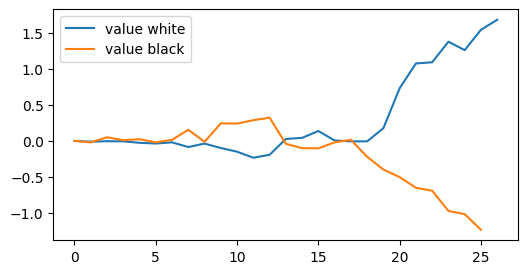

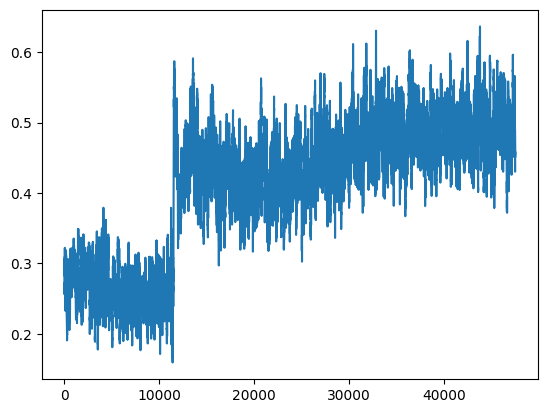

 -- 47810 -- winner: white, i: 97    wins: w = 5810.5, b = 5488.5, d = 17629
 -- 47820 -- winner: white, i: 57    wins: w = 5813.5, b = 5495.5, d = 17641
 -- 47830 -- winner: black, i: 66    wins: w = 5820.5, b = 5498.5, d = 17662
 -- 47840 -- winner: white, i: 45    wins: w = 5829.5, b = 5499.5, d = 17672
 -- 47850 -- winner: black, i: 20    wins: w = 5833.5, b = 5505.5, d = 17682


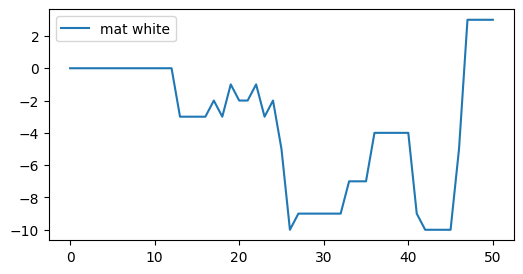

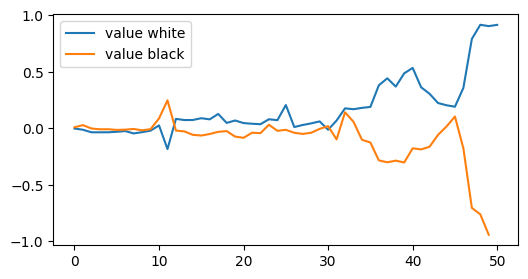

 -- 47860 -- winner: black, i: 32    wins: w = 5837.5, b = 5511.5, d = 17695
 -- 47870 -- winner: white, i: 17    wins: w = 5843.5, b = 5515.5, d = 17717
 -- 47880 -- winner: white, i: 19    wins: w = 5847.5, b = 5521.5, d = 17740
 -- 47890 -- winner: white, i: 5    wins: w = 5855.5, b = 5523.5, d = 17752
 -- 47900 -- winner: black, i: 80    wins: w = 5860.5, b = 5528.5, d = 17763


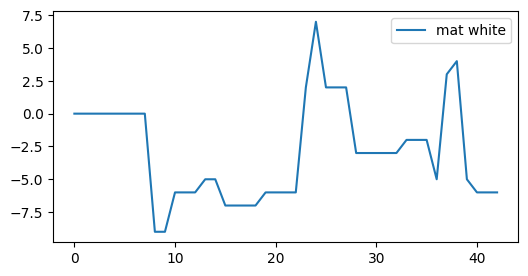

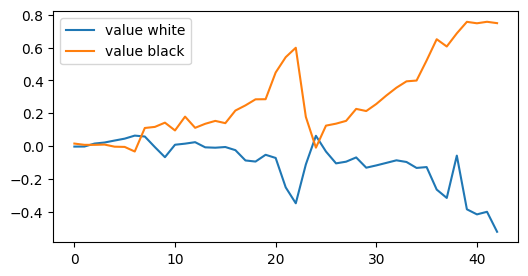

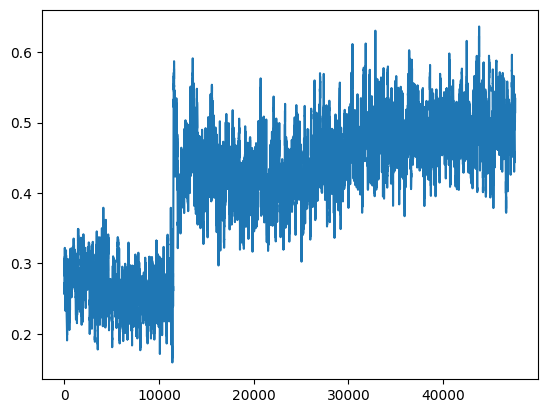

 -- 47910 -- winner: white, i: 49    wins: w = 5865.5, b = 5533.5, d = 17773
 -- 47920 -- winner: black, i: 94    wins: w = 5867.5, b = 5541.5, d = 17796
 -- 47930 -- winner: black, i: 42    wins: w = 5873.5, b = 5545.5, d = 17808
 -- 47940 -- winner: black, i: 60    wins: w = 5879.5, b = 5549.5, d = 17818
 -- 47950 -- winner: white, i: 89    wins: w = 5885.5, b = 5553.5, d = 17841


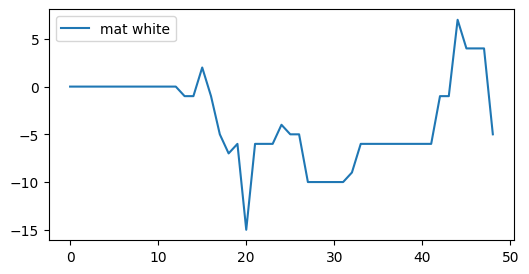

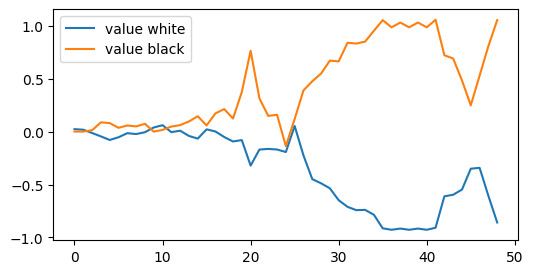

 -- 47960 -- winner: white, i: 65    wins: w = 5890.5, b = 5558.5, d = 17863
 -- 47970 -- winner: black, i: 28    wins: w = 5897.5, b = 5561.5, d = 17878
 -- 47980 -- winner: white, i: 109    wins: w = 5901.5, b = 5567.5, d = 17894
 -- 47990 -- winner: white, i: 39    wins: w = 5907.5, b = 5571.5, d = 17910
 -- 48000 -- winner: white, i: 131    wins: w = 5915.5, b = 5573.5, d = 17917


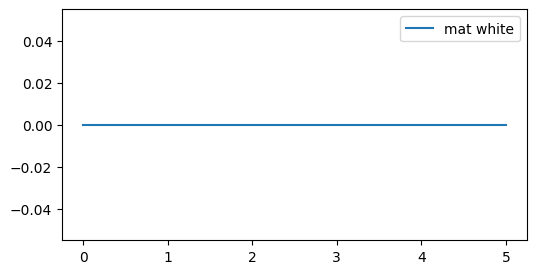

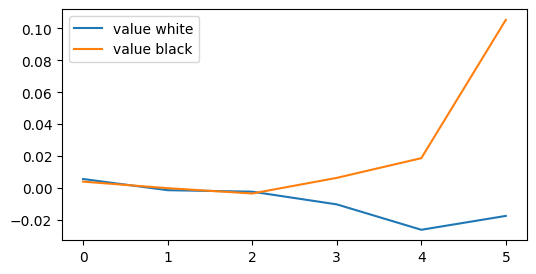

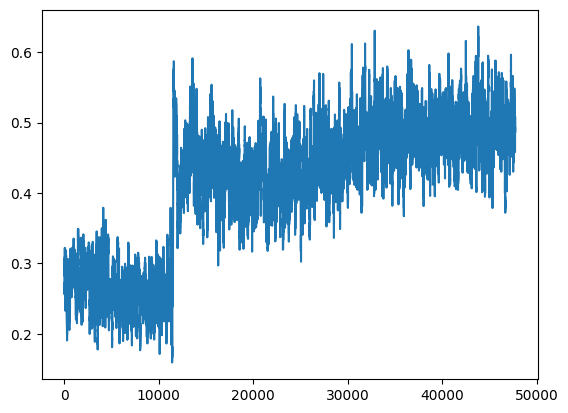

 -- 48010 -- winner: black, i: 80    wins: w = 5918.5, b = 5580.5, d = 17933
 -- 48020 -- winner: black, i: 86    wins: w = 5926.5, b = 5582.5, d = 17949
 -- 48030 -- winner: white, i: 17    wins: w = 5931.5, b = 5587.5, d = 17963
 -- 48040 -- winner: white, i: 37    wins: w = 5937.5, b = 5591.5, d = 17978
 -- 48050 -- winner: black, i: 44    wins: w = 5944.5, b = 5594.5, d = 17988


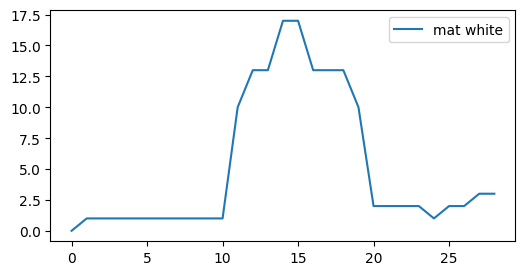

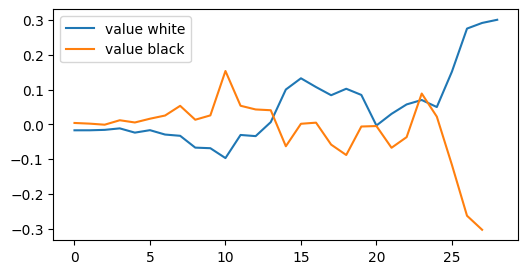

 -- 48060 -- winner: white, i: 5    wins: w = 5950.5, b = 5598.5, d = 18001
 -- 48070 -- winner: black, i: 68    wins: w = 5956.5, b = 5602.5, d = 18013
 -- 48080 -- winner: black, i: 76    wins: w = 5962.5, b = 5606.5, d = 18022
 -- 48090 -- winner: black, i: 112    wins: w = 5968.5, b = 5610.5, d = 18034
 -- 48100 -- winner: white, i: 87    wins: w = 5974.5, b = 5614.5, d = 18059


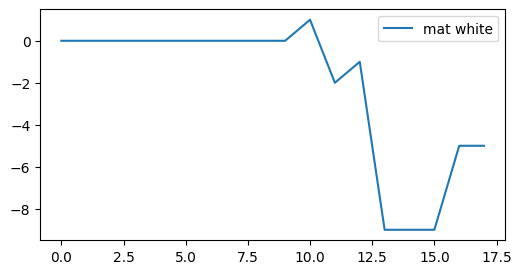

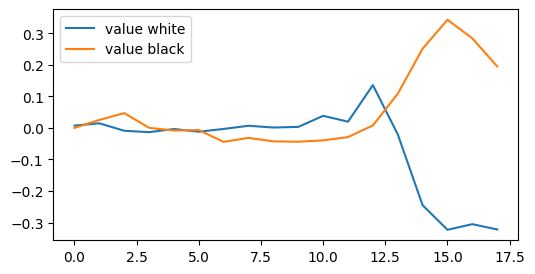

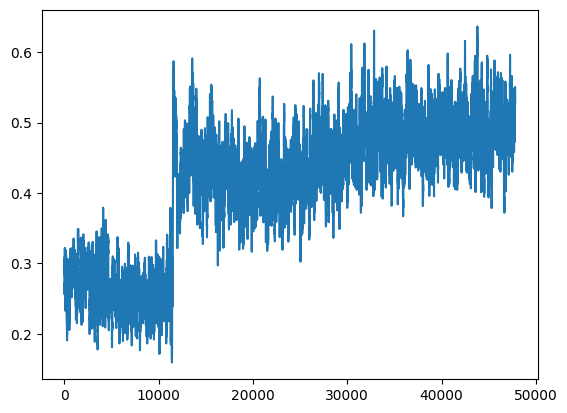

 -- 48110 -- winner: white, i: 45    wins: w = 5980.5, b = 5618.5, d = 18082
 -- 48120 -- winner: white, i: 117    wins: w = 5985.5, b = 5623.5, d = 18093
 -- 48130 -- winner: black, i: 82    wins: w = 5990.5, b = 5628.5, d = 18111
 -- 48140 -- winner: black, i: 90    wins: w = 5996.5, b = 5632.5, d = 18121
 -- 48150 -- winner: black, i: 84    wins: w = 6001.5, b = 5637.5, d = 18142


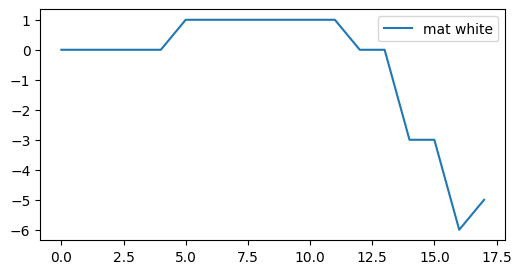

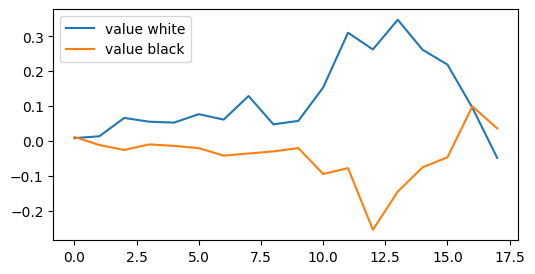

 -- 48160 -- winner: white, i: 61    wins: w = 6004.5, b = 5644.5, d = 18156
 -- 48170 -- winner: white, i: 47    wins: w = 6007.5, b = 5651.5, d = 18182
 -- 48180 -- winner: black, i: 34    wins: w = 6010.5, b = 5658.5, d = 18201
 -- 48190 -- winner: white, i: 27    wins: w = 6014.5, b = 5664.5, d = 18216
 -- 48200 -- winner: white, i: 35    wins: w = 6019.5, b = 5669.5, d = 18220


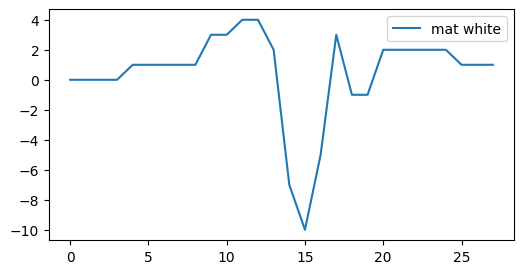

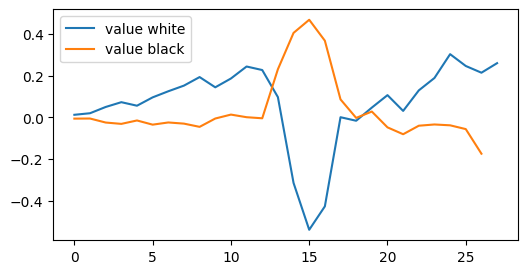

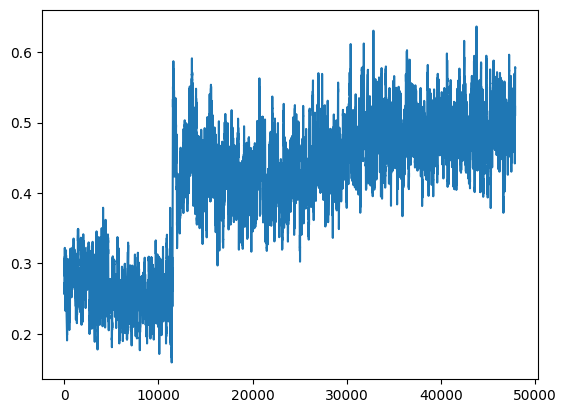

 -- 48210 -- winner: black, i: 42    wins: w = 6024.5, b = 5674.5, d = 18231
 -- 48220 -- winner: white, i: 51    wins: w = 6030.5, b = 5678.5, d = 18248
 -- 48230 -- winner: white, i: 29    wins: w = 6038.5, b = 5680.5, d = 18264
 -- 48240 -- winner: white, i: 19    wins: w = 6043.5, b = 5685.5, d = 18280
 -- 48250 -- winner: black, i: 56    wins: w = 6047.5, b = 5691.5, d = 18287


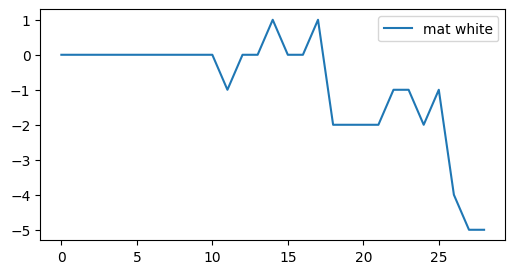

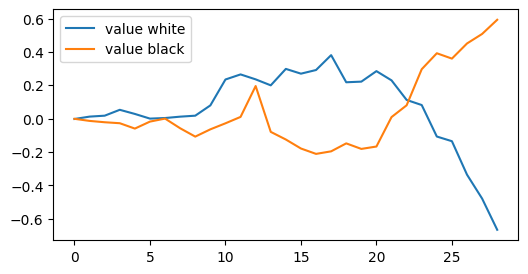

 -- 48260 -- winner: black, i: 86    wins: w = 6052.5, b = 5696.5, d = 18308
 -- 48270 -- winner: white, i: 65    wins: w = 6058.5, b = 5700.5, d = 18329
 -- 48280 -- winner: black, i: 94    wins: w = 6063.5, b = 5705.5, d = 18335
 -- 48290 -- winner: white, i: 91    wins: w = 6071.5, b = 5707.5, d = 18360
 -- 48300 -- winner: white, i: 71    wins: w = 6079.5, b = 5709.5, d = 18373


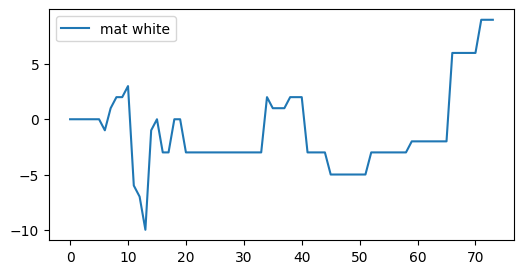

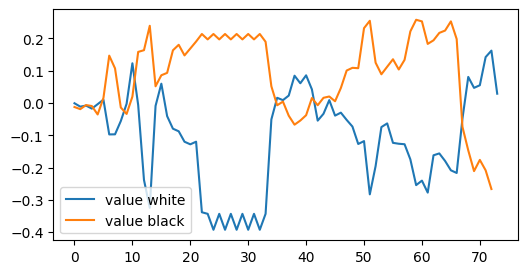

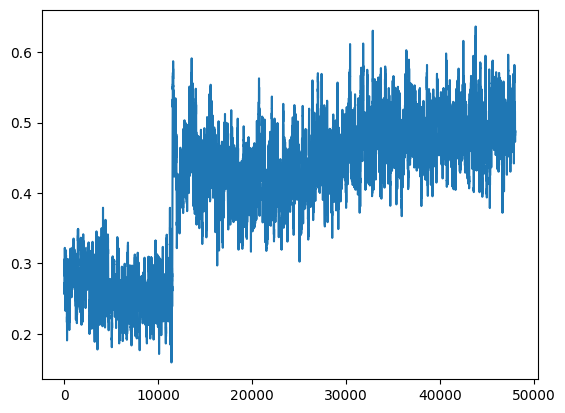

 -- 48310 -- winner: black, i: 6    wins: w = 6083.5, b = 5715.5, d = 18394
 -- 48320 -- winner: black, i: 76    wins: w = 6087.5, b = 5721.5, d = 18403
 -- 48330 -- winner: black, i: 50    wins: w = 6091.5, b = 5727.5, d = 18419
 -- 48340 -- winner: white, i: 17    wins: w = 6099.5, b = 5729.5, d = 18442
 -- 48350 -- winner: white, i: 71    wins: w = 6103.5, b = 5735.5, d = 18456


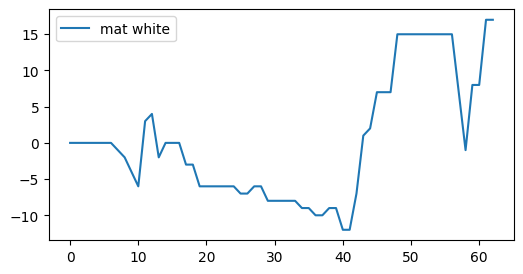

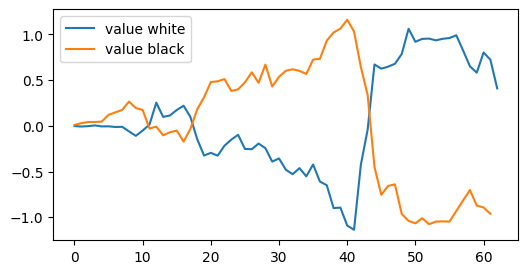

 -- 48360 -- winner: white, i: 85    wins: w = 6112.5, b = 5736.5, d = 18479
 -- 48370 -- winner: black, i: 78    wins: w = 6115.5, b = 5743.5, d = 18487
 -- 48380 -- winner: black, i: 86    wins: w = 6120.5, b = 5748.5, d = 18501
 -- 48390 -- winner: white, i: 21    wins: w = 6126.5, b = 5752.5, d = 18513
 -- 48400 -- winner: black, i: 66    wins: w = 6129.5, b = 5759.5, d = 18524


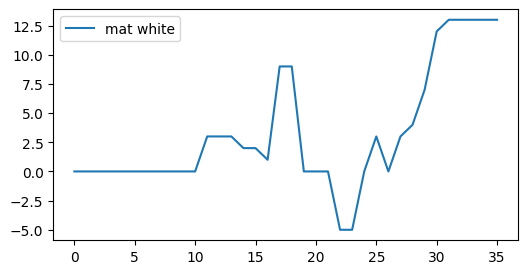

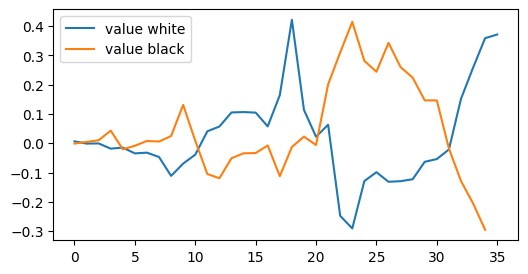

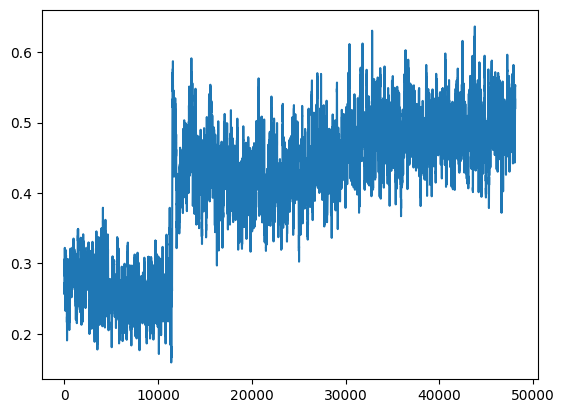

 -- 48410 -- winner: black, i: 108    wins: w = 6132.5, b = 5766.5, d = 18534
 -- 48420 -- winner: white, i: 47    wins: w = 6138.5, b = 5770.5, d = 18553
 -- 48430 -- winner: white, i: 55    wins: w = 6145.5, b = 5773.5, d = 18559
 -- 48440 -- winner: black, i: 64    wins: w = 6149.5, b = 5779.5, d = 18580
 -- 48450 -- winner: white, i: 79    wins: w = 6152.5, b = 5786.5, d = 18601


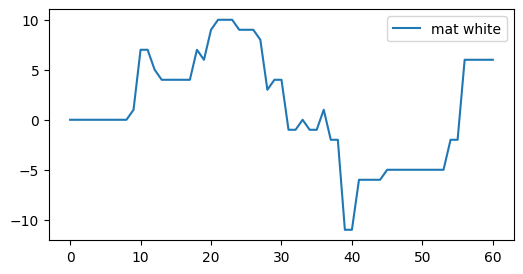

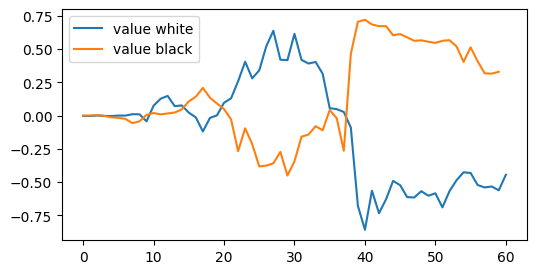

 -- 48460 -- winner: white, i: 51    wins: w = 6158.5, b = 5790.5, d = 18614
 -- 48470 -- winner: black, i: 74    wins: w = 6164.5, b = 5794.5, d = 18622
 -- 48480 -- winner: black, i: 54    wins: w = 6168.5, b = 5800.5, d = 18638
 -- 48490 -- winner: white, i: 13    wins: w = 6174.5, b = 5804.5, d = 18645
 -- 48500 -- winner: black, i: 96    wins: w = 6178.5, b = 5810.5, d = 18651


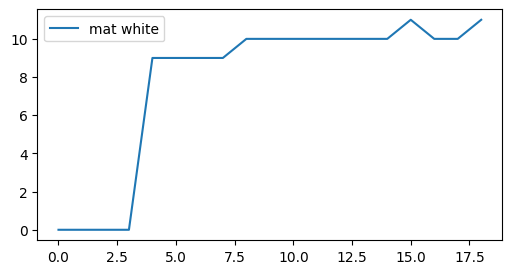

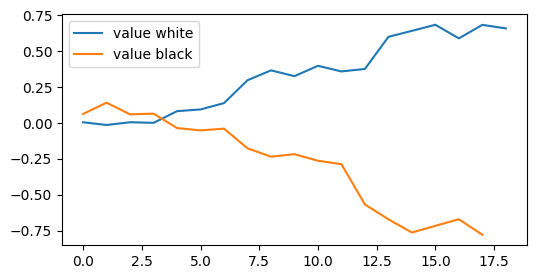

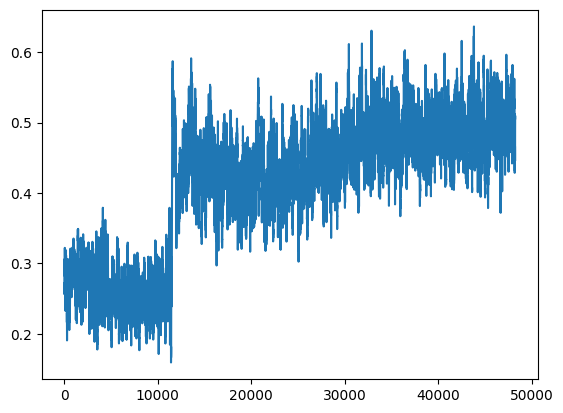

 -- 48510 -- winner: black, i: 58    wins: w = 6181.5, b = 5817.5, d = 18663
 -- 48520 -- winner: black, i: 152    wins: w = 6186.5, b = 5822.5, d = 18677
 -- 48530 -- winner: black, i: 64    wins: w = 6192.5, b = 5826.5, d = 18684
 -- 48540 -- winner: white, i: 89    wins: w = 6197.5, b = 5831.5, d = 18695
 -- 48550 -- winner: black, i: 82    wins: w = 6199.5, b = 5839.5, d = 18703


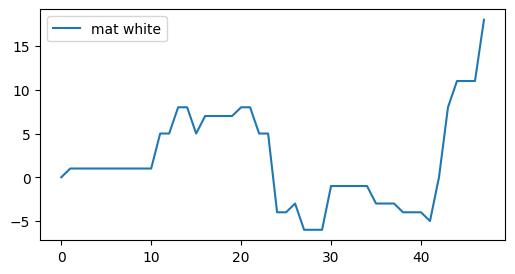

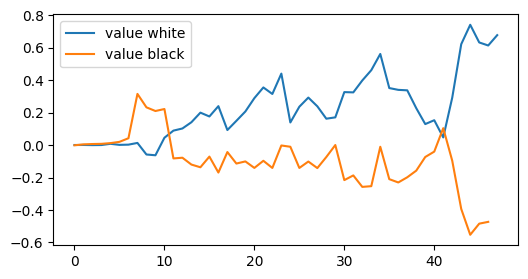

 -- 48560 -- winner: white, i: 105    wins: w = 6206.5, b = 5842.5, d = 18721
 -- 48570 -- winner: black, i: 140    wins: w = 6212.5, b = 5846.5, d = 18733
 -- 48580 -- winner: white, i: 71    wins: w = 6219.5, b = 5849.5, d = 18752
 -- 48590 -- winner: black, i: 82    wins: w = 6224.5, b = 5854.5, d = 18768
 -- 48600 -- winner: black, i: 124    wins: w = 6230.5, b = 5858.5, d = 18778


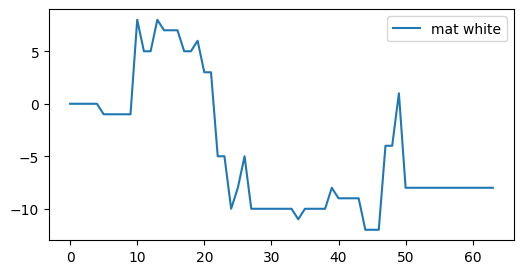

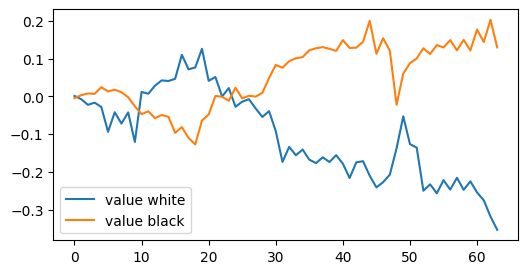

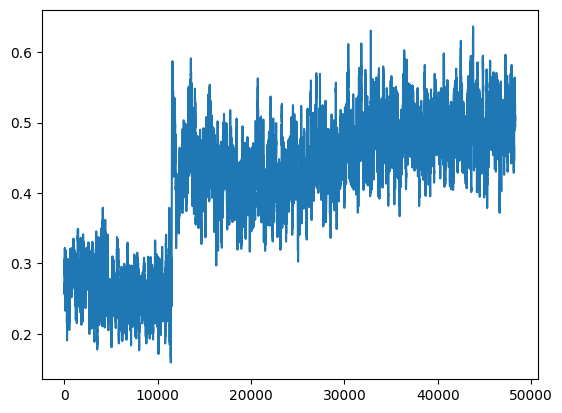

 -- 48610 -- winner: black, i: 6    wins: w = 6235.5, b = 5863.5, d = 18790
 -- 48620 -- winner: black, i: 88    wins: w = 6239.5, b = 5869.5, d = 18803
 -- 48630 -- winner: black, i: 110    wins: w = 6244.5, b = 5874.5, d = 18821
 -- 48640 -- winner: white, i: 69    wins: w = 6248.5, b = 5880.5, d = 18837
game termianted, mat diff =  23
 -- 48650 -- winner: black, i: 66    wins: w = 6254.0, b = 5884.5, d = 18854


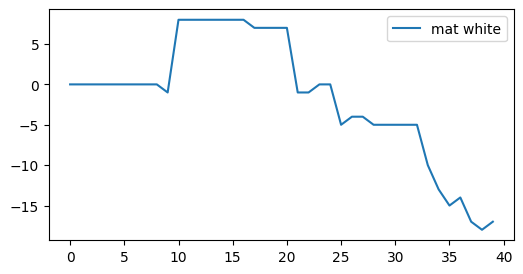

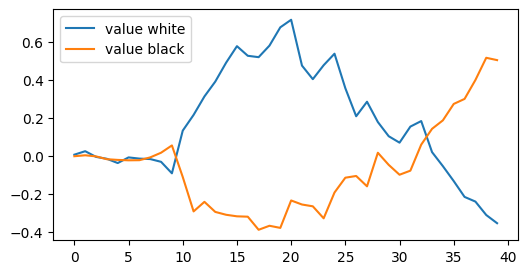

 -- 48660 -- winner: black, i: 102    wins: w = 6259.0, b = 5889.5, d = 18867
 -- 48670 -- winner: black, i: 124    wins: w = 6260.0, b = 5898.5, d = 18879
 -- 48680 -- winner: white, i: 25    wins: w = 6265.0, b = 5903.5, d = 18891
 -- 48690 -- winner: black, i: 48    wins: w = 6268.0, b = 5910.5, d = 18896
 -- 48700 -- winner: black, i: 72    wins: w = 6274.0, b = 5914.5, d = 18903


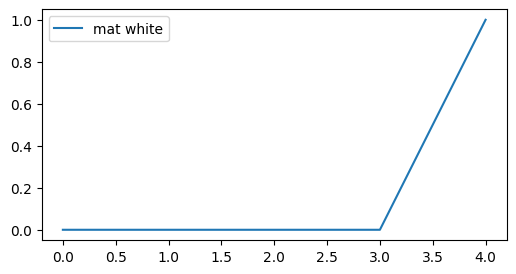

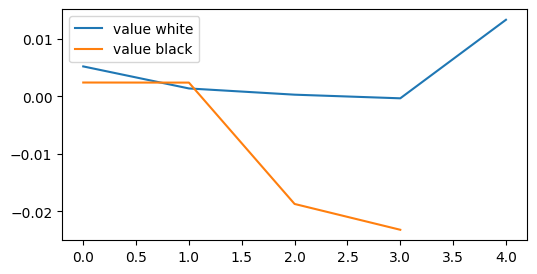

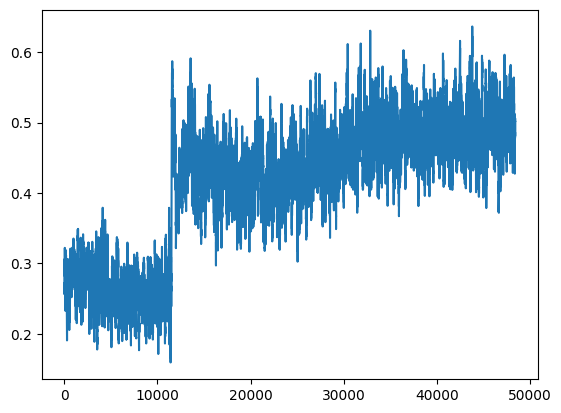

 -- 48710 -- winner: black, i: 74    wins: w = 6280.0, b = 5918.5, d = 18917
 -- 48720 -- winner: black, i: 100    wins: w = 6285.0, b = 5923.5, d = 18958
 -- 48730 -- winner: white, i: 117    wins: w = 6292.0, b = 5926.5, d = 18967
 -- 48740 -- winner: black, i: 82    wins: w = 6294.0, b = 5934.5, d = 18985
 -- 48750 -- winner: black, i: 112    wins: w = 6297.0, b = 5941.5, d = 19004


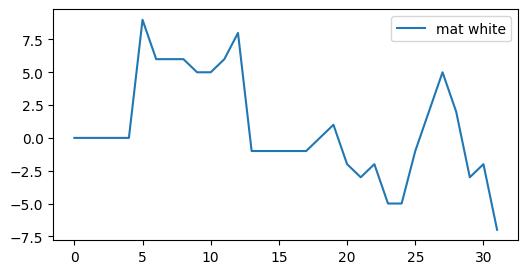

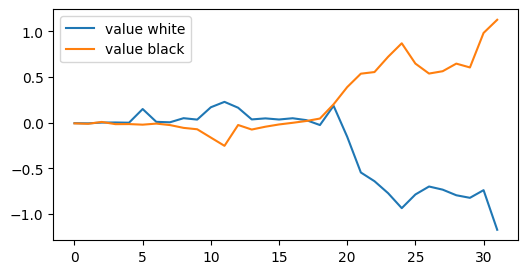

 -- 48760 -- winner: white, i: 19    wins: w = 6302.0, b = 5946.5, d = 19011
 -- 48770 -- winner: black, i: 50    wins: w = 6308.0, b = 5950.5, d = 19028
 -- 48780 -- winner: black, i: 94    wins: w = 6313.0, b = 5955.5, d = 19046
 -- 48790 -- winner: white, i: 109    wins: w = 6319.0, b = 5959.5, d = 19065
 -- 48800 -- winner: black, i: 18    wins: w = 6323.0, b = 5965.5, d = 19074


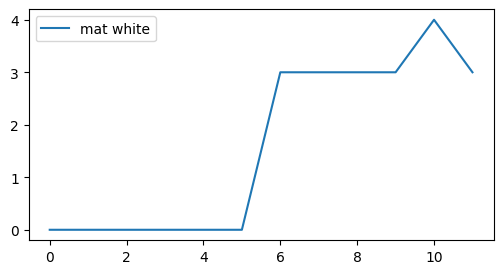

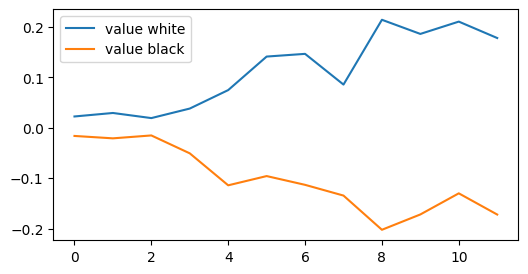

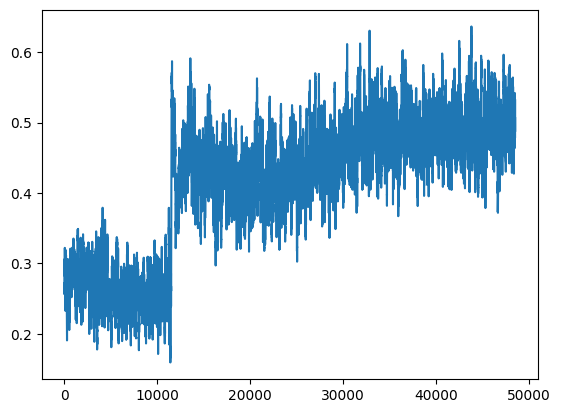

 -- 48810 -- winner: white, i: 101    wins: w = 6327.0, b = 5971.5, d = 19078
 -- 48820 -- winner: white, i: 71    wins: w = 6333.0, b = 5975.5, d = 19092
 -- 48830 -- winner: black, i: 78    wins: w = 6335.0, b = 5983.5, d = 19100
 -- 48840 -- winner: black, i: 24    wins: w = 6341.0, b = 5987.5, d = 19117
 -- 48850 -- winner: black, i: 24    wins: w = 6347.0, b = 5991.5, d = 19133


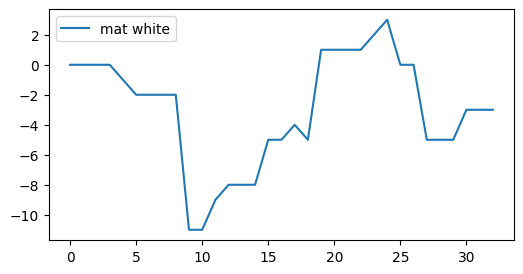

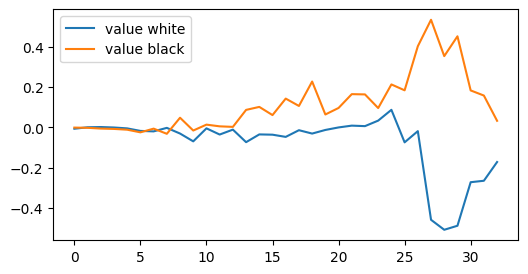

 -- 48860 -- winner: white, i: 101    wins: w = 6350.0, b = 5998.5, d = 19149
 -- 48870 -- winner: white, i: 105    wins: w = 6355.0, b = 6003.5, d = 19172
 -- 48880 -- winner: white, i: 105    wins: w = 6358.0, b = 6010.5, d = 19187
 -- 48890 -- winner: black, i: 58    wins: w = 6364.0, b = 6014.5, d = 19198
 -- 48900 -- winner: white, i: 13    wins: w = 6367.0, b = 6021.5, d = 19221


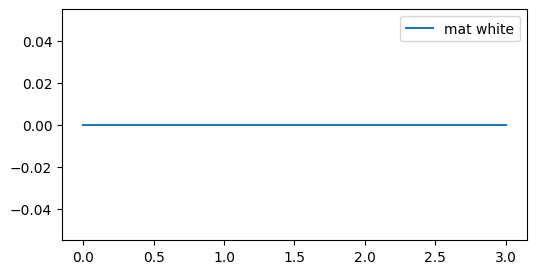

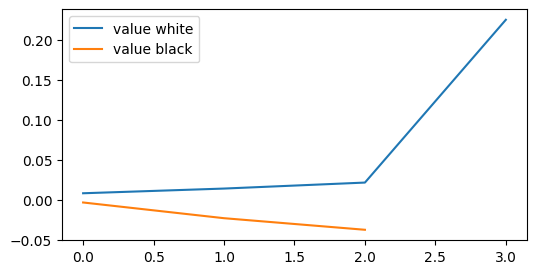

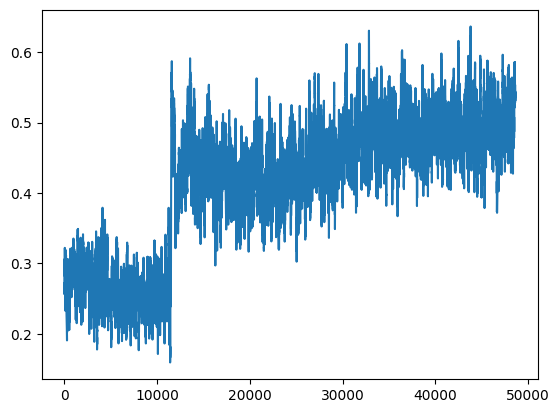

 -- 48910 -- winner: black, i: 80    wins: w = 6372.0, b = 6026.5, d = 19229
 -- 48920 -- winner: white, i: 29    wins: w = 6378.0, b = 6030.5, d = 19237
 -- 48930 -- winner: black, i: 36    wins: w = 6381.0, b = 6037.5, d = 19243
 -- 48940 -- winner: white, i: 169    wins: w = 6385.0, b = 6043.5, d = 19256
 -- 48950 -- winner: black, i: 84    wins: w = 6388.0, b = 6050.5, d = 19263


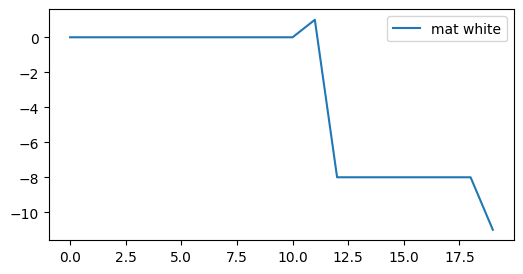

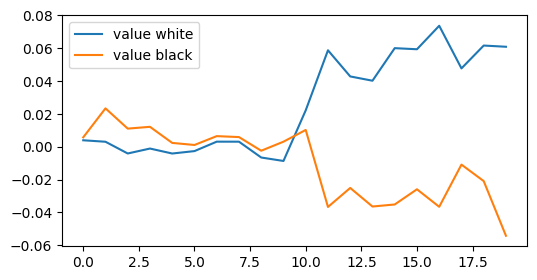

 -- 48960 -- winner: white, i: 121    wins: w = 6392.0, b = 6056.5, d = 19283
 -- 48970 -- winner: white, i: 93    wins: w = 6397.0, b = 6061.5, d = 19299
 -- 48980 -- winner: white, i: 35    wins: w = 6405.0, b = 6063.5, d = 19308
 -- 48990 -- winner: black, i: 72    wins: w = 6409.0, b = 6069.5, d = 19327
 -- 49000 -- winner: black, i: 104    wins: w = 6414.0, b = 6074.5, d = 19336


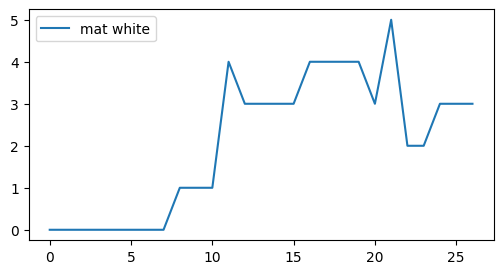

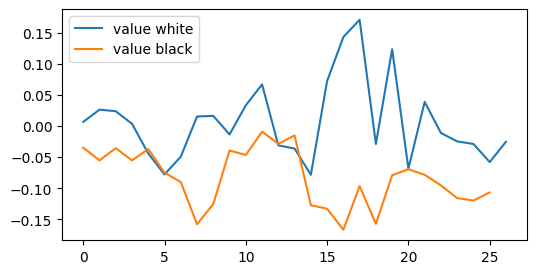

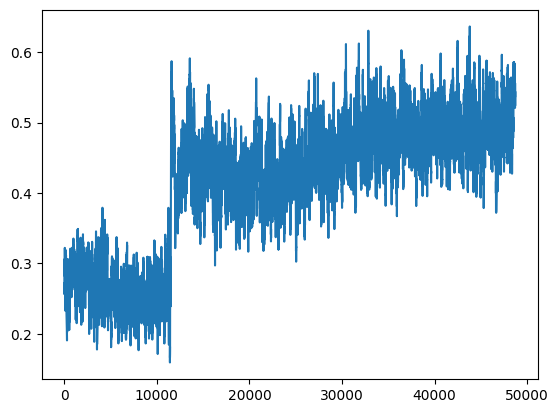

 -- 49010 -- winner: white, i: 33    wins: w = 6419.0, b = 6079.5, d = 19349
 -- 49020 -- winner: white, i: 5    wins: w = 6425.0, b = 6083.5, d = 19359
 -- 49030 -- winner: black, i: 8    wins: w = 6431.0, b = 6087.5, d = 19385
 -- 49040 -- winner: black, i: 102    wins: w = 6435.0, b = 6093.5, d = 19407
 -- 49050 -- winner: white, i: 93    wins: w = 6441.0, b = 6097.5, d = 19425


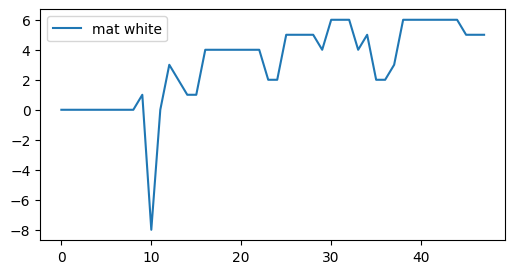

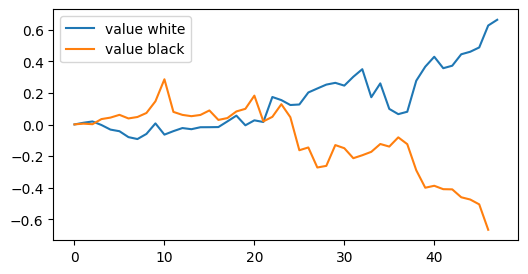

 -- 49060 -- winner: white, i: 91    wins: w = 6447.0, b = 6101.5, d = 19446
 -- 49070 -- winner: black, i: 12    wins: w = 6451.0, b = 6107.5, d = 19458
 -- 49080 -- winner: black, i: 44    wins: w = 6456.0, b = 6112.5, d = 19476
 -- 49090 -- winner: black, i: 104    wins: w = 6460.0, b = 6118.5, d = 19496
 -- 49100 -- winner: white, i: 31    wins: w = 6469.0, b = 6119.5, d = 19503


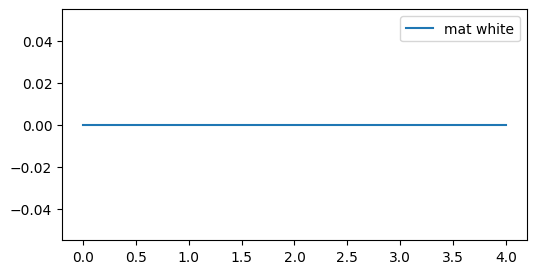

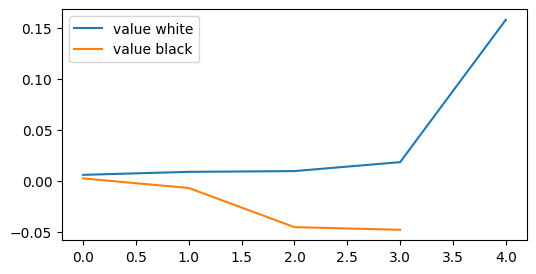

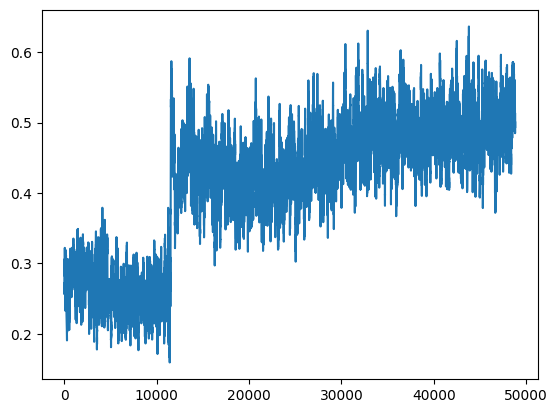

 -- 49110 -- winner: white, i: 107    wins: w = 6473.0, b = 6125.5, d = 19516
 -- 49120 -- winner: white, i: 87    wins: w = 6479.0, b = 6129.5, d = 19532
 -- 49130 -- winner: white, i: 53    wins: w = 6485.0, b = 6133.5, d = 19548
 -- 49140 -- winner: black, i: 110    wins: w = 6488.0, b = 6140.5, d = 19558
 -- 49150 -- winner: black, i: 122    wins: w = 6491.0, b = 6147.5, d = 19587


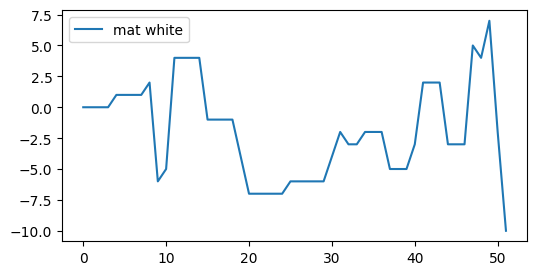

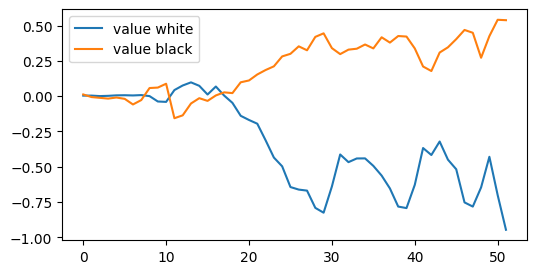

 -- 49160 -- winner: white, i: 41    wins: w = 6496.0, b = 6152.5, d = 19599
 -- 49170 -- winner: white, i: 73    wins: w = 6499.0, b = 6159.5, d = 19614
 -- 49180 -- winner: black, i: 54    wins: w = 6505.0, b = 6163.5, d = 19627
 -- 49190 -- winner: white, i: 11    wins: w = 6511.0, b = 6167.5, d = 19638
 -- 49200 -- winner: white, i: 65    wins: w = 6519.0, b = 6169.5, d = 19652


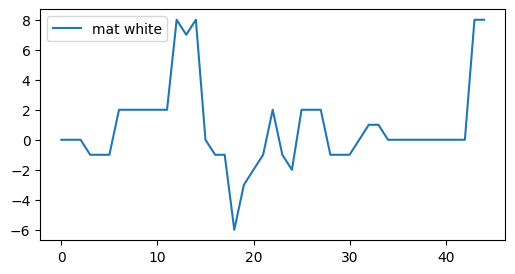

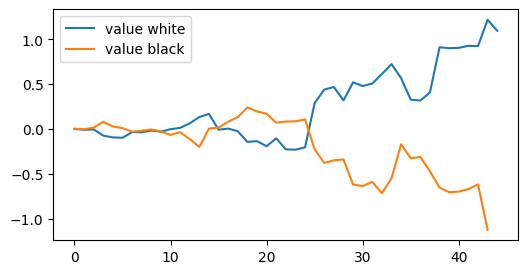

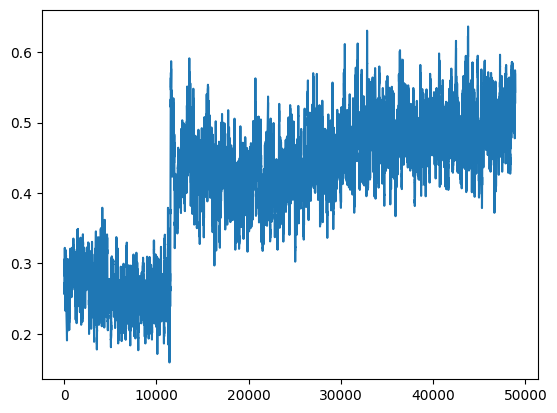

 -- 49210 -- winner: black, i: 80    wins: w = 6524.0, b = 6174.5, d = 19668
 -- 49220 -- winner: white, i: 97    wins: w = 6531.0, b = 6177.5, d = 19673
 -- 49230 -- winner: white, i: 7    wins: w = 6537.0, b = 6181.5, d = 19684
 -- 49240 -- winner: black, i: 84    wins: w = 6539.0, b = 6189.5, d = 19700
 -- 49250 -- winner: white, i: 113    wins: w = 6545.0, b = 6193.5, d = 19728


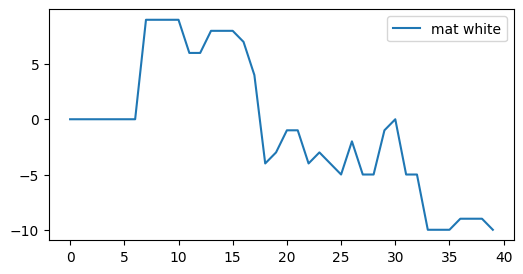

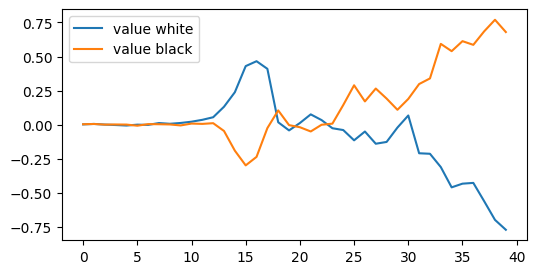

 -- 49260 -- winner: black, i: 94    wins: w = 6551.0, b = 6197.5, d = 19744
 -- 49270 -- winner: black, i: 104    wins: w = 6554.0, b = 6204.5, d = 19750
 -- 49280 -- winner: white, i: 97    wins: w = 6562.0, b = 6206.5, d = 19764
 -- 49290 -- winner: white, i: 31    wins: w = 6566.0, b = 6212.5, d = 19787
 -- 49300 -- winner: black, i: 90    wins: w = 6569.0, b = 6219.5, d = 19806


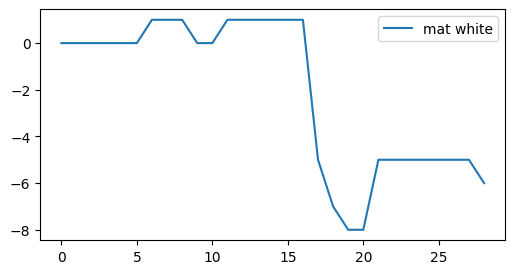

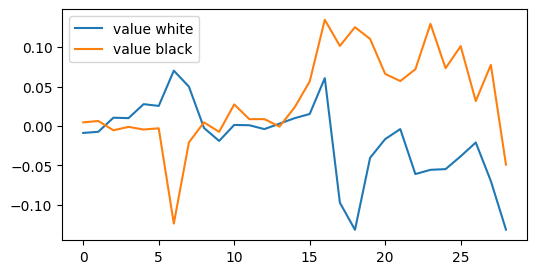

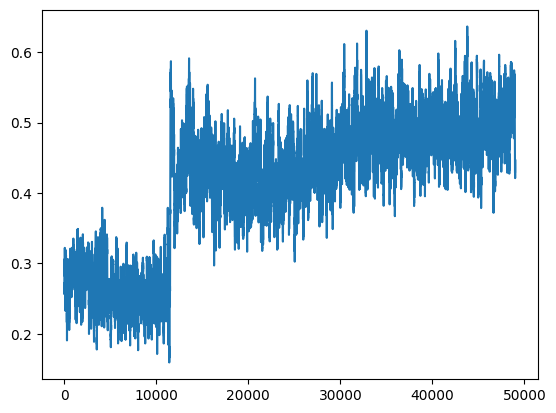

 -- 49310 -- winner: white, i: 113    wins: w = 6572.0, b = 6226.5, d = 19817
 -- 49320 -- winner: black, i: 20    wins: w = 6577.0, b = 6231.5, d = 19834
 -- 49330 -- winner: white, i: 91    wins: w = 6583.0, b = 6235.5, d = 19850
 -- 49340 -- winner: white, i: 67    wins: w = 6590.0, b = 6238.5, d = 19864
 -- 49350 -- winner: white, i: 21    wins: w = 6592.0, b = 6246.5, d = 19872


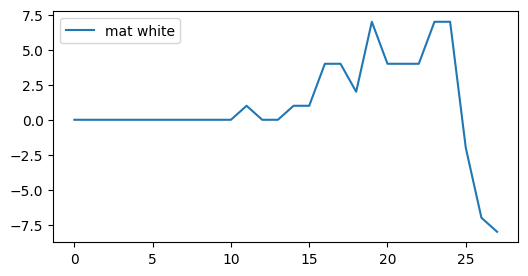

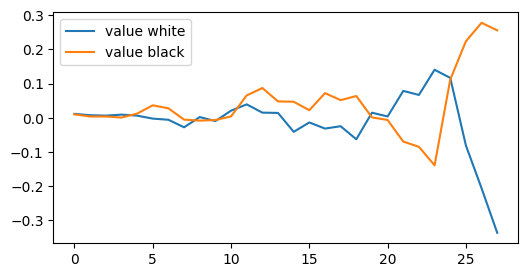

 -- 49360 -- winner: black, i: 102    wins: w = 6597.0, b = 6251.5, d = 19885
 -- 49370 -- winner: white, i: 161    wins: w = 6603.0, b = 6255.5, d = 19904
 -- 49380 -- winner: white, i: 85    wins: w = 6610.0, b = 6258.5, d = 19921
 -- 49390 -- winner: black, i: 36    wins: w = 6613.0, b = 6265.5, d = 19931
 -- 49400 -- winner: white, i: 85    wins: w = 6618.0, b = 6270.5, d = 19952


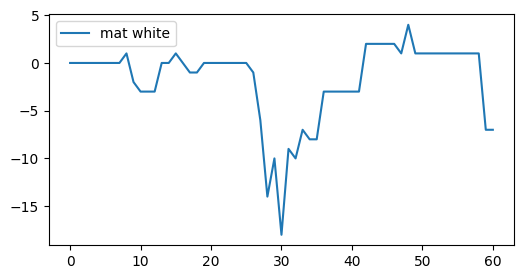

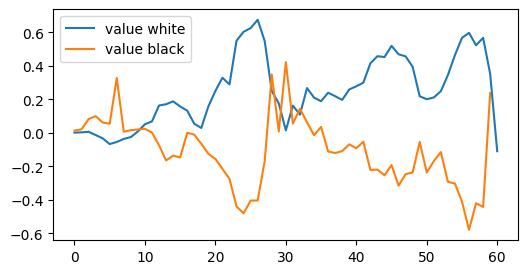

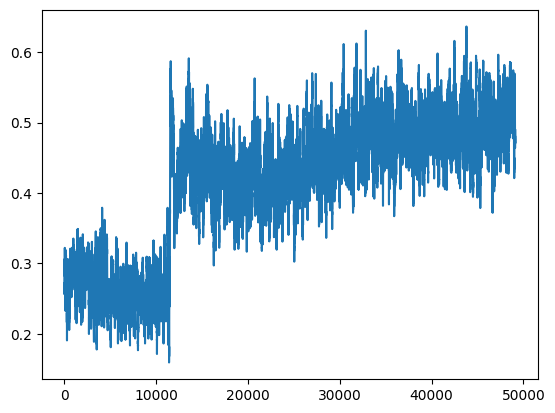

 -- 49410 -- winner: white, i: 49    wins: w = 6624.0, b = 6274.5, d = 19958
 -- 49420 -- winner: black, i: 130    wins: w = 6628.0, b = 6280.5, d = 19968
 -- 49430 -- winner: black, i: 80    wins: w = 6632.0, b = 6286.5, d = 19990
 -- 49440 -- winner: black, i: 90    wins: w = 6637.0, b = 6291.5, d = 19999
 -- 49450 -- winner: black, i: 12    wins: w = 6642.0, b = 6296.5, d = 20018


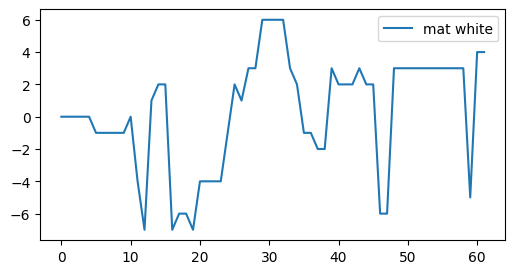

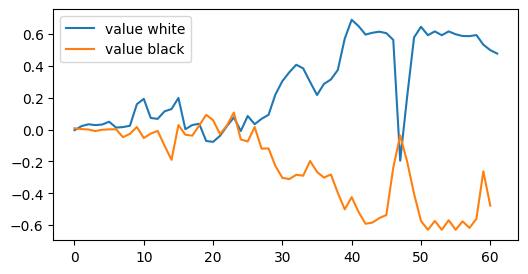

 -- 49460 -- winner: white, i: 21    wins: w = 6648.0, b = 6300.5, d = 20036
 -- 49470 -- winner: black, i: 50    wins: w = 6655.0, b = 6303.5, d = 20055
 -- 49480 -- winner: black, i: 94    wins: w = 6662.0, b = 6306.5, d = 20071
 -- 49490 -- winner: white, i: 41    wins: w = 6668.0, b = 6310.5, d = 20084
 -- 49500 -- winner: white, i: 115    wins: w = 6674.0, b = 6314.5, d = 20091


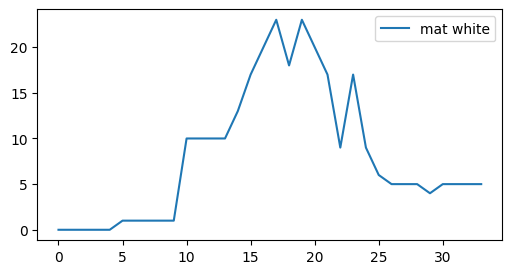

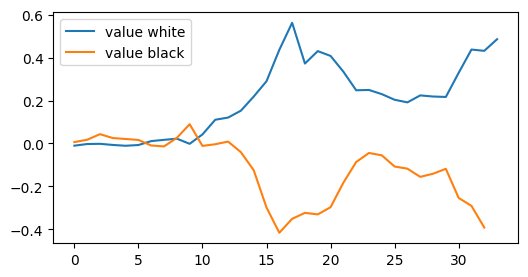

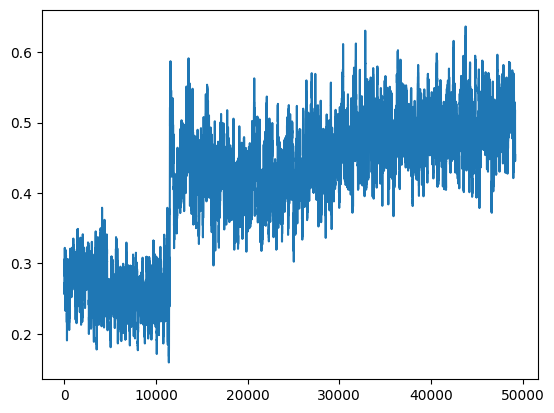

 -- 49510 -- winner: white, i: 67    wins: w = 6676.0, b = 6322.5, d = 20108
 -- 49520 -- winner: black, i: 78    wins: w = 6684.0, b = 6324.5, d = 20119
 -- 49530 -- winner: black, i: 72    wins: w = 6688.0, b = 6330.5, d = 20129
 -- 49540 -- winner: white, i: 67    wins: w = 6696.0, b = 6332.5, d = 20137
 -- 49550 -- winner: white, i: 81    wins: w = 6700.0, b = 6338.5, d = 20153


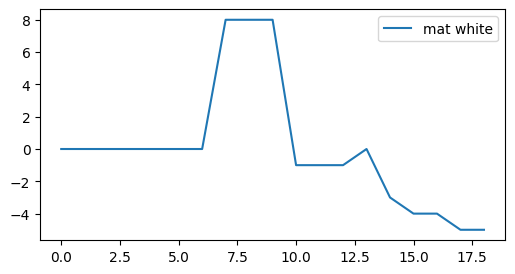

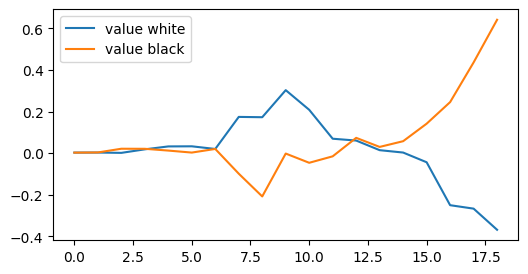

 -- 49560 -- winner: white, i: 41    wins: w = 6706.0, b = 6342.5, d = 20171
 -- 49570 -- winner: black, i: 52    wins: w = 6713.0, b = 6345.5, d = 20188
 -- 49580 -- winner: white, i: 109    wins: w = 6719.0, b = 6349.5, d = 20201
 -- 49590 -- winner: white, i: 119    wins: w = 6727.0, b = 6351.5, d = 20236
 -- 49600 -- winner: black, i: 56    wins: w = 6734.0, b = 6354.5, d = 20242


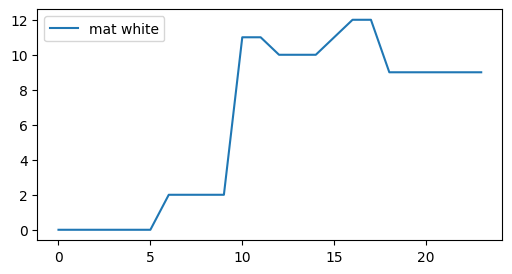

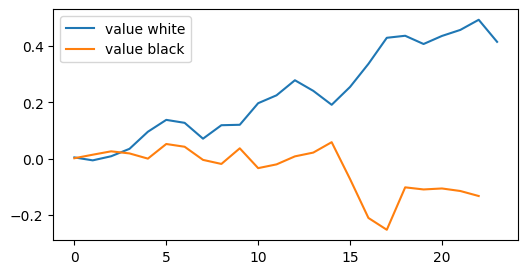

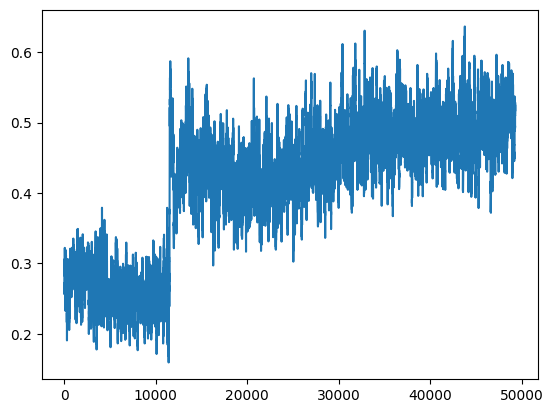

 -- 49610 -- winner: black, i: 34    wins: w = 6737.0, b = 6361.5, d = 20255
 -- 49620 -- winner: white, i: 45    wins: w = 6744.0, b = 6364.5, d = 20265
 -- 49630 -- winner: black, i: 74    wins: w = 6750.0, b = 6368.5, d = 20277
 -- 49640 -- winner: white, i: 55    wins: w = 6755.0, b = 6373.5, d = 20293
 -- 49650 -- winner: black, i: 94    wins: w = 6760.0, b = 6378.5, d = 20317


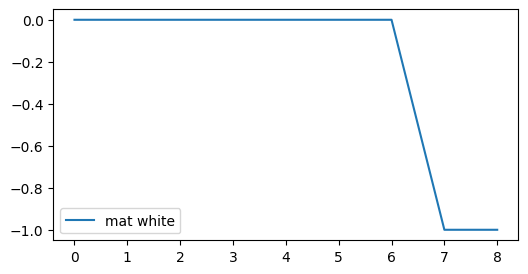

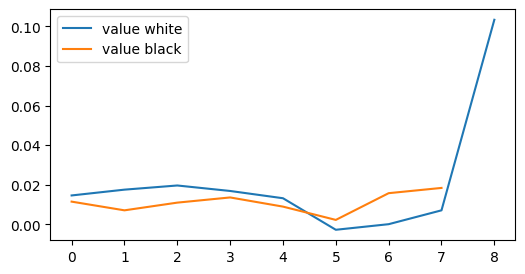

 -- 49660 -- winner: white, i: 101    wins: w = 6767.0, b = 6381.5, d = 20336
 -- 49670 -- winner: black, i: 114    wins: w = 6770.0, b = 6388.5, d = 20361
 -- 49680 -- winner: white, i: 37    wins: w = 6776.0, b = 6392.5, d = 20369
 -- 49690 -- winner: black, i: 76    wins: w = 6779.0, b = 6399.5, d = 20380
 -- 49700 -- winner: white, i: 109    wins: w = 6783.0, b = 6405.5, d = 20384


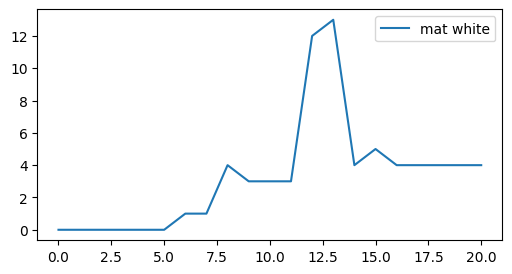

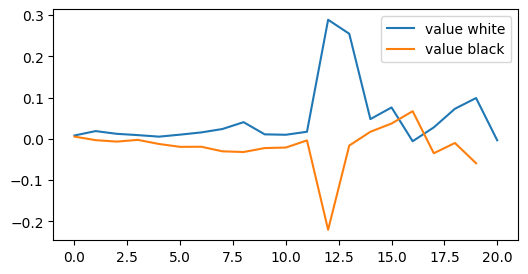

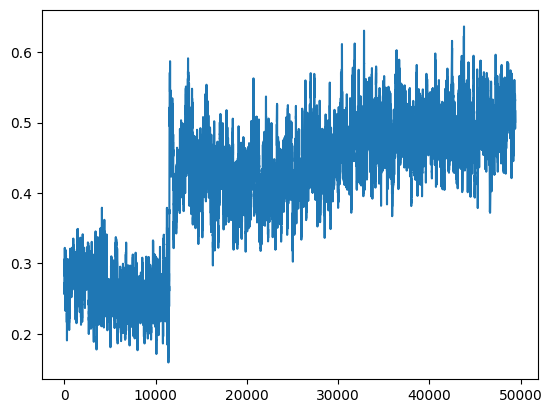

 -- 49710 -- winner: white, i: 95    wins: w = 6790.0, b = 6408.5, d = 20401
game termianted, mat diff =  -26
 -- 49720 -- winner: black, i: 1001    wins: w = 6794.0, b = 6414.0, d = 20412
 -- 49730 -- winner: white, i: 11    wins: w = 6798.0, b = 6420.0, d = 20429
 -- 49740 -- winner: black, i: 176    wins: w = 6802.0, b = 6426.0, d = 20444
 -- 49750 -- winner: black, i: 54    wins: w = 6806.0, b = 6432.0, d = 20464


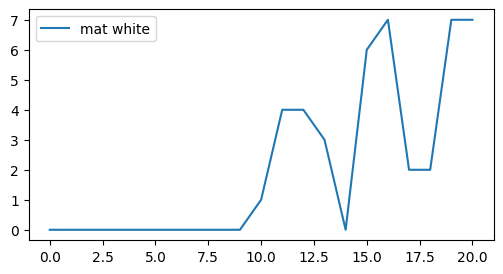

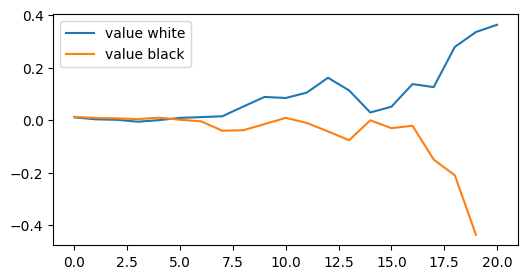

 -- 49760 -- winner: white, i: 55    wins: w = 6811.0, b = 6437.0, d = 20471
 -- 49770 -- winner: black, i: 54    wins: w = 6814.0, b = 6444.0, d = 20492
 -- 49780 -- winner: white, i: 11    wins: w = 6820.0, b = 6448.0, d = 20513
 -- 49790 -- winner: white, i: 33    wins: w = 6827.0, b = 6451.0, d = 20526
 -- 49800 -- winner: black, i: 28    wins: w = 6834.0, b = 6454.0, d = 20536


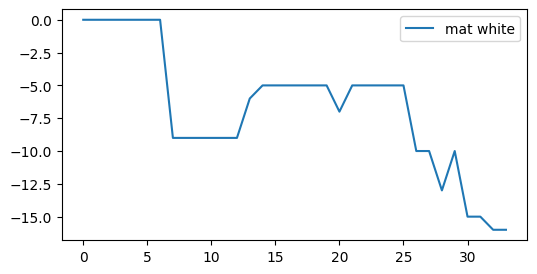

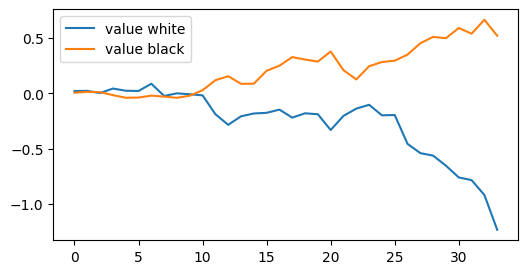

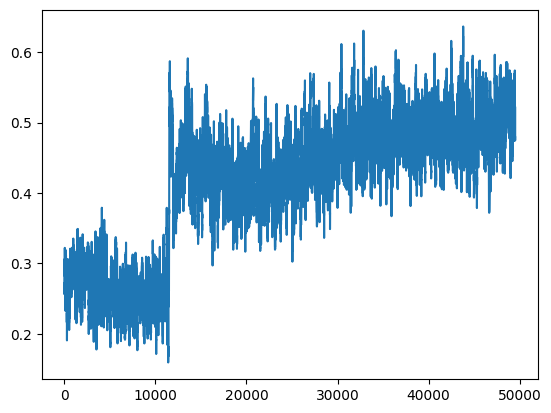

 -- 49810 -- winner: white, i: 67    wins: w = 6837.0, b = 6461.0, d = 20553
 -- 49820 -- winner: black, i: 38    wins: w = 6839.0, b = 6469.0, d = 20568
 -- 49830 -- winner: black, i: 48    wins: w = 6842.0, b = 6476.0, d = 20578
 -- 49840 -- winner: white, i: 17    wins: w = 6846.0, b = 6482.0, d = 20589
 -- 49850 -- winner: black, i: 10    wins: w = 6852.0, b = 6486.0, d = 20601


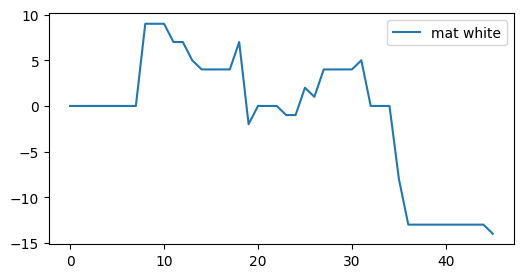

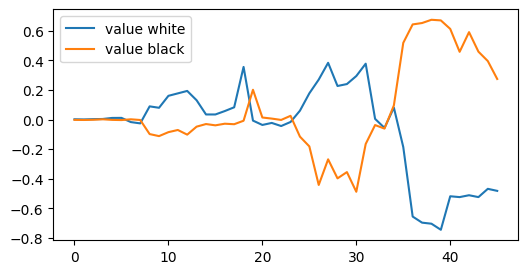

 -- 49860 -- winner: black, i: 26    wins: w = 6857.0, b = 6491.0, d = 20612
 -- 49870 -- winner: white, i: 5    wins: w = 6861.0, b = 6497.0, d = 20621
 -- 49880 -- winner: black, i: 100    wins: w = 6866.0, b = 6502.0, d = 20628
 -- 49890 -- winner: white, i: 73    wins: w = 6870.0, b = 6508.0, d = 20639
 -- 49900 -- winner: black, i: 54    wins: w = 6874.0, b = 6514.0, d = 20651


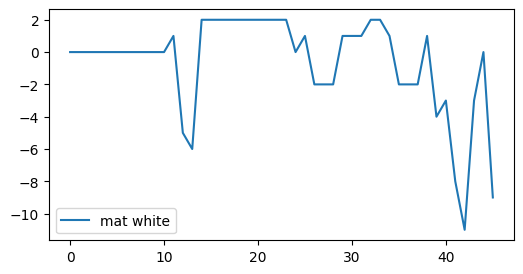

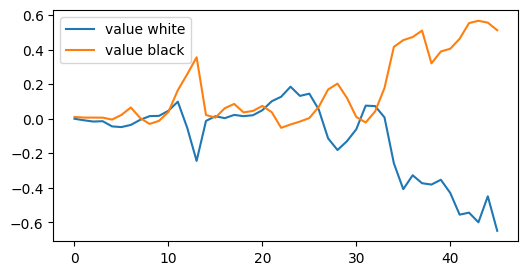

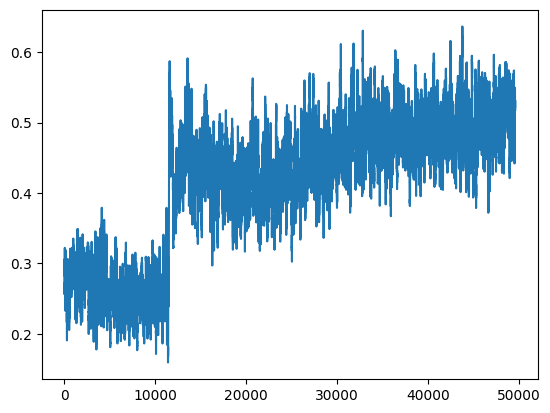

 -- 49910 -- winner: black, i: 94    wins: w = 6879.0, b = 6519.0, d = 20670
 -- 49920 -- winner: black, i: 62    wins: w = 6883.0, b = 6525.0, d = 20688
 -- 49930 -- winner: black, i: 44    wins: w = 6886.0, b = 6532.0, d = 20705
 -- 49940 -- winner: black, i: 82    wins: w = 6892.0, b = 6536.0, d = 20733
 -- 49950 -- winner: black, i: 16    wins: w = 6895.0, b = 6543.0, d = 20747


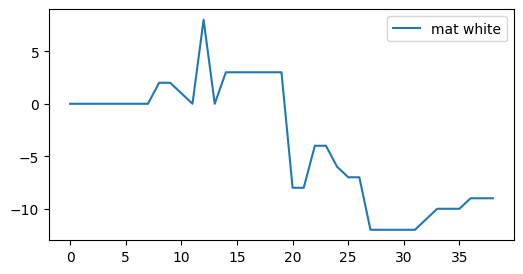

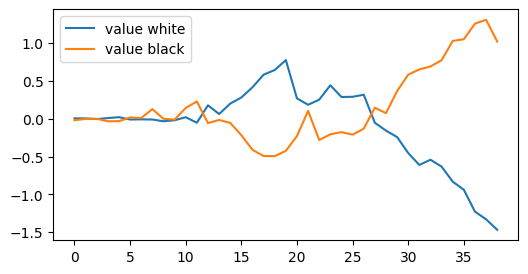

 -- 49960 -- winner: black, i: 114    wins: w = 6899.0, b = 6549.0, d = 20772
 -- 49970 -- winner: white, i: 103    wins: w = 6903.0, b = 6555.0, d = 20797
 -- 49980 -- winner: black, i: 88    wins: w = 6908.0, b = 6560.0, d = 20826
 -- 49990 -- winner: white, i: 117    wins: w = 6911.0, b = 6567.0, d = 20834
 -- 50000 -- winner: black, i: 96    wins: w = 6915.0, b = 6573.0, d = 20853


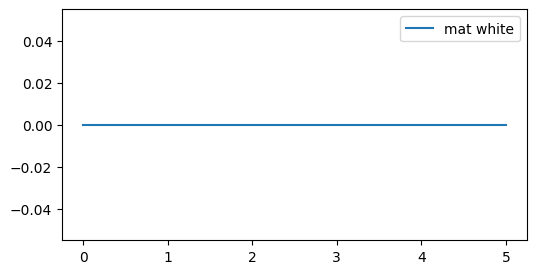

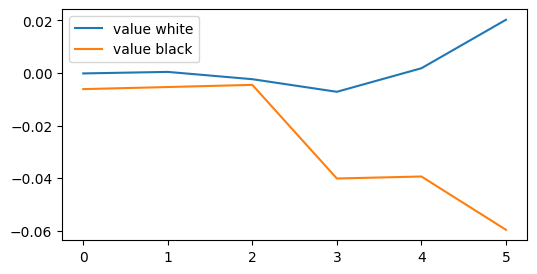

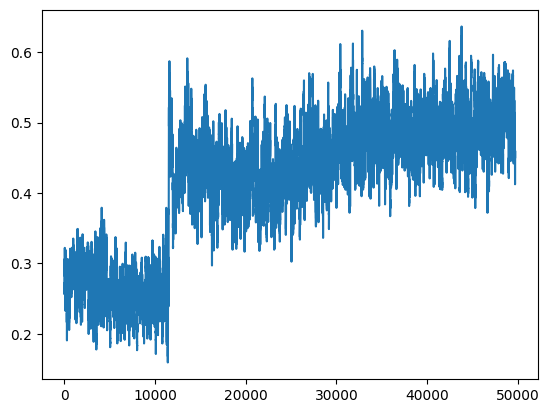

 -- 50010 -- winner: black, i: 36    wins: w = 6918.0, b = 6580.0, d = 20857
 -- 50020 -- winner: white, i: 109    wins: w = 6922.0, b = 6586.0, d = 20870
 -- 50030 -- winner: black, i: 100    wins: w = 6925.0, b = 6593.0, d = 20889
 -- 50040 -- winner: white, i: 65    wins: w = 6932.0, b = 6596.0, d = 20897
 -- 50050 -- winner: white, i: 27    wins: w = 6937.0, b = 6601.0, d = 20907


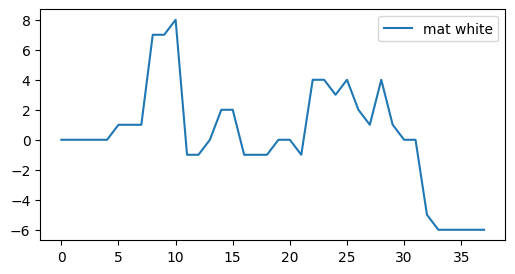

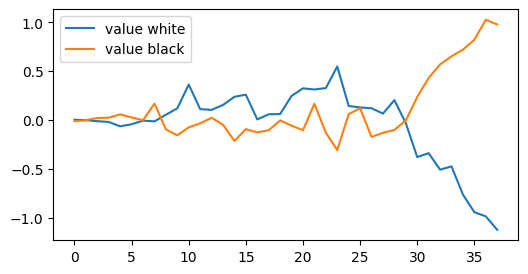

 -- 50060 -- winner: white, i: 19    wins: w = 6940.0, b = 6608.0, d = 20927
 -- 50070 -- winner: black, i: 90    wins: w = 6944.0, b = 6614.0, d = 20933
 -- 50080 -- winner: white, i: 15    wins: w = 6949.0, b = 6619.0, d = 20941
 -- 50090 -- winner: white, i: 89    wins: w = 6955.0, b = 6623.0, d = 20950
 -- 50100 -- winner: black, i: 40    wins: w = 6961.0, b = 6627.0, d = 20966


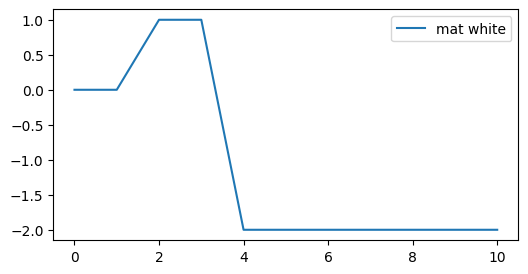

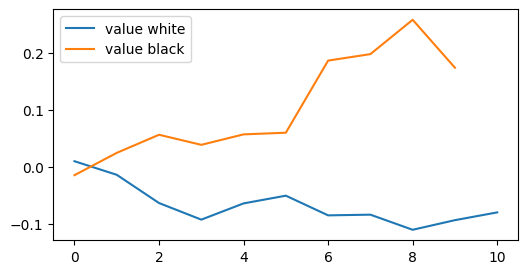

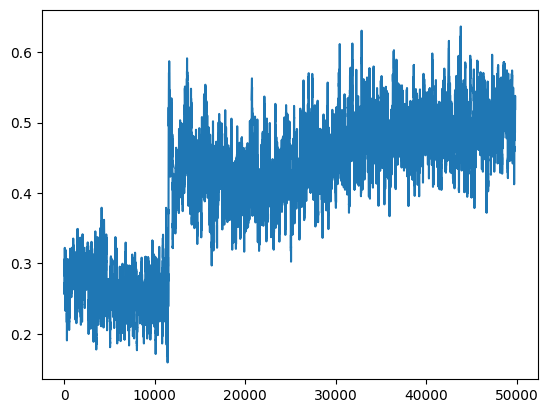

 -- 50110 -- winner: white, i: 25    wins: w = 6967.0, b = 6631.0, d = 20970
 -- 50120 -- winner: white, i: 59    wins: w = 6972.0, b = 6636.0, d = 20976
 -- 50130 -- winner: black, i: 76    wins: w = 6978.0, b = 6640.0, d = 21009
 -- 50140 -- winner: white, i: 99    wins: w = 6981.0, b = 6647.0, d = 21025
 -- 50150 -- winner: white, i: 91    wins: w = 6984.0, b = 6654.0, d = 21043


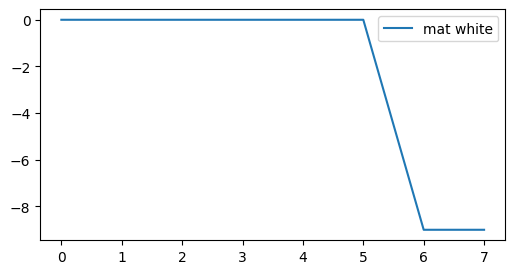

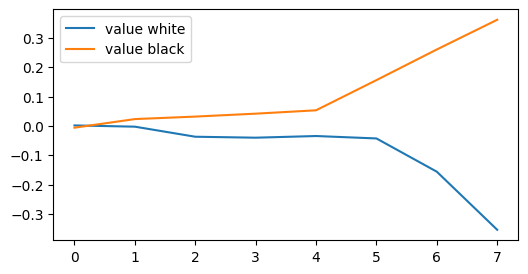

 -- 50160 -- winner: black, i: 106    wins: w = 6991.0, b = 6657.0, d = 21055
 -- 50170 -- winner: white, i: 93    wins: w = 6999.0, b = 6659.0, d = 21069
 -- 50180 -- winner: white, i: 93    wins: w = 7002.0, b = 6666.0, d = 21085
 -- 50190 -- winner: white, i: 143    wins: w = 7006.0, b = 6672.0, d = 21099
 -- 50200 -- winner: white, i: 55    wins: w = 7009.0, b = 6679.0, d = 21118


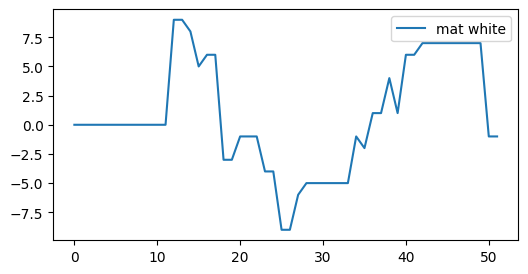

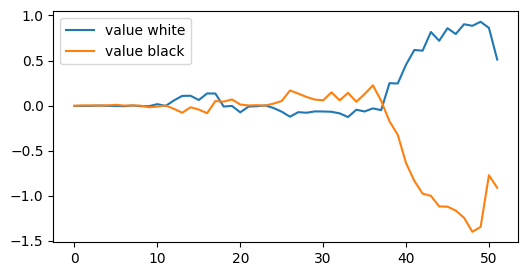

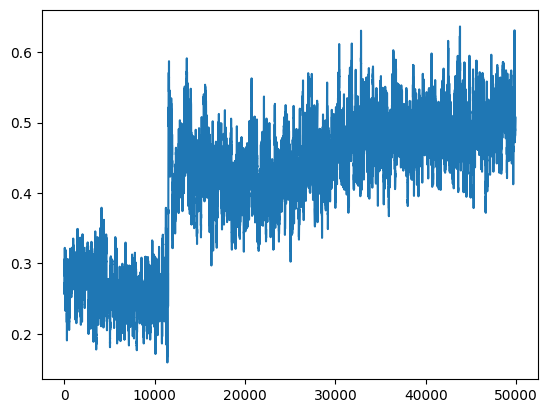

 -- 50210 -- winner: black, i: 14    wins: w = 7014.0, b = 6684.0, d = 21145
 -- 50220 -- winner: black, i: 34    wins: w = 7018.0, b = 6690.0, d = 21161
 -- 50230 -- winner: white, i: 13    wins: w = 7024.0, b = 6694.0, d = 21178
 -- 50240 -- winner: white, i: 77    wins: w = 7030.0, b = 6698.0, d = 21203
 -- 50250 -- winner: white, i: 31    wins: w = 7036.0, b = 6702.0, d = 21235


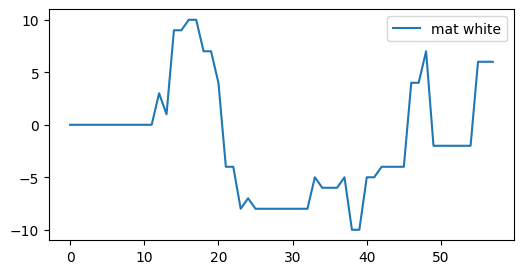

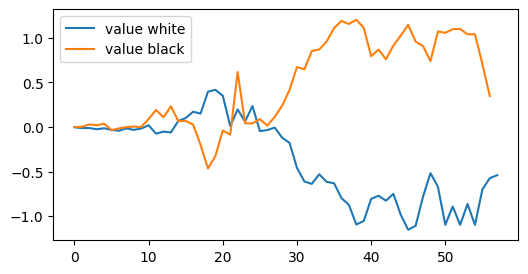

 -- 50260 -- winner: black, i: 58    wins: w = 7038.0, b = 6710.0, d = 21250
 -- 50270 -- winner: black, i: 106    wins: w = 7041.0, b = 6717.0, d = 21264
 -- 50280 -- winner: white, i: 49    wins: w = 7048.0, b = 6720.0, d = 21279
 -- 50290 -- winner: black, i: 220    wins: w = 7055.0, b = 6723.0, d = 21286
 -- 50300 -- winner: white, i: 95    wins: w = 7061.0, b = 6727.0, d = 21299


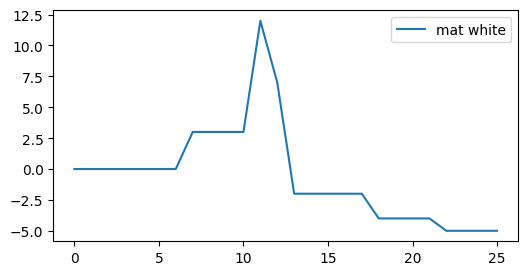

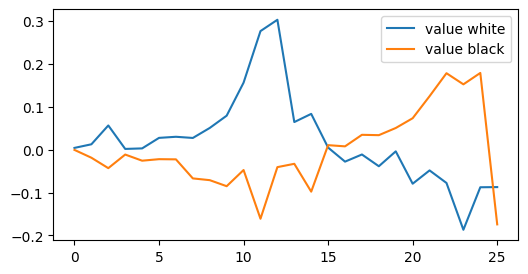

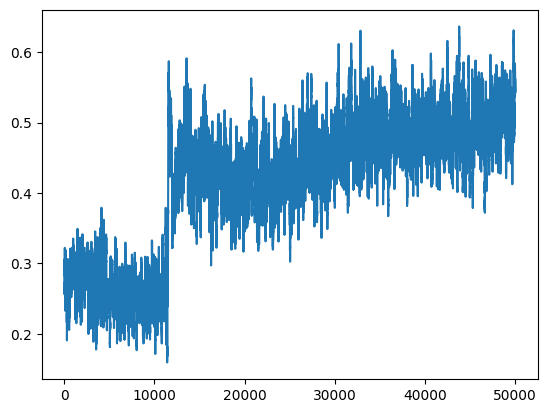

 -- 50310 -- winner: black, i: 124    wins: w = 7066.0, b = 6732.0, d = 21322
 -- 50320 -- winner: white, i: 9    wins: w = 7072.0, b = 6736.0, d = 21334
 -- 50330 -- winner: white, i: 39    wins: w = 7079.0, b = 6739.0, d = 21354
 -- 50340 -- winner: black, i: 14    wins: w = 7083.0, b = 6745.0, d = 21370
 -- 50350 -- winner: black, i: 108    wins: w = 7087.0, b = 6751.0, d = 21377


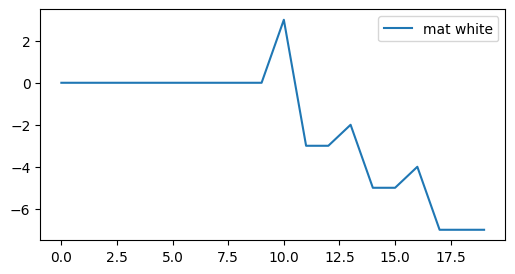

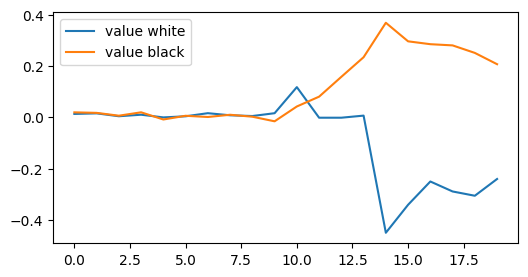

 -- 50360 -- winner: black, i: 50    wins: w = 7091.0, b = 6757.0, d = 21403
 -- 50370 -- winner: white, i: 119    wins: w = 7096.0, b = 6762.0, d = 21416
 -- 50380 -- winner: white, i: 57    wins: w = 7101.0, b = 6767.0, d = 21442
 -- 50390 -- winner: black, i: 104    wins: w = 7104.0, b = 6774.0, d = 21464
game termianted, mat diff =  6
 -- 50400 -- winner: white, i: 57    wins: w = 7108.5, b = 6779.0, d = 21477


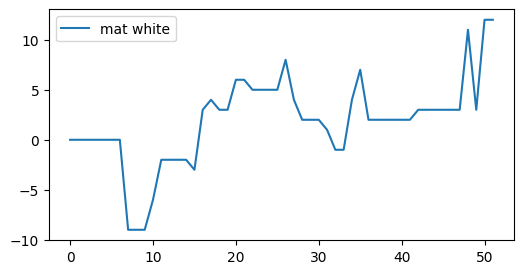

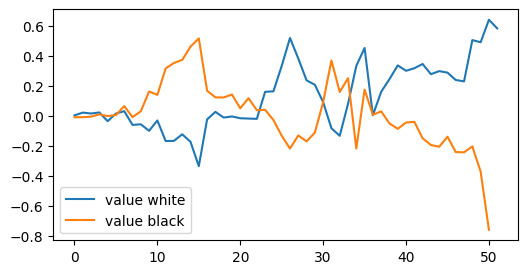

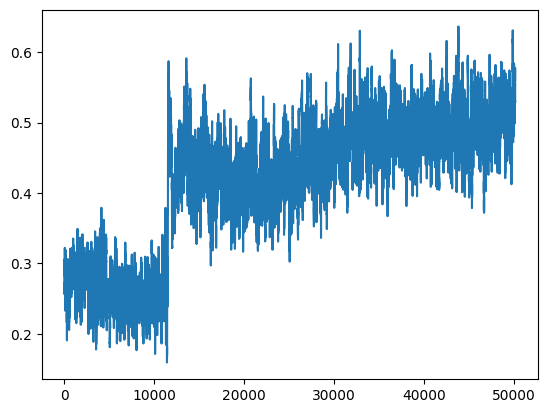

 -- 50410 -- winner: black, i: 102    wins: w = 7113.5, b = 6784.0, d = 21500
 -- 50420 -- winner: black, i: 82    wins: w = 7114.5, b = 6793.0, d = 21516
 -- 50430 -- winner: white, i: 83    wins: w = 7122.5, b = 6795.0, d = 21527
 -- 50440 -- winner: black, i: 66    wins: w = 7126.5, b = 6801.0, d = 21549
 -- 50450 -- winner: white, i: 85    wins: w = 7129.5, b = 6808.0, d = 21562


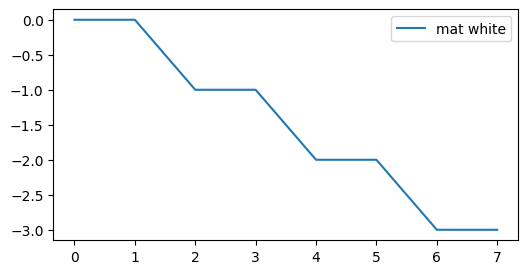

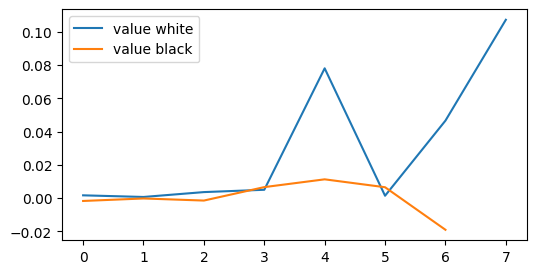

 -- 50460 -- winner: white, i: 33    wins: w = 7137.5, b = 6810.0, d = 21578
 -- 50470 -- winner: white, i: 7    wins: w = 7144.5, b = 6813.0, d = 21588
 -- 50480 -- winner: white, i: 129    wins: w = 7148.5, b = 6819.0, d = 21617
 -- 50490 -- winner: white, i: 63    wins: w = 7155.5, b = 6822.0, d = 21623
 -- 50500 -- winner: black, i: 60    wins: w = 7157.5, b = 6830.0, d = 21649


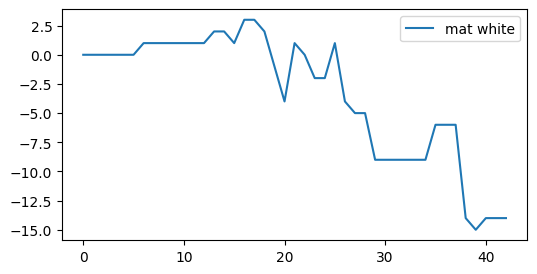

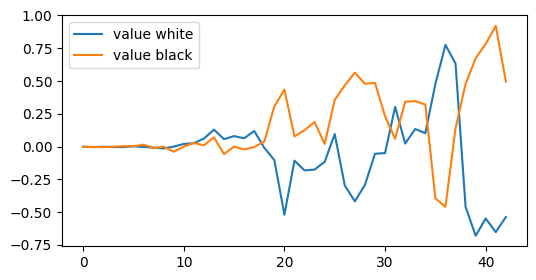

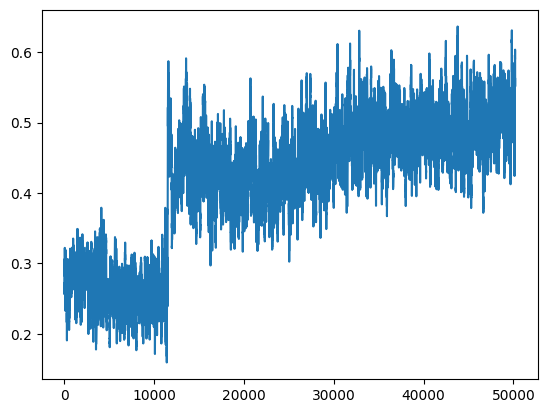

 -- 50510 -- winner: white, i: 149    wins: w = 7162.5, b = 6835.0, d = 21668
 -- 50520 -- winner: black, i: 32    wins: w = 7164.5, b = 6843.0, d = 21692
 -- 50530 -- winner: black, i: 68    wins: w = 7168.5, b = 6849.0, d = 21708
 -- 50540 -- winner: black, i: 32    wins: w = 7171.5, b = 6856.0, d = 21732
 -- 50550 -- winner: white, i: 95    wins: w = 7176.5, b = 6861.0, d = 21750


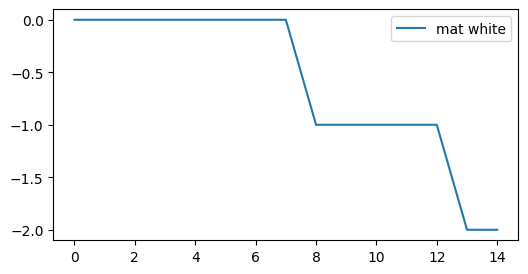

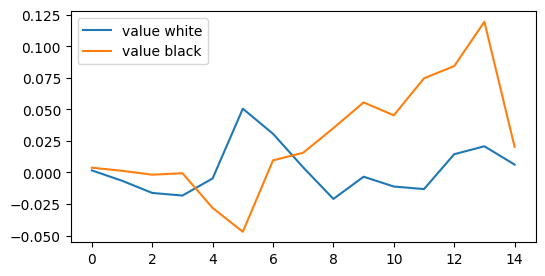

 -- 50560 -- winner: white, i: 141    wins: w = 7182.5, b = 6865.0, d = 21762
 -- 50570 -- winner: black, i: 22    wins: w = 7188.5, b = 6869.0, d = 21774
 -- 50580 -- winner: black, i: 178    wins: w = 7191.5, b = 6876.0, d = 21799
 -- 50590 -- winner: white, i: 97    wins: w = 7195.5, b = 6882.0, d = 21812
 -- 50600 -- winner: white, i: 99    wins: w = 7199.5, b = 6888.0, d = 21820


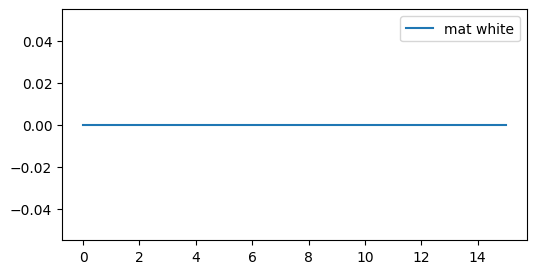

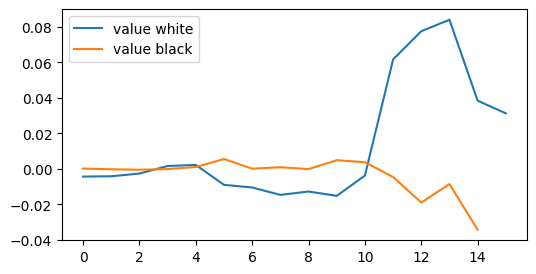

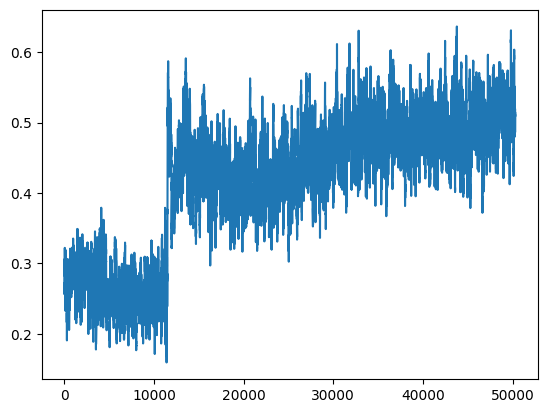

 -- 50610 -- winner: black, i: 116    wins: w = 7202.5, b = 6895.0, d = 21838
 -- 50620 -- winner: black, i: 68    wins: w = 7206.5, b = 6901.0, d = 21845
 -- 50630 -- winner: black, i: 102    wins: w = 7212.5, b = 6905.0, d = 21858
 -- 50640 -- winner: black, i: 24    wins: w = 7220.5, b = 6907.0, d = 21886
 -- 50650 -- winner: white, i: 67    wins: w = 7227.5, b = 6910.0, d = 21897


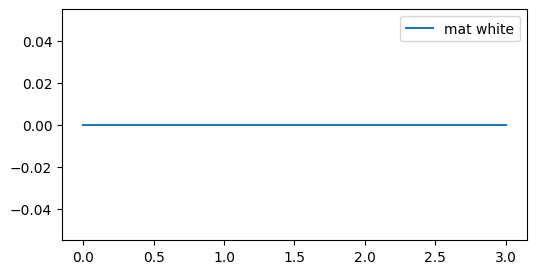

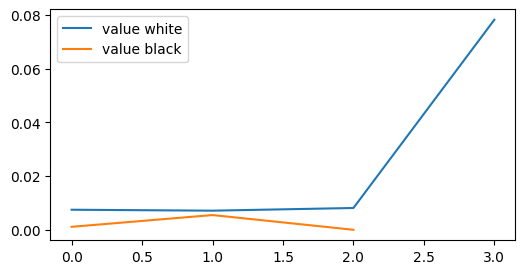

 -- 50660 -- winner: black, i: 96    wins: w = 7230.5, b = 6917.0, d = 21908
 -- 50670 -- winner: black, i: 92    wins: w = 7234.5, b = 6923.0, d = 21927
 -- 50680 -- winner: white, i: 71    wins: w = 7239.5, b = 6928.0, d = 21947
 -- 50690 -- winner: white, i: 65    wins: w = 7245.5, b = 6932.0, d = 21972
 -- 50700 -- winner: white, i: 15    wins: w = 7250.5, b = 6937.0, d = 21996


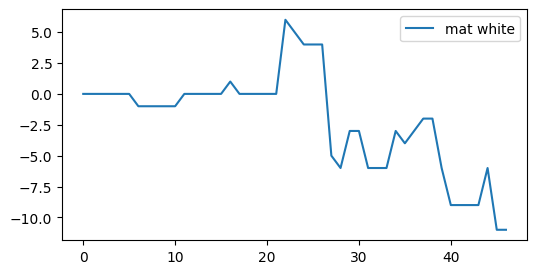

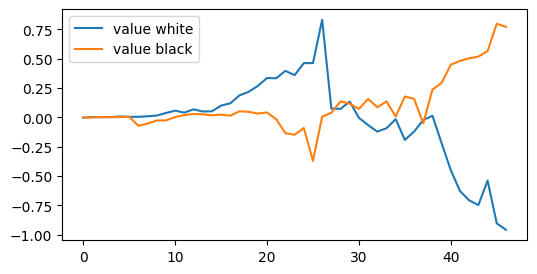

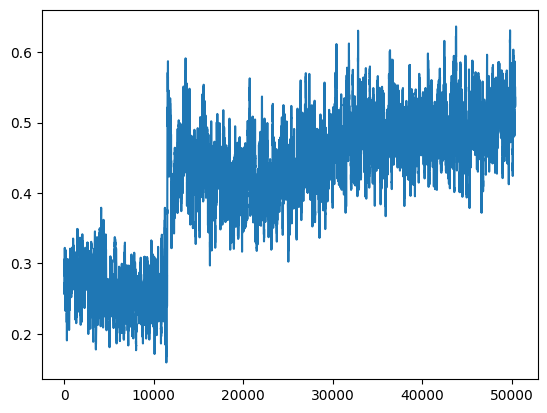

 -- 50710 -- winner: white, i: 113    wins: w = 7253.5, b = 6944.0, d = 22012
 -- 50720 -- winner: white, i: 39    wins: w = 7260.5, b = 6947.0, d = 22040
 -- 50730 -- winner: white, i: 61    wins: w = 7266.5, b = 6951.0, d = 22056
 -- 50740 -- winner: white, i: 53    wins: w = 7273.5, b = 6954.0, d = 22081
 -- 50750 -- winner: white, i: 79    wins: w = 7276.5, b = 6961.0, d = 22097


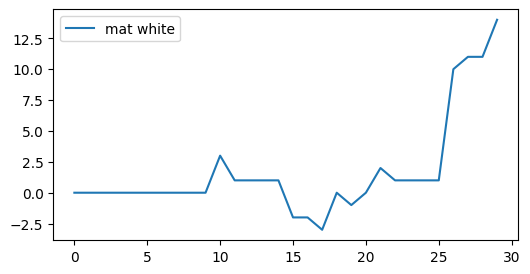

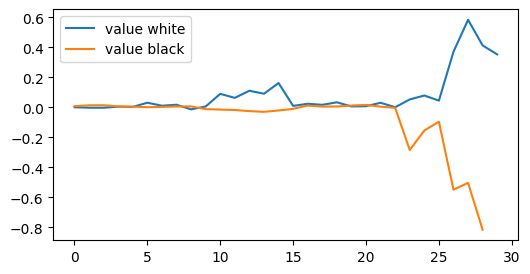

 -- 50760 -- winner: white, i: 19    wins: w = 7283.5, b = 6964.0, d = 22113
 -- 50770 -- winner: white, i: 111    wins: w = 7290.5, b = 6967.0, d = 22125
 -- 50780 -- winner: black, i: 140    wins: w = 7294.5, b = 6973.0, d = 22147
 -- 50790 -- winner: black, i: 100    wins: w = 7300.5, b = 6977.0, d = 22161
 -- 50800 -- winner: black, i: 86    wins: w = 7302.5, b = 6985.0, d = 22172


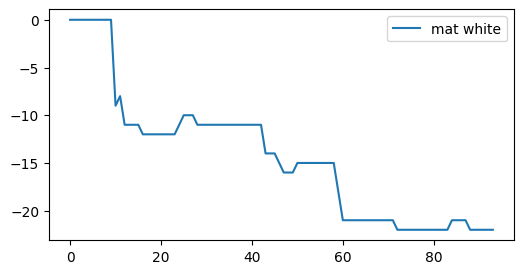

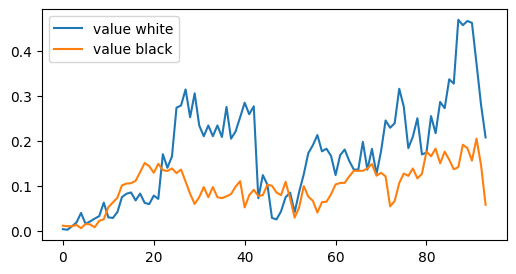

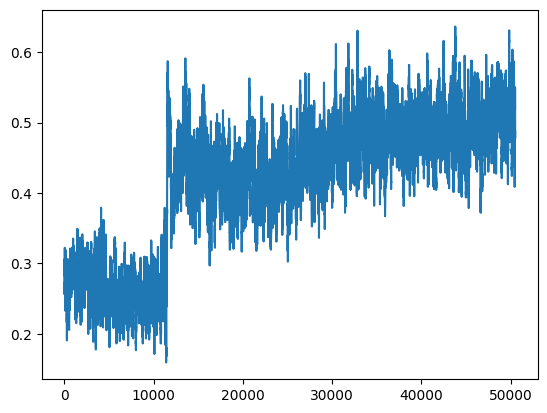

 -- 50810 -- winner: black, i: 110    wins: w = 7306.5, b = 6991.0, d = 22182
 -- 50820 -- winner: black, i: 34    wins: w = 7310.5, b = 6997.0, d = 22201
 -- 50830 -- winner: white, i: 111    wins: w = 7314.5, b = 7003.0, d = 22221
 -- 50840 -- winner: white, i: 69    wins: w = 7320.5, b = 7007.0, d = 22242
 -- 50850 -- winner: black, i: 34    wins: w = 7325.5, b = 7012.0, d = 22268


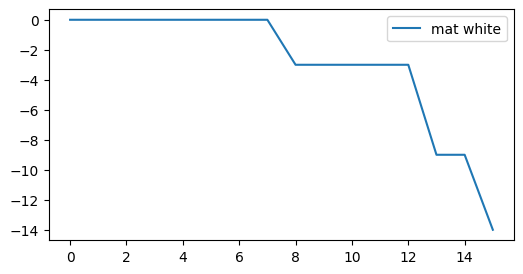

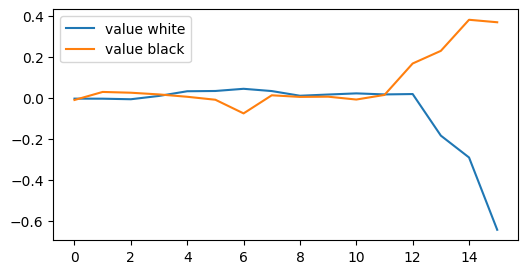

 -- 50860 -- winner: black, i: 130    wins: w = 7329.5, b = 7018.0, d = 22279
 -- 50870 -- winner: black, i: 16    wins: w = 7334.5, b = 7023.0, d = 22294
 -- 50880 -- winner: white, i: 91    wins: w = 7342.5, b = 7025.0, d = 22319
 -- 50890 -- winner: black, i: 76    wins: w = 7345.5, b = 7032.0, d = 22333
 -- 50900 -- winner: white, i: 47    wins: w = 7352.5, b = 7035.0, d = 22348


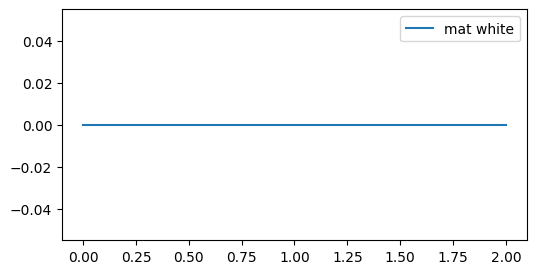

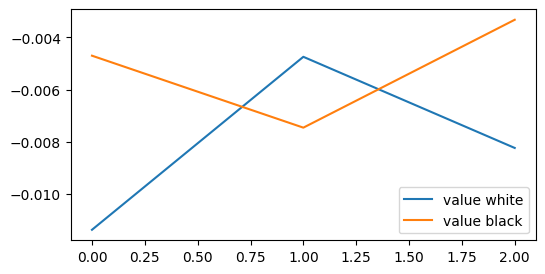

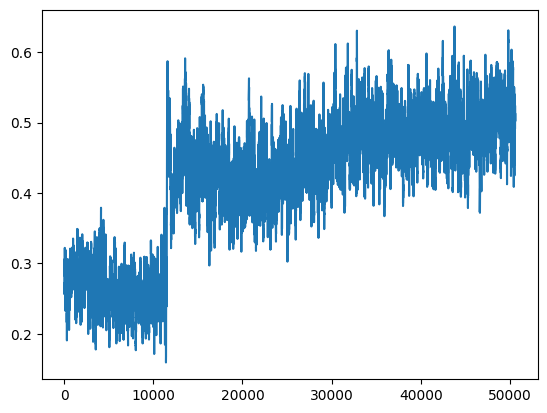

 -- 50910 -- winner: black, i: 98    wins: w = 7355.5, b = 7042.0, d = 22369
 -- 50920 -- winner: white, i: 59    wins: w = 7357.5, b = 7050.0, d = 22381
 -- 50930 -- winner: black, i: 8    wins: w = 7362.5, b = 7055.0, d = 22396
 -- 50940 -- winner: white, i: 93    wins: w = 7366.5, b = 7061.0, d = 22408
 -- 50950 -- winner: white, i: 51    wins: w = 7373.5, b = 7064.0, d = 22421


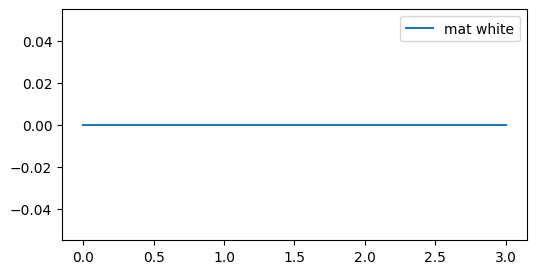

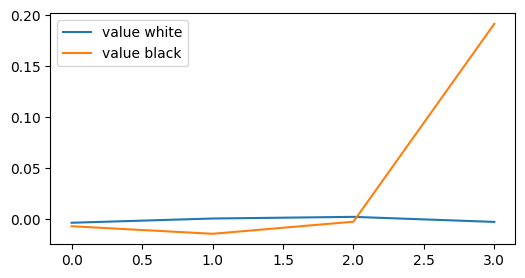

 -- 50960 -- winner: white, i: 71    wins: w = 7379.5, b = 7068.0, d = 22454
 -- 50970 -- winner: white, i: 145    wins: w = 7388.5, b = 7069.0, d = 22471
game termianted, mat diff =  3
 -- 50980 -- winner: black, i: 74    wins: w = 7393.5, b = 7074.0, d = 22501
 -- 50990 -- winner: white, i: 11    wins: w = 7397.5, b = 7080.0, d = 22517
 -- 51000 -- winner: black, i: 52    wins: w = 7402.5, b = 7085.0, d = 22533


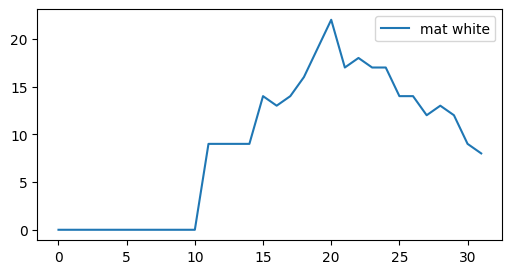

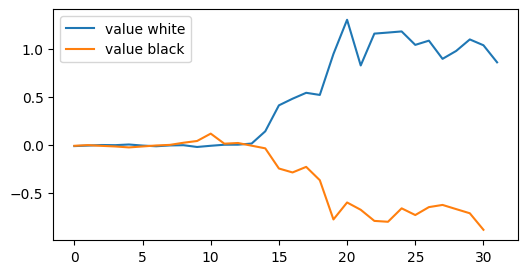

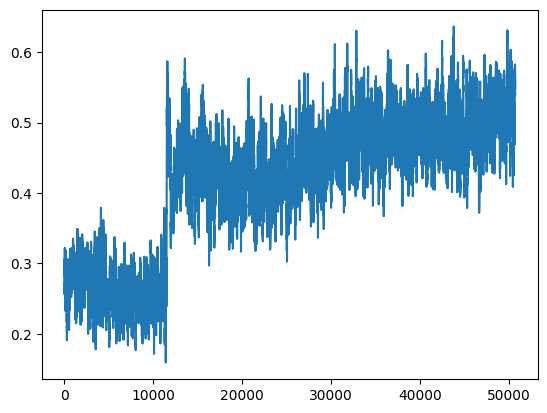

 -- 51010 -- winner: white, i: 105    wins: w = 7408.5, b = 7089.0, d = 22541
 -- 51020 -- winner: black, i: 244    wins: w = 7414.5, b = 7093.0, d = 22548
 -- 51030 -- winner: white, i: 5    wins: w = 7418.5, b = 7099.0, d = 22570
 -- 51040 -- winner: white, i: 87    wins: w = 7423.5, b = 7104.0, d = 22588
 -- 51050 -- winner: white, i: 77    wins: w = 7429.5, b = 7108.0, d = 22605


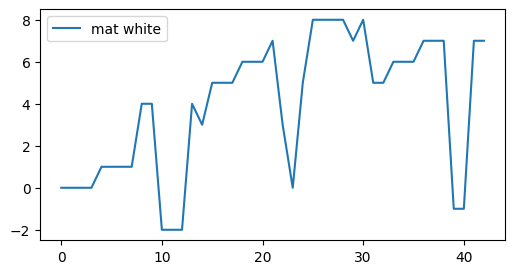

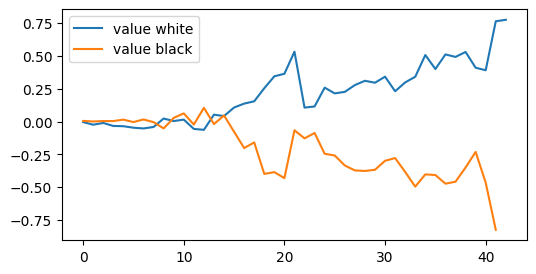

 -- 51060 -- winner: black, i: 92    wins: w = 7435.5, b = 7112.0, d = 22613
 -- 51070 -- winner: white, i: 63    wins: w = 7439.5, b = 7118.0, d = 22625
 -- 51080 -- winner: white, i: 23    wins: w = 7444.5, b = 7123.0, d = 22647
 -- 51090 -- winner: black, i: 80    wins: w = 7448.5, b = 7129.0, d = 22651
 -- 51100 -- winner: black, i: 74    wins: w = 7452.5, b = 7135.0, d = 22668


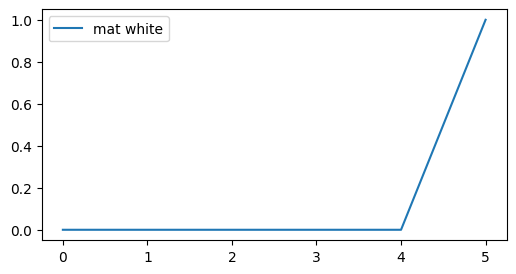

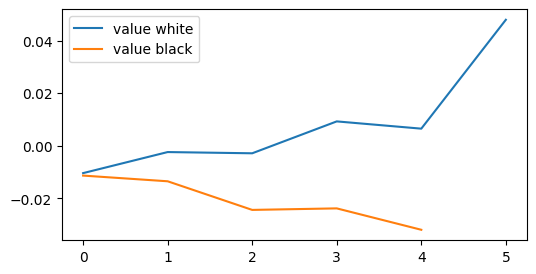

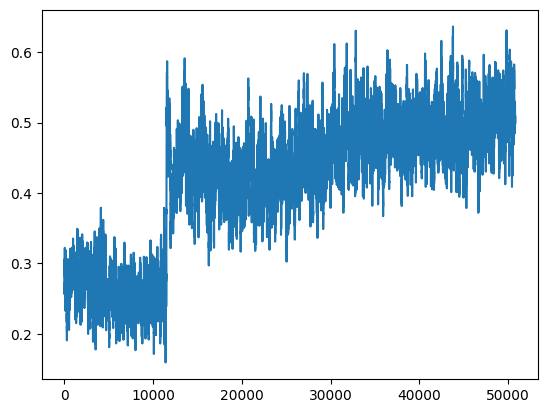

 -- 51110 -- winner: white, i: 11    wins: w = 7456.5, b = 7141.0, d = 22683
 -- 51120 -- winner: white, i: 9    wins: w = 7461.5, b = 7146.0, d = 22701
 -- 51130 -- winner: black, i: 90    wins: w = 7463.5, b = 7154.0, d = 22716
 -- 51140 -- winner: white, i: 31    wins: w = 7467.5, b = 7160.0, d = 22729
 -- 51150 -- winner: black, i: 54    wins: w = 7470.5, b = 7167.0, d = 22737


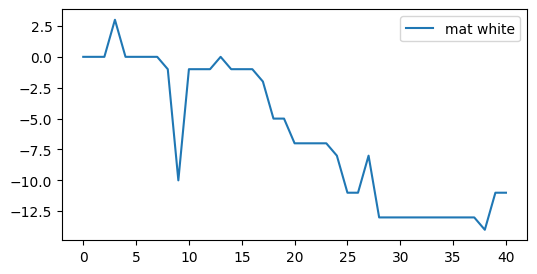

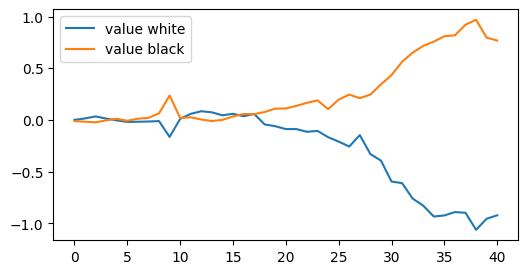

 -- 51160 -- winner: white, i: 17    wins: w = 7475.5, b = 7172.0, d = 22748
 -- 51170 -- winner: white, i: 35    wins: w = 7482.5, b = 7175.0, d = 22758
 -- 51180 -- winner: black, i: 90    wins: w = 7487.5, b = 7180.0, d = 22770
 -- 51190 -- winner: white, i: 21    wins: w = 7492.5, b = 7185.0, d = 22793
 -- 51200 -- winner: white, i: 157    wins: w = 7496.5, b = 7191.0, d = 22811


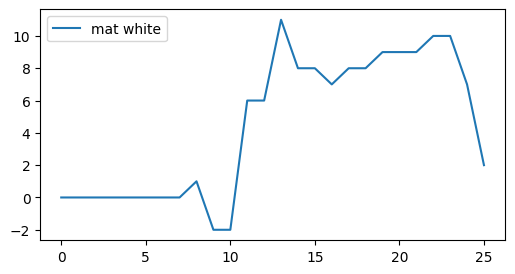

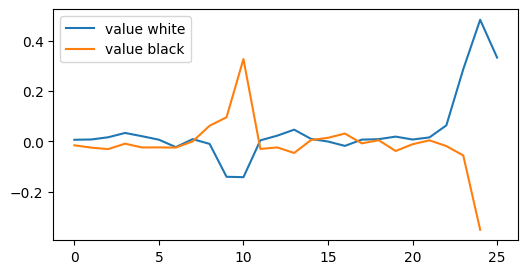

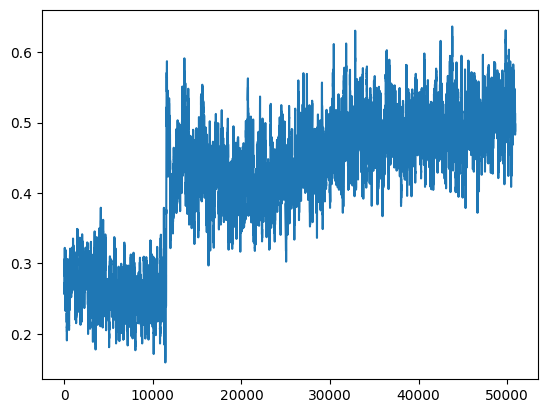

 -- 51210 -- winner: white, i: 19    wins: w = 7501.5, b = 7196.0, d = 22832
 -- 51220 -- winner: white, i: 13    wins: w = 7506.5, b = 7201.0, d = 22841
 -- 51230 -- winner: white, i: 131    wins: w = 7509.5, b = 7208.0, d = 22859
 -- 51240 -- winner: white, i: 97    wins: w = 7513.5, b = 7214.0, d = 22877
 -- 51250 -- winner: black, i: 112    wins: w = 7517.5, b = 7220.0, d = 22889


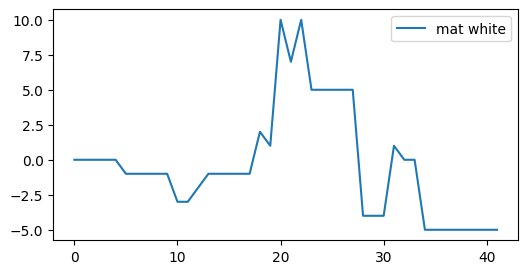

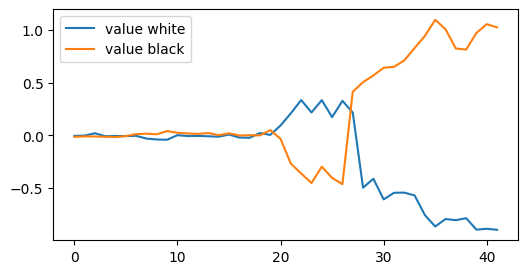

 -- 51260 -- winner: white, i: 81    wins: w = 7520.5, b = 7227.0, d = 22913
 -- 51270 -- winner: white, i: 131    wins: w = 7525.5, b = 7232.0, d = 22924
 -- 51280 -- winner: black, i: 130    wins: w = 7531.5, b = 7236.0, d = 22936
 -- 51290 -- winner: black, i: 92    wins: w = 7535.5, b = 7242.0, d = 22944
 -- 51300 -- winner: black, i: 100    wins: w = 7540.5, b = 7247.0, d = 22957


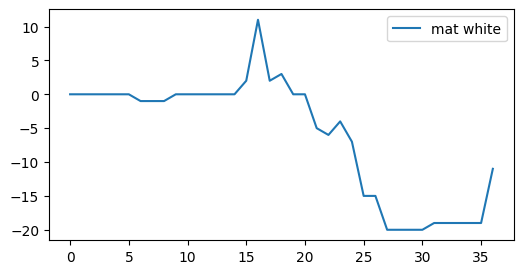

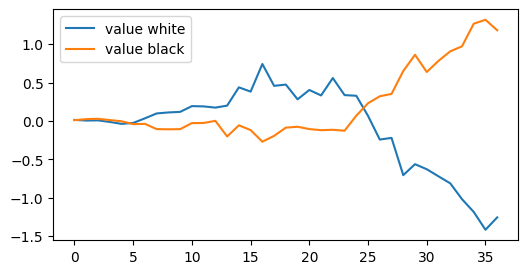

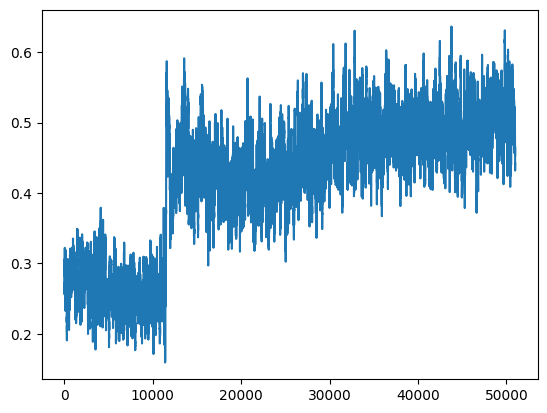

 -- 51310 -- winner: white, i: 63    wins: w = 7544.5, b = 7253.0, d = 22966
 -- 51320 -- winner: black, i: 78    wins: w = 7551.5, b = 7256.0, d = 22987
 -- 51330 -- winner: black, i: 48    wins: w = 7555.5, b = 7262.0, d = 22998
 -- 51340 -- winner: black, i: 148    wins: w = 7560.5, b = 7267.0, d = 23005
 -- 51350 -- winner: white, i: 79    wins: w = 7564.5, b = 7273.0, d = 23016


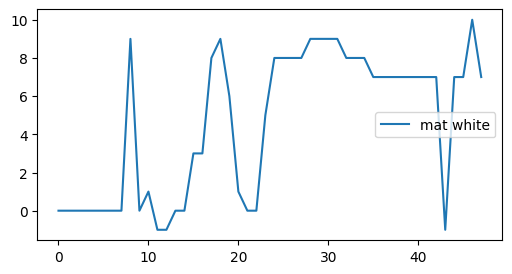

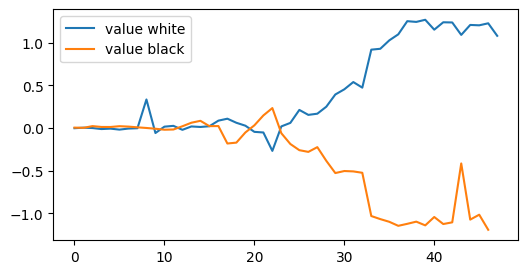

 -- 51360 -- winner: black, i: 100    wins: w = 7569.5, b = 7278.0, d = 23039
 -- 51370 -- winner: white, i: 89    wins: w = 7574.5, b = 7283.0, d = 23059
 -- 51380 -- winner: black, i: 122    wins: w = 7577.5, b = 7290.0, d = 23069
 -- 51390 -- winner: black, i: 14    wins: w = 7583.5, b = 7294.0, d = 23083
 -- 51400 -- winner: black, i: 106    wins: w = 7588.5, b = 7299.0, d = 23091


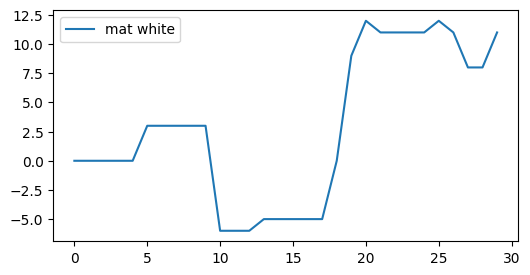

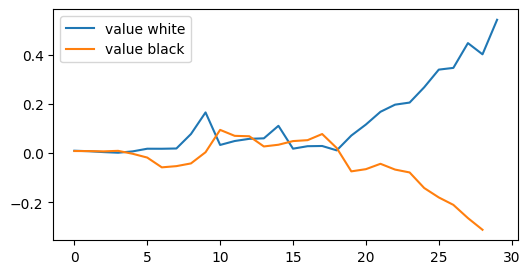

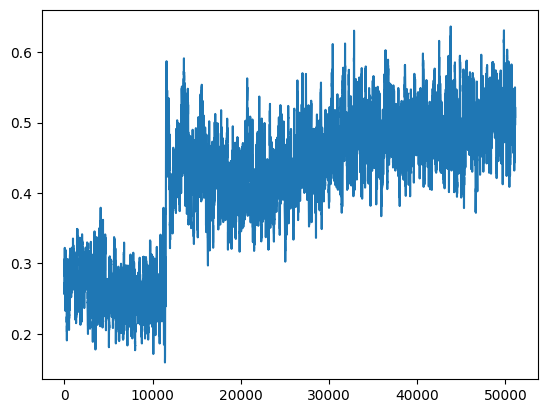

 -- 51410 -- winner: black, i: 60    wins: w = 7591.5, b = 7306.0, d = 23124
 -- 51420 -- winner: white, i: 83    wins: w = 7598.5, b = 7309.0, d = 23141
 -- 51430 -- winner: black, i: 38    wins: w = 7605.5, b = 7312.0, d = 23161
 -- 51440 -- winner: white, i: 77    wins: w = 7608.5, b = 7319.0, d = 23169
 -- 51450 -- winner: black, i: 90    wins: w = 7610.5, b = 7327.0, d = 23187


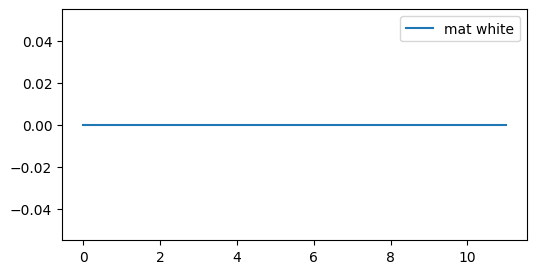

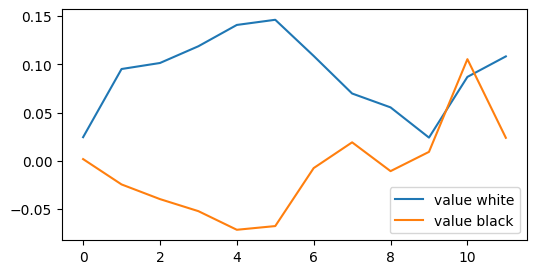

 -- 51460 -- winner: black, i: 128    wins: w = 7615.5, b = 7332.0, d = 23212


KeyboardInterrupt: 

In [8]:
i_limit = 1000
while True:
    t0 = time.time()

    game = Game()
    next_root = None
    i = 0
    boards_white = [];  boards_black = []
    mat_white = [];     mat_black = []
    value_white = [];   value_black = []

    model.eval()

    while not game.is_over():
        i += 1
        if i > i_limit:
            break

        current_boards = []; current_labels = []
    
        moves = game.PossibleMoves()

        game_ini = game.copy()
        board_batch = [board_to_tensor(game.pieces)]

        mate = False

        for move in moves:
            game.PlayMove(move)
            board_batch.append(board_to_tensor(game.pieces))
            game.FlipBoard()
            if game.is_over():
                mate = True
                chosen_move = move
                game = game_ini.copy()
                break
            game = game_ini.copy()

        if not mate:

            board_tensor = torch.stack(board_batch)
            values = model(board_tensor)
            if i < 11:
                scale = value_diff_scale/15
            elif i < 21:
                scale = value_diff_scale/3
            else:
                scale = value_diff_scale*3
            values_diff = [scale*(values[i] - values[0]) for i in range(1, len(values))]
            move_prob = torch.softmax(torch.Tensor(values_diff), dim=0).numpy()
            chosen_i = np.random.choice(range(len(moves)), p=move_prob)
            chosen_move = moves[chosen_i]
            
        game.PlayMove(chosen_move)

        mat_diff = game.MaterialDiff()
        value = model(torch.stack([board_to_tensor(game.pieces)])).detach().item()

        if i % 2 == 1:
            boards_white.append(board_to_tensor(game.pieces))
            mat_white.append(mat_diff)
            value_white.append(value)
        if i % 2 == 0:
            boards_black.append(board_to_tensor(game.pieces))
            mat_black.append(mat_diff)
            value_black.append(value)

        game.FlipBoard()

    if i <= i_limit: # game actually ended
        winner = game.get_winner()
        if winner == 'draw':
            draws += 1;         reward_white = 0;   reward_black = 0
        if winner == 'white':
            white_wins += 1;    reward_white = 1;   reward_black = -1
        if winner == 'black':
            black_wins += 1;    reward_white = -1;  reward_black = 1

    else: # game terminated because too long
        matdiff = game.MaterialDiff()
        if matdiff > 4:
            if game.turn == 'white':
                winner = 'white'; reward_white = 0.5;   reward_black = -0.5;    white_wins += 0.5
            if game.turn == 'black':
                winner = 'black'; reward_white = -0.5;  reward_black = 0.5;     black_wins = 0.5
        elif matdiff < -4:
            if game.turn == 'white':
                winner = 'black'; reward_white = -0.5;  reward_black = 0.5;     black_wins += 0.5
            if game.turn == 'black':
                winner = 'white'; reward_white = 0.5;   reward_black = -0.5;    white_wins = 0.5
        else:
            winner = 'draw'; draws += 1; reward_white = 0; reward_black = 0

    if i > i_limit:
        print('game termianted, mat diff = ', matdiff)

    game_time = time.time() - t0

    labels_white = [reward_white * gamma**(len(boards_white) - 1 - i) for i in range(len(boards_white))]
    labels_black = [reward_black * gamma**(len(boards_black) - 1 - i) for i in range(len(boards_black))]

    inputs = boards_white + boards_black
    labels = labels_white + labels_black

    inputs_tens = torch.stack(inputs)
    labels_tens = torch.Tensor(labels)   

    if winner != 'draw':
        # newest training error
        out = model(inputs_tens)
        out = out.view(out.shape[0])
        loss = criterion(out, labels_tens)
        error_hist.append(loss.item())
    else:
        draw_count += 1
        continue

    if game_count % 10 == 0:
        print(' -- {} -- winner: {}, i: {}   '.format(game_count, winner, i), 'wins: w = {}, b = {}, d = {}'.format(white_wins, black_wins, draws))
    

    if game_count % 50 == 1:# or True:
        plt.figure(figsize=(6, 3))
        plt.plot(mat_white, label='mat white')
        plt.legend()
        plt.show()
        plt.figure(figsize=(6, 3))
        plt.plot(value_white, label='value white')
        plt.plot(value_black, label='value black')
        plt.legend()
        plt.show()

    torch.save(inputs_tens, '/Users/Philip/Desktop/Projects/RL Chess/MCTS/MCTS Game Saves v4/inputs_{}'.format(game_count))
    torch.save(labels_tens, '/Users/Philip/Desktop/Projects/RL Chess/MCTS/MCTS Game Saves v4/labels_{}'.format(game_count))

    t1 = time.time()

    if game_count > 5:
        # sample some of previous game for replay. More recent -> more likely
        decay_rate = 0.003
        prob =  np.exp(-decay_rate * np.arange(game_count)) 
        prob = prob /sum(prob)
        num_samples = 3
        samples = np.random.choice(np.arange(game_count, 0, -1), size=num_samples, p=prob)

        for indices in samples:
            inputs_load = torch.load('/Users/Philip/Desktop/Projects/RL Chess/MCTS/MCTS Game Saves v4/inputs_{}'.format(indices))
            inputs_tens = torch.cat((inputs_load, inputs_tens))
            labels_tens = torch.cat((torch.load('/Users/Philip/Desktop/Projects/RL Chess/MCTS/MCTS Game Saves v4/labels_{}'.format(indices)), labels_tens))

    len_boards = len(inputs_tens)
    for c in range(len_boards):
        tens = inputs_tens[c]
        # if no pawns are on the board: add all other 3 rotated versions of the board to the current data set
        if torch.sum(inputs_tens[c][0]) + torch.sum(inputs_tens[c][6]) == 0:
            board_new = tensor_to_board(tens)
            for _ in range(3):
                board_new = rotate_board(board_new, 1)
                tens_new = torch.stack([board_to_tensor(board_new)])
                inputs_tens = torch.cat((inputs_tens, tens_new), 0)
                labels_tens = torch.cat((labels_tens, torch.stack([labels_tens[c]])), 0)
    
    model.train()
    # learning_rate = 5e-4 * 500 / (500 + game_count) # reducing learning rate, 1/n one possible options
    learning_rate = 5e-5
    # weight_decay = 1e-2 # regularization to avoid overfitting
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)

    random_order = [i for i in range(len(inputs_tens))]
    np.random.shuffle(random_order)
    for c in random_order:

        inp = torch.stack([inputs_tens[c], mirror_board_tensor(inputs_tens[c])])
        label = torch.stack([labels_tens[c], labels_tens[c]])

        out = model(inp)
        out = out.view(out.shape[0])

        loss = criterion(out, label)
        optimizer.zero_grad()
        loss.backward()

        # torch.nn.utils.clip_grad_norm_(model.parameters(), max_gradient_norm)
        optimizer.step()

    # print('game time: {} -- training time: {},  '.format(game_time, time.time() - t1))
    # print('sum of losses: ', sum(err_curr))

    # error_hist.append(sum(err_curr))
    
    torch.save(error_hist, './error_hist MC v4')

    if game_count % 100  == 1:
        # plt.plot(error_hist)
        # plt.title('training errors')
        # plt.show()
        interval = 50
        plt.figure()
        plt.plot([np.mean(error_hist[i:i+interval]) for i in range(len(error_hist) - interval)])
        plt.show()

    if game_count % 100 == 9:    
        torch.save(model.state_dict(), './Model Saves MC v4/model_{}_games'.format(game_count+1))

    game_count += 1
